In [1]:
%load_ext autoreload
%autoreload 2

import time
import numpy as np

# Constants

In [2]:
sample_rate = 44100
hop_size = 441*2
hidden_mod = 3
maximum = 32
width = 4
ds_path = './datasets/VN/ds.pkl'
model_path = './models/VN/model10_'

# Data Class

In [3]:
import os
import re
import json
import math
import cv2
import subprocess as sp
from osr2mp4.EEnum.EReplay import Replays
from osr2mp4.osr2mp4 import Osr2mp4
import torch
import torchvision.io as vision
import torchvision.transforms as transforms

In [4]:
class OSR():
    def __init__(self, beatmap_dir, beatmap, sample_rate=44100, hop_size=441, hidden=False,
                 width=4,
                 tmp='./tmp', vtmp='./vid', atmp='./wav'):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.beatmap_path = os.path.join(self.beatmap_dir, self.beatmap)
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.rate = int(sample_rate / hop_size)
        self.fps = self.rate
        self.tmp = tmp
        self.vtmp = vtmp
        self.atmp = atmp
        self.width = 4
        self.hidden = hidden
        self.data_json = os.path.join(self.tmp, self.beatmap + '.json')
        hdn = 'hdn' if hidden else ''
        self.video_path = os.path.join(self.vtmp, self.beatmap + hdn + '.avi')
        
        self.replay_info = None
        self.osr2mp4 = None
        self.video = None
        self.hitobjects = None
        self.cursorstream = None
        self.timestamp = None
                
    def run_osr2mp4(self):
        d = json.load(open('data.json', 'r'))
        f = open(self.data_json, 'w')
        d['Beatmap path'] = self.beatmap_path
        if self.hidden is False:
            d['Skin path'] = './skin'
        else:
            d['Skin path'] = './skin_hidden'
        d['FPS'] = self.fps
        d['Output path'] = self.video_path
        json.dump(d, f)
        f.close()
                 
        self.osr2mp4 = Osr2mp4(filedata=self.data_json, filesettings='settings.json', filepp='ppsettings.json', 
                               filestrain='strainsettings.json', logtofile=True)
        while True:
            if self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_X] == 0 and self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_Y] == 0:
                self.osr2mp4.replay_info.play_data = self.osr2mp4.replay_info.play_data[0:-1]
            else:
                break
        
    def create_vid(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        cmd = ['python', 'create_vid.py', self.data_json]
        proc = sp.Popen(cmd)
        proc.wait()
        
    def parse_timings(self):
        if self.video is None:
            self.get_video()
        self.beat_len = []
        self.timestamp = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'BeatDivisor.*', l):
                self.BeatDivisor = int(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0]))
        self.timestamp.append(int(self.video[1].shape[1] / self.video[2]['audio_fps'] * 1000))
        f.close()
    
    def parse_hitobjects(self):
        self.hitobjects = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'ApproachRate.*', l):
                AR = float(l.split(':')[1])
                if AR < 5.0:
                    preempt = 1200 + 600 * (5 - AR) / 5
                    fadein = 800 + 400 * (5 - AR) / 5
                else:
                    preempt = 1200 - 750 * (AR - 5) / 5
                    fadein = 800 - 500 * (AR - 5) / 5
                self.preempt = preempt - fadein*0.1
                break
        f.seek(0)
        for l in f:
            if re.match(r'SliderMultiplier.*', l):
                self.sliderMultiplier = float(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
    
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
        
    def create_cursor_peak(self, y, i):
        alen = len(y)
        w = self.width/2/2
        
        def func(x):
            return math.exp(-j**2/w**2)
        
        j = 0 
        while i+j > 0 and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j -= 1
        j = 0
        while i+j < alen and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j += 1
    
    def process_beatobjects(self):
        pass
    
    def process_hitobjects(self):
        if self.hitobjects is None:
               self.parse_beatmap()
        self.hitobjStream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
    
    def process_clicks(self):
        pass
    
    def process_cursor(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        n = math.ceil((self.osr2mp4.replay_info.play_data[-1][Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)
        self.cursorstream = [None] * n
        #self.cursorstream = np.zeros((n, 3))
        
        for j in range(len(self.osr2mp4.replay_info.play_data) - 1):
            a = self.osr2mp4.replay_info.play_data[j]
            b = self.osr2mp4.replay_info.play_data[j+1]
            delta = (b[Replays.TIMES] - a[Replays.TIMES]) * 0.001 * self.fps
            xdist = b[Replays.CURSOR_X] - a[Replays.CURSOR_X]
            ydist = b[Replays.CURSOR_Y] - a[Replays.CURSOR_Y]
            stime = (a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps
            x = a[Replays.CURSOR_X]
            y = a[Replays.CURSOR_Y]
            
            e = np.array([0.0, 0.0, 0])
            if self.hidden is False:
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + xdist/delta*t
                    e[Replays.CURSOR_Y] = y + ydist/delta*t
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
            else:
                def f(x, dist):
                    if dist == 0:
                        return x
                    c = 20
                    o = dist/2
                    return o*2 * 1 / (1 + math.exp(-1 * c * (x - o) / o))
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + f(xdist/delta*t, xdist)
                    e[Replays.CURSOR_Y] = y + f(ydist/delta*t, ydist)
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
                
            e[Replays.KEYS_PRESSED] = a[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = a[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = a[Replays.CURSOR_Y]
            self.cursorstream[int((a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
            e[Replays.KEYS_PRESSED] = b[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = b[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = b[Replays.CURSOR_Y]
            self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
        
    def process_events(self):
        self.process_clicks()
        self.process_cursor()
        
    def read_video(self, scale=1):
        if not os.path.exists(self.video_path):
            self.create_vid()
        #self.video = vision.read_video(self.video_path)
        transform = transforms.ToTensor()
        frames = []
        vc = cv2.VideoCapture(self.video_path)
        while True:
            r, f = vc.read()
            f = cv2.resize(f, (0,0), fx=scale, fy=scale)
            frames.append(transform(f))
            if r is False:
                break
        return torch.stack(frames)
        
    def queue_vid(self):
        if not os.path.exists(self.video_path):
            self.create_vid()   
        return self.video_path
    
    def get_offset(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        return self.osr2mp4.replay_info.play_data[0][Replays.TIMES]
    
    def get_beatobjects(self):
        if self.beatobjStream is None:
            self.process_beatobjects()
        stream = [None] * len(self.beatobjStream)
        for i in range(len(self.beatobjStream)):
            if self.beatobjStream[i] == [] or self.beatobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.beatobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
        
    def get_hitobjects(self):
        if self.hitobjStream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitobjStream)
        for i in range(len(self.hitobjStream)):
            if self.hitobjStream[i] == [] or self.hitobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.hitobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_cursor(self):
        if self.cursorstream is None:
            self.process_events()
        return torch.stack(self.cursorstream)
        
    def get_video(self, scale=1):
        if self.video is None:
            self.read_video(scale=1)
        return self.video

# Dataset

In [5]:
import glob
import copy
import traceback
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import cv2
import matplotlib.pyplot as plt

In [6]:
class OSR_Dataset(Dataset):
    def __init__(self, beatmap_dir, sample_rate=44100, hop_size=441, seq_dur=10, scale=1, hidden_mod=0, maximum=100):
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.hidden_mod = hidden_mod
        self.maximum = maximum
        self.scale = scale
        
        self.osrs = []
        
        if beatmap_dir is None:
            self.v = []
            self.c = []
            return
        
        j = 0
        def parse_beatmaps(j):
            for r, dirs, _ in os.walk(beatmap_dir):
                for dir in dirs:
                    for root, _, files in os.walk(os.path.join(r, dir)):
                        for f in files:
                            if re.match(r'.*osu$', f):
                                if self.hidden_mod == 0 or j % self.hidden_mod != 0:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size))
                                else:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size, hidden=True))
                                if j == self.maximum:
                                    return j
                                j += 1
            return j
        j = parse_beatmaps(j)
        
        self.v = [None] * j
        self.c = [None] * j
        
        def process(i):
            m = self.osrs[i]
            self.osrs[i] = None;
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)
                self.v[i] = copy.deepcopy(m.queue_vid())
                self.c[i] = copy.deepcopy(m.get_cursor())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)
                self.v[i] = None
                self.c[i] = None
            del m
        
        list(map(process, range(j)))
        
        self.v = list(filter(lambda x: x is not None, self.v))
        self.c = list(filter(lambda x: x is not None, self.c))
        
    def take(self, ds, i, j):
        self.v = ds.v[i:j]
        self.c = ds.c[i:j]

    def __len__(self):
        return len(self.v)

    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        
        transform = transforms.ToTensor()
        j = np.random.randint(0, self.c[i].shape[0] - self.seq_len)
        vc = cv2.VideoCapture(self.v[i])
        vc.set(cv2.CAP_PROP_POS_FRAMES, j)
        #for k in range(j):
        #    _, _ = vc.read()
        
        f = [None] * self.seq_len
        for k in range(self.seq_len):
            frame = vc.read()[1]
            frame = cv2.resize(frame, (0,0), fx=self.scale, fy=self.scale)
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            f[k] = transform(frame)
        
        c = self.c[i][j: j+self.seq_len]
        cy = torch.div(c[:,Replays.CURSOR_Y], 384) #, dtype=c.type())
        c[:,1] = torch.div(c[:,Replays.CURSOR_X], 512) #, dtype=c.type())
        c[:,0] = cy
        
        return (torch.stack(f), c) #self.c[i][j: j+self.seq_len])256

# Testing

In [7]:
ds = OSR_Dataset('../ex/beatmaps', sample_rate=44100, hop_size=441*2, hidden_mod=0, maximum=1)

0/0 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu


(600, 1024, 3)
tensor(0.5409) tensor(0.5290)
(263, 158)


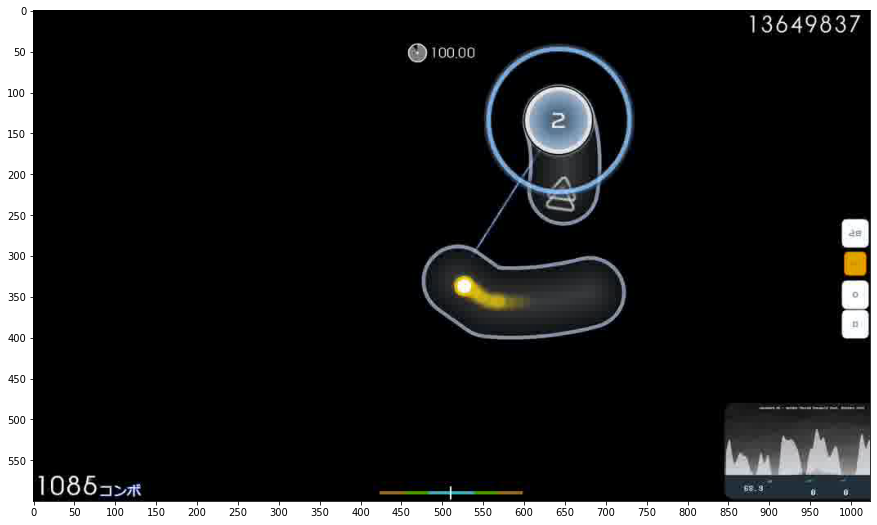

In [19]:
import matplotlib.pyplot as plt

import op

op.h = 600 / 2
op.w = 1024 / 2
op.calratio()

e = s[0]
print(e[0][0].permute(1, 2, 0).numpy().shape)

plt.rcParams["figure.figsize"] = (15, 15)

plt.xticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[1], 50))
plt.yticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[0], 50))

plt.imshow(cv2.cvtColor(e[0][0].permute(1, 2, 0).numpy(), cv2.COLOR_BGR2RGB))
print(e[1][0][1], e[1][0][0])
print(op.cor(e[1][0][1] * 512, e[1][0][0] * 384))
#print(op.cor(e[1][0][1], e[1][0][0]))
#for x in e[1][0:10]:
    #print(op.cor(x[0], x[1]))

# Process Data

In [7]:
import time

In [7]:
ds = OSR_Dataset('../beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=1, maximum=256)

0/255 Chata - Engage (Lasse) [Insane].osu
1/255 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/255 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/255 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/255 StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
5/255 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/255 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/255 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/255 fripSide - future gazer (TV Size) (alacat) [Insane].osu
9/255 cYsmix - bells! (Gero) [normal!].osu
10/255 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
11/255 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/255 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/255 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/255 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu
15/255 Narushi

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 7482 in argument 0, but got NoneType


pruning: Fujijo Seitokai Shikkou-bu - Best FriendS (sahuang) [N a s y a's Insane].osu
60/255 Omoi - Chiisana Koi no Uta (Synth Rock Cover) (val0108) [Marianna's Insane].osu
61/255 Natsumi Kiyoura - Tabi no Tochuu (Weinmagier) [Normal].osu
62/255 Nico Nico Douga - U.Nknown Goose (Borokuzu) [Insane].osu
63/255 Hatsune Miku - Moon (Saten ruiko) [Insane].osu
64/255 fripSide - black bullet (TV Size) (Chloe) [Insane].osu
65/255 Hatsune Miku - the last effect (Holoaz) [ringloid].osu
66/255 Gojou Kai - Touhou Youkai Komachi (James) [Normal].osu
67/255 REOL - Hibikase (Gero) [NiNo's Insane].osu
68/255 Kuba Oms - My Love (W h i t e) [Insane].osu
69/255 Yasuo - P - Electric Angel (- Ruby Rose -) [Insane].osu
70/255 Shimotsuki Haruka, Suzuyu - Fairy Wreath (ImpurePug) [Angraecum].osu
71/255 ClariS - Connect (TV Size) (browiec) [Mathew's Insane].osu
72/255 DIVELA feat. Hatsune Miku - BEAT SYNCER (Log Off Now) [Insane].osu
73/255 The Quick Brown Fox - The Big Black (Blue Dragon) [WHO'S AFRAID OF THE

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 6527 in argument 0, but got NoneType


75/255 toby fox - Nyeh Heh Heh! & Bonetrousle (DaxMasterix) [NORMAL].osu
76/255 ryo (supercell) - ODDS&ENDS (Short Ver.) (Betsuto) [Insane].osu
77/255 TRakker - Trail of Dust (Amamiya Yuko) [Trail of Star].osu
78/255 Police Piccadilly feat. Hatsune Miku - Kire Carry On (Sinnoh) [negusver's Insane].osu
79/255 MOSAIC.WAV - Zen Sekai Teki Touch Panel (Laurier) [CrystLer].osu
80/255 Aiobahn & Yunomi - Makuramoto ni Ghost (feat. Nicamoq) (Swan) [Swan's Melanzana].osu
81/255 Camellia - Routing (Shiirn) [pishi's Advanced].osu
82/255 seleP feat. Lily - Chloe-Five Decades Ago- (Duftende Pizza) [V].osu
83/255 dj TAKA - quaver (Monstrata) [Haru's Insane].osu
84/255 Silver Forest Feat. Aki & Sakura Mayuko - Summer time Heaven -after (RVMathew) [Ojou].osu
85/255 Van Darkholme - GachiMuchi circulation (Kr0n0s23) [Thank you, sir!].osu
86/255 Ariabl'eyeS - Senkou no Furea (Kibbleru) [Redemption].osu
87/255 ATeens - Gimme! Gimme! Gimme! (Nightcore Mix) (ShadowSoul) [Gimme!].osu
88/255 Tomoe Tamiyasu - 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 512 in argument 0, but got NoneType


pruning: Tomoe Tamiyasu - Yamato Nadeshiko Hanakotoba (Lasse) [Insane].osu
89/255 Masayoshi Minoshima ft. nomico - Bad Apple!! (Ephemeral) [Normal].osu
90/255 solfa feat. Shimotsuki Haruka - Natsuiro Ramune (Lasse) [Bariton's Insane].osu
91/255 Nakagawa Shouko - Sorairo Days (Rizen) [Fizz's Insane].osu
92/255 LeaF - Calamity Fortune (Arphimigon) [BOOM].osu
93/255 cillia - Fairytale, (SkinnyJommy) [Pho's Insane].osu
94/255 Lindsey Stirling - Senbonzakura (MrSergio) [Insane].osu
95/255 Hatsune Miku - Senkouhanabi Aika (val0108) [Insane].osu
96/255 Hatsune Miku - Himitsu Keisatsu (Lalarun) [Insane].osu
97/255 MISATO - Necro Fantasia (WORSTPOLACKEU) [Cheesecake's Insane].osu
98/255 a_hisa - Cheshire,s dance (Muya) [Normal].osu
99/255 Roselia - The Everlasting Guilty Crown (Underdogs) [Insane].osu
100/255 40meter-P - Mousou sketch (Noways) [Insane!].osu
101/255 sasakure.UK x DECO27 - 39 (Finshie) [Insane].osu
102/255 Chata - len (Cami) [xiqingwa's Lunatic].osu
103/255 Fractal Dreamers - Fat

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


121/255 Sawai Miku - Colorful. (Asterisk DnB Remix) (Asfand) [Vibrant].osu
122/255 Yunomi & nicamoq - Indoor Kei Nara Trackmaker (dipperbee) [TrAcK MaKeR].osu
123/255 GTA feat. Sam Bruno - Red Lips (Mendus Remix) (Euny) [Natsu's Insane].osu
124/255 TrySail - Utsuroi (Short Ver.) (Log Off Now) [Nexus' Insane].osu
125/255 ZAQ - Seven Doors (eINess) [wkyik's Insane].osu
126/255 M2U - Stellar (Ultima Fox) [defiance's Insane].osu
127/255 SawanoHiroyuki[nZk]mizuki - aLIEz (jonathanlfj) [Trust's Normal].osu
128/255 YOASOBI - Yoru ni Kakeru (Petal) [Keirelia's Insane].osu
129/255 Usada Pekora - Discommunication Alien (Yugu) [XLT's Insane].osu
130/255 EastNewSound - Sadistic Paranoia (TicClick) [Vass-RJ's Hard].osu
131/255 Sound Souler - Paradise (kwk) [Mir's Insane].osu
132/255 Hatsune Miku - Subarashii Sekai (val0108) [Insane].osu
133/255 AAAA - carnation (Veridian) [noffy's normal].osu
134/255 Kamogawa rokkaazu (CVKubota Kaoru) - STONES (Pata-Mon) [GDInsane [placeholder]].osu
135/255 UNISON 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


175/255 petit milady - Koi wa Milk Tea (Okoratu) [Normal].osu
176/255 Dark PHOENiX - Taketori Hishou (KanbeKotori) [Extra].osu
177/255 Mili - Origin (TV Size) (Ryuusei Aika) [kanor's Insane].osu
178/255 Hanataba - Night of Knights (v2b) [Normal].osu
179/255 Sagara Kokoro - Hoshizora no Ima (Star Stream) [Insane].osu
180/255 Hanatan - Uta ni Katachi wa Nai keredo (Asahina Momoko) [Recollection].osu
181/255 PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
pruning: PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
182/255 Yoko Takahashi - Zankoku Na Tenshi No These (TV. Size Version) (moph) [Ambient's Insane].osu
183/255 Noboru ft. Hatsune Miku - Shiroi Yuki No Princess Wa (Hokichi) [ShiraHoki's Light Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


184/255 Chitose Sara - Arcadia (Short ver.) (Riven) [-Tochi's Insane].osu
185/255 eyemedia - Bloody Purity (tsuka) [Normal].osu
pruning: eyemedia - Bloody Purity (tsuka) [Normal].osu
186/255 Atoguru - Itoshi Kimi wo Mitsuke ni (Pizza Kun) [Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


187/255 Hanasaka Yui(CV M.A.O) - Harumachi Clover (Naotoshi) [Light Insane].osu
188/255 Hatsune Miku - Ephemeral (Wishkey) [Fade Away].osu
189/255 emon - shake it! (kosiga) [Normal].osu
190/255 Suzuki Konomi - This game (TV Size) (Sekai-nyan) [Nyquill's Insane Game].osu
191/255 Warak - REANIMATE (iyasine) [xsrs's Extra].osu
192/255 Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu
193/255 Kuroneko Dungeon - Ryoushi no Umi no Lindwurm (Crystal) [ak74's Insane].osu
194/255 Feint - Reprise (Secretpipe) [Sieg's Light Insane].osu
195/255 Umetora - Ifuudoudou (Nymph) [Insane].osu
196/255 Hana - Kuukirikigaku Shoujo to Shounen no Uta (Soleily Remix) (Koiyuki) [Yuki].osu
197/255 wowaka - Unknown Mother-Goose feat. Hatsune Miku (tutuhaha) [Insane].osu
198/255 Megurine Luka - LukaLuka Night Fever (samipale) [Normal+].osu
199/255 paraoka feat. harunya & amane - Trickstar (lahphnya) [Insane].osu
200/255 Silver Forest - PORUTA ~ gaisuto no himatsubushi (Eirene) [Normal].osu
201/255 rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu
202/255 Yooh - MariannE (Yogurtt) [Extra].osu
203/255 Various Artists - IIDX collection (N a s y a) [V3].osu
204/255 CHiCO with HoneyWorks - Heart no Shuchou (Sotarks) [Yuitarks' Insane].osu
205/255 Demetori - Fall of Fall ~ The Door Into Summer (jonathanlfj) [Extra Stage].osu
206/255 u's - Baby Maybe Koi no Button (Asterisk DnB Remix) (jeydude) [Love Live!].osu
207/255 ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
pruning: ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
208/255 Chiyoko - Baby Fantastic! -Short ver.- (Zweib) [iMage's Insane].osu
209/255 Apocalyptica - Rage of Poseidon (pishifat) [Extreme].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


210/255 fripSide - snow blind -after- (Mordred) [Tears Like Snowflakes].osu
211/255 ryo (supercell) feat.Hatsune Miku - Tsumi no Namae (Monstrata) [Blooming].osu
212/255 Uehara Rena - Todokanai Koi '13 (TV EDIT) (Sellenite) [Rewrite].osu
213/255 Giga-P - LUVORATORRRRRY! (Selisi) [Insane].osu
214/255 Barbarian On The Groove feat. Takizawa Ichiru - Yoi ni Kanawazu (Shurelia) [Hard].osu
215/255 livetune feat.Hatsune Miku - Last Night, Good Night (Autumn) [Oyasumi].osu
216/255 MiddleIsland - Achromat (zxhzxhz) [Insane].osu
217/255 Tamura Yukari - MERRY MERRY MERRY MENU... Ne! (moonlightleaf) [wkyik's Insane].osu
218/255 Dreamcatcher - YOU AND I (Natsu) [Insane].osu
219/255 M2U - Dual Fractal (Hailie) [Insane].osu
220/255 EGOIST - Namae no Nai Kaibutsu (LunarSakuya) [lfj's Insane].osu
221/255 ginkiha - dawn(ginkiha hardcore remix) (Aka) [Kyubey's Insane].osu
222/255 seleP - Remember me (Avishay) [A's Extra].osu
223/255 Kano - Stella-rium (Kowari) [Insane].osu
224/255 IOSYS - Hakurei Jinja (

In [8]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

0.0817873477935791 secs


# Load Daaset

In [7]:
ds = torch.load(ds_path)

# Model

In [8]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as nnF

from attention.attention import SpatialAttn, ProjectorBlock

In [9]:
class VN(nn.Module):
    def __init__(self, dim_in, device):
        super(VN, self).__init__()
        
        self.device = device
        self.lstmA_size = 256
        self.lstmA_layers = 2
        self.dim_out = 2
        
        #self.convA1 = nn.Conv3d(1, 1, (3, 1, 1), stride=1, padding=0)
        self.convB1 = nn.Conv2d(1, 4, 3, stride=1, padding=1) 
        self.maxPB1 = nn.MaxPool2d(3, stride=2, padding=1)

        self.convC1 = nn.Conv2d(4, 8, 3, stride=1, padding=1) 
        self.maxPC1 = nn.MaxPool2d(3, stride=2, padding=1)
        
        #self.linear1 = nn.Linear(19456, 1024)
       
        self.lstmA = nn.LSTM(19456, hidden_size=self.lstmA_size, num_layers=self.lstmA_layers,
                             batch_first=True, bidirectional=False)
        self.linearA = nn.Linear(self.lstmA_size, self.lstmA_size)
        self.normA = nn.LayerNorm(self.lstmA_size)
        self.linearB = nn.Linear(self.lstmA_size, 32)
        self.normB = nn.LayerNorm(32)
        self.linearC = nn.Linear(32, self.dim_out)
        
        self.hiddenA = None
        
    def _make_layer(self, in_features, out_features, blocks, pool=False):
        layers = []
        for i in range(blocks):
            conv2d = nn.Conv2d(in_channels=in_features, out_channels=out_features, kernel_size=3, padding=1, bias=False)
            layers += [conv2d, nn.BatchNorm2d(out_features), nn.ReLU(inplace=True)]
            in_features = out_features
            if pool:
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
        return nn.Sequential(*layers)
        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        c = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        self.hiddenA = (h, c)
 
    def forward(self, x):
        s = x.shape
        x = torch.reshape(x, (s[0] * s[1], s[2], s[3], s[4]))
        
        #x = x.unsqueeze(1)
        #x = self.convA1(x)
        #x = nnF.relu(x)
        #x = x.squeeze(1)
        x = self.convB1(x)
        x = nnF.relu(x)
        x = self.maxPB1(x)
        x = self.convC1(x)
        x = nnF.relu(x)
        x = self.maxPC1(x)
        
        x = torch.flatten(x, start_dim=1)
        x = torch.reshape(x, (s[0], s[1], x.shape[-1]))
        
        #x = self.linear1(x)
        
        x, self.hiddenA = self.lstmA(x, self.hiddenA)
        x = self.linearA(x)
        x = self.normA(x)
        x = nnF.tanh(x)
        x = self.linearB(x)
        x = self.normB(x)
        x = nnF.tanh(x)
        x = self.linearC(x)
        x = nnF.sigmoid(x)
        
        return x

# Training

In [10]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt
import op

In [11]:
batch_size = 1
scale = 1/4
dim_in = (int(600 * scale), int(1024 * scale))
seq_dur = 2

In [12]:
device = torch.device('cuda')

In [13]:
epoch_cum = 0
best_loss = 9999
best_weights = None
val_hist = []
train_hist = []
vn = VN(dim_in=dim_in, device=device)
vn.to(device)

RuntimeError: CUDA error: out of memory
CUDA kernel errors might be asynchronously reported at some other API call,so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.

In [ ]:
vn.init_hidden(1)
summary(vn, input_size=(1, 1, 1, dim_in[0], dim_in[1]), col_width=16,
           col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

In [15]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

In [16]:
criterion = nn.MSELoss(reduction='sum')
optimizer = torch.optim.Adam(vn.parameters(), lr=0.001)

In [17]:
op.h = dim_in[0]
op.w = dim_in[1]
op.calratio()

def trainVN():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC
    
    print(1, 'of', epochs+epoch_cum)    
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 3)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)

        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()

    epoch_cum += epochs

In [18]:
def trainVNRecurse():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC

    loss_avg = 1
    print(1, 'of', epochs+epoch_cum)
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        rv = []
        rc = []
        tloss = []
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            tloss.append(loss.item())
            if loss.item() > loss_avg+loss_thresh:
                if torch.max(c[:,:2]) > 0:
                    rv.append(v)
                    rc.append(c)
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})    
        loss_avg = train_loss/len(train_ldr)
        print('avg:', loss_avg)
        
        i = 0
        print('outliers:', len(rc))
        while len(rc) > rnum_min:
            if i >= len(rc):
                i = 0
            V, C = rv[i].to(device), rc[i].to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            if loss.item() < loss_avg+loss_thresh:
                del rc[i]
                del rv[i]
            else:
                i += 1
            print("\r                           ", end="\r")
            print("\rretrain:", len(rc), end='')
        print('')

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i+1) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 4)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        p[3].plot(tloss)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)
        
        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()
    epoch_cum += epochs

1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.72it/s  11.7689                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

val: 49/50 loss: 13.1955                                   
pred: 0.5259343981742859 0.494564950466156
gt: 0.69140625 0.3515625
(155, 58)


<Figure size 1080x360 with 0 Axes>

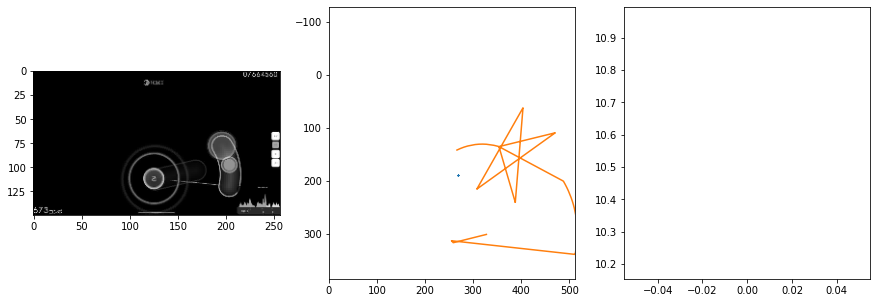


 1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.11it/s  1.3433                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 8.3934                                    
pred: 0.49307575821876526 0.5170140266418457
gt: 0.42578125 0.7526041865348816
(114, 105)


<Figure size 1080x360 with 0 Axes>

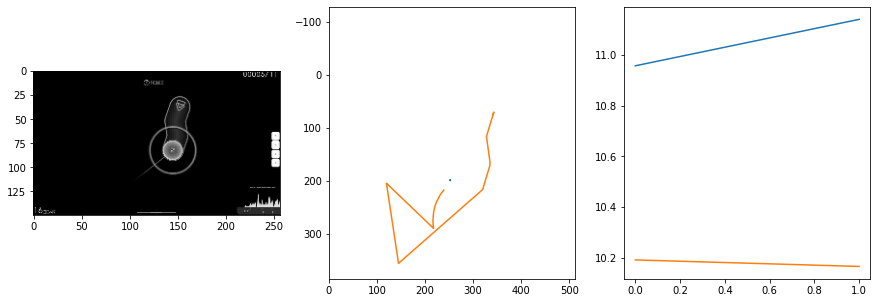


 2 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.16it/s  7.7362                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 5.5409                                    
pred: 0.3522566854953766 0.5195292234420776
gt: 0.3743533492088318 0.3519990146160126
(106, 58)


<Figure size 1080x360 with 0 Axes>

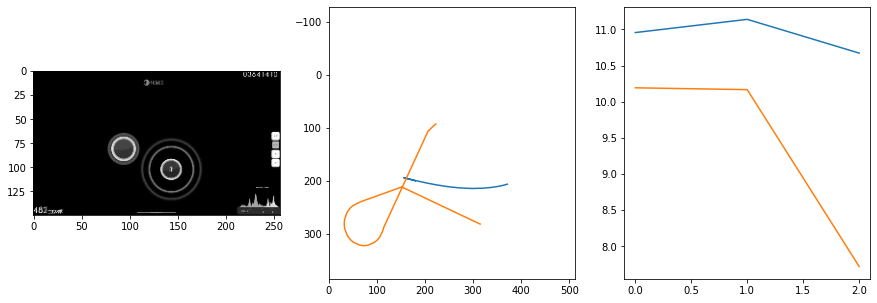


 3 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.7812                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 1.4683                                    
pred: 0.43709835410118103 0.5686779618263245
gt: 0.3186829388141632 0.5
(97, 76)


<Figure size 1080x360 with 0 Axes>

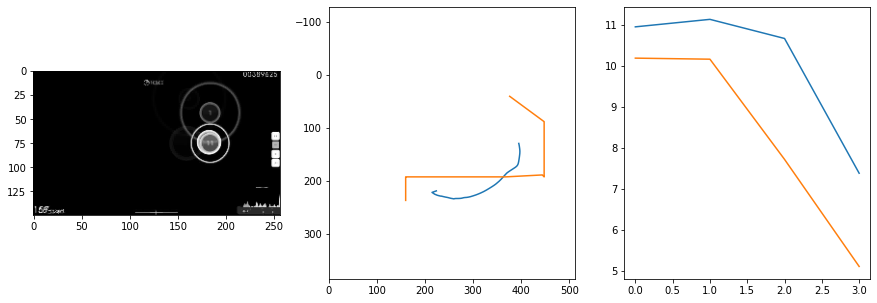


 4 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.77it/s  3.4884                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 3.0472                                    
pred: 0.34823402762413025 0.6500534415245056
gt: 0.3125 0.8020832538604736
(96, 111)


<Figure size 1080x360 with 0 Axes>

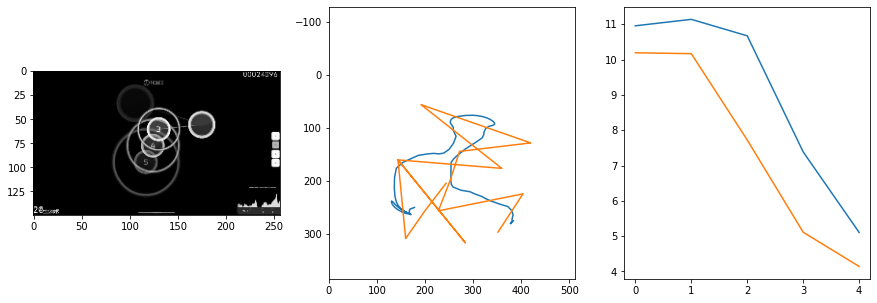


 5 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  9.8250                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 2.2469                                    
pred: 0.589531660079956 0.734221339225769
gt: 0.5351609587669373 0.8307258486747742
(130, 114)


<Figure size 1080x360 with 0 Axes>

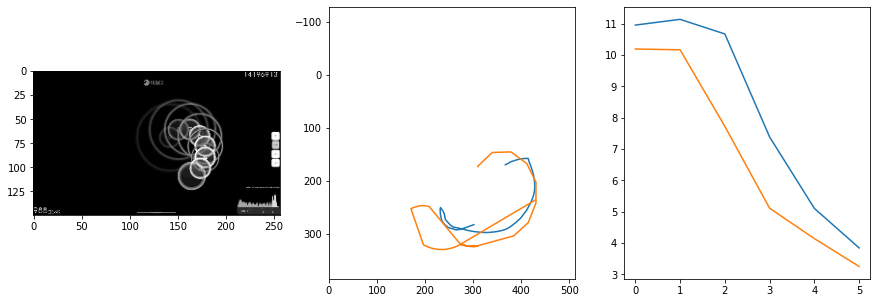


 6 of 6
195.69461178779602 secs


In [19]:
start = time.time()

epochs = 6
trainVN()

end = time.time()
print(end - start, 'secs')

In [20]:
train_hist = []
val_hist = []

1 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  2.4658                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.825421286727853
outliers: 181
retrain: 8                 
val: 50/50 loss: 1.3542                                    
pred: 0.466198593378067 0.2736540138721466
gt: 0.22886082530021667 0.2663942575454712
(83, 48)


<Figure size 1080x360 with 0 Axes>

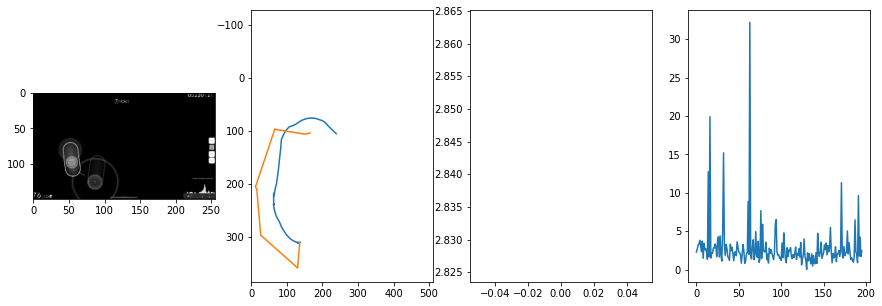


 7 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  14.1339                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.850828421207107
outliers: 58
retrain: 8                 
val: 50/50 loss: 2.1532                                    
pred: 0.5689975619316101 0.13903295993804932
gt: 0.27926987409591675 0.18756943941116333
(91, 39)


<Figure size 1080x360 with 0 Axes>

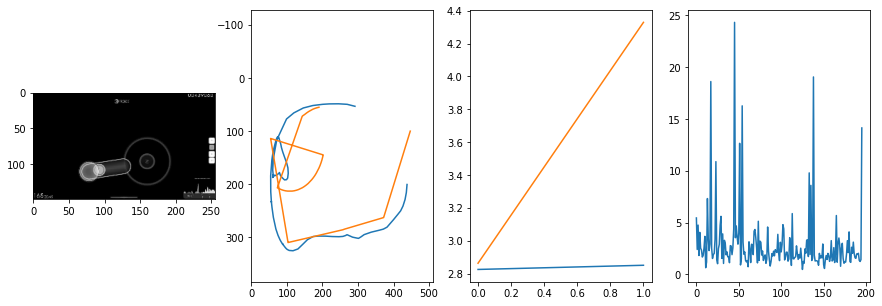


 8 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  1.1459                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.0102051774001852
outliers: 62
retrain: 8                 
val: 50/50 loss: 15.4059                                   
pred: 0.5464767813682556 0.5100486874580383
gt: 0.20836040377616882 0.5278138518333435
(80, 79)


<Figure size 1080x360 with 0 Axes>

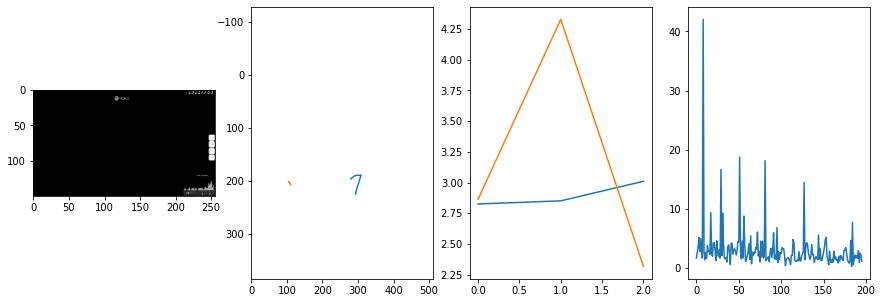


 9 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  1.5769                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2338139060504583
outliers: 30
retrain: 8                 
val: 50/50 loss: 0.9172                                    
pred: 0.3910185992717743 0.7087644934654236
gt: 0.4604201316833496 0.7602031230926514
(119, 106)


<Figure size 1080x360 with 0 Axes>

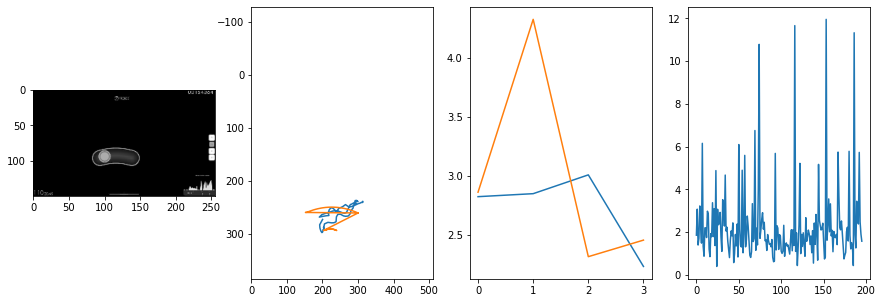


 10 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  2.3907                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.426874568419797
outliers: 70
retrain: 8                 
val: 50/50 loss: 4.0444                                    
pred: 0.2714657485485077 0.4339303970336914
gt: 0.34375 0.296875
(101, 52)


<Figure size 1080x360 with 0 Axes>

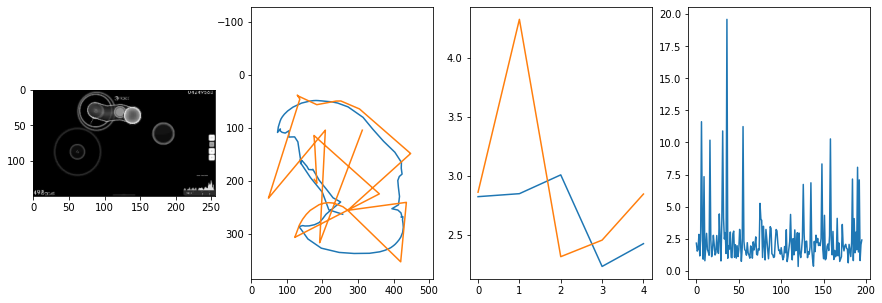


 11 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.7537                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2240942093182583
outliers: 48
retrain: 8                 
val: 50/50 loss: 2.7256                                    
pred: 0.4741266965866089 0.6579559445381165
gt: 0.43359118700027466 0.6249966025352478
(115, 90)


<Figure size 1080x360 with 0 Axes>

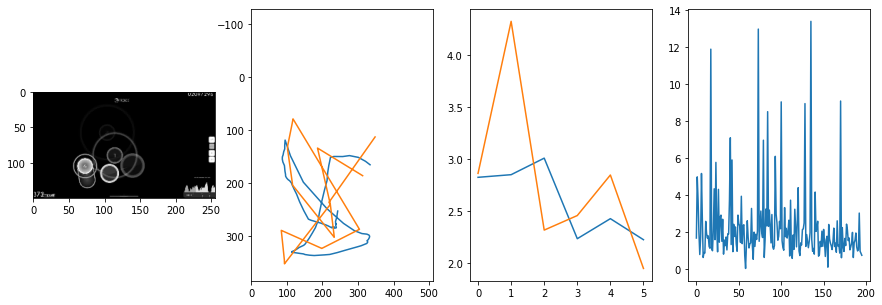


 12 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  1.3678                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.9163520185618985
outliers: 67
retrain: 8                 
val: 50/50 loss: 2.2301                                    
pred: 0.4260556399822235 0.5536098480224609
gt: 0.2889537513256073 0.302403062582016
(92, 53)


<Figure size 1080x360 with 0 Axes>

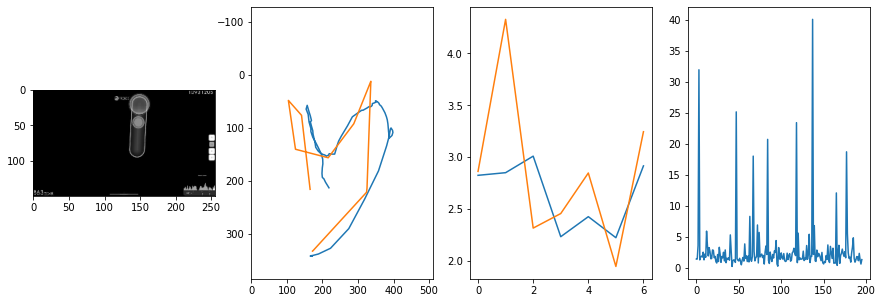


 13 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.5718                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.7945626464729405
outliers: 34
retrain: 8                 
val: 50/50 loss: 2.5435                                    
pred: 0.33576700091362 0.5794702768325806
gt: 0.5189351439476013 0.491054505109787
(128, 75)


<Figure size 1080x360 with 0 Axes>

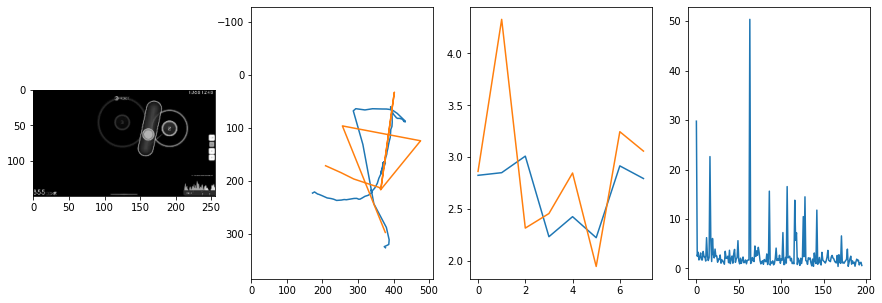


 14 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  2.0289                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.9677324319372373
outliers: 39
retrain: 8                 
val: 50/50 loss: 2.1293                                    
pred: 0.5524182915687561 0.8177680969238281
gt: 0.6928531527519226 0.8541256785392761
(155, 117)


<Figure size 1080x360 with 0 Axes>

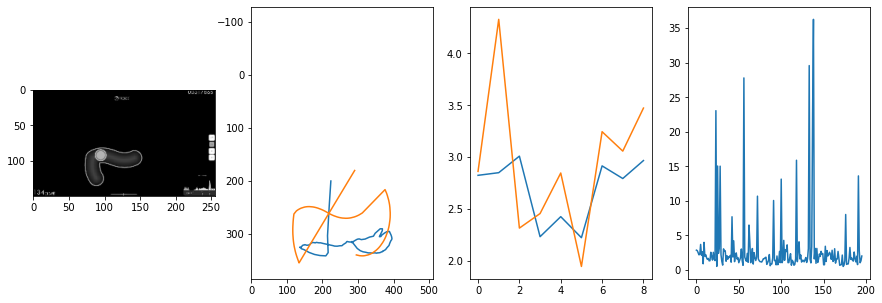


 15 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  1.5700                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.401302076724111
outliers: 42
retrain: 8                 
val: 50/50 loss: 1.9899                                    
pred: 0.39077797532081604 0.8558934330940247
gt: 0.5507804751396179 0.9661448001861572
(133, 130)


<Figure size 1080x360 with 0 Axes>

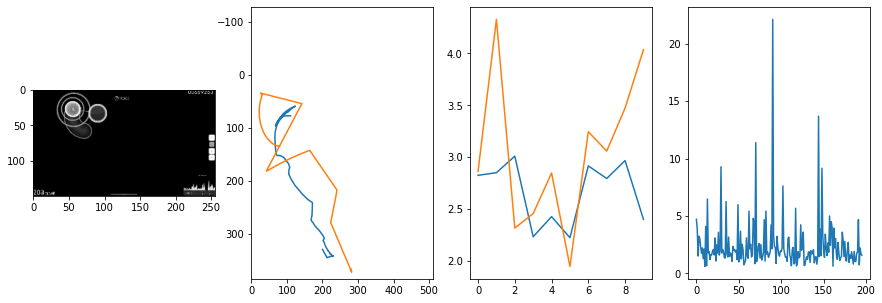


 16 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.6666                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.083331214834233
outliers: 46
retrain: 8                 
val: 50/50 loss: 2.3388                                    
pred: 0.6661255359649658 0.7417446374893188
gt: 0.49484583735466003 0.5721768736839294
(124, 84)


<Figure size 1080x360 with 0 Axes>

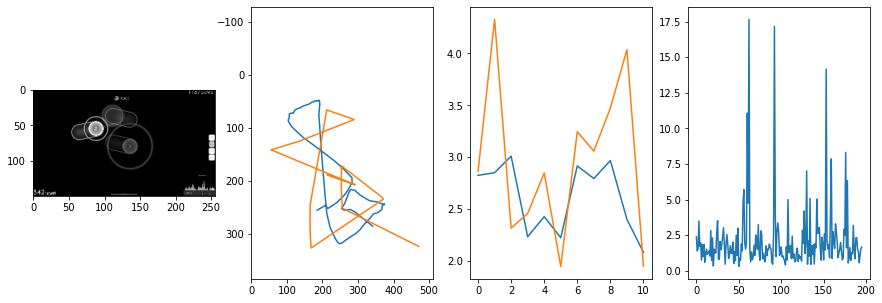


 17 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.9164                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.1320764814712563
outliers: 47
retrain: 8                 
val: 50/50 loss: 2.0783                                    
pred: 0.7408998608589172 0.3760952055454254
gt: 0.8260806202888489 0.31139805912971497
(176, 54)


<Figure size 1080x360 with 0 Axes>

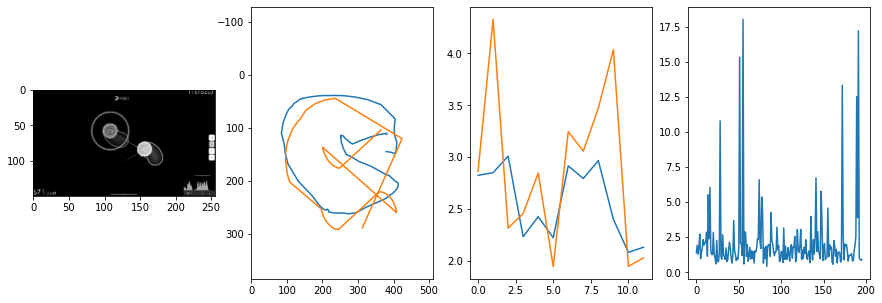


 18 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  8.8467                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2502085167382444
outliers: 50
retrain: 8                 
val: 50/50 loss: 1.4174                                    
pred: 0.09051257371902466 0.5285779237747192
gt: 0.047538191080093384 0.3247600197792053
(55, 55)


<Figure size 1080x360 with 0 Axes>

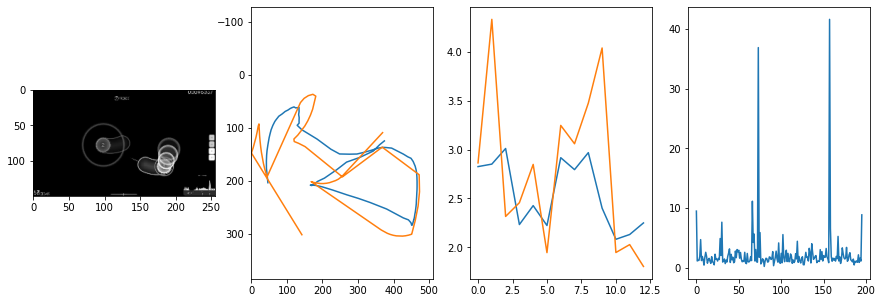


 19 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  1.1629                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.296190038019297
outliers: 52
retrain: 8                 
val: 50/50 loss: 3.7809                                    
pred: 0.4281644821166992 0.7743149995803833
gt: 0.37757185101509094 0.7510330080986023
(106, 105)


<Figure size 1080x360 with 0 Axes>

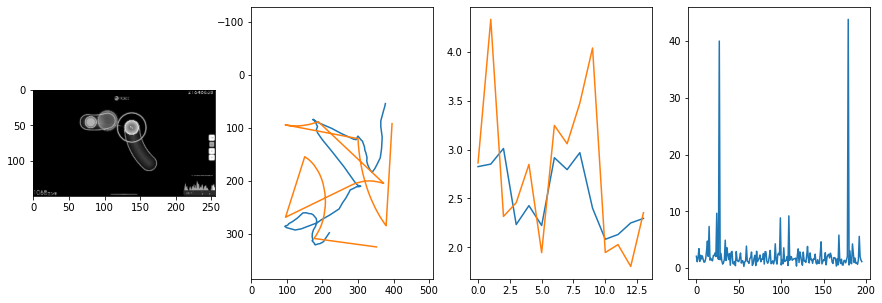


 20 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  2.4405                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.5939395987257665
outliers: 47
retrain: 8                 
val: 50/50 loss: 1.4159                                    
pred: 0.7865755558013916 0.1662612110376358
gt: 0.8367683291435242 0.2990548312664032
(177, 52)


<Figure size 1080x360 with 0 Axes>

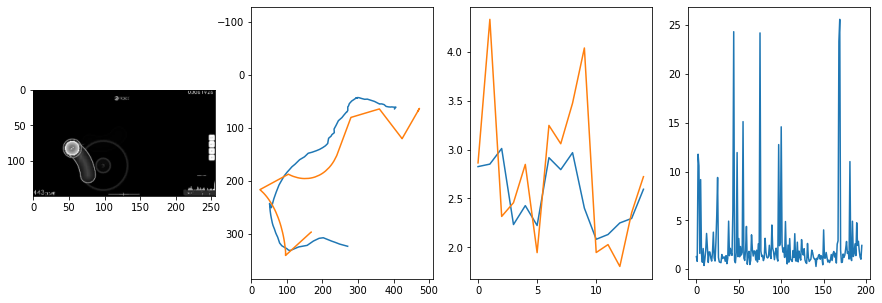


 21 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.9645                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.070699223450252
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.8860                                    
pred: 0.25442495942115784 0.5796645283699036
gt: 0.267578125 0.5989583134651184
(89, 87)


<Figure size 1080x360 with 0 Axes>

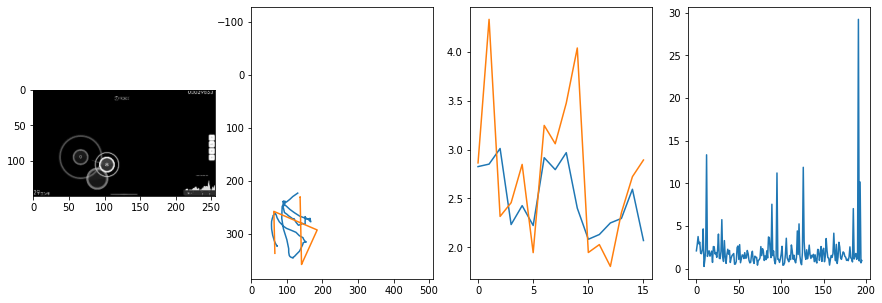


 22 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  2.1712                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7833731245933746
outliers: 42
retrain: 8                 
val: 50/50 loss: 3.2926                                    
pred: 0.34720227122306824 0.4314196705818176
gt: 0.18886351585388184 0.834186851978302
(77, 115)


<Figure size 1080x360 with 0 Axes>

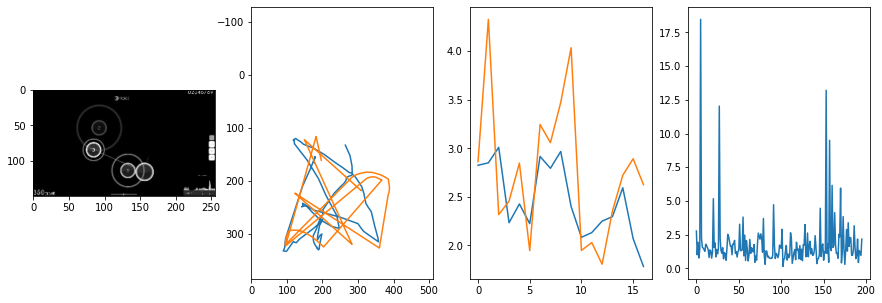


 23 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.77it/s  2.4267                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.133972999240671
outliers: 67
retrain: 8                 
val: 50/50 loss: 2.4137                                    
pred: 0.8046401143074036 0.2734699547290802
gt: 0.6856573224067688 0.48535487055778503
(154, 74)


<Figure size 1080x360 with 0 Axes>

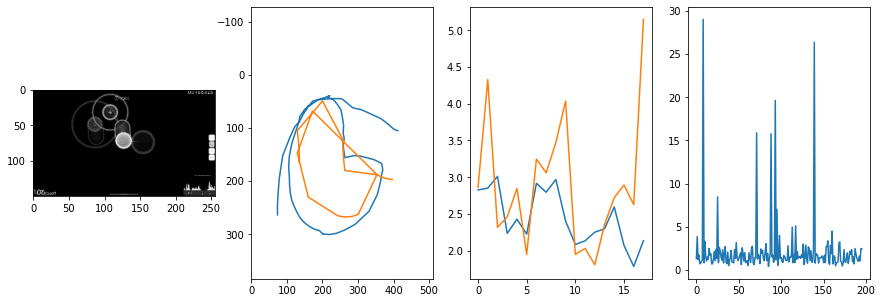


 24 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.6538                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.496882266079893
outliers: 65
retrain: 8                 
val: 50/50 loss: 2.9605                                    
pred: 0.6594258546829224 0.6909151077270508
gt: 0.7565932273864746 0.5219362378120422
(165, 78)


<Figure size 1080x360 with 0 Axes>

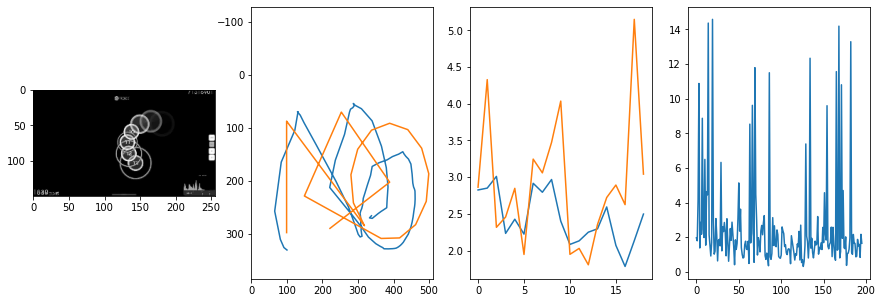


 25 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.6510                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.099566214698918
outliers: 36
retrain: 8                 
val: 50/50 loss: 0.7228                                    
pred: 0.3232063055038452 0.6438549160957336
gt: 0.427734375 0.5078125
(114, 77)


<Figure size 1080x360 with 0 Axes>

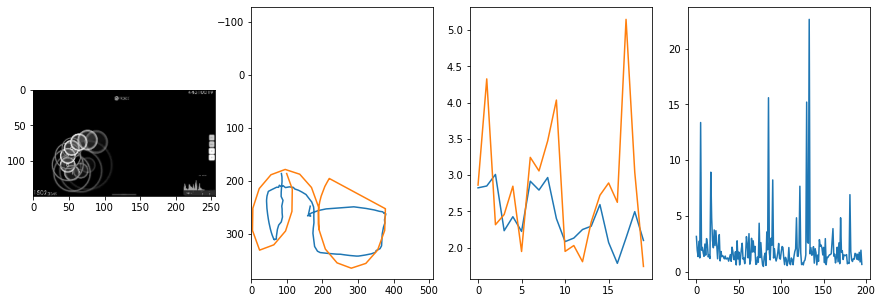


 26 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  1.5492                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2010903734029554
outliers: 46
retrain: 8                 
val: 50/50 loss: 2.3696                                    
pred: 0.7024325728416443 0.264426589012146
gt: 0.7098497748374939 0.20437055826187134
(158, 41)


<Figure size 1080x360 with 0 Axes>

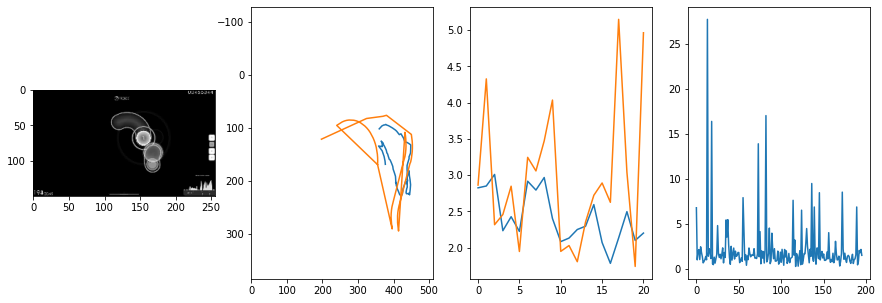


 27 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.0031                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2093730909483775
outliers: 39
retrain: 8                 
val: 50/50 loss: 1.8968                                    
pred: 0.28107813000679016 0.43576645851135254
gt: 0.3756873905658722 0.24050022661685944
(106, 45)


<Figure size 1080x360 with 0 Axes>

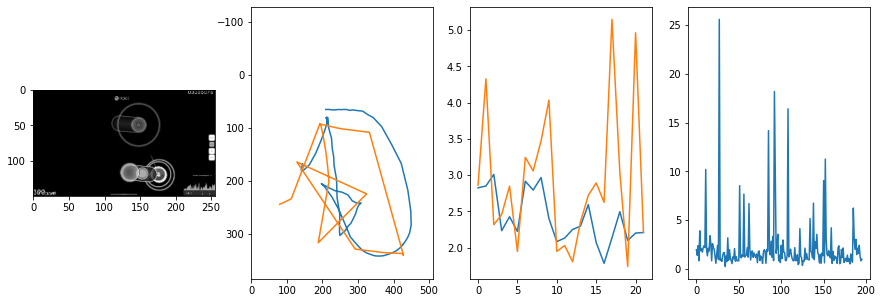


 28 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  1.1539                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.321756191703738
outliers: 44
retrain: 8                 
val: 50/50 loss: 1.4134                                    
pred: 0.16229023039340973 0.32960236072540283
gt: 0.23407664895057678 0.26936259865760803
(84, 49)


<Figure size 1080x360 with 0 Axes>

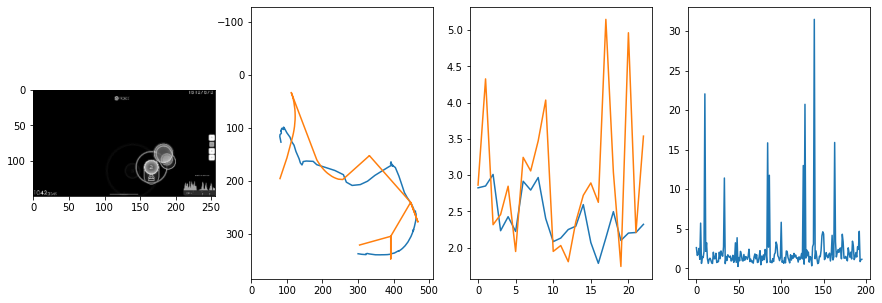


 29 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.72it/s  1.3313                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.1647473277942257
outliers: 38
retrain: 8                 
val: 50/50 loss: 2.1322                                    
pred: 0.7629199028015137 0.4758552312850952
gt: 0.6796006560325623 0.6081015467643738
(153, 88)


<Figure size 1080x360 with 0 Axes>

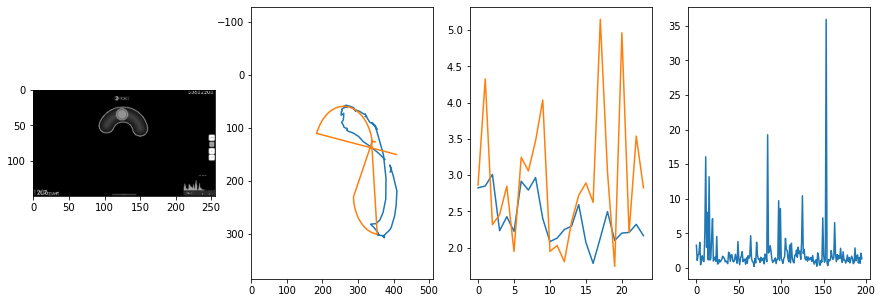


 30 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  1.0833                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.992956613931729
outliers: 36
retrain: 8                 
val: 50/50 loss: 0.8252                                    
pred: 0.43339231610298157 0.2555941939353943
gt: 0.4550783336162567 0.3411458730697632
(118, 57)


<Figure size 1080x360 with 0 Axes>

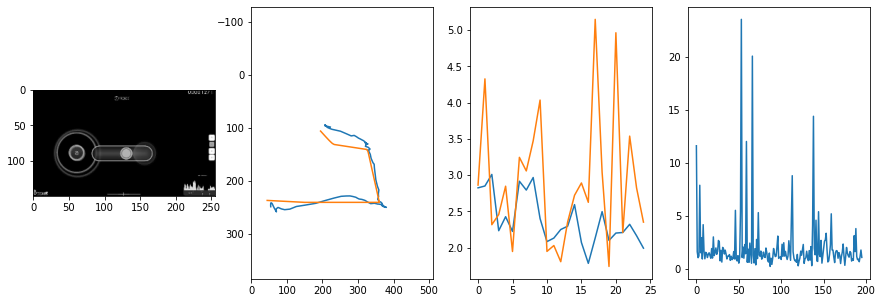


 31 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  1.0027                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.06354831508836
outliers: 42
retrain: 8                 
val: 50/50 loss: 2.8043                                    
pred: 0.5090252757072449 0.41604459285736084
gt: 0.5778613686561584 0.1080978587269783
(137, 30)


<Figure size 1080x360 with 0 Axes>

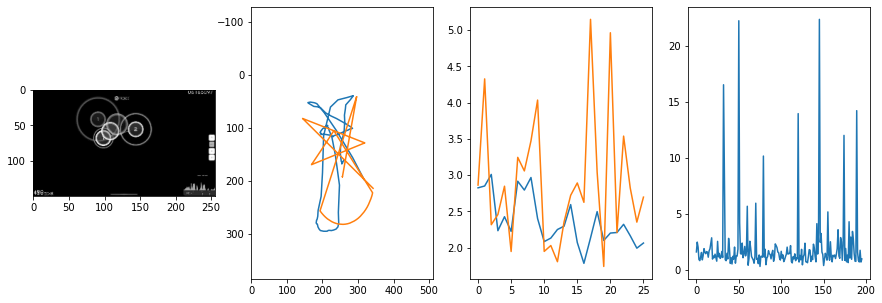


 32 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  1.5364                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.390841957105666
outliers: 44
retrain: 8                 
val: 50/50 loss: 1.5575                                    
pred: 0.4304268956184387 0.23788464069366455
gt: 0.3593378961086273 0.22268597781658173
(103, 43)


<Figure size 1080x360 with 0 Axes>

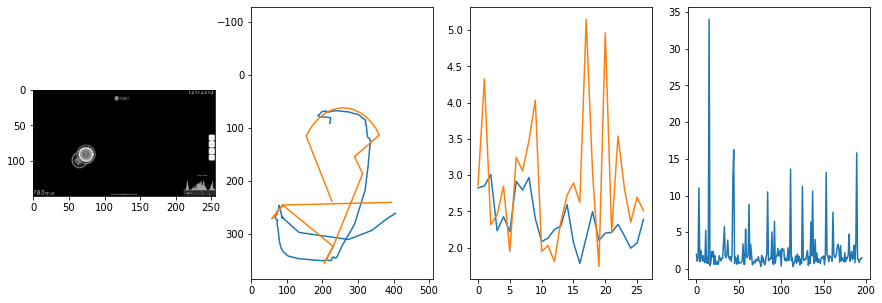


 33 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.5361                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.3371831136090413
outliers: 47
retrain: 8                 
val: 50/50 loss: 1.2684                                    
pred: 0.6773979663848877 0.6337302327156067
gt: 0.6503906846046448 0.6510417461395264
(148, 93)


<Figure size 1080x360 with 0 Axes>

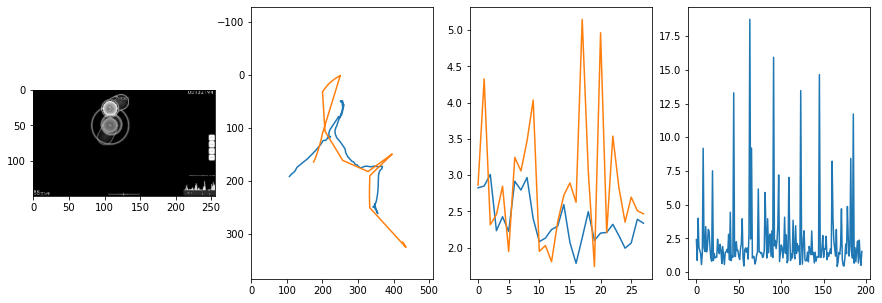


 34 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.4328                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.209446901873666
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.3948                                    
pred: 0.3473595976829529 0.8892744779586792
gt: 0.33599185943603516 0.8515190482139587
(100, 117)


<Figure size 1080x360 with 0 Axes>

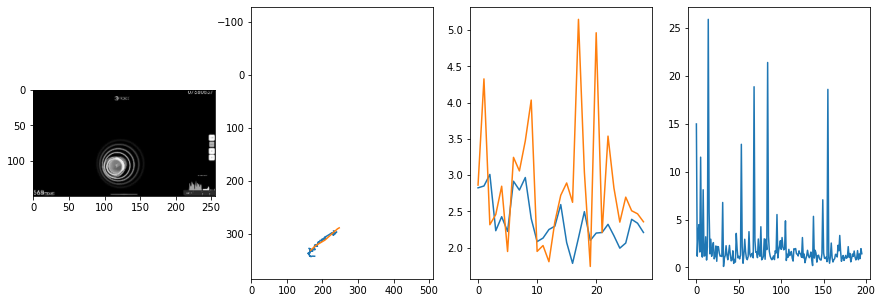


 35 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.0656                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.3118850988697033
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.7226                                    
pred: 0.5941680073738098 0.11480655521154404
gt: 0.592135488986969 0.03170148655772209
(139, 21)


<Figure size 1080x360 with 0 Axes>

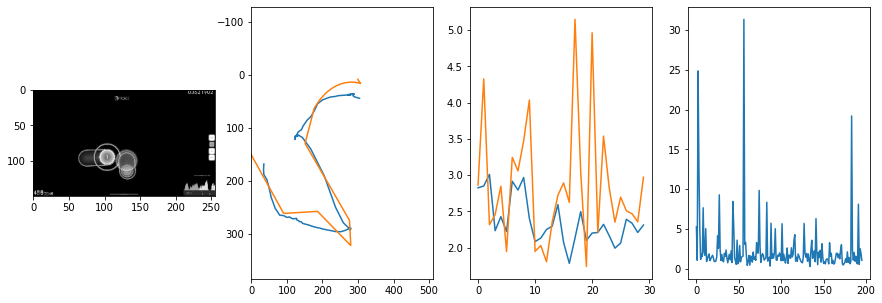


 36 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  1.5933                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.409398195238746
outliers: 28
retrain: 8                 
val: 50/50 loss: 2.1167                                    
pred: 0.6384087800979614 0.5456572771072388
gt: 0.55859375 0.6901041865348816
(134, 98)


<Figure size 1080x360 with 0 Axes>

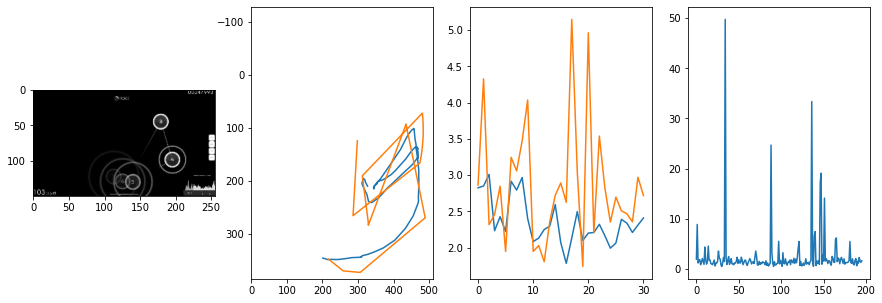


 37 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  1.7415                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0948842849620446
outliers: 34
retrain: 8                 
val: 50/50 loss: 0.8160                                    
pred: 0.8124897480010986 0.4109216630458832
gt: 0.8125 0.3333333134651184
(174, 56)


<Figure size 1080x360 with 0 Axes>

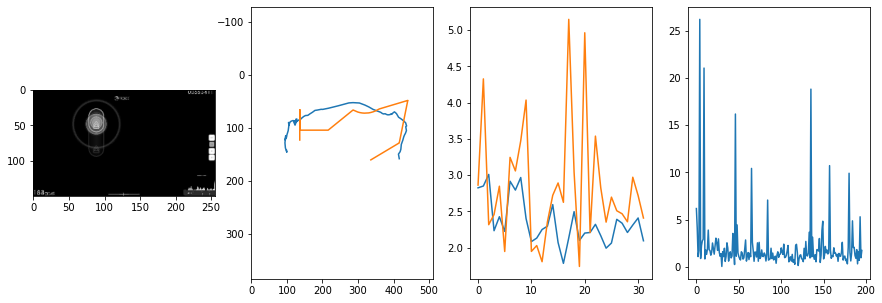


 38 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  11.1484                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.1699931288556176
outliers: 53
retrain: 8                 
val: 50/50 loss: 1.4967                                    
pred: 0.49545979499816895 0.7998042702674866
gt: 0.5037034749984741 0.6940056681632996
(126, 98)


<Figure size 1080x360 with 0 Axes>

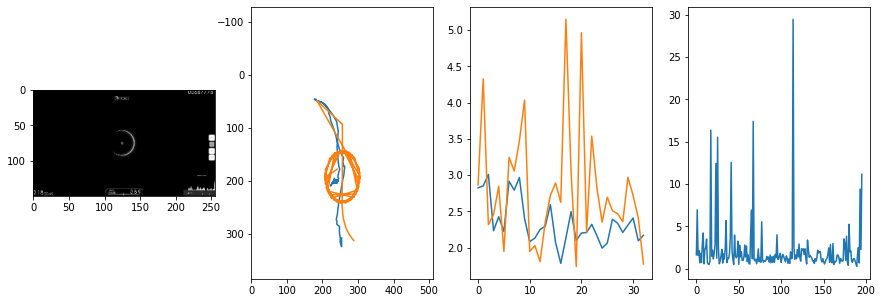


 39 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.3314                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.297478145330536
outliers: 41
retrain: 8                 
val: 50/50 loss: 1.0610                                    
pred: 0.7823864817619324 0.5853247046470642
gt: 0.8945333361625671 0.898427426815033
(186, 122)


<Figure size 1080x360 with 0 Axes>

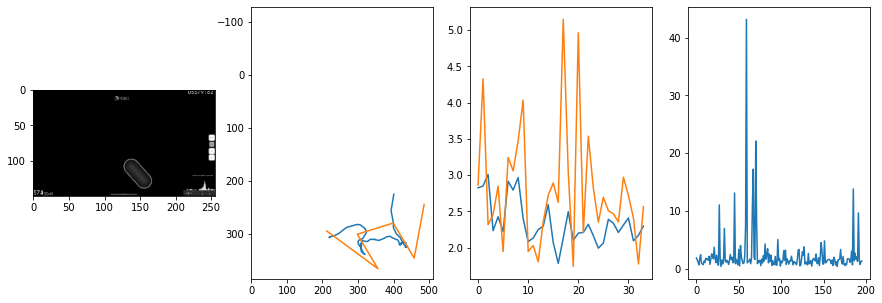


 40 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.3511                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8145560371328373
outliers: 31
retrain: 8                 
val: 50/50 loss: 1.7002                                    
pred: 0.8338474035263062 0.28932321071624756
gt: 0.7853248119354248 0.43406960368156433
(169, 68)


<Figure size 1080x360 with 0 Axes>

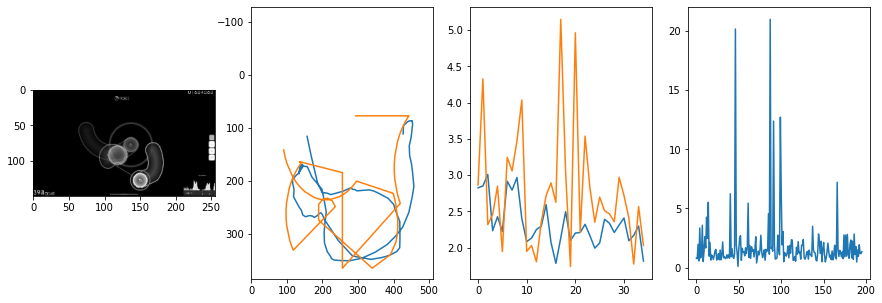


 41 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.0283                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0915299001701024
outliers: 47
retrain: 8                 
val: 50/50 loss: 1.8008                                    
pred: 0.16268548369407654 0.23492789268493652
gt: 0.2755243480205536 0.33210334181785583
(90, 56)


<Figure size 1080x360 with 0 Axes>

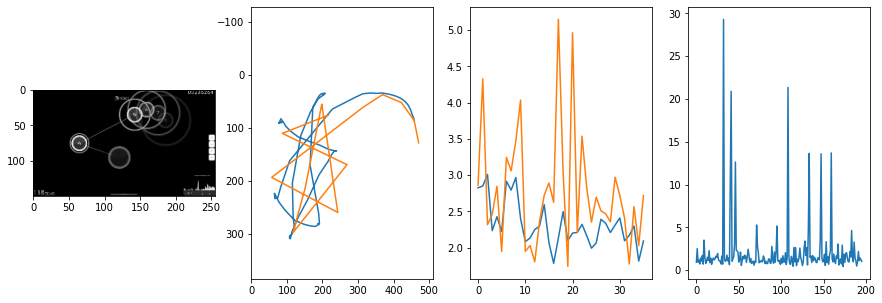


 42 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.4839                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0662203335336278
outliers: 33
retrain: 8                 
val: 50/50 loss: 1.8036                                    
pred: 0.7750275135040283 0.5370926260948181
gt: 0.6464847326278687 0.39063188433647156
(148, 63)


<Figure size 1080x360 with 0 Axes>

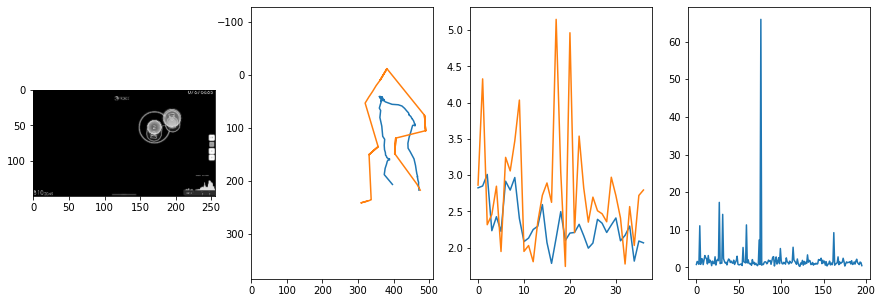


 43 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  0.8875                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6887436617089777
outliers: 27
retrain: 8                 
val: 50/50 loss: 1.1597                                    
pred: 0.18357440829277039 0.8082707524299622
gt: 0.046875 0.9088541865348816
(55, 123)


<Figure size 1080x360 with 0 Axes>

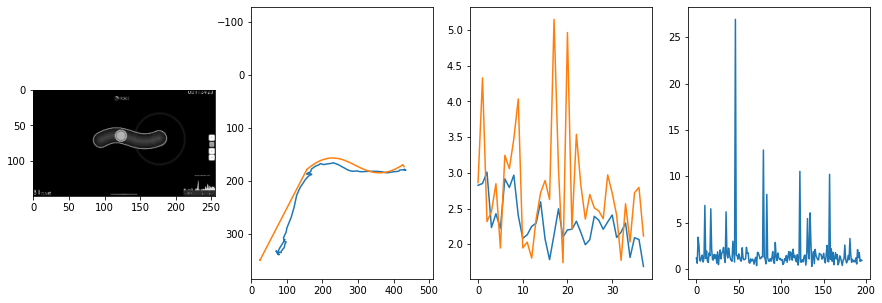


 44 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.4266                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0171531596962287
outliers: 54
retrain: 8                 
val: 50/50 loss: 2.0669                                    
pred: 0.3557242453098297 0.8997405767440796
gt: 0.5017246603965759 0.8009706139564514
(125, 111)


<Figure size 1080x360 with 0 Axes>

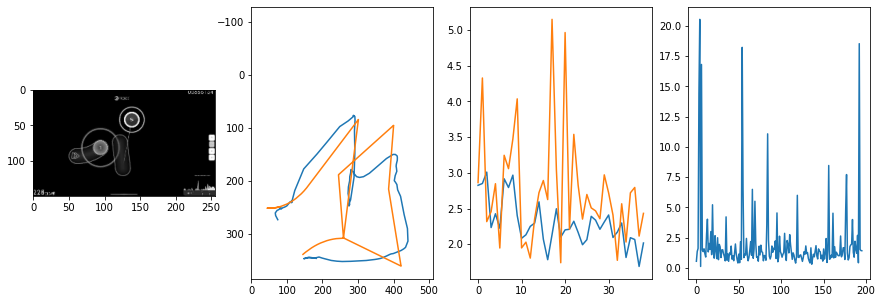


 45 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  1.4115                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.138298331322719
outliers: 39
retrain: 8                 
val: 50/50 loss: 2.1172                                    
pred: 0.5451620221138 0.891562283039093
gt: 0.7421875 0.8020833134651184
(163, 111)


<Figure size 1080x360 with 0 Axes>

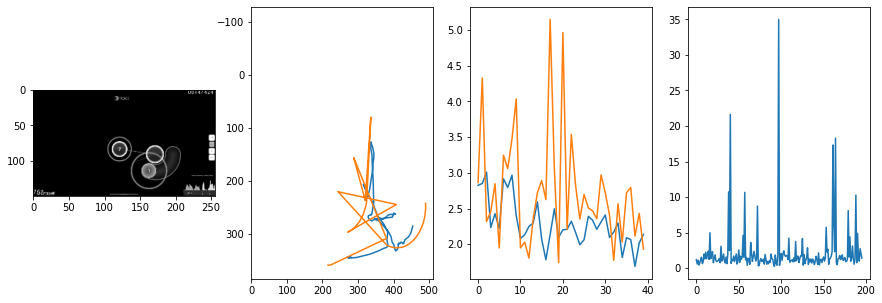


 46 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.7288                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.2443180975257135
outliers: 37
retrain: 8                 
val: 50/50 loss: 1.6548                                    
pred: 0.589756190776825 0.5431249141693115
gt: 0.5165697336196899 0.4264780580997467
(128, 67)


<Figure size 1080x360 with 0 Axes>

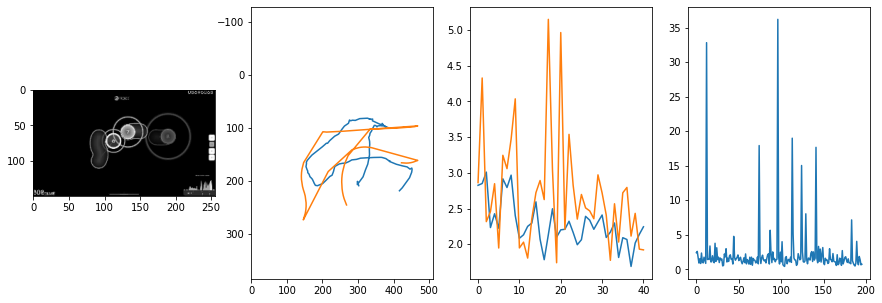


 47 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.8061                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.055249506645665
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.9954                                    
pred: 0.8734888434410095 0.18639813363552094
gt: 0.9325281381607056 0.36412060260772705
(192, 60)


<Figure size 1080x360 with 0 Axes>

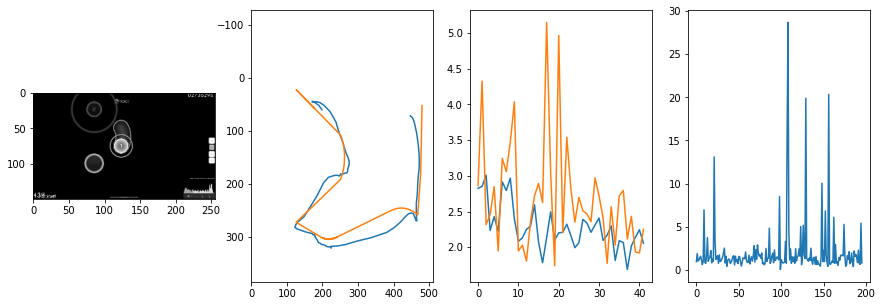


 48 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.4571                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6886814899210418
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.9942                                    
pred: 0.2830289304256439 0.7348887324333191
gt: 0.32733115553855896 0.8881236910820007
(98, 121)


<Figure size 1080x360 with 0 Axes>

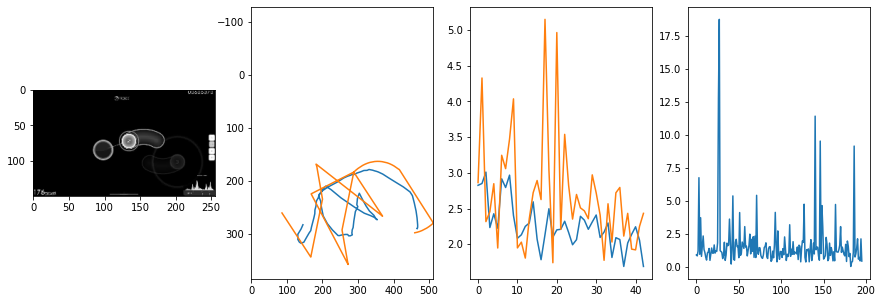


 49 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  0.8574                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.423953007146412
outliers: 43
retrain: 8                 
val: 50/50 loss: 1.3808                                    
pred: 0.5062806606292725 0.4905315935611725
gt: 0.5598900318145752 0.397152304649353
(134, 64)


<Figure size 1080x360 with 0 Axes>

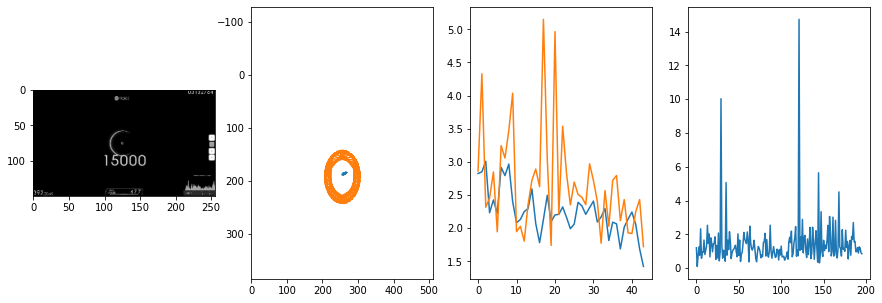


 50 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  2.6738                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.042680804294591
outliers: 89
retrain: 8                 
val: 50/50 loss: 0.9455                                    
pred: 0.5808592438697815 0.788853108882904
gt: 0.5625 0.6666666865348816
(135, 95)


<Figure size 1080x360 with 0 Axes>

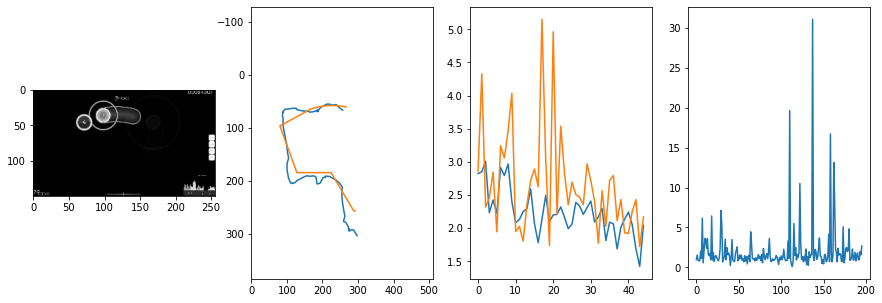


 51 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  1.3445                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8999424151011877
outliers: 30
retrain: 8                 
val: 50/50 loss: 0.8487                                    
pred: 0.6761574745178223 0.5137021541595459
gt: 0.6950486898422241 0.5122524499893188
(155, 77)


<Figure size 1080x360 with 0 Axes>

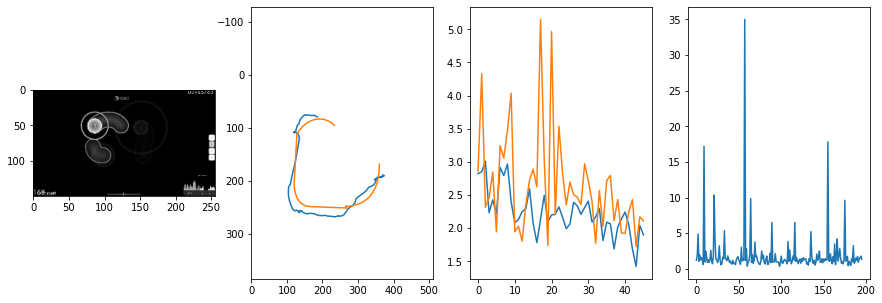


 52 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  1.3336                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6741811643753732
outliers: 36
retrain: 8                 
val: 50/50 loss: 1.7261                                    
pred: 0.4482809603214264 0.39341697096824646
gt: 0.4116038382053375 0.37162962555885315
(111, 61)


<Figure size 1080x360 with 0 Axes>

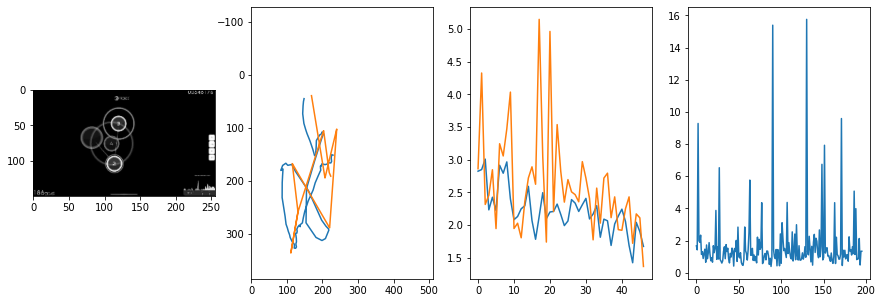


 53 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  1.5497                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7146780085654891
outliers: 47
retrain: 8                 
val: 50/50 loss: 5.2862                                    
pred: 0.8626747727394104 0.5843684673309326
gt: 0.9018642902374268 0.7726840972900391
(187, 107)


<Figure size 1080x360 with 0 Axes>

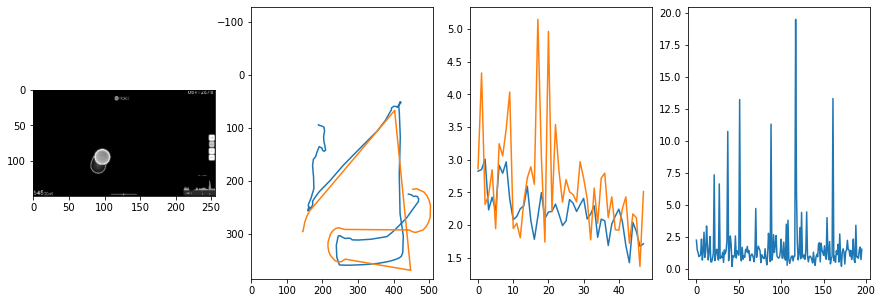


 54 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  1.6767                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.585642881007219
outliers: 36
retrain: 8                 
val: 50/50 loss: 1.9723                                    
pred: 0.27199313044548035 0.6111071109771729
gt: 0.25 0.6666666865348816
(86, 95)


<Figure size 1080x360 with 0 Axes>

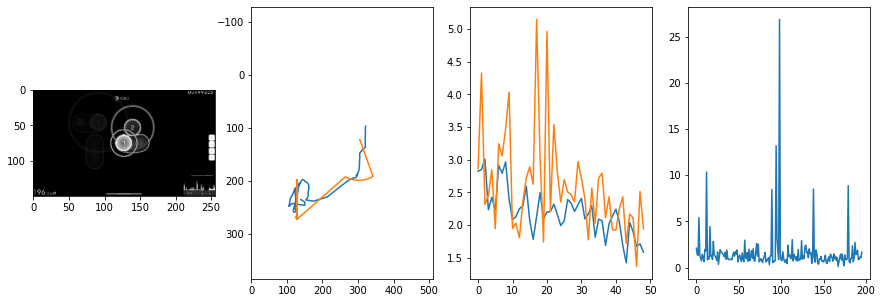


 55 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.95it/s  1.3056                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.9855249336996705
outliers: 65
retrain: 8                 
val: 50/50 loss: 1.2653                                    
pred: 0.49950137734413147 0.6502053737640381
gt: 0.5546874403953552 0.9166666865348816
(134, 124)


<Figure size 1080x360 with 0 Axes>

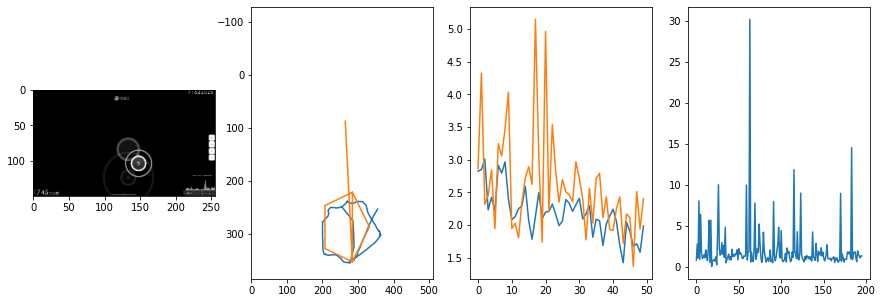


 56 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  1.8554                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7526365355873594
outliers: 34
retrain: 8                 
val: 50/50 loss: 1.3319                                    
pred: 0.3033410608768463 0.37849360704421997
gt: 0.4923359751701355 0.40098831057548523
(124, 64)


<Figure size 1080x360 with 0 Axes>

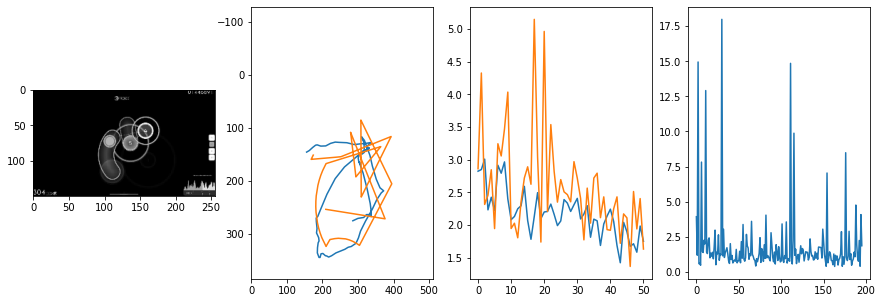


 57 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.7329                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.904030606378706
outliers: 38
retrain: 8                 
val: 50/50 loss: 1.9298                                    
pred: 0.4801425039768219 0.3116509020328522
gt: 0.5659841895103455 0.4493331015110016
(135, 70)


<Figure size 1080x360 with 0 Axes>

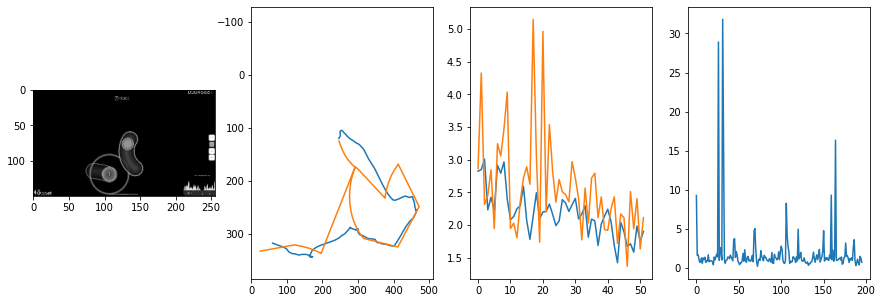


 58 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.3129                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8137161236028283
outliers: 34
retrain: 8                 
val: 50/50 loss: 0.4035                                    
pred: 0.4870333671569824 0.6915029883384705
gt: 0.60546875 0.6015625
(141, 87)


<Figure size 1080x360 with 0 Axes>

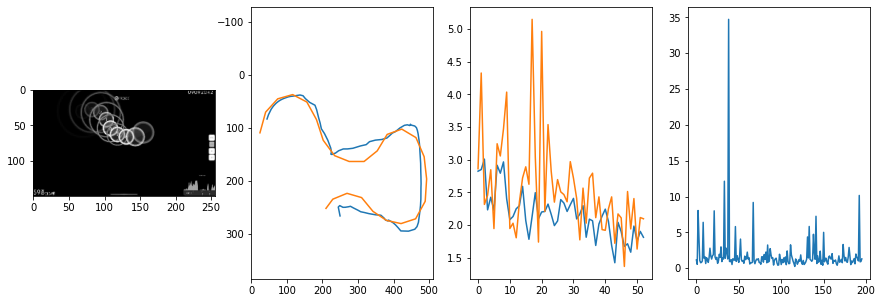


 59 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  4.8649                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8170841155307633
outliers: 41
retrain: 8                 
val: 50/50 loss: 3.0154                                    
pred: 0.5048301815986633 0.14373257756233215
gt: 0.18750014901161194 0.35937488079071045
(77, 59)


<Figure size 1080x360 with 0 Axes>

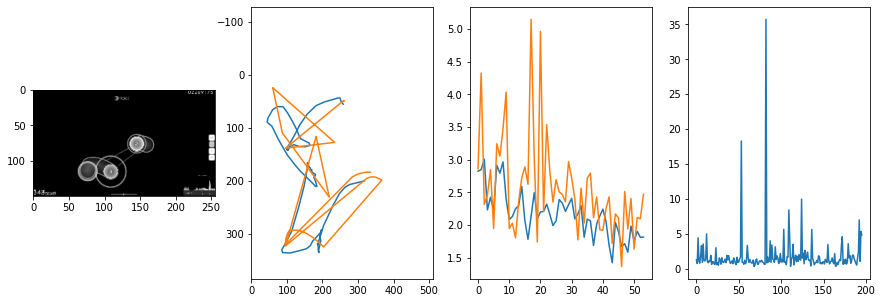


 60 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  1.6105                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7625112284202964
outliers: 34
retrain: 8                 
val: 50/50 loss: 0.7190                                    
pred: 0.7471247315406799 0.6341662406921387
gt: 0.713995099067688 0.6668636202812195
(158, 95)


<Figure size 1080x360 with 0 Axes>

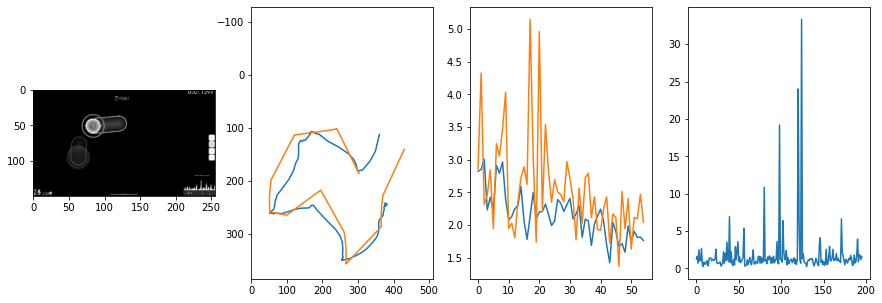


 61 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.77it/s  1.2958                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.489015770353833
outliers: 34
retrain: 8                 
val: 50/50 loss: 1.0555                                    
pred: 0.5140485763549805 0.6148079633712769
gt: 0.6159218549728394 0.3212291896343231
(143, 55)


<Figure size 1080x360 with 0 Axes>

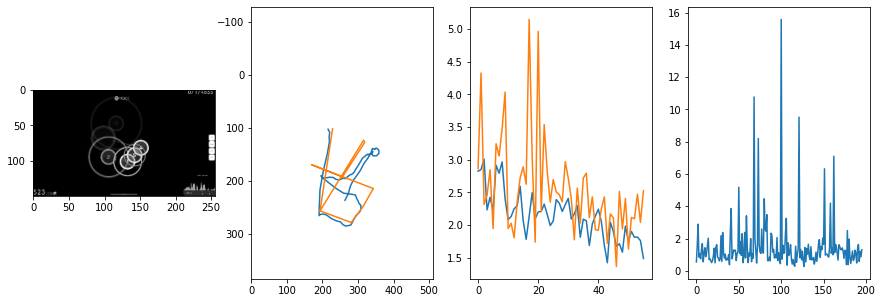


 62 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.77it/s  1.1512                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6271175122534742
outliers: 51
retrain: 8                 
val: 50/50 loss: 1.1185                                    
pred: 0.49100959300994873 0.68772292137146
gt: 0.39733442664146423 0.8623926043510437
(109, 118)


<Figure size 1080x360 with 0 Axes>

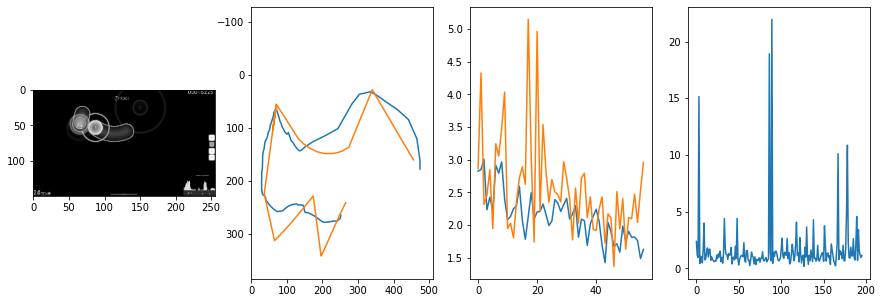


 63 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  1.0063                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7514678758321975
outliers: 47
retrain: 8                 
val: 50/50 loss: 1.2085                                    
pred: 0.1088205948472023 0.532063364982605
gt: 0.42482274770736694 0.46850597858428955
(113, 72)


<Figure size 1080x360 with 0 Axes>

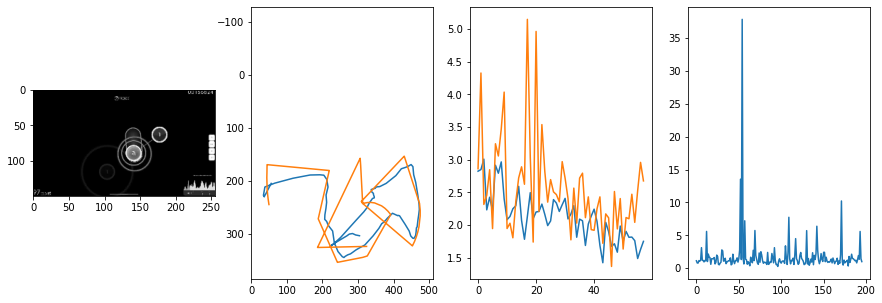


 64 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.7935                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4386868382595024
outliers: 32
retrain: 8                 
val: 50/50 loss: 3.5883                                    
pred: 0.6000805497169495 0.5628470182418823
gt: 0.6640625 0.3385416567325592
(150, 57)


<Figure size 1080x360 with 0 Axes>

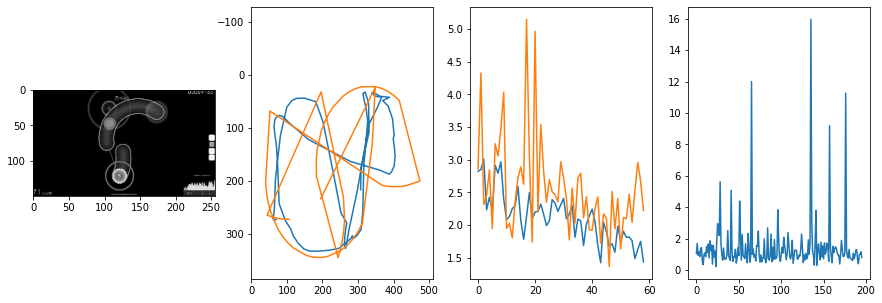


 65 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.9385                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6534550149297835
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.9908                                    
pred: 0.7218478322029114 0.8171805143356323
gt: 0.517578125 0.4947916567325592
(128, 75)


<Figure size 1080x360 with 0 Axes>

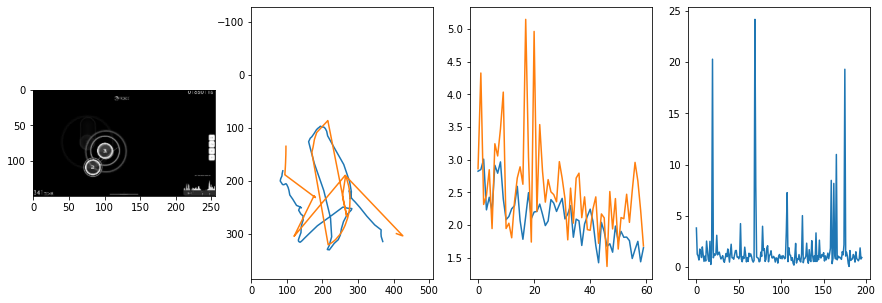


 66 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  8.2787                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.9843978437842156
outliers: 52
retrain: 8                 
val: 50/50 loss: 1.9010                                    
pred: 0.7929888367652893 0.5611706376075745
gt: 0.8127169013023376 0.6285784840583801
(174, 91)


<Figure size 1080x360 with 0 Axes>

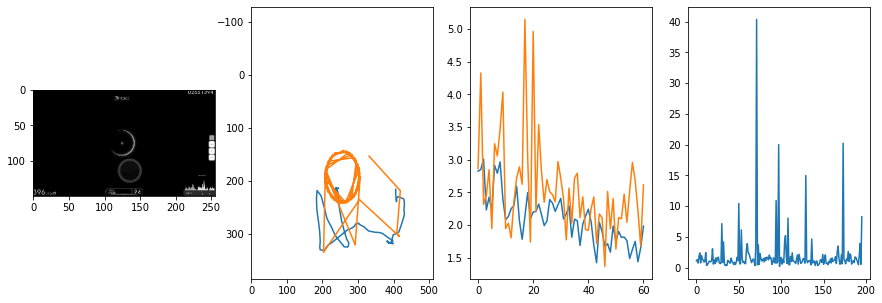


 67 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  0.6921                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.537370101206613
outliers: 41
retrain: 8                 
val: 50/50 loss: 2.1602                                    
pred: 0.31994864344596863 0.7942664623260498
gt: 0.22402629256248474 0.7265625
(82, 102)


<Figure size 1080x360 with 0 Axes>

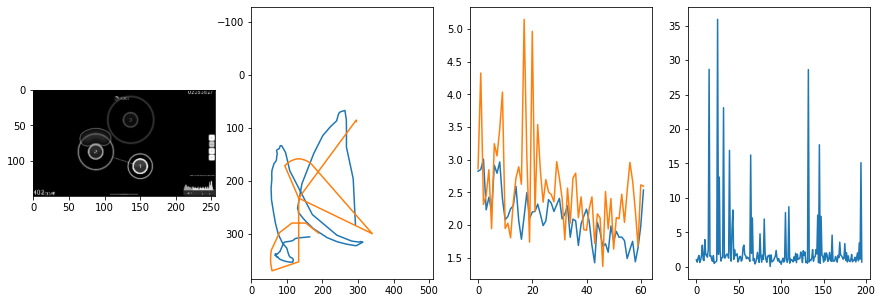


 68 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  0.3542                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.752662511200321
outliers: 21
retrain: 8                 
val: 50/50 loss: 1.1111                                    
pred: 0.5098947882652283 0.34807759523391724
gt: 0.5254123210906982 0.49217498302459717
(129, 75)


<Figure size 1080x360 with 0 Axes>

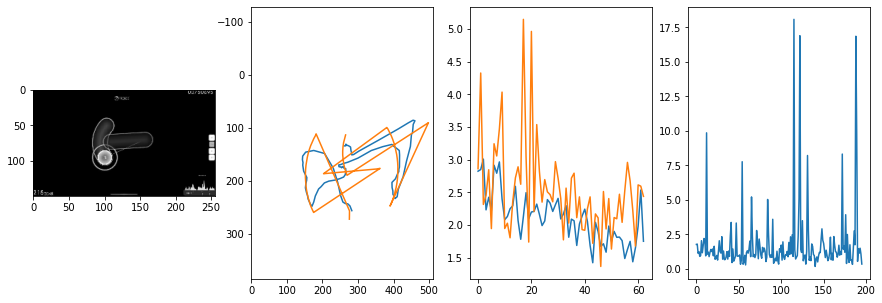


 69 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  1.0434                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.909214317646562
outliers: 35
retrain: 8                 
val: 50/50 loss: 2.7752                                    
pred: 0.10805769264698029 0.5105055570602417
gt: 0.6875 0.1666666865348816
(154, 37)


<Figure size 1080x360 with 0 Axes>

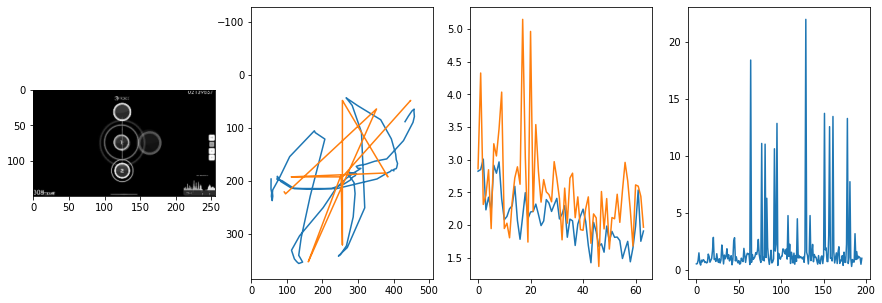


 70 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  1.4576                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7393614471871026
outliers: 33
retrain: 8                 
val: 50/50 loss: 2.0039                                    
pred: 0.2419259399175644 0.21888896822929382
gt: 0.2501143515110016 0.2291666716337204
(86, 44)


<Figure size 1080x360 with 0 Axes>

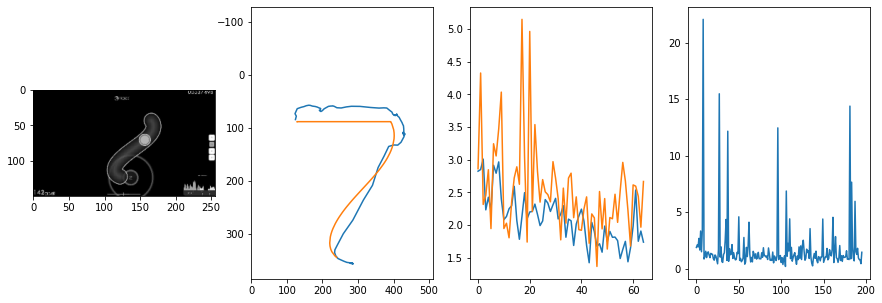


 71 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  1.9128                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.563910084339429
outliers: 33
retrain: 8                 
val: 50/50 loss: 1.6549                                    
pred: 0.49666646122932434 0.5237785577774048
gt: 0.328125 0.8125
(98, 112)


<Figure size 1080x360 with 0 Axes>

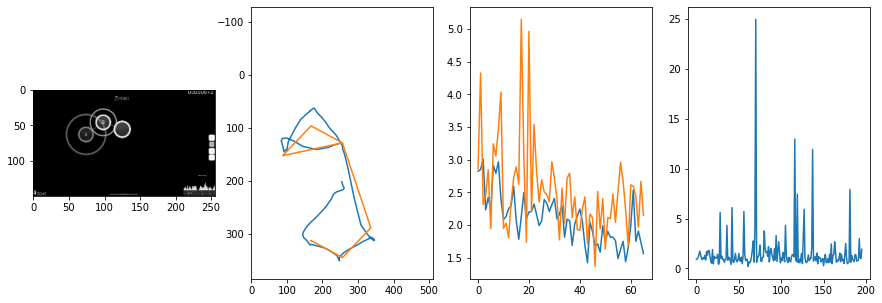


 72 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.0088                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7634454123979928
outliers: 58
retrain: 8                 
val: 50/50 loss: 1.5852                                    
pred: 0.17825686931610107 0.36323535442352295
gt: 0.74942946434021 0.40625
(164, 65)


<Figure size 1080x360 with 0 Axes>

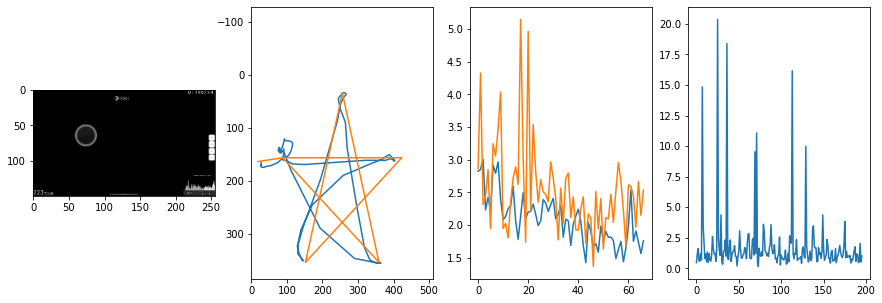


 73 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  1.3987                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4013611494126368
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.8577                                    
pred: 0.28619545698165894 0.5577024817466736
gt: 0.26562440395355225 0.5312484502792358
(89, 79)


<Figure size 1080x360 with 0 Axes>

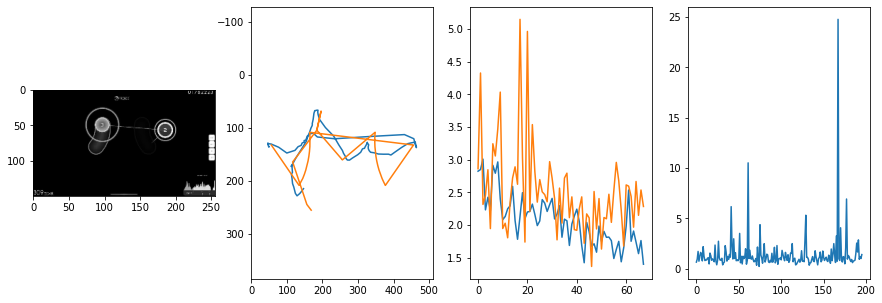


 74 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.6862                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.5082701429420589
outliers: 49
retrain: 8                 
val: 50/50 loss: 1.2815                                    
pred: 0.7132418155670166 0.7997717261314392
gt: 0.7805945873260498 0.4758114814758301
(169, 73)


<Figure size 1080x360 with 0 Axes>

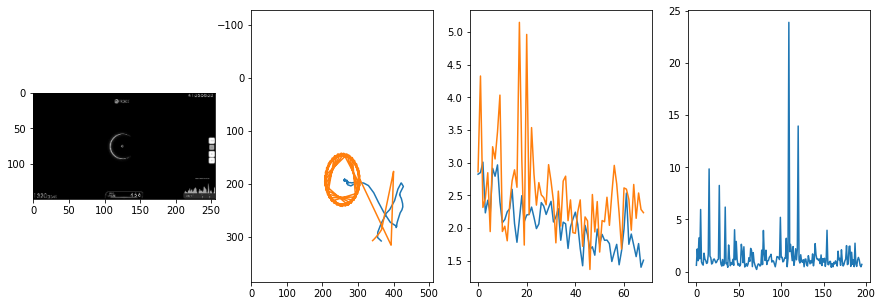


 75 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  5.7138                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6895455442825142
outliers: 45
retrain: 8                 
val: 50/50 loss: 1.2733                                    
pred: 0.2414410561323166 0.7793004512786865
gt: 0.6249996423721313 0.12500061094760895
(144, 32)


<Figure size 1080x360 with 0 Axes>

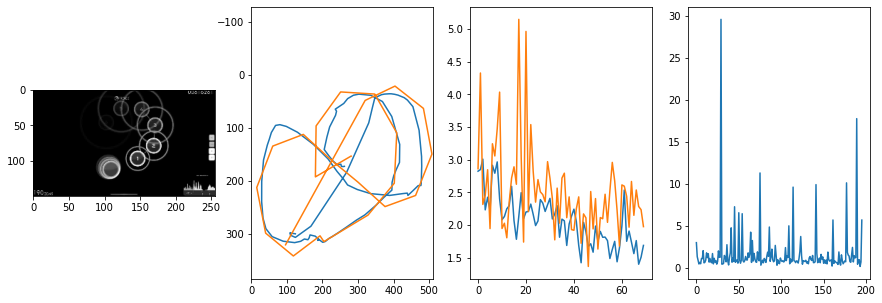


 76 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  0.6732                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.5678324665570138
outliers: 36
retrain: 8                 
val: 50/50 loss: 1.0570                                    
pred: 0.7041906714439392 0.5302577018737793
gt: 0.681640625 0.5442708134651184
(153, 81)


<Figure size 1080x360 with 0 Axes>

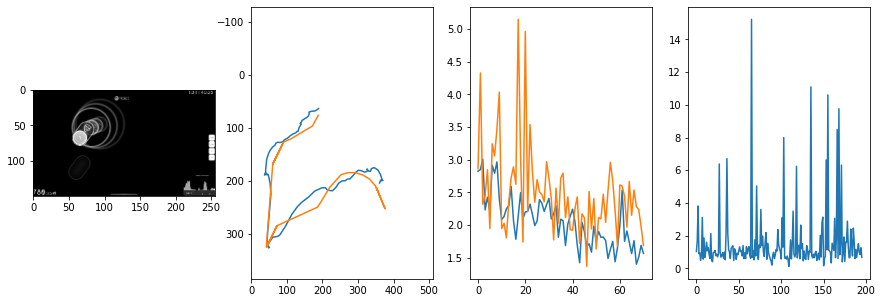


 77 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.8280                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7362460548780403
outliers: 45
retrain: 8                 
val: 50/50 loss: 1.1901                                    
pred: 0.6013737320899963 0.3807852864265442
gt: 0.5336445569992065 0.20347051322460175
(130, 41)


<Figure size 1080x360 with 0 Axes>

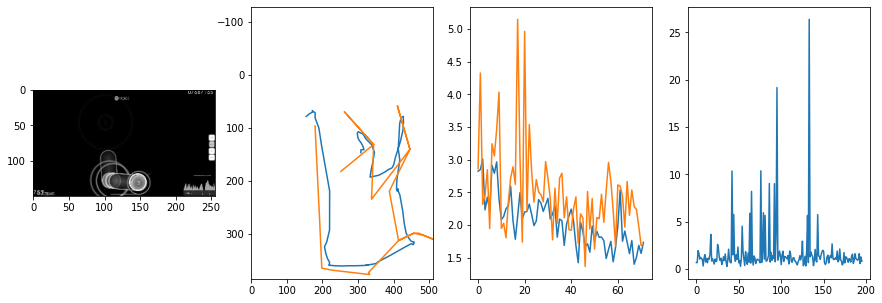


 78 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.2705                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.5233149964894568
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.8668                                    
pred: 0.5592671632766724 0.4778536558151245
gt: 0.6763292551040649 0.4860468804836273
(152, 74)


<Figure size 1080x360 with 0 Axes>

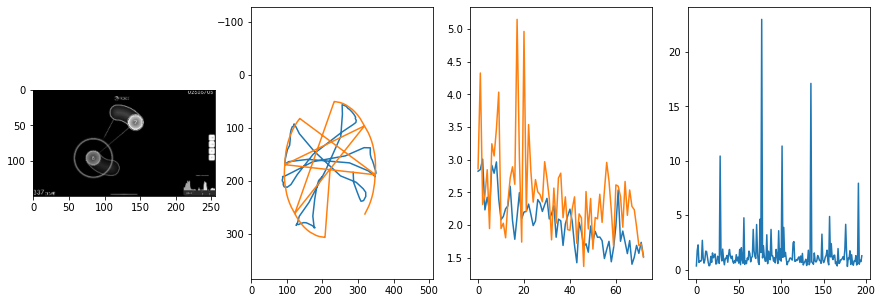


 79 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.7192                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.9647728993880504
outliers: 49
retrain: 8                 
val: 50/50 loss: 1.5813                                    
pred: 0.4428209066390991 0.29653340578079224
gt: 0.5683698654174805 0.17187631130218506
(136, 37)


<Figure size 1080x360 with 0 Axes>

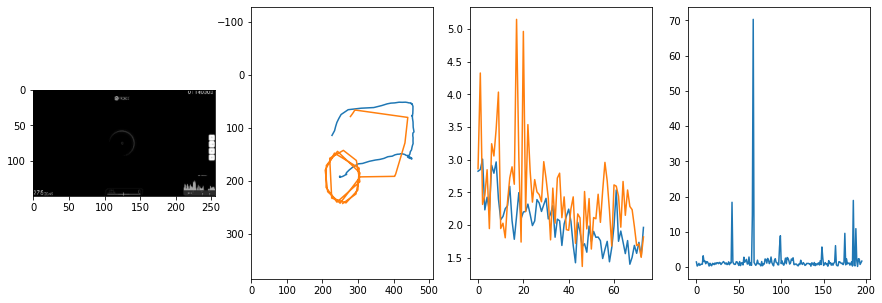


 80 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.6008                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7108527995189842
outliers: 19
retrain: 8                 
val: 50/50 loss: 0.5098                                    
pred: 0.5811272859573364 0.3643645644187927
gt: 0.6335909962654114 0.348302960395813
(146, 58)


<Figure size 1080x360 with 0 Axes>

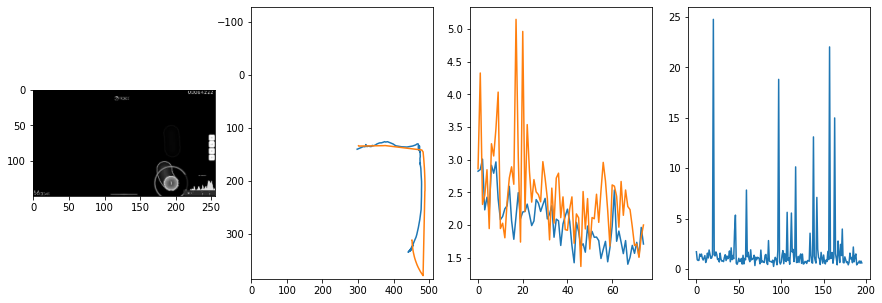


 81 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  0.9521                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6943518973278755
outliers: 39
retrain: 8                 
val: 50/50 loss: 1.6394                                    
pred: 0.5177534818649292 0.24789689481258392
gt: 0.3158894181251526 0.19595001637935638
(96, 40)


<Figure size 1080x360 with 0 Axes>

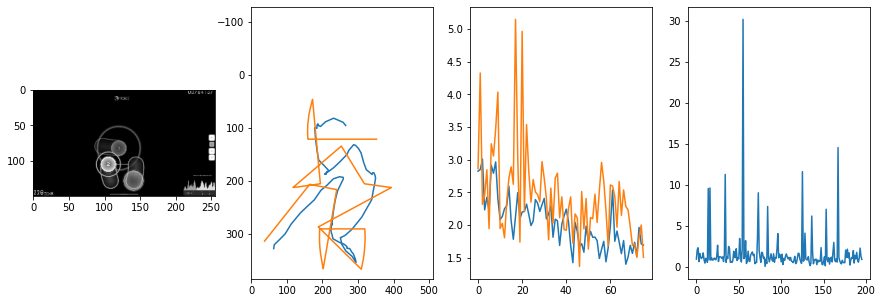


 82 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.3685                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.9598614573478699
outliers: 50
retrain: 8                 
val: 50/50 loss: 7.1941                                    
pred: 0.6154801845550537 0.529873788356781
gt: 0.36522406339645386 0.7291409373283386
(104, 102)


<Figure size 1080x360 with 0 Axes>

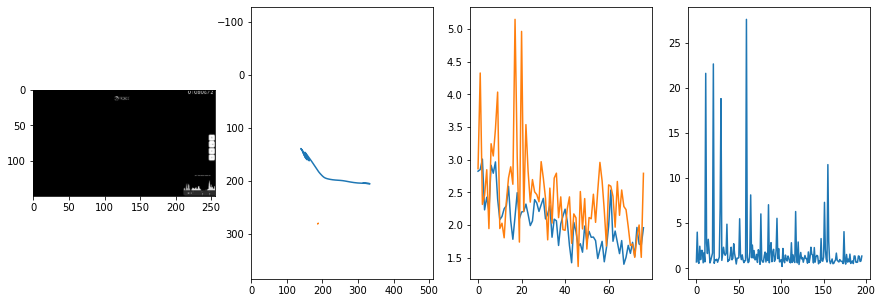


 83 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.4727                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4957573982525845
outliers: 22
retrain: 8                 
val: 50/50 loss: 0.5630                                    
pred: 0.5252039432525635 0.13193173706531525
gt: 0.125 0.5208333134651184
(67, 78)


<Figure size 1080x360 with 0 Axes>

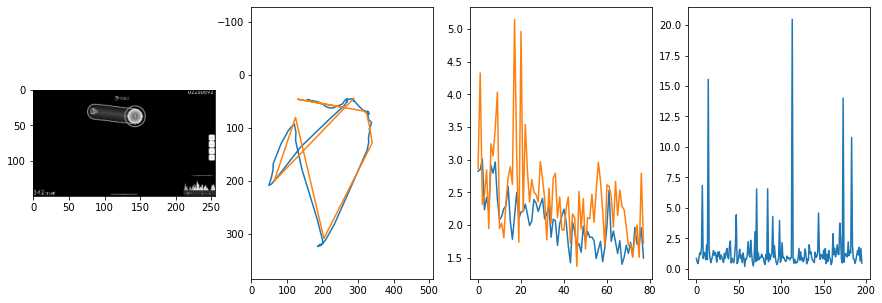


 84 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  1.0051                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8634224009453033
outliers: 56
retrain: 8                 
val: 50/50 loss: 0.8282                                    
pred: 0.7437377572059631 0.7201033234596252
gt: 0.7475647926330566 0.6580886244773865
(163, 94)


<Figure size 1080x360 with 0 Axes>

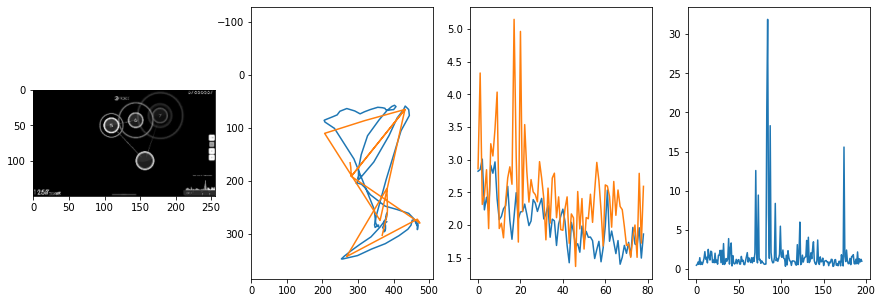


 85 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.5458                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0103050427777425
outliers: 33
retrain: 8                 
val: 50/50 loss: 3.8283                                    
pred: 0.5178974270820618 0.599622368812561
gt: 0.4466560184955597 0.39093396067619324
(117, 63)


<Figure size 1080x360 with 0 Axes>

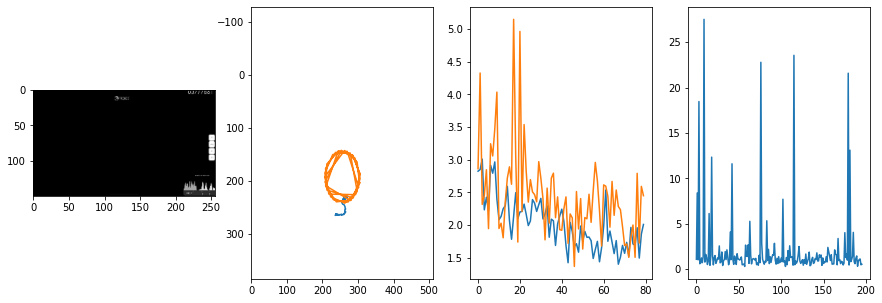


 86 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.5284                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.4504096733064067
outliers: 36
retrain: 8                 
val: 50/50 loss: 0.8596                                    
pred: 0.843583345413208 0.8591971397399902
gt: 0.8828125 0.8098958134651184
(184, 112)


<Figure size 1080x360 with 0 Axes>

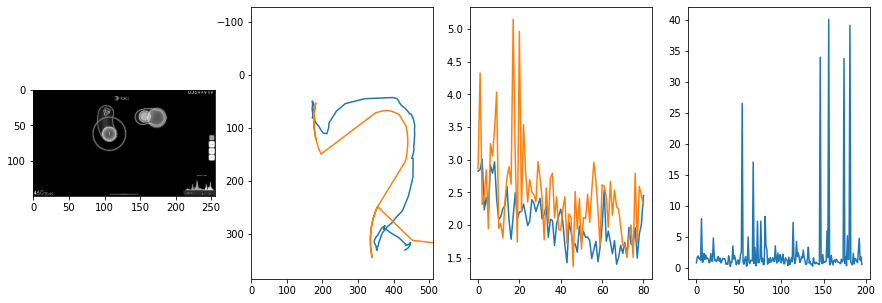


 87 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  6.8431                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.545157077057021
outliers: 18
retrain: 8                 
val: 50/50 loss: 2.0544                                    
pred: 0.5700761079788208 0.17219270765781403
gt: 0.640625 0.2291666716337204
(147, 44)


<Figure size 1080x360 with 0 Axes>

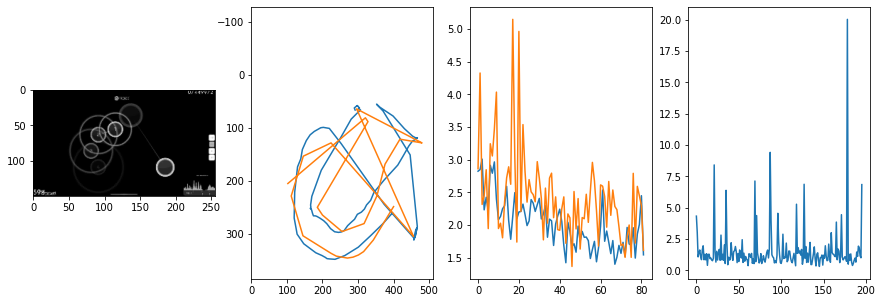


 88 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  2.7684                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8264896753339135
outliers: 46
retrain: 8                 
val: 50/50 loss: 1.1062                                    
pred: 0.15067943930625916 0.8848944902420044
gt: 0.12109375 0.6510416865348816
(66, 93)


<Figure size 1080x360 with 0 Axes>

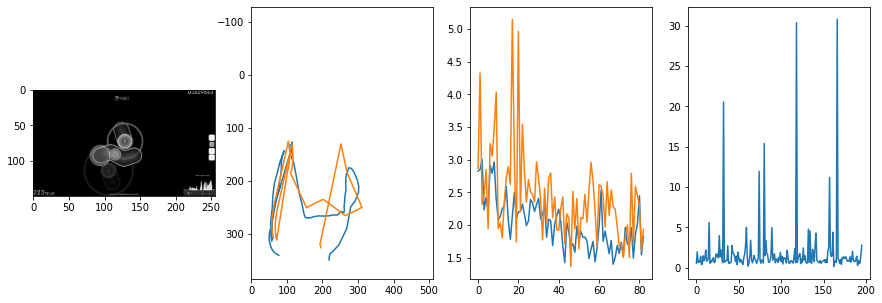


 89 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  3.2922                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.730645905914051
outliers: 29
retrain: 8                 
val: 50/50 loss: 0.8771                                    
pred: 0.11243979632854462 0.5292088985443115
gt: 0.20737814903259277 0.6743332743644714
(80, 96)


<Figure size 1080x360 with 0 Axes>

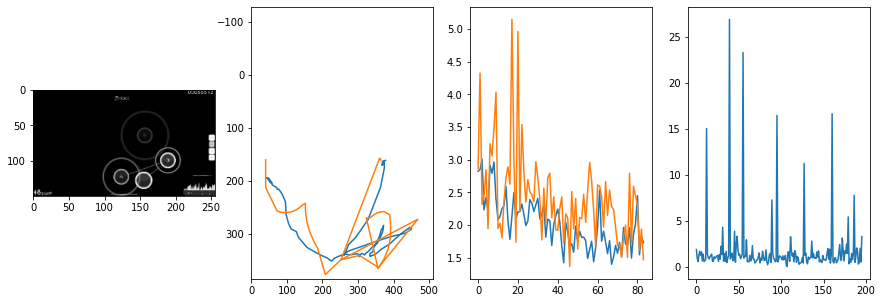


 90 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  0.7294                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6953889497232681
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.5515                                    
pred: 0.7606585025787354 0.444799542427063
gt: 0.809281051158905 0.4045622646808624
(173, 65)


<Figure size 1080x360 with 0 Axes>

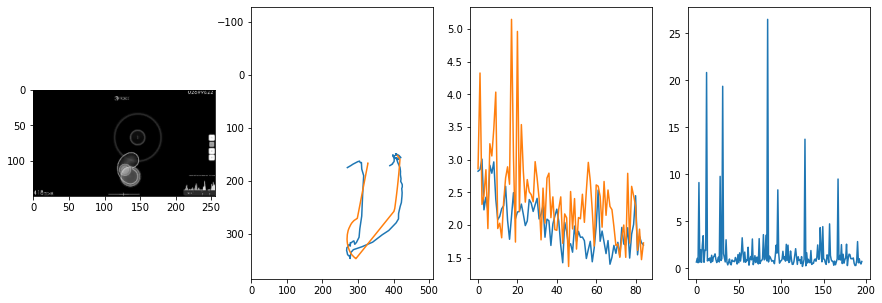


 91 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  4.8521                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7791642880409348
outliers: 38
retrain: 8                 
val: 50/50 loss: 1.2756                                    
pred: 0.11596187949180603 0.5311463475227356
gt: 0.21679790318012238 0.8203137516975403
(81, 113)


<Figure size 1080x360 with 0 Axes>

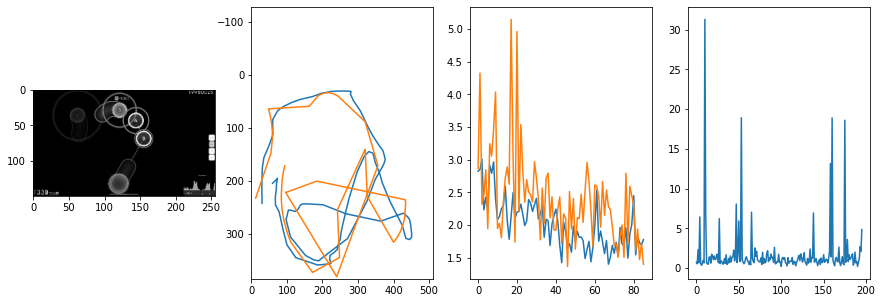


 92 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.6649                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.432019259020382
outliers: 26
retrain: 8                 
val: 50/50 loss: 0.5442                                    
pred: 0.6608660817146301 0.8936475515365601
gt: 0.5561503171920776 0.7550070285797119
(134, 105)


<Figure size 1080x360 with 0 Axes>

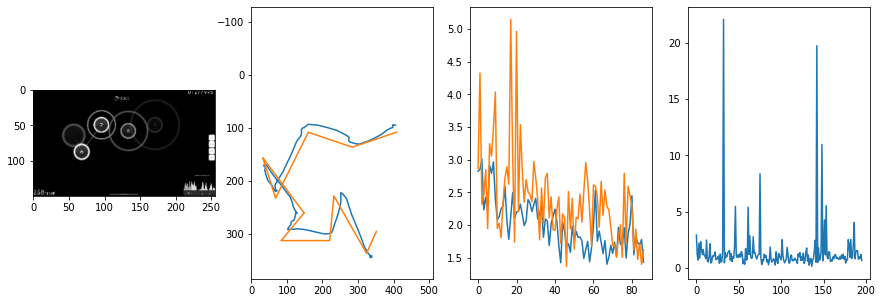


 93 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  28.2718                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.712868875234711
outliers: 43
retrain: 8                 
val: 50/50 loss: 1.3907                                    
pred: 0.25113150477409363 0.5637481212615967
gt: 0.18359375 0.4453125
(76, 69)


<Figure size 1080x360 with 0 Axes>

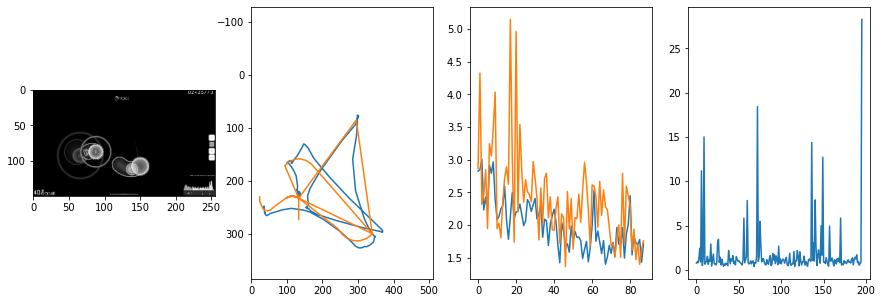


 94 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  1.0600                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.464093980588475
outliers: 30
retrain: 8                 
val: 50/50 loss: 2.3393                                    
pred: 0.572784960269928 0.7911359667778015
gt: 0.5367754697799683 0.7237681746482849
(131, 102)


<Figure size 1080x360 with 0 Axes>

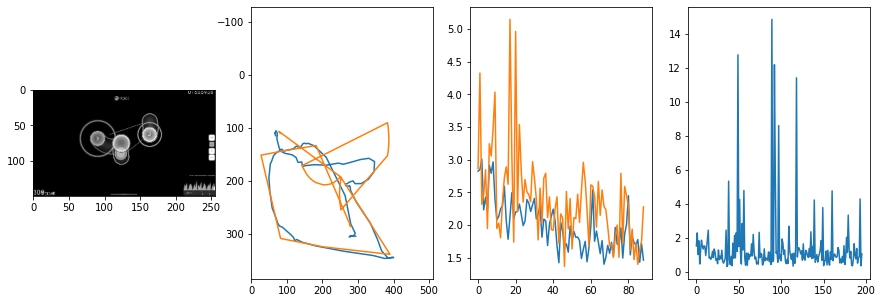


 95 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  1.2357                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.893362249646868
outliers: 48
retrain: 8                 
val: 50/50 loss: 2.4199                                    
pred: 0.927442193031311 0.373593270778656
gt: 0.921875 0.46875
(190, 72)


<Figure size 1080x360 with 0 Axes>

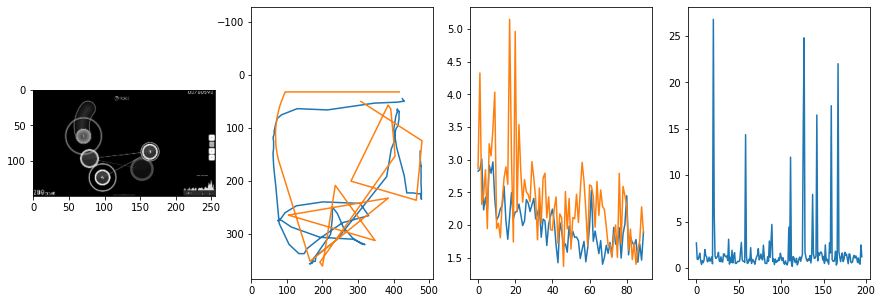


 96 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  0.8747                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.953952076483746
outliers: 30
retrain: 8                 
val: 50/50 loss: 2.3143                                    
pred: 0.6491361856460571 0.2054324746131897
gt: 0.7890517115592957 0.3541649878025055
(170, 59)


<Figure size 1080x360 with 0 Axes>

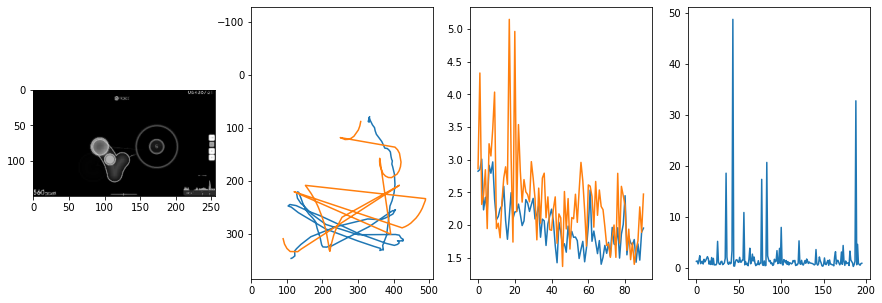


 97 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  1.0770                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.3562327629449416
outliers: 20
retrain: 8                 
val: 50/50 loss: 1.4398                                    
pred: 0.0887296050786972 0.4664095342159271
gt: 2.4962213629464713e-08 0.8489583134651184
(48, 116)


<Figure size 1080x360 with 0 Axes>

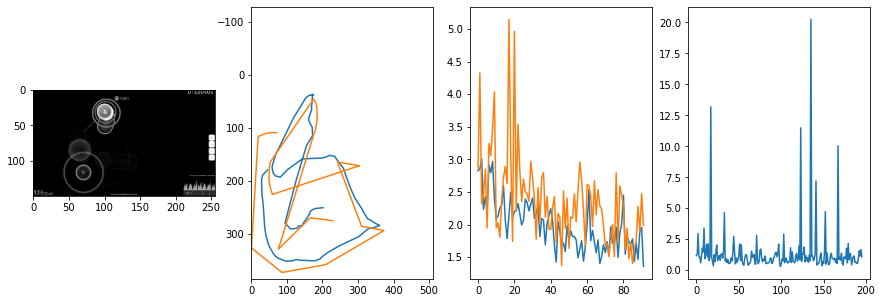


 98 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  2.0972                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.432819649197009
outliers: 44
retrain: 8                 
val: 50/50 loss: 1.5141                                    
pred: 0.4478807747364044 0.5142014622688293
gt: 0.4570978283882141 0.3830297291278839
(118, 62)


<Figure size 1080x360 with 0 Axes>

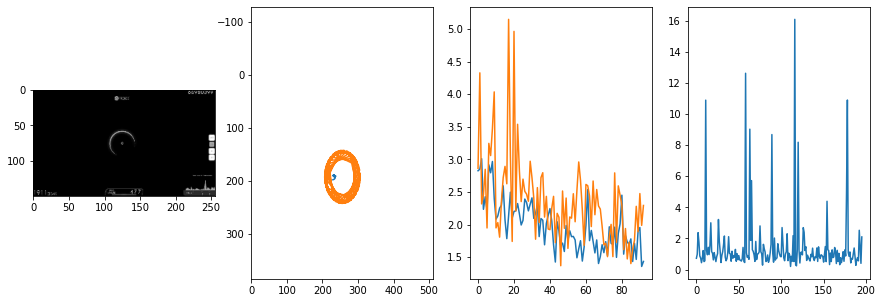


 99 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  1.5945                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0470403502790298
outliers: 50
retrain: 8                 
val: 50/50 loss: 1.1693                                    
pred: 0.13336969912052155 0.48663386702537537
gt: 0.07812532782554626 0.7916655540466309
(60, 110)


<Figure size 1080x360 with 0 Axes>

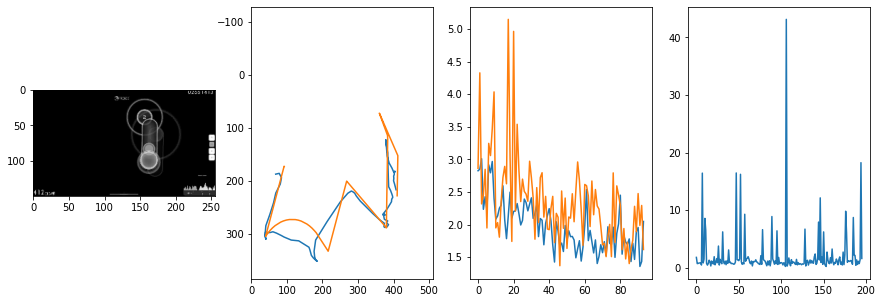


 100 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.1728                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6877943181565829
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.5494                                    
pred: 0.8666716814041138 0.4187818765640259
gt: 0.85546875 0.484375
(180, 74)


<Figure size 1080x360 with 0 Axes>

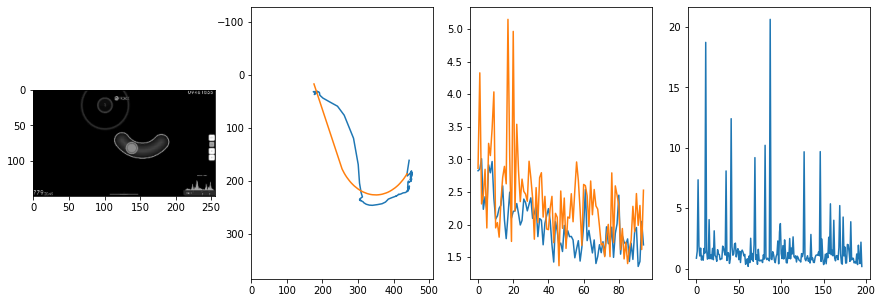


 101 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.5528                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4762386050056286
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.5791                                    
pred: 0.5417500734329224 0.4411749541759491
gt: 0.4946690797805786 0.6124008893966675
(124, 89)


<Figure size 1080x360 with 0 Axes>

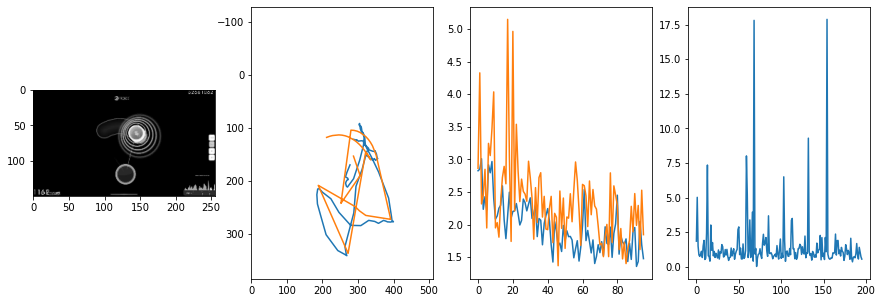


 102 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.94it/s  1.0237                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.604076324981086
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.6654                                    
pred: 0.5798227190971375 0.7976933717727661
gt: 0.613284170627594 0.8880190849304199
(143, 121)


<Figure size 1080x360 with 0 Axes>

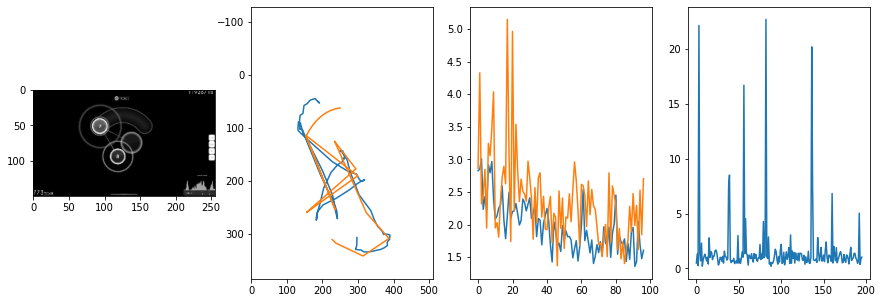


 103 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.5765                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6566272993781128
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.5775                                    
pred: 0.3754673898220062 0.5114433765411377
gt: 0.19531972706317902 0.2630271911621094
(78, 48)


<Figure size 1080x360 with 0 Axes>

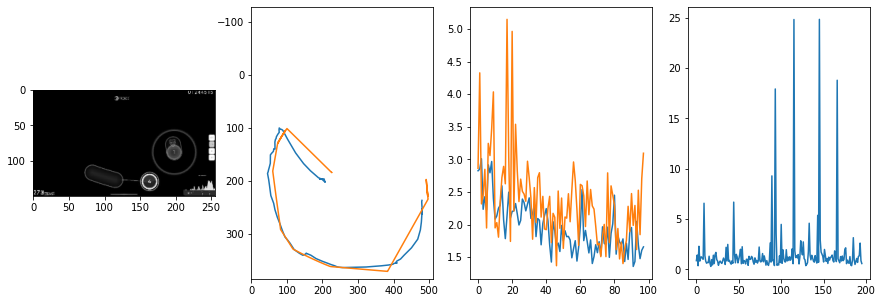


 104 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.8614                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.3838227549377753
outliers: 36
retrain: 8                 
val: 50/50 loss: 1.8423                                    
pred: 0.43588316440582275 0.3400287330150604
gt: 0.509765625 0.4453125
(127, 69)


<Figure size 1080x360 with 0 Axes>

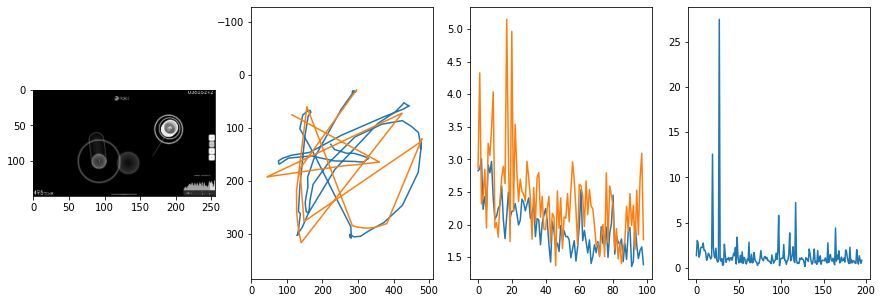


 105 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.6830                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.2992971343349438
outliers: 39
retrain: 8                 
val: 50/50 loss: 17.5548                                   
pred: 0.5139769315719604 0.4690805673599243
gt: 0.021568039432168007 0.10423588007688522
(51, 30)


<Figure size 1080x360 with 0 Axes>

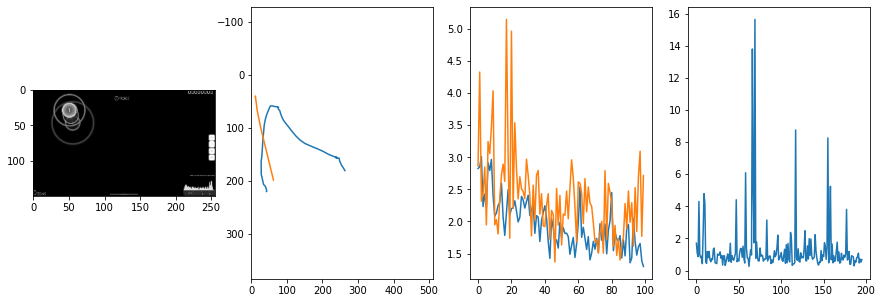


 106 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  1.0381                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4612536115609869
outliers: 60
retrain: 8                 
val: 50/50 loss: 1.3883                                    
pred: 0.4626316726207733 0.49569764733314514
gt: 0.5582718849182129 0.39551281929016113
(134, 64)


<Figure size 1080x360 with 0 Axes>

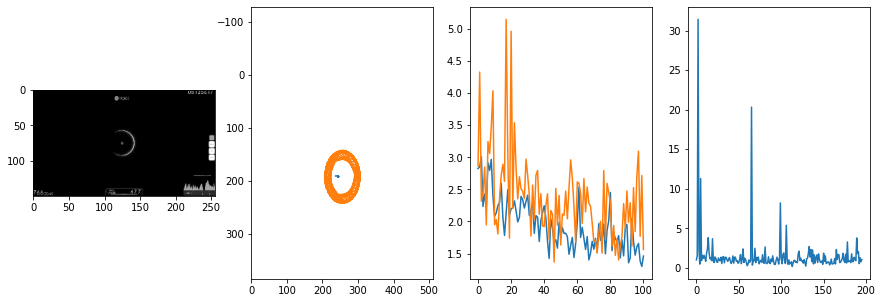


 107 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  1.0434                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.2756819223262825
outliers: 27
retrain: 8                 
val: 50/50 loss: 2.5257                                    
pred: 0.4902256429195404 0.570193350315094
gt: 0.4993838369846344 0.3880162537097931
(125, 63)


<Figure size 1080x360 with 0 Axes>

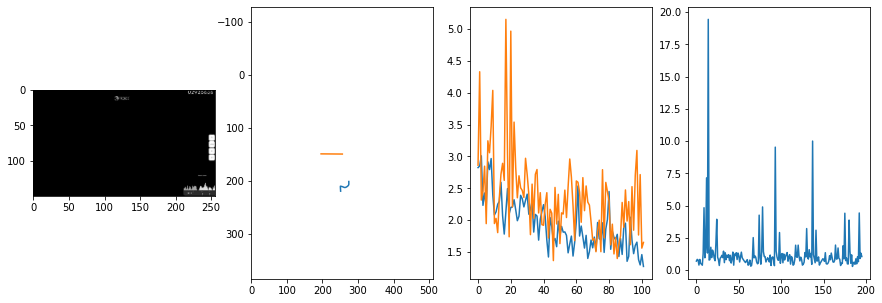


 108 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  0.8490                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.3796275357658765
outliers: 44
retrain: 8                 
val: 50/50 loss: 1.6755                                    
pred: 0.8669295310974121 0.6476722359657288
gt: 0.5546875596046448 0.31250014901161194
(134, 54)


<Figure size 1080x360 with 0 Axes>

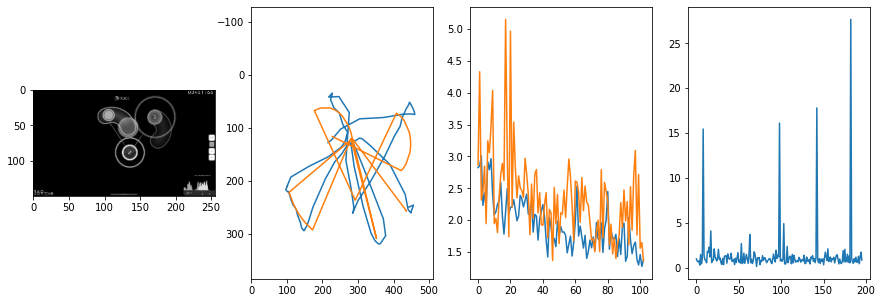


 109 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.8719                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.5895110359605478
outliers: 43
retrain: 8                 
val: 50/50 loss: 0.5364                                    
pred: 0.46276500821113586 0.5235026478767395
gt: 0.3730531334877014 0.5598896741867065
(105, 83)


<Figure size 1080x360 with 0 Axes>

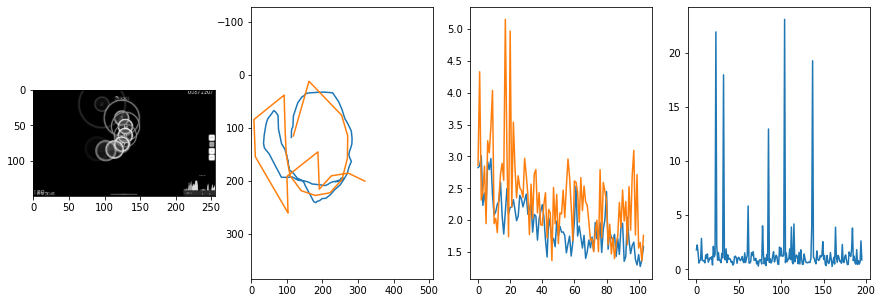


 110 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  1.5178                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6582079115418755
outliers: 31
retrain: 8                 
val: 50/50 loss: 1.0885                                    
pred: 0.3996502757072449 0.7664775848388672
gt: 0.41337457299232483 0.6553327441215515
(112, 94)


<Figure size 1080x360 with 0 Axes>

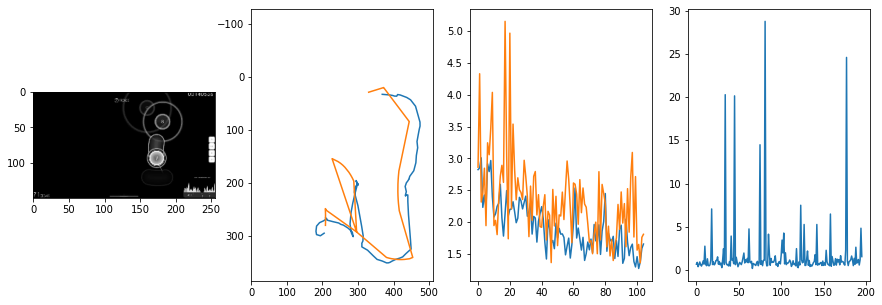


 111 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.6434                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.5724613956955014
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.3622                                    
pred: 0.08705511689186096 0.19211210310459137
gt: 0.19140909612178802 0.10416713356971741
(77, 30)


<Figure size 1080x360 with 0 Axes>

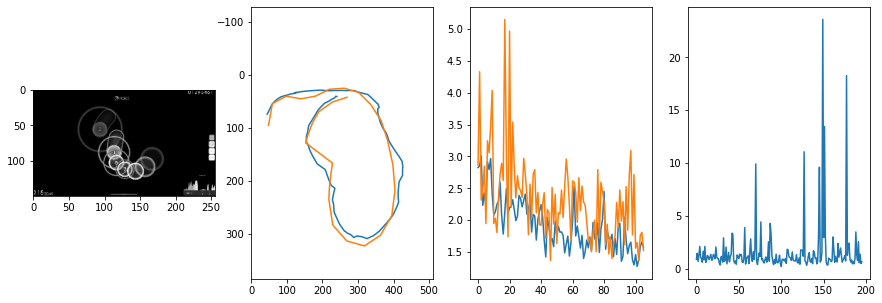


 112 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.9202                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.9187865895884377
outliers: 47
retrain: 8                 
val: 50/50 loss: 1.8191                                    
pred: 0.43041202425956726 0.4737950563430786
gt: 0.5 0.5012394189834595
(125, 76)


<Figure size 1080x360 with 0 Axes>

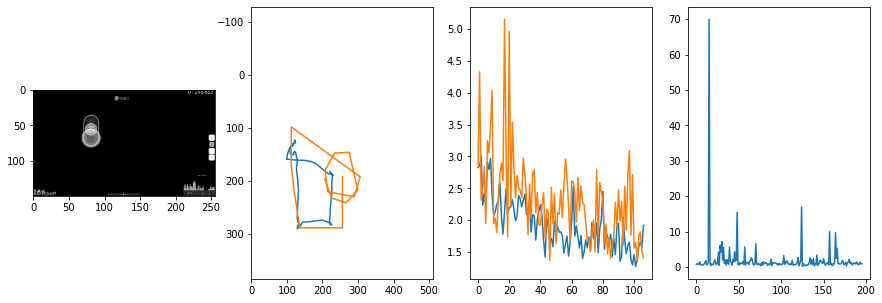


 113 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  1.4483                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.773575087058909
outliers: 26
retrain: 8                 
val: 50/50 loss: 2.0846                                    
pred: 0.35137617588043213 0.69712233543396
gt: 0.460957407951355 0.7291734218597412
(119, 102)


<Figure size 1080x360 with 0 Axes>

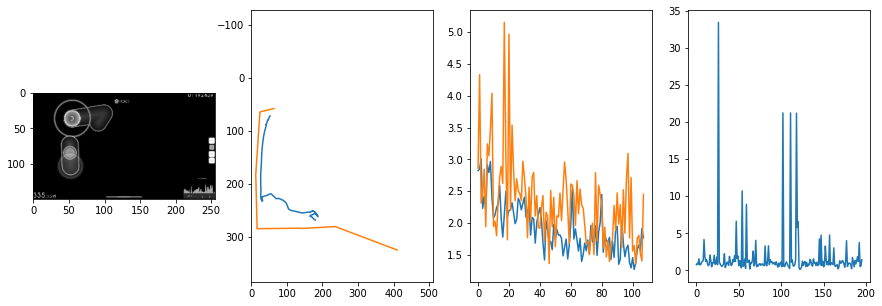


 114 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  6.0141                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.844615907541343
outliers: 29
retrain: 8                 
val: 50/50 loss: 1.5003                                    
pred: 0.28183117508888245 0.7014697790145874
gt: 0.32533636689186096 0.49075257778167725
(98, 75)


<Figure size 1080x360 with 0 Axes>

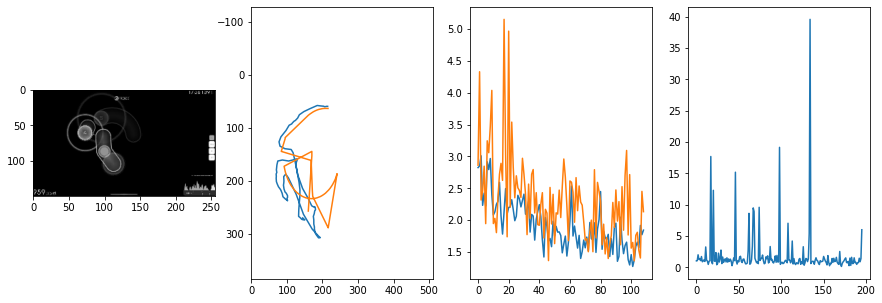


 115 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.6182                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.695263145073336
outliers: 37
retrain: 8                 
val: 50/50 loss: 1.1407                                    
pred: 0.5487922430038452 0.8083418011665344
gt: 0.4531250298023224 0.908854067325592
(118, 123)


<Figure size 1080x360 with 0 Axes>

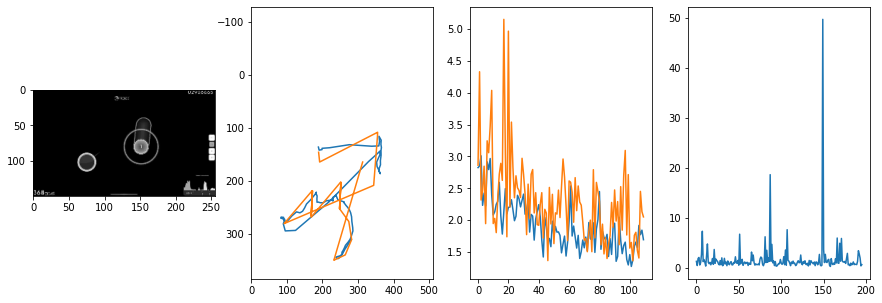


 116 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  1.5202                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6079453780334823
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.5430                                    
pred: 0.4757833182811737 0.6149826645851135
gt: 0.4745820462703705 0.5546292066574097
(121, 82)


<Figure size 1080x360 with 0 Axes>

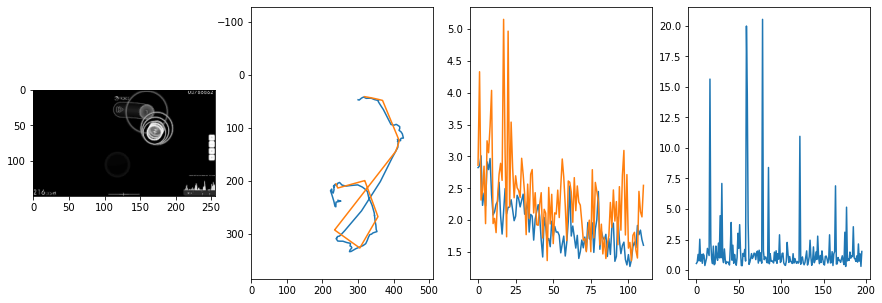


 117 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  1.3506                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.2989780196577918
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.5680                                    
pred: 0.3000310957431793 0.7518662810325623
gt: 0.2612190246582031 0.711054801940918
(88, 100)


<Figure size 1080x360 with 0 Axes>

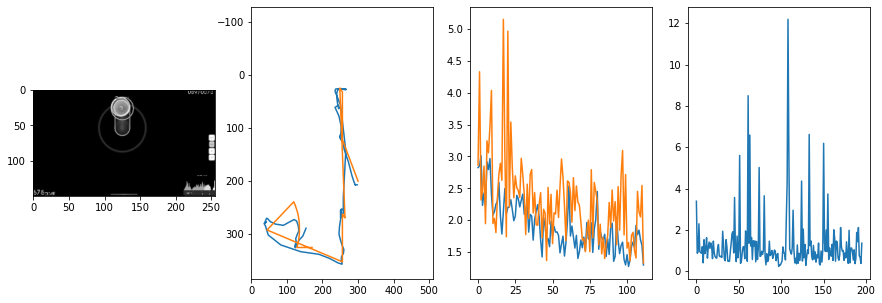


 118 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.5020                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.305592916449722
outliers: 42
retrain: 8                 
val: 50/50 loss: 6.1517                                    
pred: 0.5048753023147583 0.5206125378608704
gt: 0.5018044710159302 0.495990127325058
(125, 75)


<Figure size 1080x360 with 0 Axes>

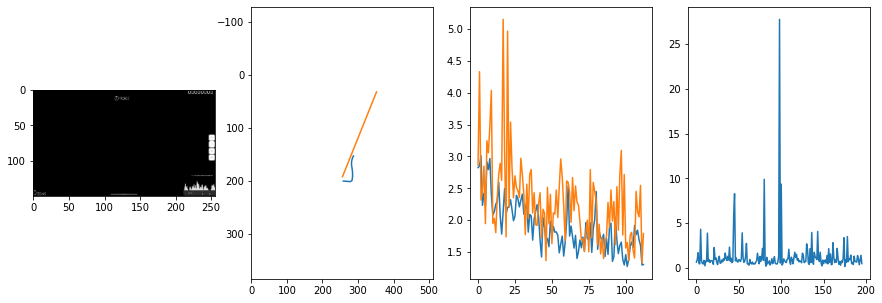


 119 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  1.2013                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.837384373329732
outliers: 52
retrain: 8                 
val: 50/50 loss: 2.0097                                    
pred: 0.5493947863578796 0.37775421142578125
gt: 0.39912500977516174 0.28216686844825745
(109, 50)


<Figure size 1080x360 with 0 Axes>

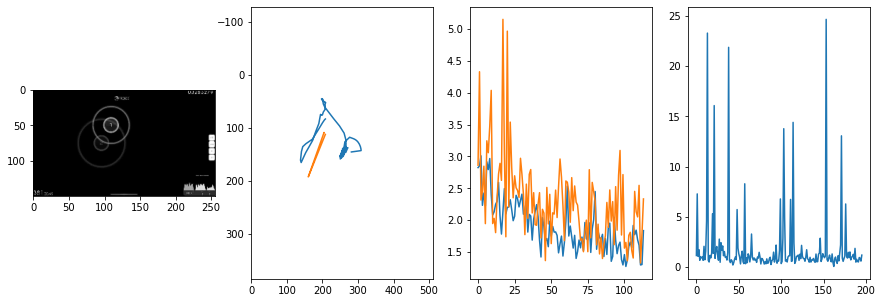


 120 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  26.3729                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.1039034132750665
outliers: 39
retrain: 8                 
val: 50/50 loss: 1.1997                                    
pred: 0.7868094444274902 0.8838306069374084
gt: 0.5631874799728394 0.6779999732971191
(135, 96)


<Figure size 1080x360 with 0 Axes>

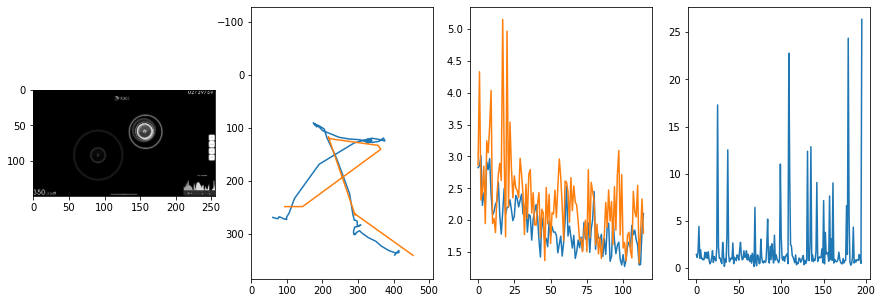


 121 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  4.7092                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6422296200299218
outliers: 22
retrain: 8                 
val: 50/50 loss: 0.4439                                    
pred: 0.27530547976493835 0.19199267029762268
gt: 0.20805242657661438 0.14636678993701935
(80, 35)


<Figure size 1080x360 with 0 Axes>

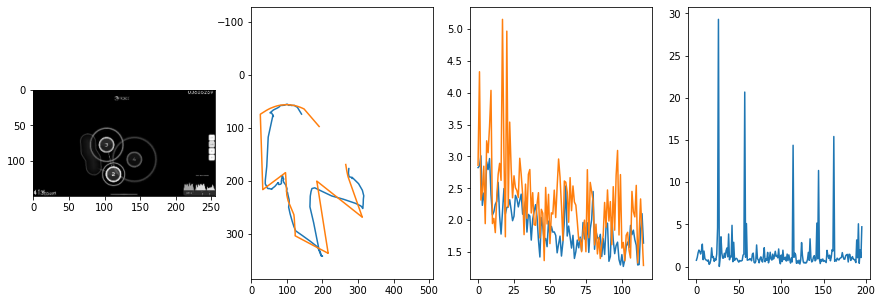


 122 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.63it/s  1.9450                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.3472577348655583
outliers: 23
retrain: 8                 
val: 50/50 loss: 25.4666                                   
pred: 0.538458526134491 0.3516438901424408
gt: 0.5770478248596191 0.7055037021636963
(137, 100)


<Figure size 1080x360 with 0 Axes>

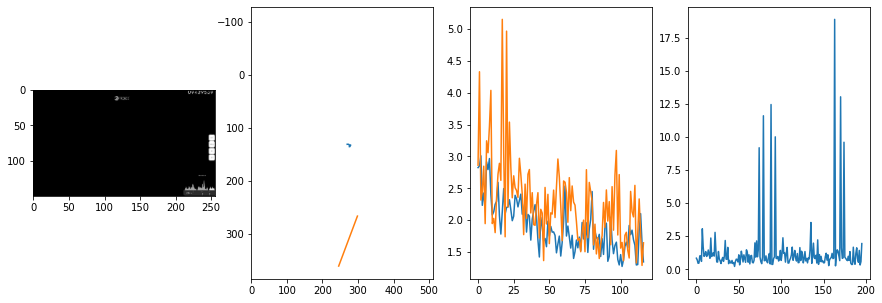


 123 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.6284                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.4516306266340675
outliers: 40
retrain: 8                 
val: 50/50 loss: 1.8049                                    
pred: 0.7505411505699158 0.2899504601955414
gt: 0.4999753534793854 0.45832136273384094
(125, 71)


<Figure size 1080x360 with 0 Axes>

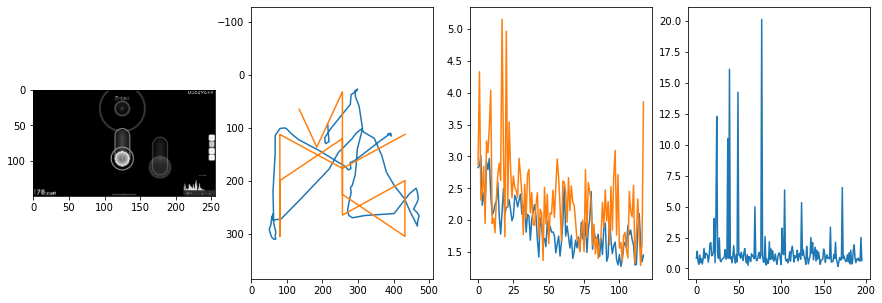


 124 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  1.2973                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.7765250371731058
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.8957                                    
pred: 0.3683895170688629 0.5488571524620056
gt: 0.494140625 0.3880208432674408
(124, 63)


<Figure size 1080x360 with 0 Axes>

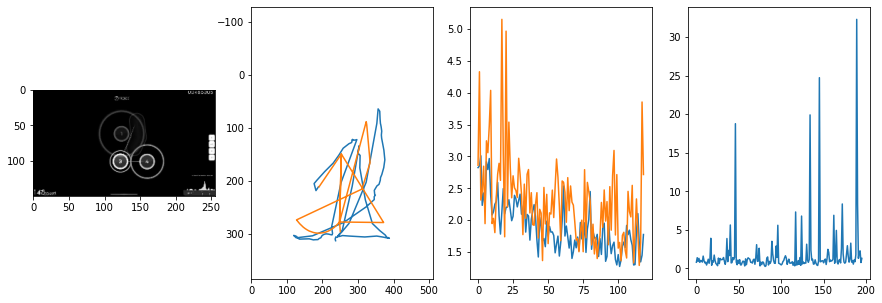


 125 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  0.8292                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8599670500475534
outliers: 36
retrain: 8                 
val: 50/50 loss: 1.1028                                    
pred: 0.6245993375778198 0.3862203061580658
gt: 0.47136902809143066 0.32236072421073914
(121, 55)


<Figure size 1080x360 with 0 Axes>

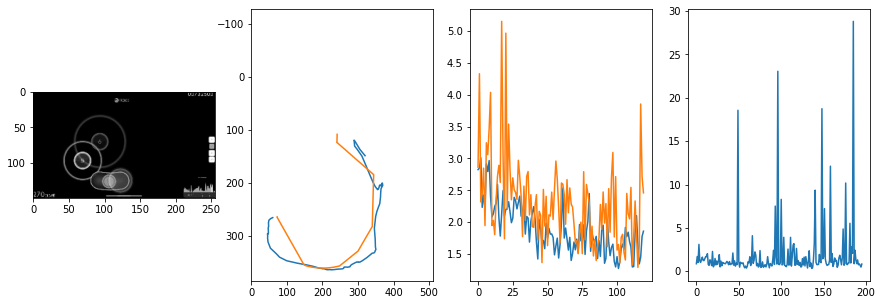


 126 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  1.7851                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0186327349926745
outliers: 29
retrain: 8                 
val: 50/50 loss: 0.7594                                    
pred: 0.7890188097953796 0.3788937032222748
gt: 0.78125 0.3124999701976776
(169, 54)


<Figure size 1080x360 with 0 Axes>

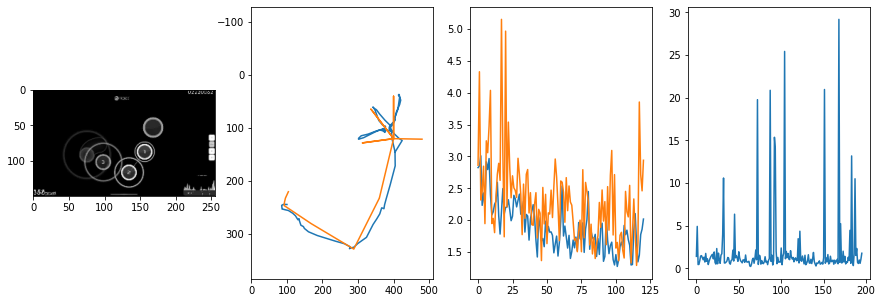


 127 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.7410                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.6194757638233048
outliers: 17
retrain: 8                 
val: 50/50 loss: 1.2411                                    
pred: 0.34271833300590515 0.20884309709072113
gt: 0.3842054307460785 0.6187263131141663
(107, 89)


<Figure size 1080x360 with 0 Axes>

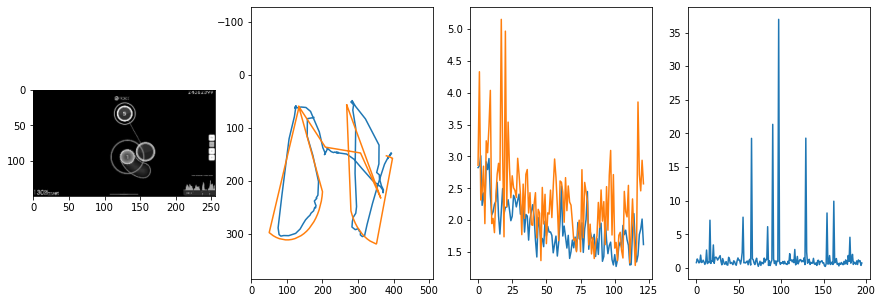


 128 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  2.8057                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.8840353044168072
outliers: 34
retrain: 8                 
val: 50/50 loss: 2.0725                                    
pred: 0.8430134057998657 0.4432961344718933
gt: 0.7288751602172852 0.40223267674446106
(161, 64)


<Figure size 1080x360 with 0 Axes>

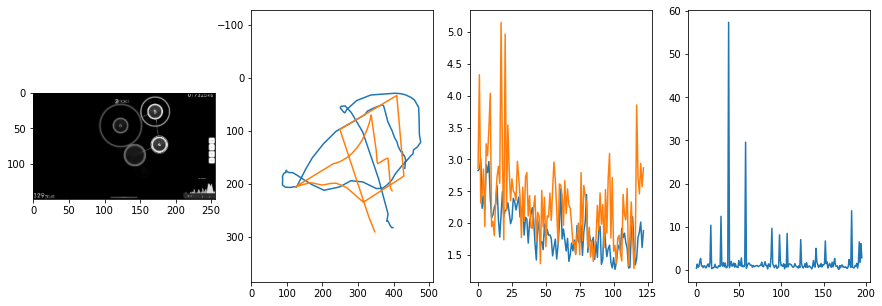


 129 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  0.7728                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 2.0784571335023765
outliers: 38
retrain: 8                 
val: 50/50 loss: 1.0676                                    
pred: 0.7752484083175659 0.9109225273132324
gt: 0.830540657043457 0.9557346701622009
(176, 129)


<Figure size 1080x360 with 0 Axes>

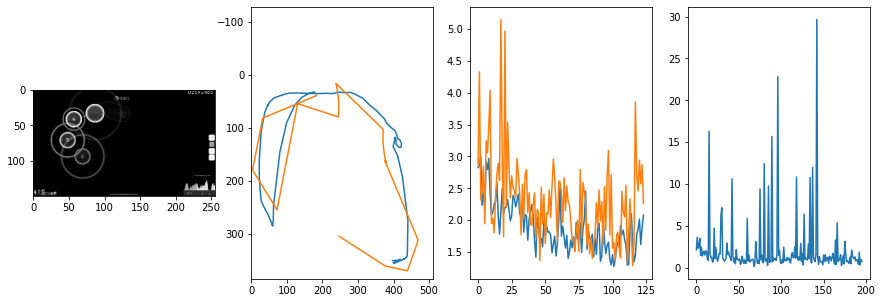


 130 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  2.6704                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.1398776044346848
outliers: 15
retrain: 8                 
val: 50/50 loss: 0.7681                                    
pred: 0.40851718187332153 0.4002907872200012
gt: 0.23437504470348358 0.2526041269302368
(84, 47)


<Figure size 1080x360 with 0 Axes>

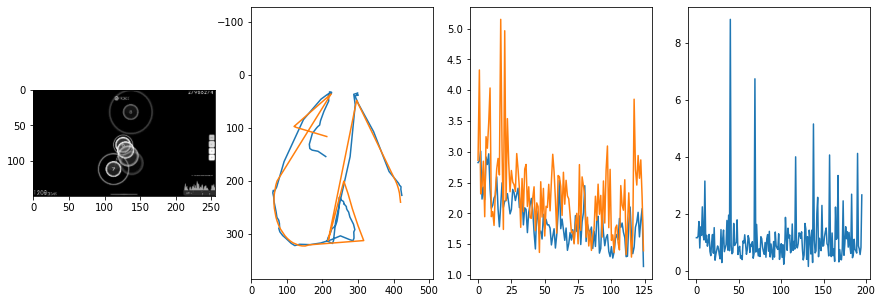


 131 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  1.9655                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.213294174674214
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.8399                                    
pred: 0.6450093388557434 0.286115437746048
gt: 0.5006887912750244 0.26484590768814087
(125, 48)


<Figure size 1080x360 with 0 Axes>

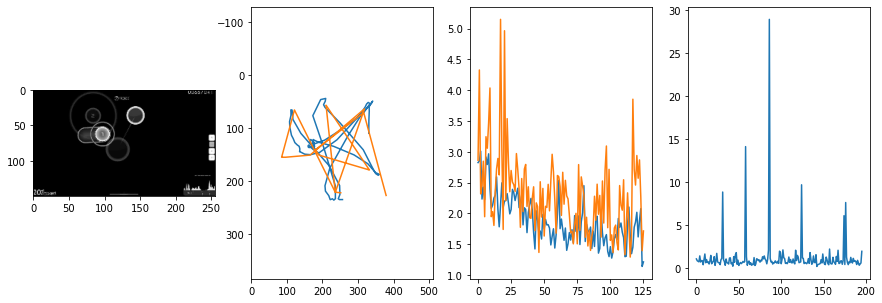


 132 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  4.9440                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.2651915393617688
outliers: 49
retrain: 8                 
val: 50/50 loss: 1.0892                                    
pred: 0.3075524568557739 0.5028371214866638
gt: 0.16604892909526825 0.2209869623184204
(73, 43)


<Figure size 1080x360 with 0 Axes>

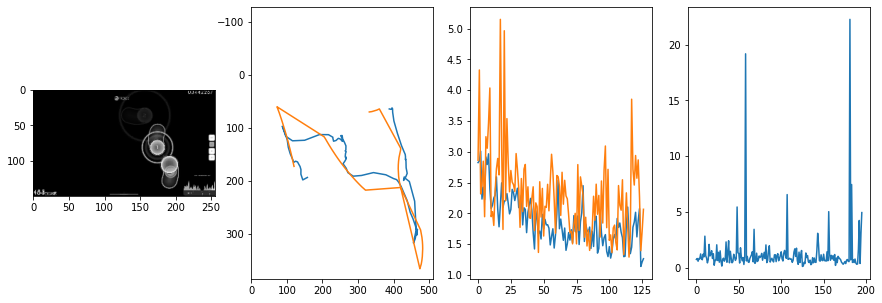


 133 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.4560                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.3521506912550147
outliers: 42
retrain: 8                 
val: 50/50 loss: 1.2830                                    
pred: 0.6456061005592346 0.31808605790138245
gt: 0.52734375 0.6015625
(129, 87)


<Figure size 1080x360 with 0 Axes>

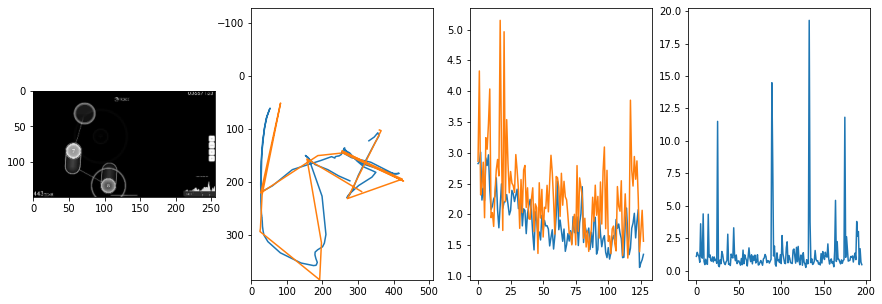


 134 of 134
4411.250943899155 secs


In [21]:
start = time.time()

epochs = 128
loss_thresh = 0.0005
rnum_min = 8
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [22]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

1.2917952704429627


In [23]:
seq_dur = 1
best_loss = 9999

In [24]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

1 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  0.2319                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6130003787634172
outliers: 16
retrain: 4                 
val: 50/50 loss: 1.2230                                    
pred: 0.20320385694503784 0.21810144186019897
gt: 0.240234375 0.5182291865348816
(85, 78)


<Figure size 1080x360 with 0 Axes>

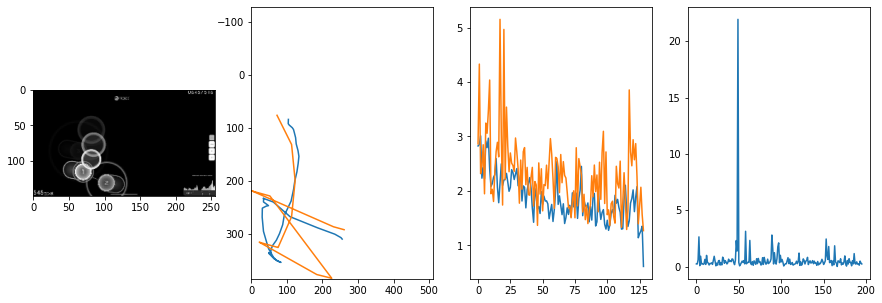


 135 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.4770                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6899852490394699
outliers: 56
retrain: 4                 
val: 50/50 loss: 0.7313                                    
pred: 0.2906739115715027 0.39142006635665894
gt: 0.25585949420928955 0.6901041865348816
(87, 98)


<Figure size 1080x360 with 0 Axes>

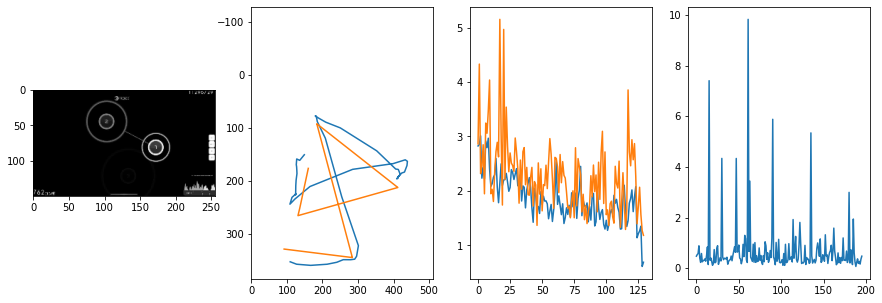


 136 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.3980                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9036520289599287
outliers: 63
retrain: 4                 
val: 50/50 loss: 0.1465                                    
pred: 0.41590237617492676 0.2692251205444336
gt: 0.6019127368927002 0.5211014151573181
(141, 78)


<Figure size 1080x360 with 0 Axes>

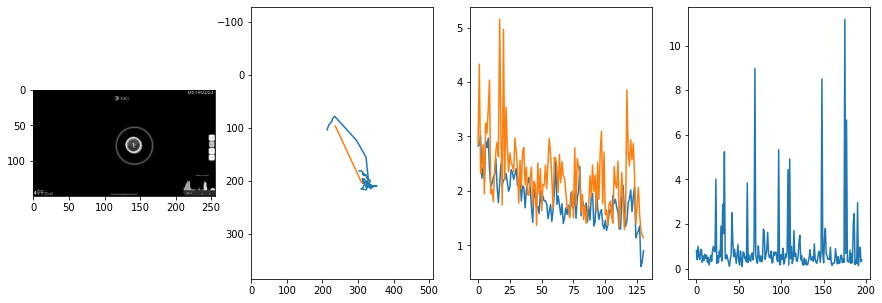


 137 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  0.2447                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7296938580289787
outliers: 27
retrain: 4                 
val: 50/50 loss: 1.0639                                    
pred: 0.6170747876167297 0.9085406064987183
gt: 0.8339675068855286 0.5000478029251099
(177, 76)


<Figure size 1080x360 with 0 Axes>

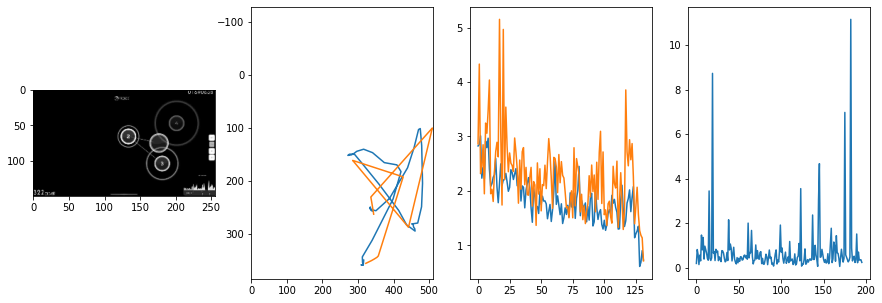


 138 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.2708                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8362894870188772
outliers: 38
retrain: 4                 
val: 50/50 loss: 15.8498                                   
pred: 0.5673023462295532 0.7525930404663086
gt: 0.19645559787750244 0.3075430691242218
(78, 53)


<Figure size 1080x360 with 0 Axes>

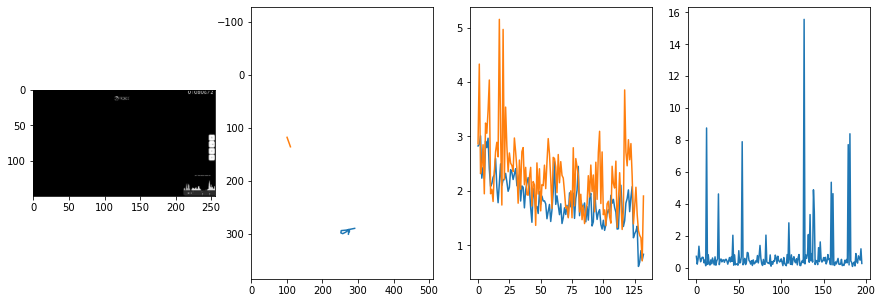


 139 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.2272                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6704767825728168
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.4449                                    
pred: 0.68467777967453 0.1558043658733368
gt: 0.7356693744659424 0.1287396103143692
(162, 32)


<Figure size 1080x360 with 0 Axes>

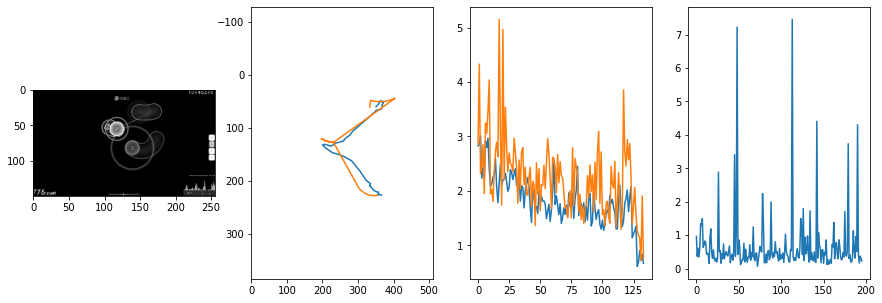


 140 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.4077                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6266107156454604
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.2560                                    
pred: 0.44644373655319214 0.3221645951271057
gt: 0.43750131130218506 0.3437511622905731
(115, 57)


<Figure size 1080x360 with 0 Axes>

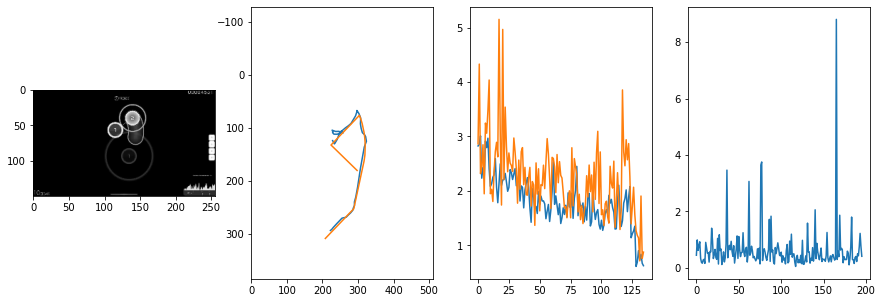


 141 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.3164                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6288128315794225
outliers: 45
retrain: 4                 
val: 50/50 loss: 1.0598                                    
pred: 0.1304413080215454 0.18086223304271698
gt: 0.515625 0.1276041716337204
(127, 32)


<Figure size 1080x360 with 0 Axes>

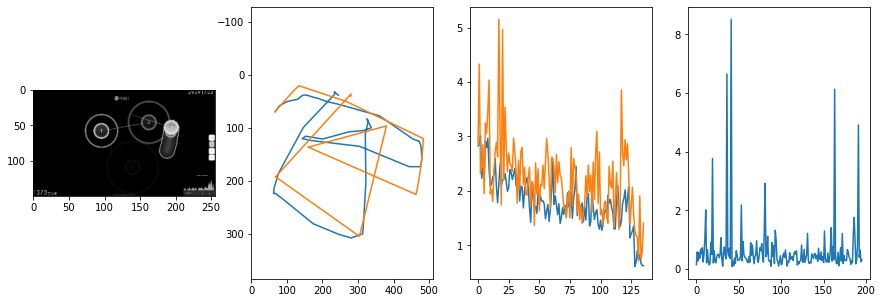


 142 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.1435                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8132725165282585
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.3700                                    
pred: 0.5716255903244019 0.6448312401771545
gt: 0.6647781133651733 0.5397869348526001
(151, 80)


<Figure size 1080x360 with 0 Axes>

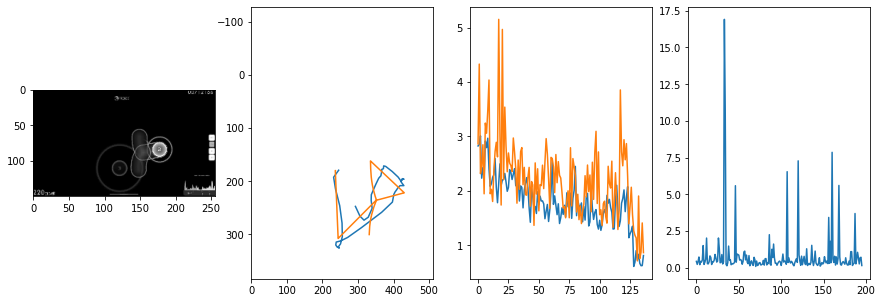


 143 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.33it/s  0.3184                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9145654906252665
outliers: 45
retrain: 4                 
val: 50/50 loss: 1.1053                                    
pred: 0.7843700647354126 0.27258753776550293
gt: 0.7480460405349731 0.37239429354667664
(164, 61)


<Figure size 1080x360 with 0 Axes>

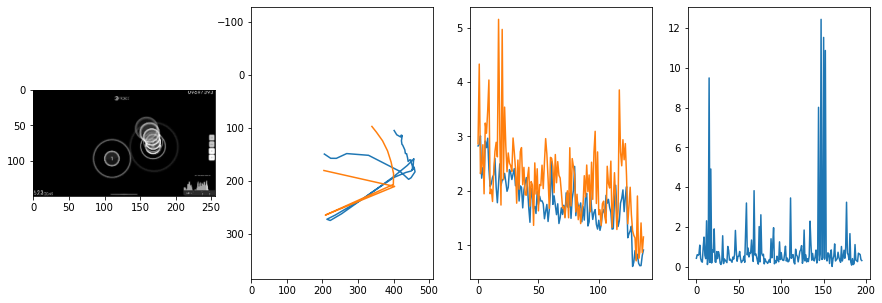


 144 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.31it/s  0.3924                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8155178215962892
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.7404                                    
pred: 0.5199578404426575 0.7161616086959839
gt: 0.293338418006897 0.6776876449584961
(93, 96)


<Figure size 1080x360 with 0 Axes>

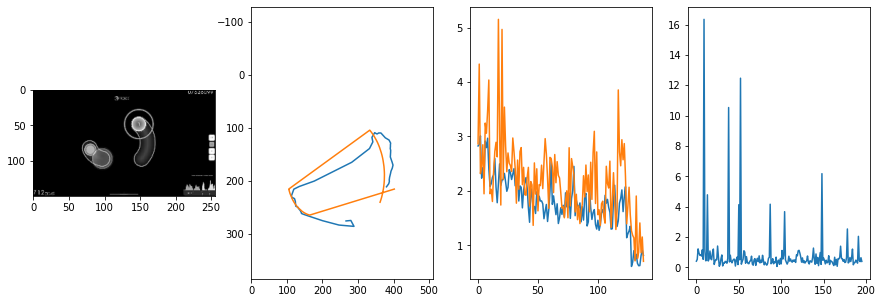


 145 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.6412                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.865661872873957
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.4657                                    
pred: 0.9255459308624268 0.23090726137161255
gt: 0.9257811903953552 0.05208335444331169
(191, 24)


<Figure size 1080x360 with 0 Axes>

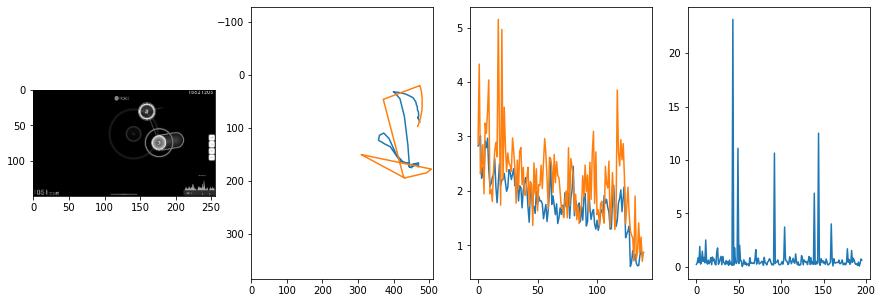


 146 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.2909                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7780379032221983
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.1227                                    
pred: 0.5267905592918396 0.2007991224527359
gt: 0.5 0.2782347500324249
(125, 50)


<Figure size 1080x360 with 0 Axes>

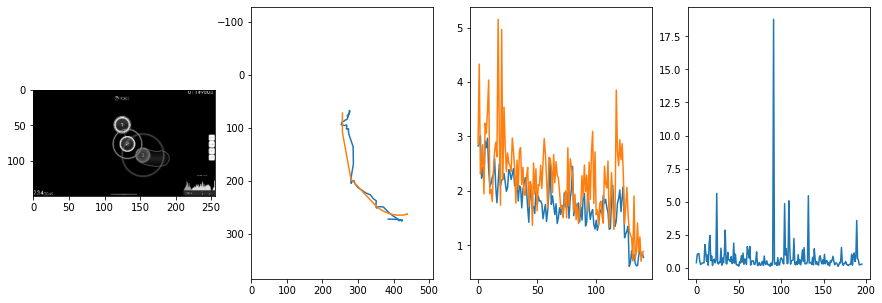


 147 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.79it/s  0.2762                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6988751132193268
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.4752                                    
pred: 0.7388350367546082 0.33195486664772034
gt: 0.7935307025909424 0.2980077564716339
(171, 52)


<Figure size 1080x360 with 0 Axes>

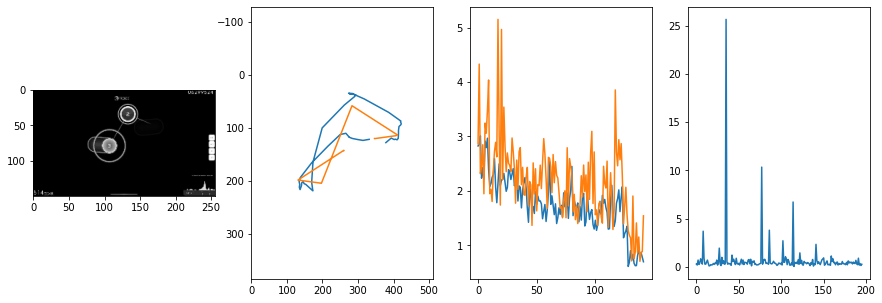


 148 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  0.3628                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7594044511681612
outliers: 50
retrain: 4                 
val: 50/50 loss: 0.9147                                    
pred: 0.48017433285713196 0.8567266464233398
gt: 0.5892238020896912 0.7257236838340759
(139, 102)


<Figure size 1080x360 with 0 Axes>

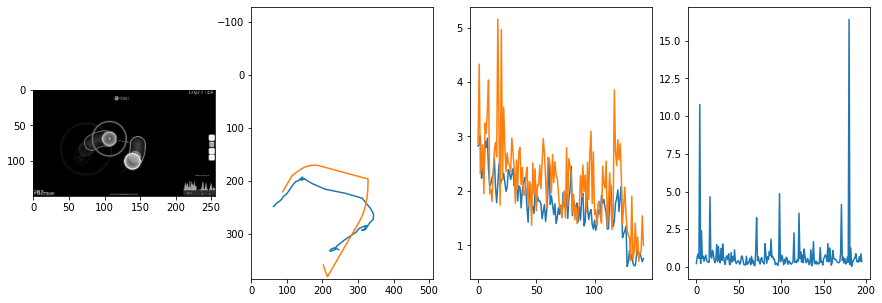


 149 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.1066                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7584991501454188
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.3526                                    
pred: 0.20420381426811218 0.3232709765434265
gt: 0.05273479223251343 0.2421906590461731
(56, 46)


<Figure size 1080x360 with 0 Axes>

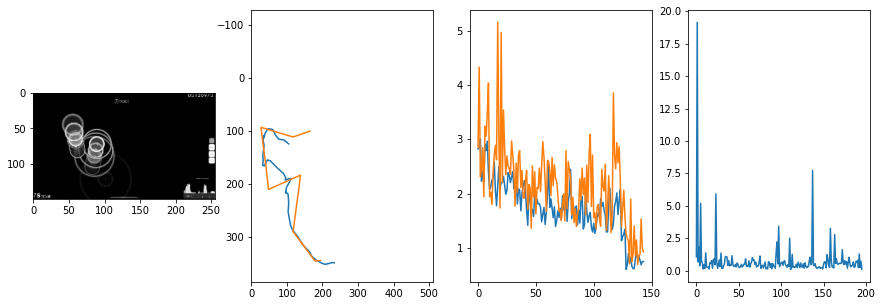


 150 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.3640                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7838954736991804
outliers: 39
retrain: 4                 
val: 50/50 loss: 1.0125                                    
pred: 0.31495651602745056 0.4147825241088867
gt: 0.13281330466270447 0.5104160904884338
(68, 77)


<Figure size 1080x360 with 0 Axes>

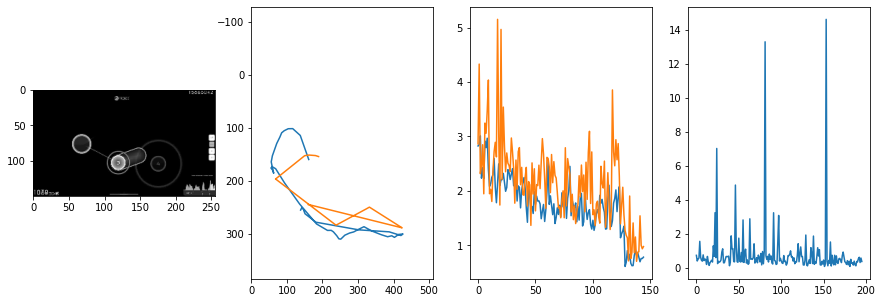


 151 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.3808                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9366573566684917
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.6468                                    
pred: 0.07475801557302475 0.4615272283554077
gt: 0.09592036157846451 0.20587404072284698
(62, 41)


<Figure size 1080x360 with 0 Axes>

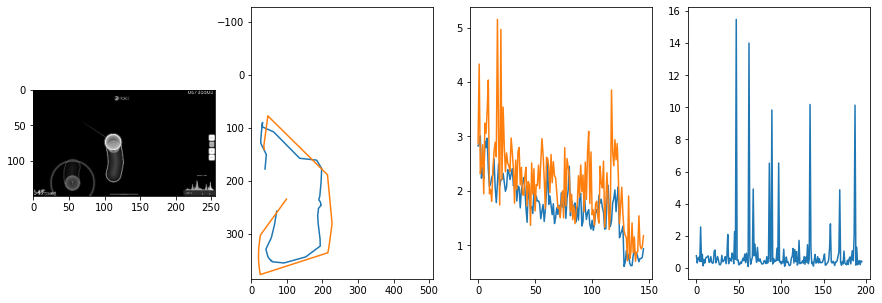


 152 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2316                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9357533481884368
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.3741                                    
pred: 0.4616643190383911 0.6889034509658813
gt: 0.6588546633720398 0.515196681022644
(150, 77)


<Figure size 1080x360 with 0 Axes>

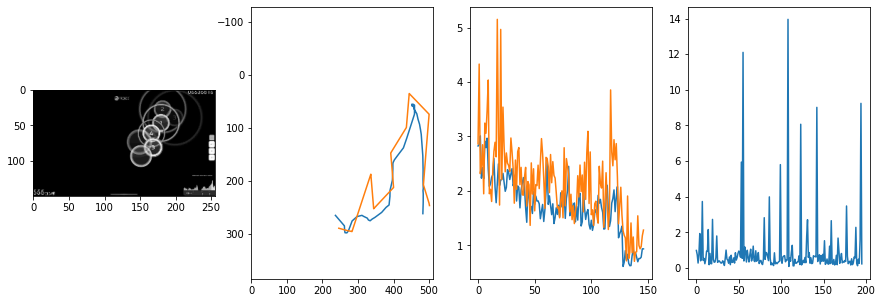


 153 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  0.2351                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7353186812631938
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.3270                                    
pred: 0.8421363830566406 0.672168493270874
gt: 0.8201723098754883 0.6689730286598206
(175, 95)


<Figure size 1080x360 with 0 Axes>

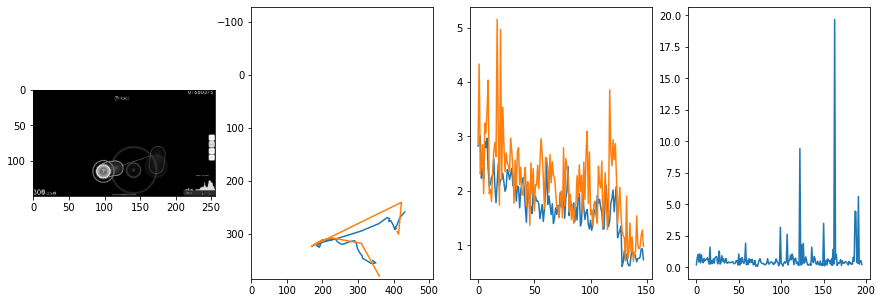


 154 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.2465                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7913562447136763
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.6252                                    
pred: 0.28526929020881653 0.671229898929596
gt: 0.41716474294662476 0.6582290530204773
(112, 94)


<Figure size 1080x360 with 0 Axes>

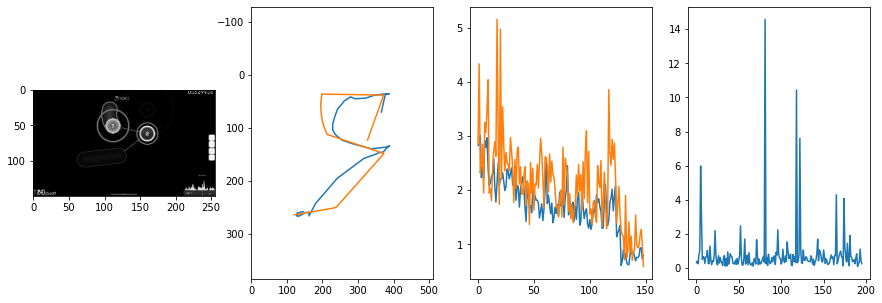


 155 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.2108                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8204030974254924
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.6121                                    
pred: 0.41937941312789917 0.4896952509880066
gt: 0.4453117549419403 0.7187499403953552
(117, 101)


<Figure size 1080x360 with 0 Axes>

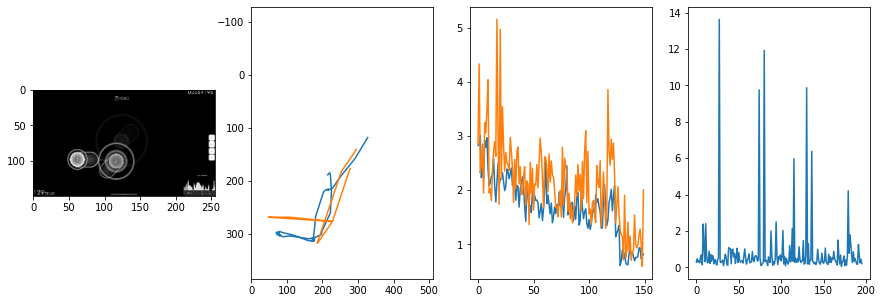


 156 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.3129                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9746594243511861
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.6882                                    
pred: 0.7041707634925842 0.3480595350265503
gt: 0.8359375 0.3854166567325592
(177, 62)


<Figure size 1080x360 with 0 Axes>

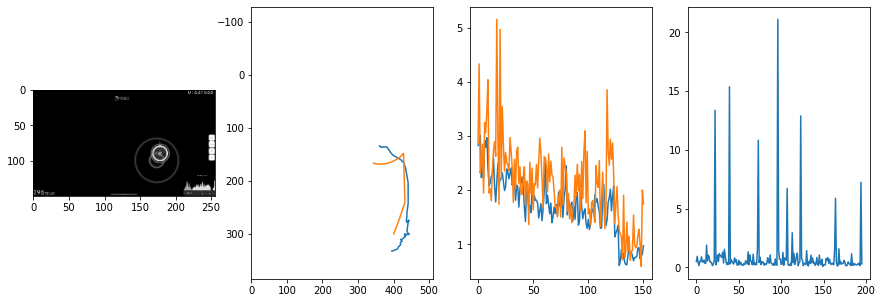


 157 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.2191                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7416473695514153
outliers: 26
retrain: 4                 
val: 50/50 loss: 1.2133                                    
pred: 0.3571130335330963 0.6184749007225037
gt: 0.5849021077156067 0.5643376708030701
(138, 83)


<Figure size 1080x360 with 0 Axes>

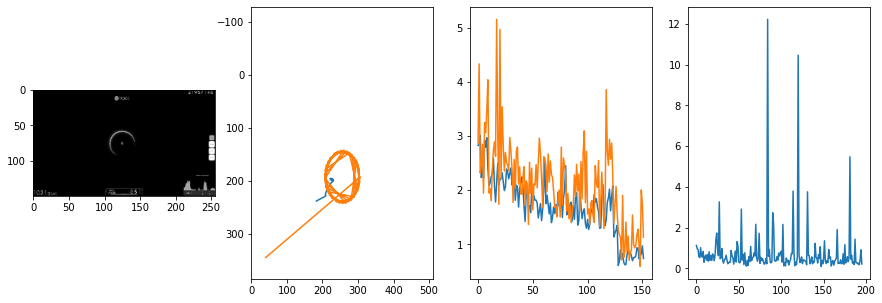


 158 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.8926                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7664270763646583
outliers: 45
retrain: 4                 
val: 50/50 loss: 7.8820                                    
pred: 0.4871390163898468 0.4511551856994629
gt: 0.2840794622898102 0.6270120739936829
(92, 90)


<Figure size 1080x360 with 0 Axes>

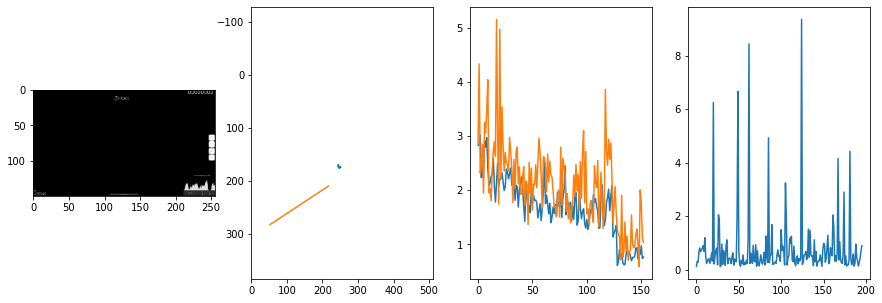


 159 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.2765                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5203511047804233
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.8945                                    
pred: 0.28611505031585693 0.5038599967956543
gt: 0.4686385691165924 0.13723325729370117
(120, 33)


<Figure size 1080x360 with 0 Axes>

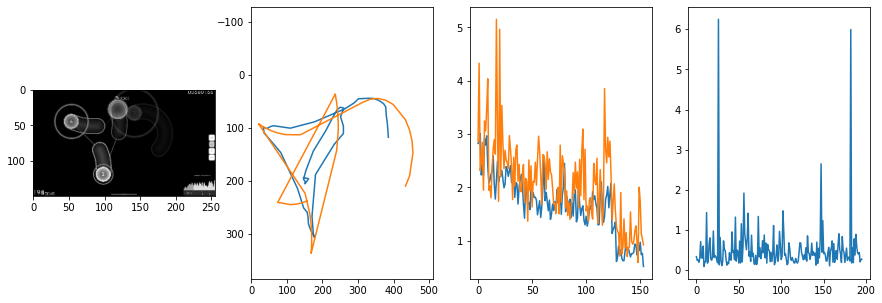


 160 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.1737                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8748523638517197
outliers: 70
retrain: 4                 
val: 50/50 loss: 1.0753                                    
pred: 0.9481467604637146 0.39372730255126953
gt: 0.9746315479278564 0.3535553514957428
(199, 59)


<Figure size 1080x360 with 0 Axes>

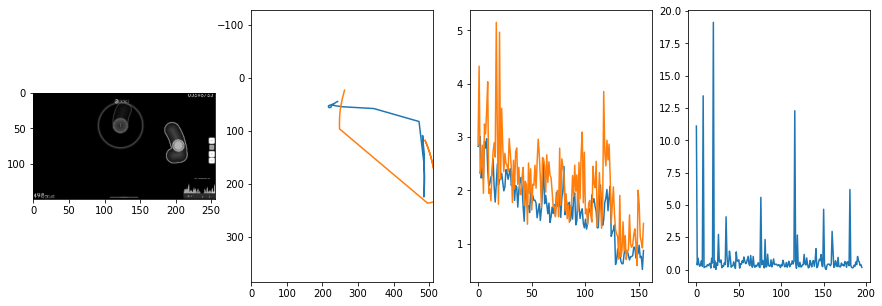


 161 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.1826                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9678438144298841
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.3411                                    
pred: 0.6657679080963135 0.78928142786026
gt: 0.7207044363021851 0.8333313465118408
(159, 114)


<Figure size 1080x360 with 0 Axes>

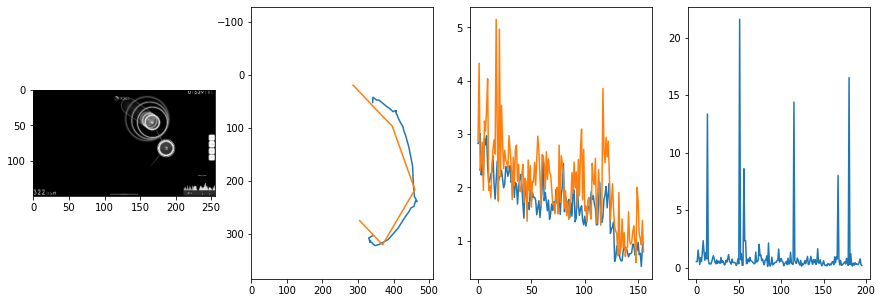


 162 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.1339                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7633204854910776
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.7305                                    
pred: 0.768216609954834 0.38728657364845276
gt: 0.799301028251648 0.5321710705757141
(171, 79)


<Figure size 1080x360 with 0 Axes>

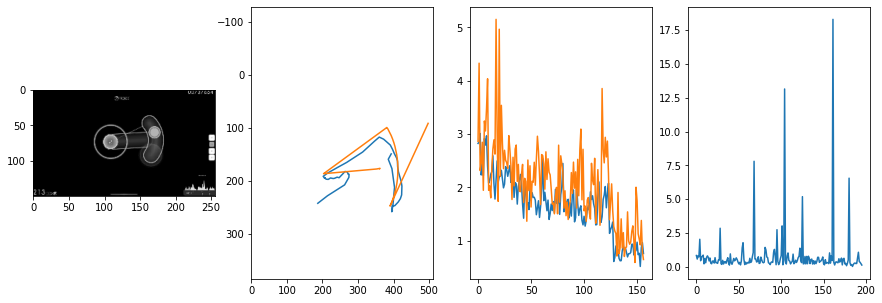


 163 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.9576                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6831337876655922
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.1099                                    
pred: 0.28292638063430786 0.6623525619506836
gt: 0.4803309142589569 0.8764824867248535
(122, 119)


<Figure size 1080x360 with 0 Axes>

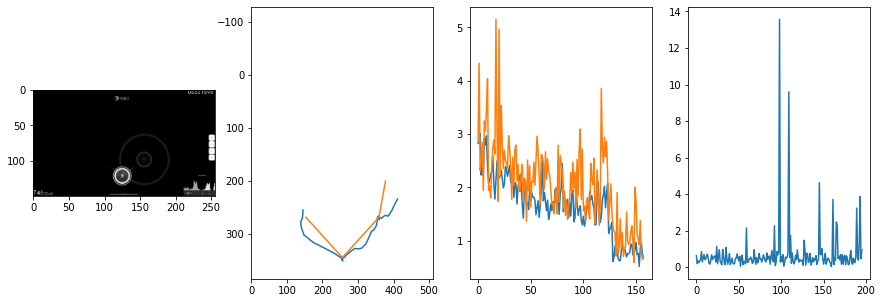


 164 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  0.6523                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6448537713410903
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.2200                                    
pred: 0.2953084409236908 0.5466918349266052
gt: 0.2968750596046448 0.6979166865348816
(94, 99)


<Figure size 1080x360 with 0 Axes>

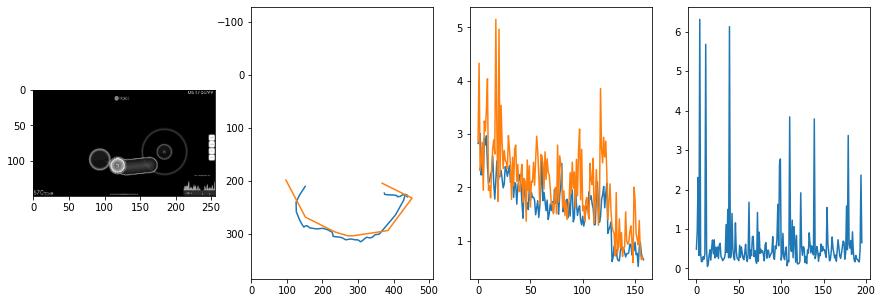


 165 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.1916                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7628333069840256
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.1676                                    
pred: 0.622314989566803 0.37708717584609985
gt: 0.7311397194862366 0.4915182292461395
(161, 75)


<Figure size 1080x360 with 0 Axes>

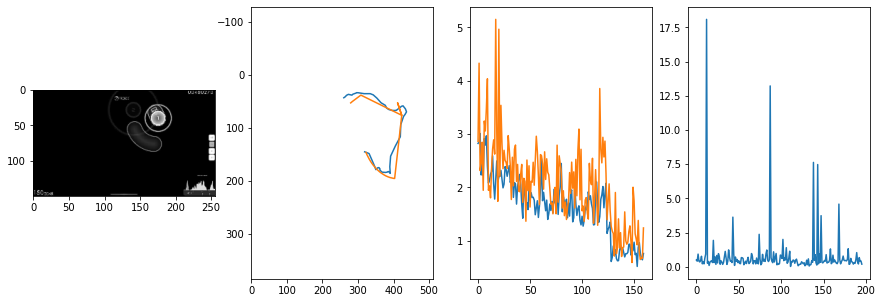


 166 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.1997                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0270246704470138
outliers: 48
retrain: 4                 
val: 50/50 loss: 6.2613                                    
pred: 0.3828354775905609 0.38478660583496094
gt: 0.5775079131126404 0.579068124294281
(137, 85)


<Figure size 1080x360 with 0 Axes>

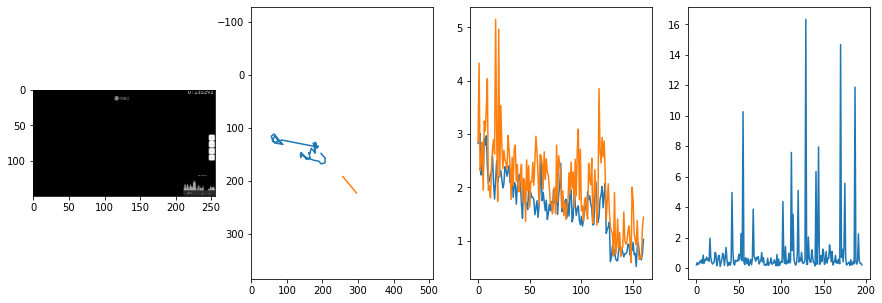


 167 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  0.3719                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7590050696756463
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.7321                                    
pred: 0.46885403990745544 0.557223916053772
gt: 0.5691712498664856 0.5919137597084045
(136, 86)


<Figure size 1080x360 with 0 Axes>

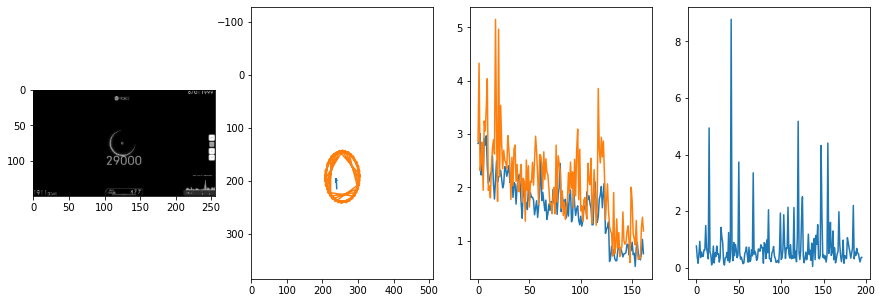


 168 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.4730                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8437582051799614
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.5742                                    
pred: 0.9147319793701172 0.6161321997642517
gt: 0.5000001192092896 0.5624999403953552
(125, 83)


<Figure size 1080x360 with 0 Axes>

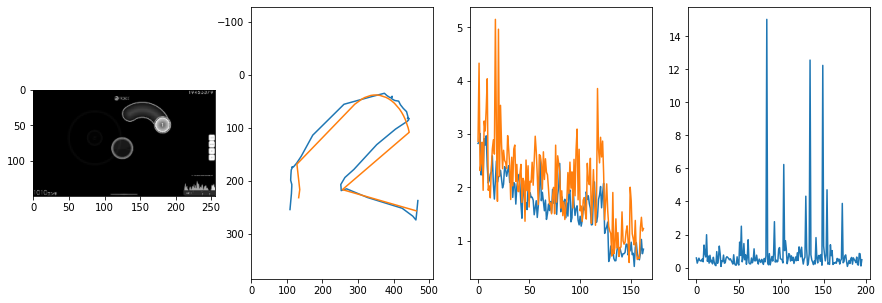


 169 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  0.4447                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.939981529831278
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.2666                                    
pred: 0.3371376097202301 0.4155927300453186
gt: 0.33113253116607666 0.4414847195148468
(99, 69)


<Figure size 1080x360 with 0 Axes>

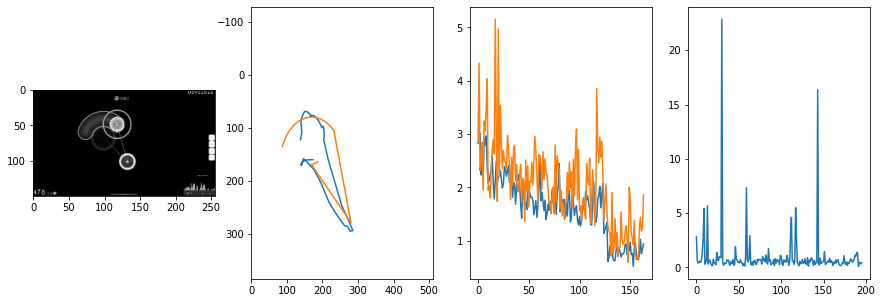


 170 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  0.2526                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8143681021293208
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.3650                                    
pred: 0.5315887928009033 0.9199289679527283
gt: 0.3437500596046448 0.8177083134651184
(101, 113)


<Figure size 1080x360 with 0 Axes>

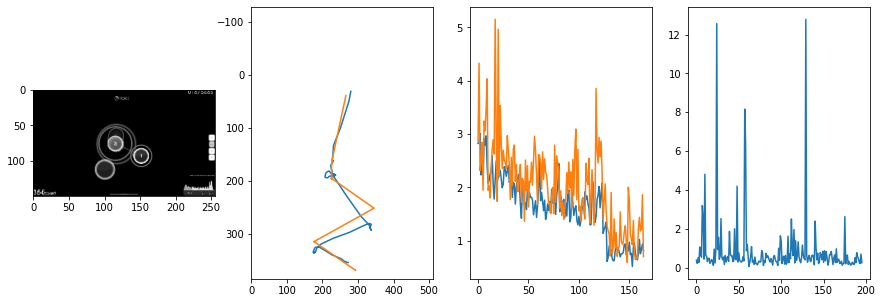


 171 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.3040                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9152080406035695
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.8321                                    
pred: 0.5340409278869629 0.7995297908782959
gt: 0.6328125 0.734375
(146, 103)


<Figure size 1080x360 with 0 Axes>

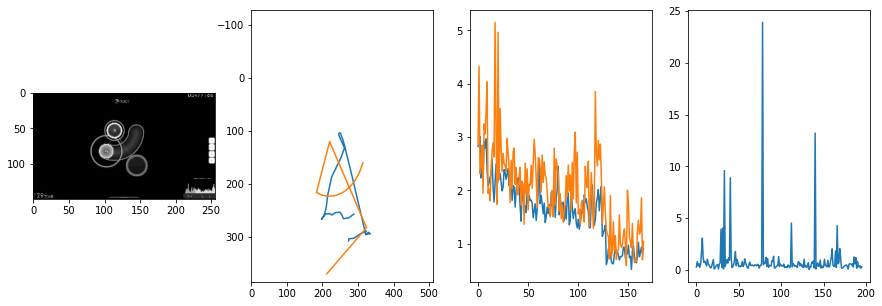


 172 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  0.8325                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8018379147943794
outliers: 25
retrain: 4                 
val: 50/50 loss: 1.0391                                    
pred: 0.15549670159816742 0.6742667555809021
gt: 0.171875 0.5729166865348816
(74, 84)


<Figure size 1080x360 with 0 Axes>

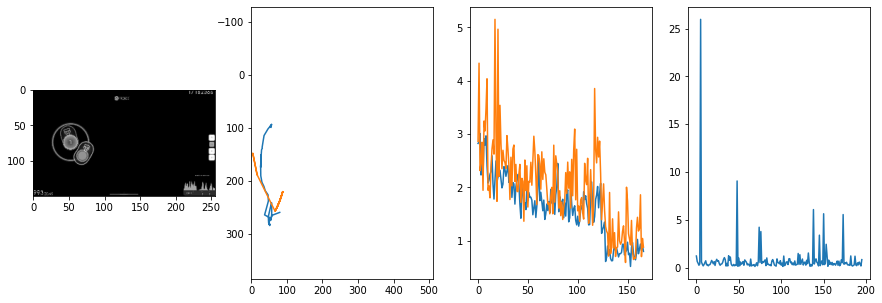


 173 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.4830                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6632721303981177
outliers: 28
retrain: 4                 
val: 50/50 loss: 1.6531                                    
pred: 0.32677948474884033 0.492172509431839
gt: 0.3661397397518158 0.614386260509491
(104, 89)


<Figure size 1080x360 with 0 Axes>

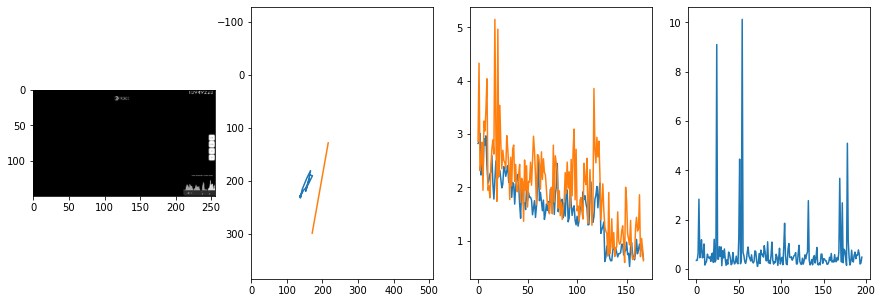


 174 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.3903                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7225963018302407
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.4703                                    
pred: 0.36168962717056274 0.4670974016189575
gt: 0.3197035491466522 0.26195579767227173
(97, 48)


<Figure size 1080x360 with 0 Axes>

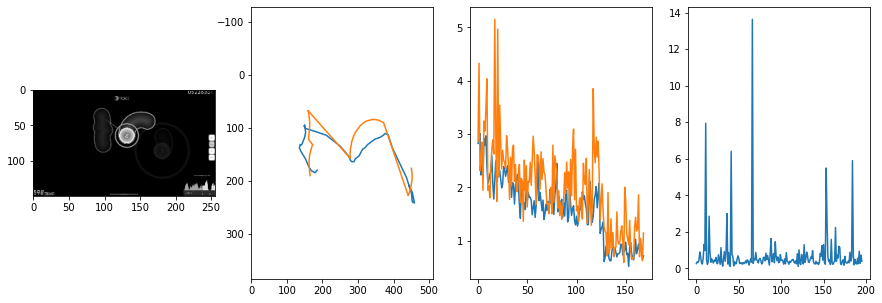


 175 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.2760                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7112738090206165
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.2675                                    
pred: 0.6879127621650696 0.14472176134586334
gt: 0.76171875 0.0885416641831398
(166, 28)


<Figure size 1080x360 with 0 Axes>

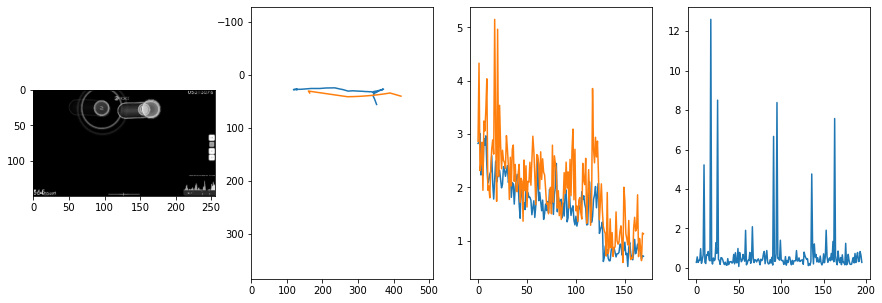


 176 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.6521                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9609487938827702
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.2707                                    
pred: 0.32669395208358765 0.6653205752372742
gt: 0.31571105122566223 0.5700924396514893
(96, 84)


<Figure size 1080x360 with 0 Axes>

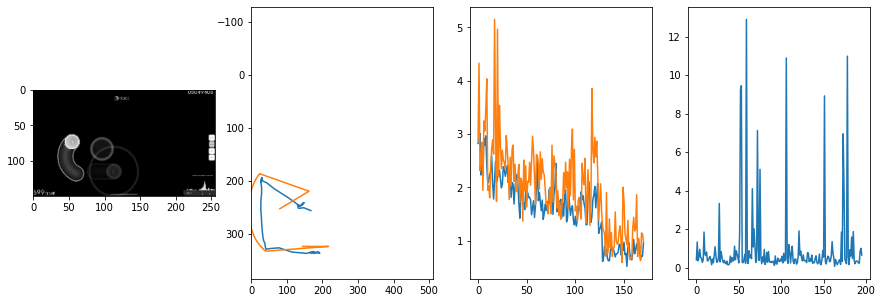


 177 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.2480                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.979059335110443
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.6210                                    
pred: 0.3568616211414337 0.7122216820716858
gt: 0.4179691970348358 0.6953116059303284
(112, 98)


<Figure size 1080x360 with 0 Axes>

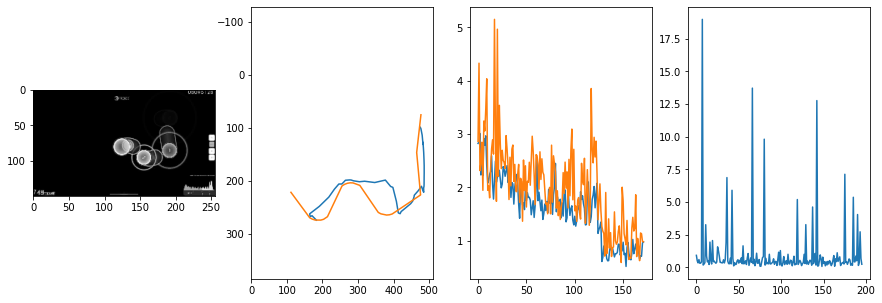


 178 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.1956                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9517198282921192
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.3126                                    
pred: 0.2926591634750366 0.6527379751205444
gt: 0.5761517286300659 0.3958571255207062
(137, 64)


<Figure size 1080x360 with 0 Axes>

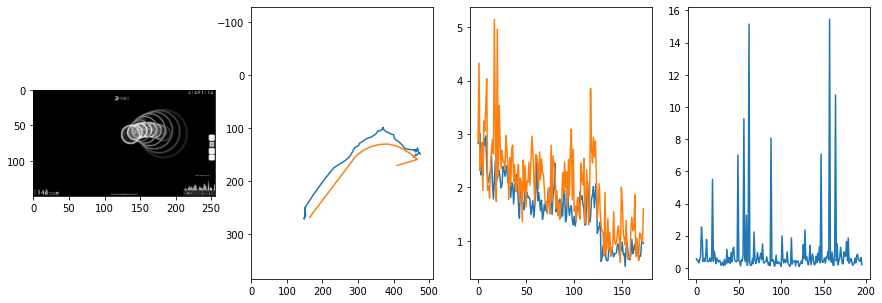


 179 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.4297                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6461204507730293
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.5177                                    
pred: 0.24228471517562866 0.43219858407974243
gt: 0.3075181543827057 0.31592151522636414
(95, 54)


<Figure size 1080x360 with 0 Axes>

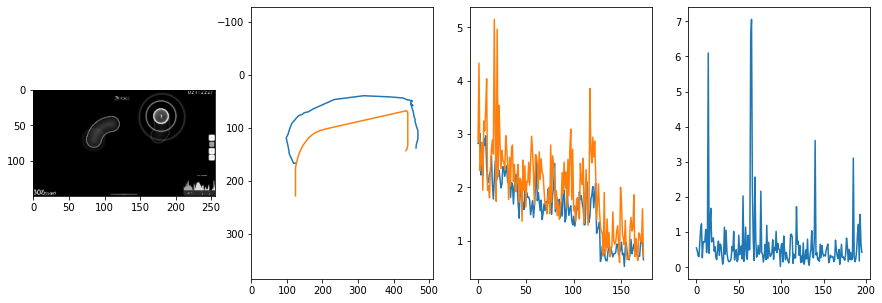


 180 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.3978                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7655788892309885
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.3419                                    
pred: 0.8461155891418457 0.6824568510055542
gt: 0.8537636399269104 0.5311946272850037
(180, 79)


<Figure size 1080x360 with 0 Axes>

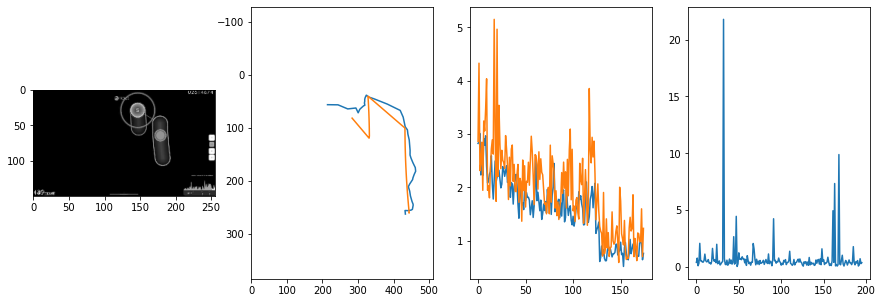


 181 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.4081                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6197683646210602
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.5197                                    
pred: 0.5127187371253967 0.5431200861930847
gt: 0.7089190483093262 0.8982632160186768
(157, 122)


<Figure size 1080x360 with 0 Axes>

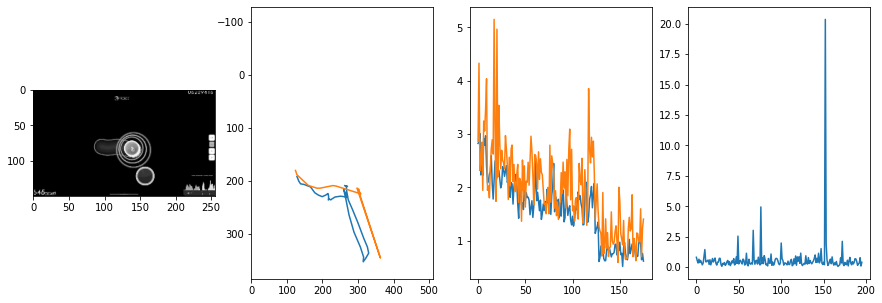


 182 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.4097                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7470306453428098
outliers: 53
retrain: 4                 
val: 50/50 loss: 0.2982                                    
pred: 0.3444488048553467 0.46223950386047363
gt: 0.421875 0.3541666567325592
(113, 59)


<Figure size 1080x360 with 0 Axes>

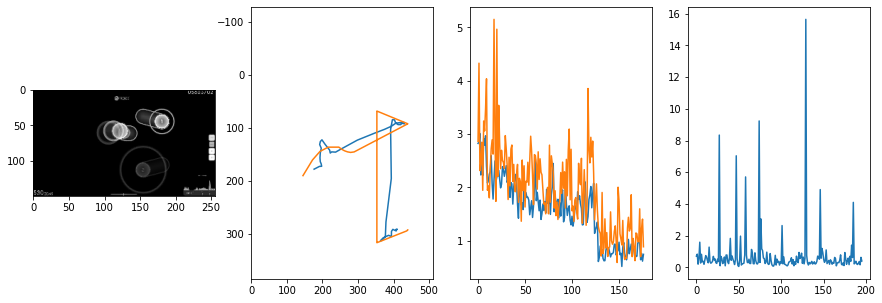


 183 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.2794                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.688543360623322
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.4052                                    
pred: 0.09227548539638519 0.24516993761062622
gt: 0.1134847030043602 0.3592742383480072
(65, 59)


<Figure size 1080x360 with 0 Axes>

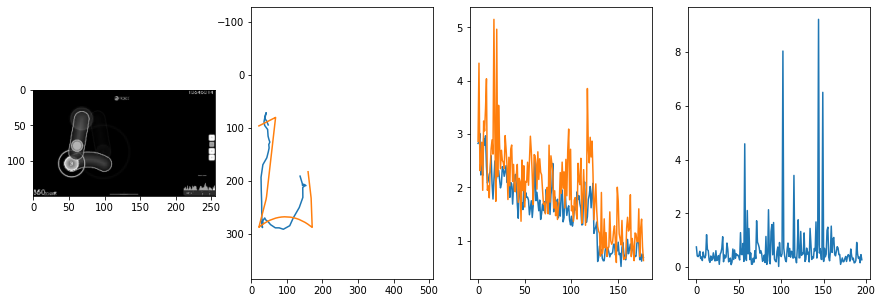


 184 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.3227                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7721088605419714
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.3907                                    
pred: 0.706214427947998 0.5744649171829224
gt: 0.7154611349105835 0.6576687693595886
(158, 94)


<Figure size 1080x360 with 0 Axes>

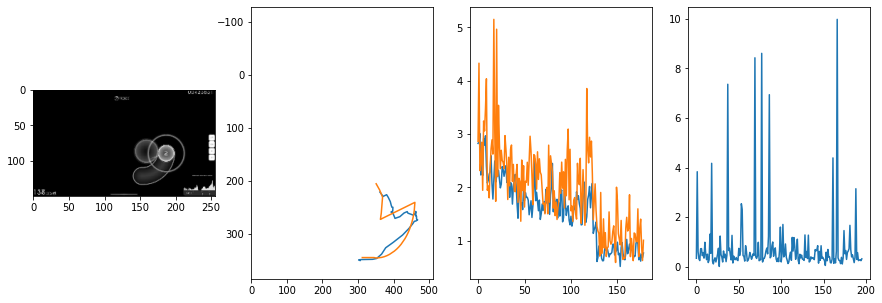


 185 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.4016                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8221954301531825
outliers: 51
retrain: 4                 
val: 50/50 loss: 1.3491                                    
pred: 0.2968039810657501 0.9349460601806641
gt: 0.5184071660041809 0.9523360729217529
(128, 128)


<Figure size 1080x360 with 0 Axes>

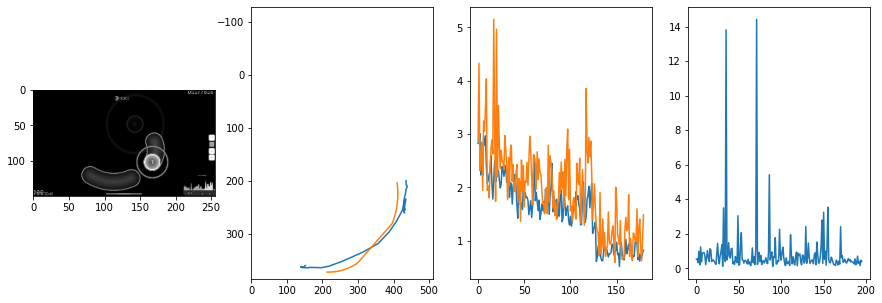


 186 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.1874                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7419588516789432
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.5019                                    
pred: 0.7069540023803711 0.9347209334373474
gt: 0.8659453392028809 0.8067074418067932
(182, 111)


<Figure size 1080x360 with 0 Axes>

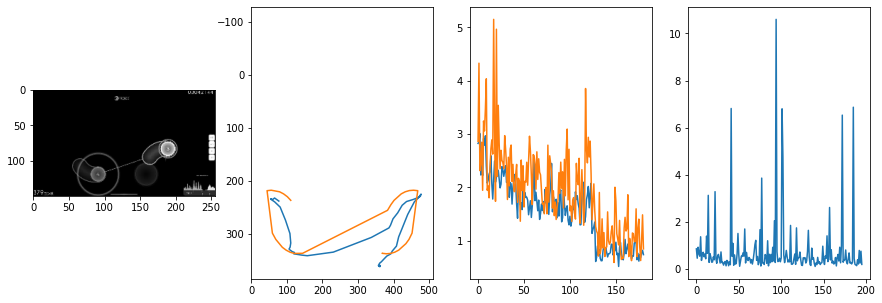


 187 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.2689                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.183958414447855
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.7734                                    
pred: 0.18213747441768646 0.7589474320411682
gt: 0.40051135420799255 0.6549614071846008
(110, 94)


<Figure size 1080x360 with 0 Axes>

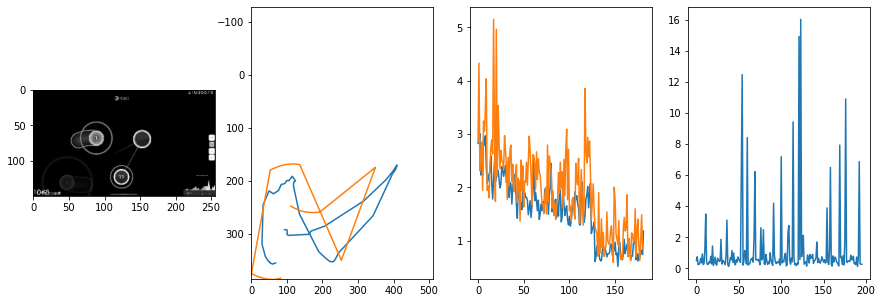


 188 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.5275                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8162976032769194
outliers: 15
retrain: 4                 
val: 50/50 loss: 0.1838                                    
pred: 0.5144288539886475 0.6295452117919922
gt: 0.5518298149108887 0.8474625945091248
(133, 116)


<Figure size 1080x360 with 0 Axes>

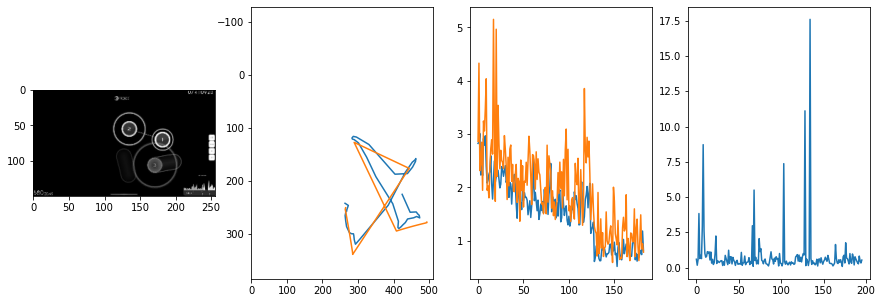


 189 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  0.5325                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8490347143034546
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.9662                                    
pred: 0.2404581606388092 0.11621453613042831
gt: 0.18311777710914612 0.19387535750865936
(76, 40)


<Figure size 1080x360 with 0 Axes>

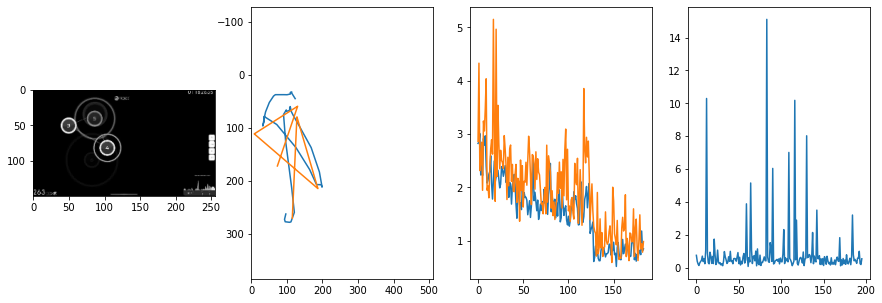


 190 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.2207                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6688999743866069
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.2537                                    
pred: 0.8189421892166138 0.15120473504066467
gt: 0.7664426565170288 0.23185402154922485
(166, 44)


<Figure size 1080x360 with 0 Axes>

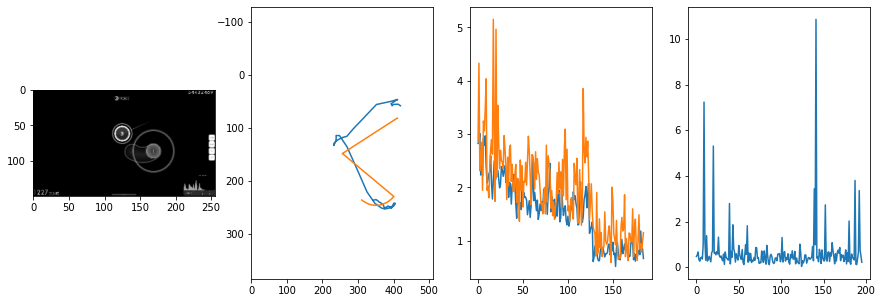


 191 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.2370                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7591718624593043
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.0569                                    
pred: 0.49836161732673645 0.5086221694946289
gt: 0.5000001192092896 0.49999988079071045
(125, 76)


<Figure size 1080x360 with 0 Axes>

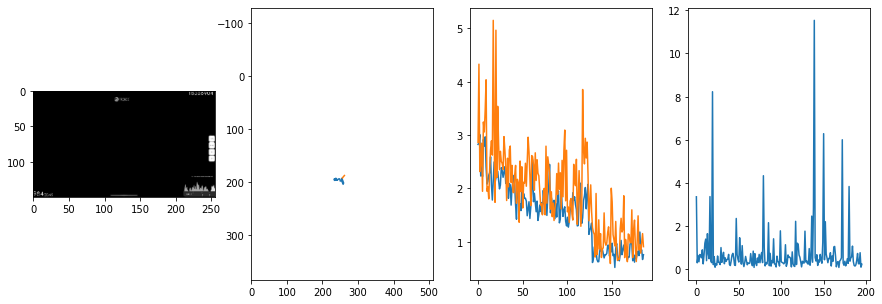


 192 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  0.2929                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8452563263019737
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.4243                                    
pred: 0.07969999313354492 0.6230090260505676
gt: 0.17361053824424744 0.5192906260490417
(74, 78)


<Figure size 1080x360 with 0 Axes>

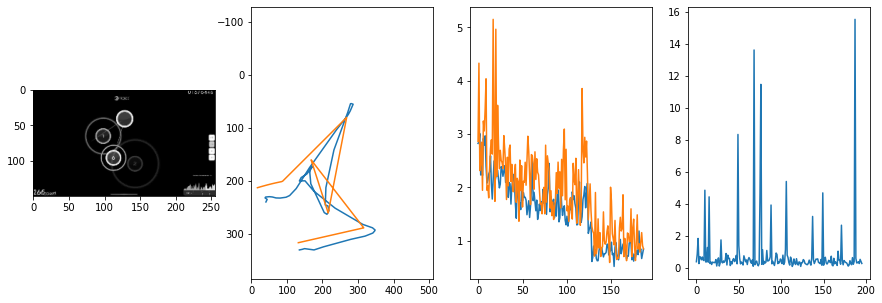


 193 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.7375                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.85179113395208
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.8315                                    
pred: 0.5663333535194397 0.38217291235923767
gt: 0.5325924754142761 0.37725746631622314
(130, 61)


<Figure size 1080x360 with 0 Axes>

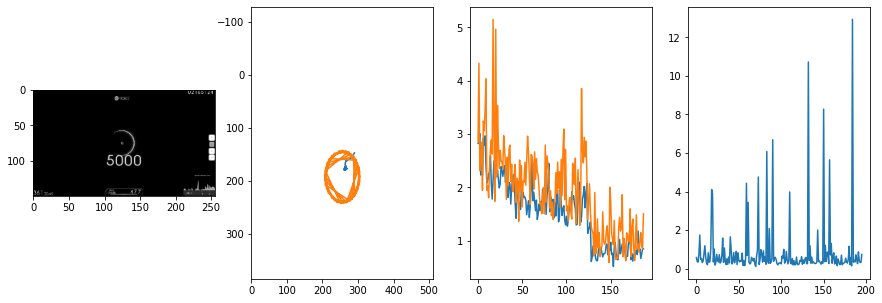


 194 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.3471                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8709737942078892
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.7050                                    
pred: 0.35286179184913635 0.6789489984512329
gt: 0.4420532286167145 0.6843168139457703
(116, 97)


<Figure size 1080x360 with 0 Axes>

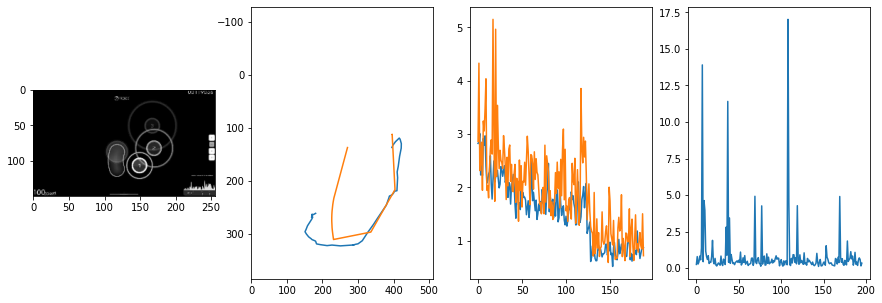


 195 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.2352                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.668698699688729
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.2920                                    
pred: 0.8139994740486145 0.4985818564891815
gt: 0.5423991084098816 0.22861458361148834
(132, 44)


<Figure size 1080x360 with 0 Axes>

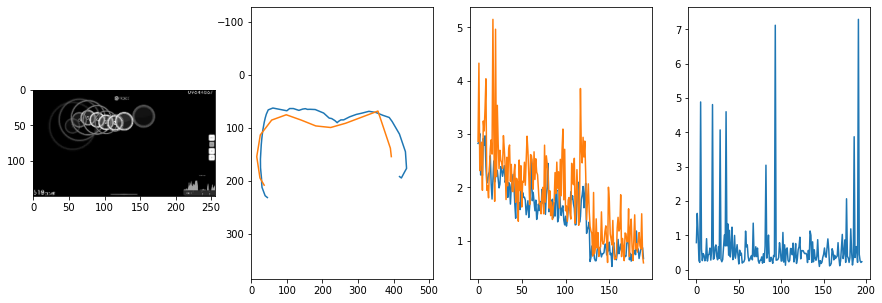


 196 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.2483                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7192935139244917
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.2097                                    
pred: 0.6924955248832703 0.25988173484802246
gt: 0.4962850511074066 0.1039947047829628
(124, 30)


<Figure size 1080x360 with 0 Axes>

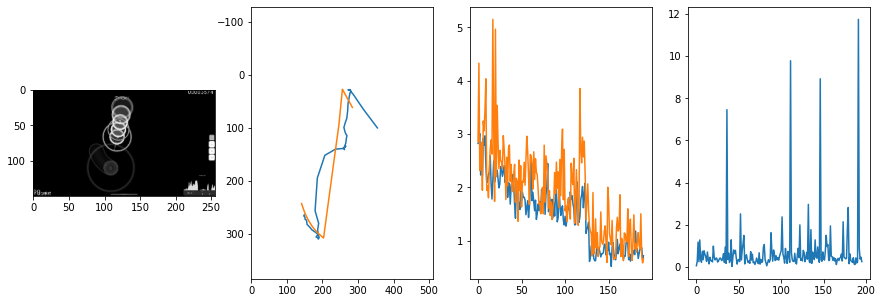


 197 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.2984                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5944642514769672
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.5913                                    
pred: 0.861909806728363 0.414558470249176
gt: 0.8476561307907104 0.6328124403953552
(179, 91)


<Figure size 1080x360 with 0 Axes>

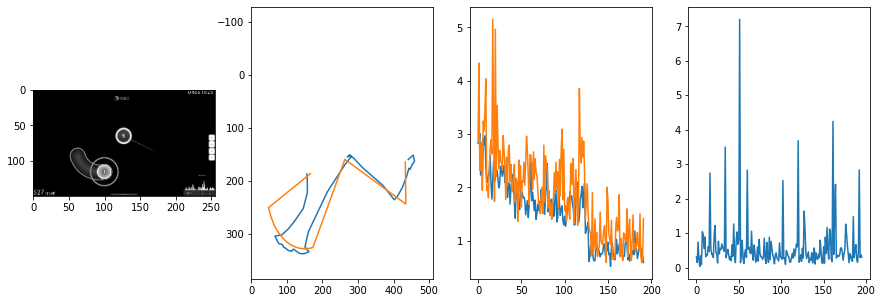


 198 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.6808                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5657946841069021
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.7248                                    
pred: 0.30375757813453674 0.5900020003318787
gt: 0.857421875 0.2578125
(180, 47)


<Figure size 1080x360 with 0 Axes>

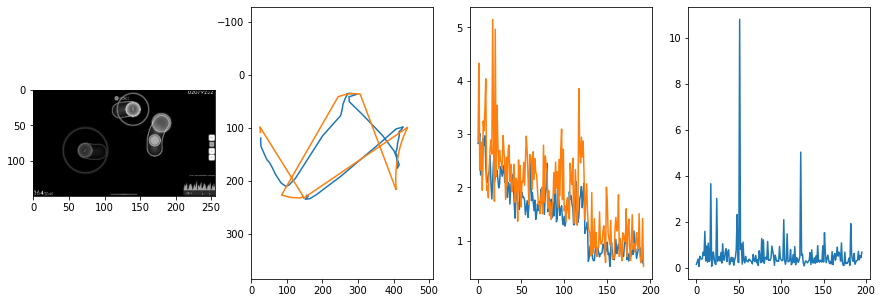


 199 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.3999                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9335367681259024
outliers: 61
retrain: 4                 
val: 50/50 loss: 2.8720                                    
pred: 0.2767682373523712 0.7934098243713379
gt: 0.5429685115814209 0.7239583134651184
(132, 102)


<Figure size 1080x360 with 0 Axes>

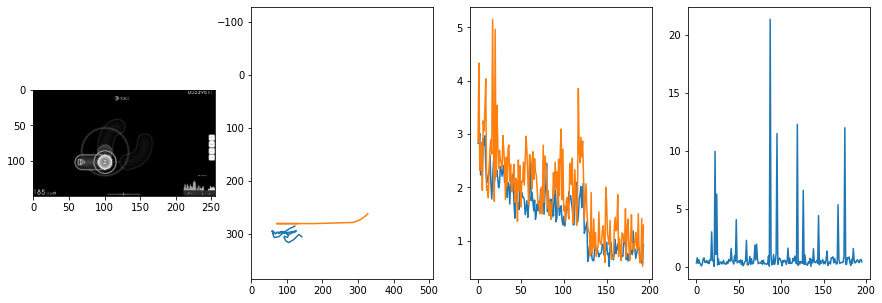


 200 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  0.1899                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0145713510561962
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.6184                                    
pred: 0.8554255366325378 0.14864082634449005
gt: 0.581720769405365 0.25344929099082947
(138, 47)


<Figure size 1080x360 with 0 Axes>

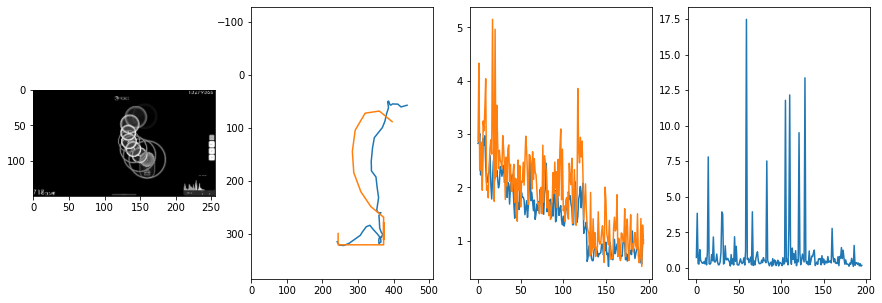


 201 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.1664                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9694799449750964
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.5911                                    
pred: 0.443959504365921 0.2856862545013428
gt: 0.45119327306747437 0.2734449505805969
(117, 49)


<Figure size 1080x360 with 0 Axes>

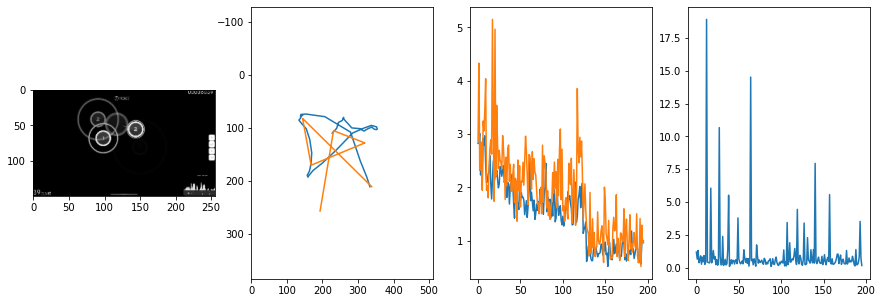


 202 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.2768                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8696651952341199
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.4847                                    
pred: 0.7171081900596619 0.7765374779701233
gt: 0.8593729734420776 0.6354182362556458
(181, 91)


<Figure size 1080x360 with 0 Axes>

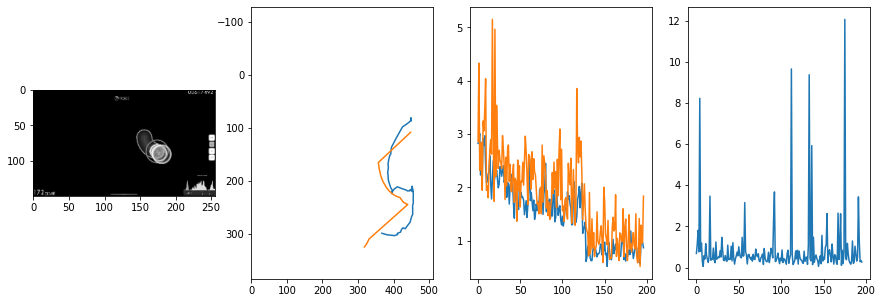


 203 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.6253                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7464359239960203
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.4234                                    
pred: 0.23817940056324005 0.4402562975883484
gt: 0.19992558658123016 0.420070081949234
(79, 66)


<Figure size 1080x360 with 0 Axes>

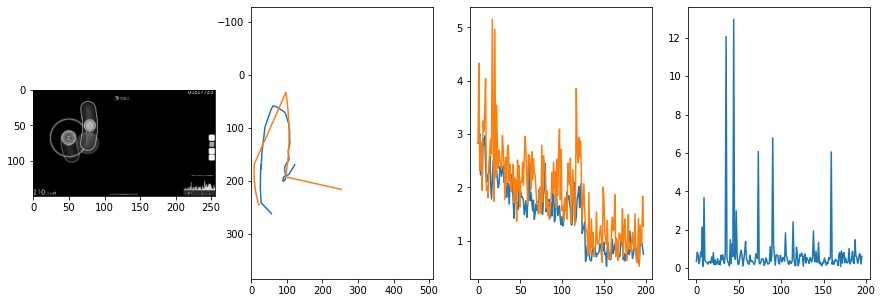


 204 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.3845                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9549792584183873
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.3193                                    
pred: 0.6270543336868286 0.9079957604408264
gt: 0.6171875 0.7540771961212158
(143, 105)


<Figure size 1080x360 with 0 Axes>

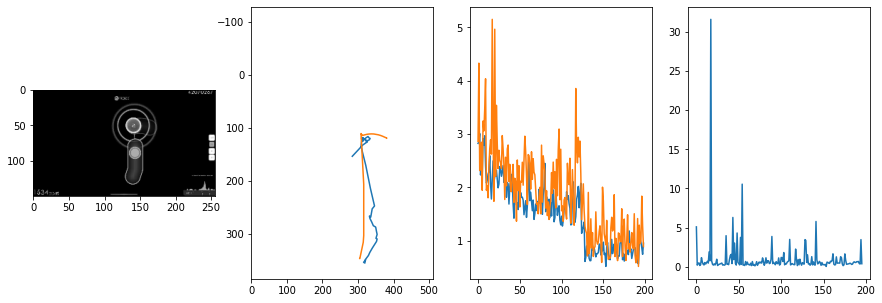


 205 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.3755                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6748104358700161
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.4173                                    
pred: 0.5773260593414307 0.9404954314231873
gt: 0.5021007657051086 0.91606205701828
(125, 124)


<Figure size 1080x360 with 0 Axes>

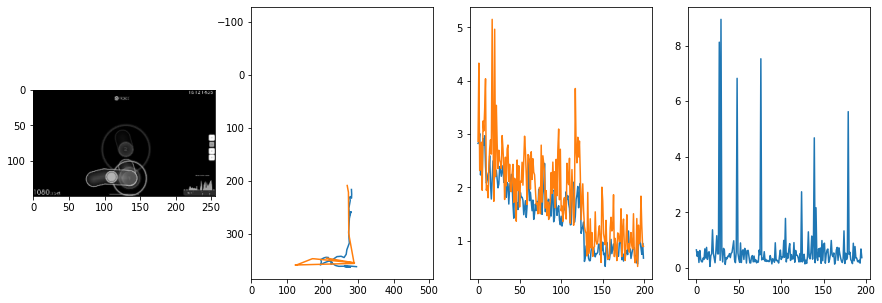


 206 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.4310                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7975977172656935
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.3763                                    
pred: 0.43547943234443665 0.31225207448005676
gt: 0.4531250298023224 0.466145783662796
(118, 72)


<Figure size 1080x360 with 0 Axes>

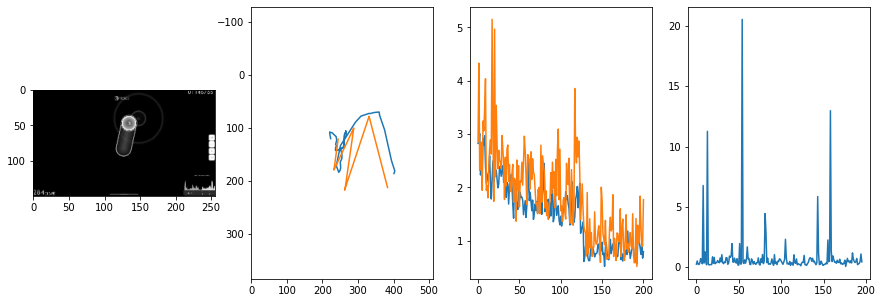


 207 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  1.8687                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9993791426627003
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.4842                                    
pred: 0.20260722935199738 0.31380248069763184
gt: 0.3437500596046448 0.3124999701976776
(101, 54)


<Figure size 1080x360 with 0 Axes>

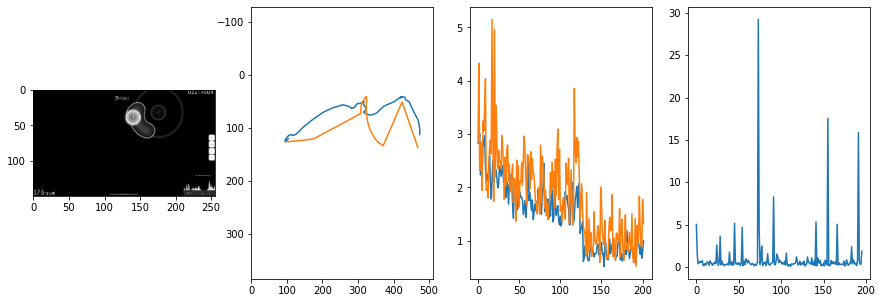


 208 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.3392                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8899068813390878
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.4667                                    
pred: 0.27330631017684937 0.22354254126548767
gt: 0.17773450911045074 0.2239583134651184
(75, 44)


<Figure size 1080x360 with 0 Axes>

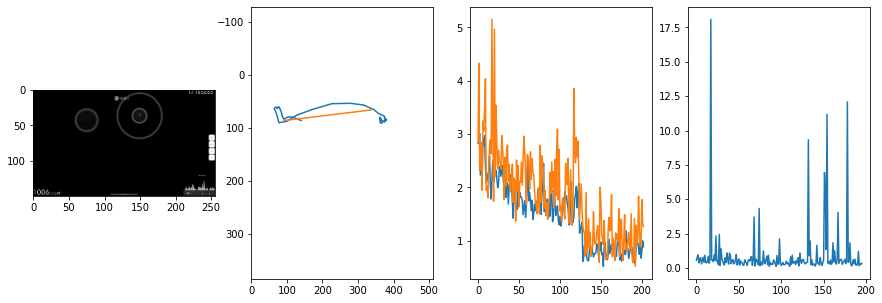


 209 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.25it/s  0.3398                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.973202222920194
outliers: 36
retrain: 4                 
val: 50/50 loss: 15.2782                                   
pred: 0.20875783264636993 0.4567702114582062
gt: 0.8789021372795105 0.4427051246166229
(184, 69)


<Figure size 1080x360 with 0 Axes>

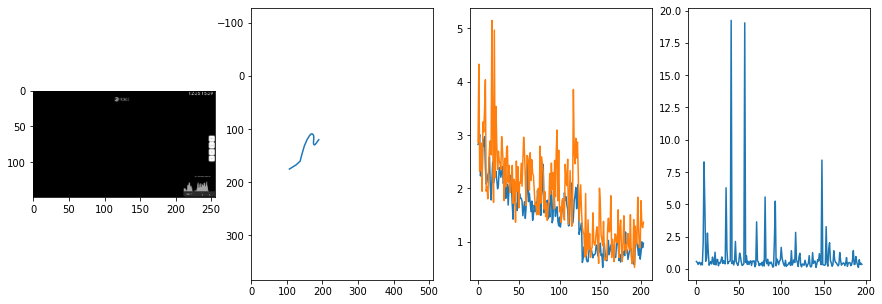


 210 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.3958                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.737333740982018
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.6208                                    
pred: 0.4570811688899994 0.3962976336479187
gt: 0.4375004470348358 0.45833292603492737
(115, 71)


<Figure size 1080x360 with 0 Axes>

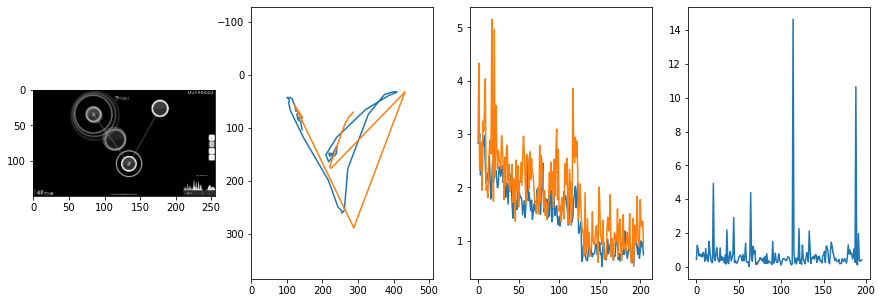


 211 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.5420                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8126037360111974
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.5318                                    
pred: 0.39096203446388245 0.47358107566833496
gt: 0.3887411653995514 0.42434462904930115
(108, 67)


<Figure size 1080x360 with 0 Axes>

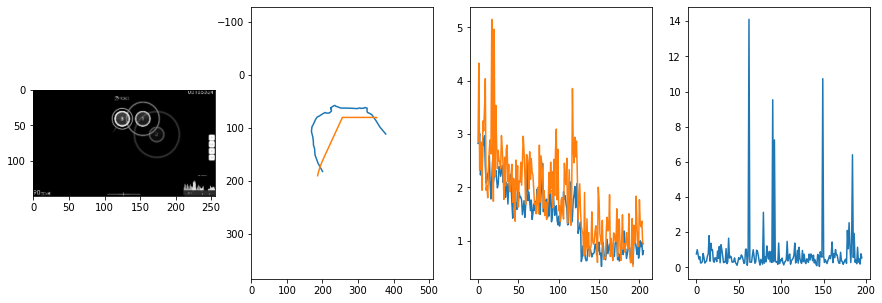


 212 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  1.1322                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8978057557298821
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.3009                                    
pred: 0.3171302080154419 0.6136306524276733
gt: 0.2797815501689911 0.26227208971977234
(91, 48)


<Figure size 1080x360 with 0 Axes>

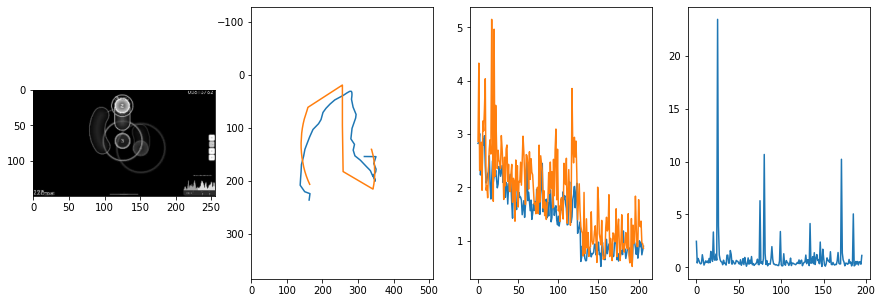


 213 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.1646                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8806109411299837
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.4981                                    
pred: 0.6186820268630981 0.5182709097862244
gt: 0.33622971177101135 0.6739283204078674
(100, 96)


<Figure size 1080x360 with 0 Axes>

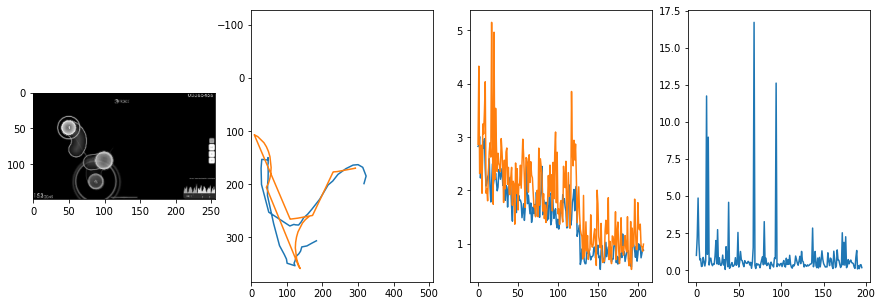


 214 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.24it/s  0.1731                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7484095991037938
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.7754                                    
pred: 0.45213261246681213 0.46972930431365967
gt: 0.4374995827674866 0.9166622757911682
(115, 124)


<Figure size 1080x360 with 0 Axes>

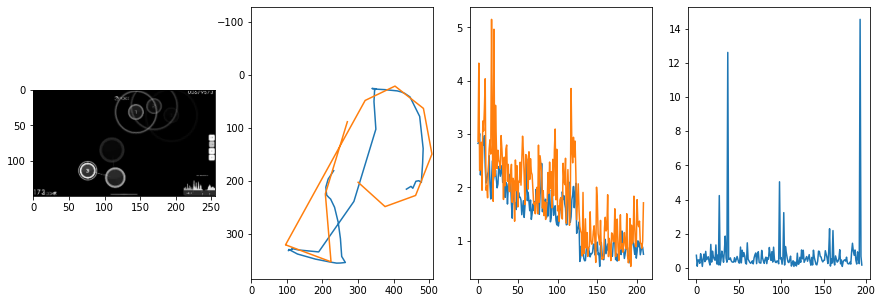


 215 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  0.8187                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0635205442085862
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.6302                                    
pred: 0.28244131803512573 0.2596783936023712
gt: 0.21887843310832977 0.16681890189647675
(81, 37)


<Figure size 1080x360 with 0 Axes>

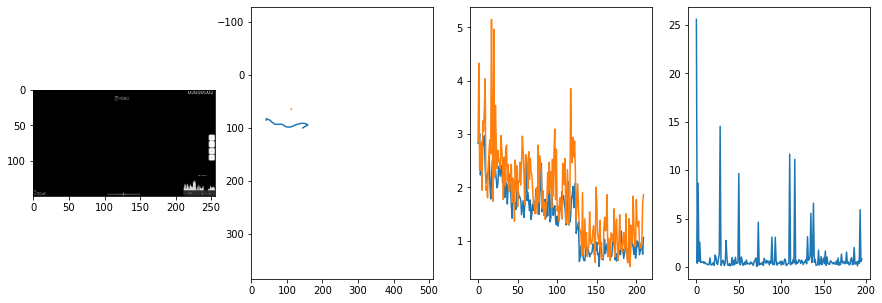


 216 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.1806                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.649749781347203
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.8244                                    
pred: 0.1474234163761139 0.7901073694229126
gt: 0.150390625 0.7916666865348816
(71, 110)


<Figure size 1080x360 with 0 Axes>

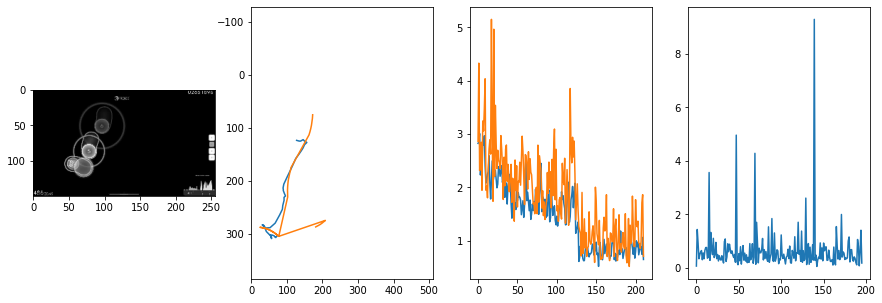


 217 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.2967                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7356283109331009
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.4325                                    
pred: 0.4007222652435303 0.44876086711883545
gt: 0.27343758940696716 0.20833344757556915
(90, 42)


<Figure size 1080x360 with 0 Axes>

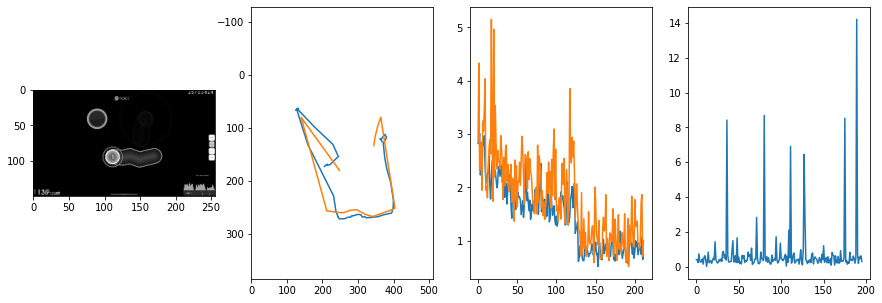


 218 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.6371                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8272557812077659
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.9805                                    
pred: 0.38730114698410034 0.3580656051635742
gt: 0.3847656548023224 0.3515624701976776
(107, 58)


<Figure size 1080x360 with 0 Axes>

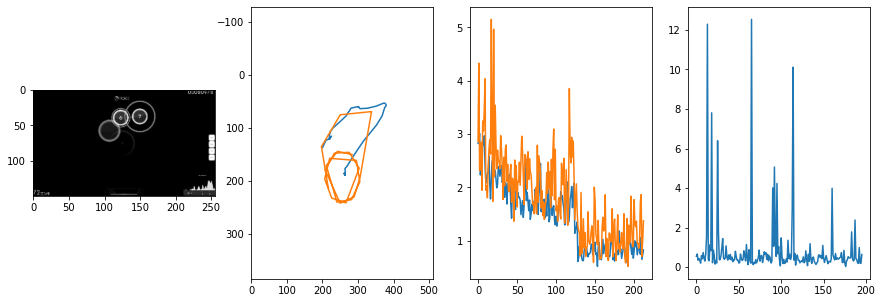


 219 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  1.6899                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5150396722577968
outliers: 17
retrain: 4                 
val: 50/50 loss: 0.3283                                    
pred: 0.29342120885849 0.7739243507385254
gt: 0.13280236721038818 0.7083643078804016
(68, 100)


<Figure size 1080x360 with 0 Axes>

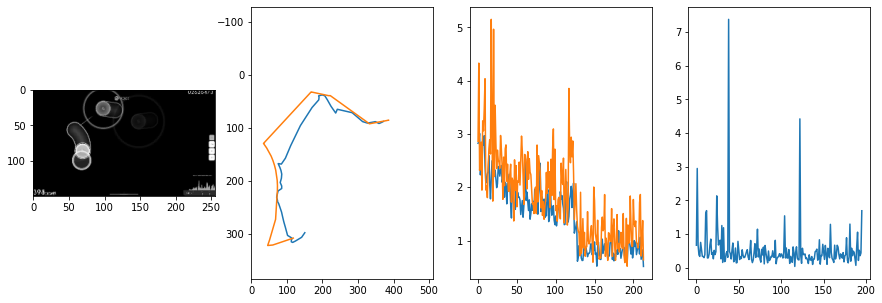


 220 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.0838                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8424272850459936
outliers: 59
retrain: 4                 
val: 50/50 loss: 0.5854                                    
pred: 0.5328977108001709 0.5780520439147949
gt: 0.4147665798664093 0.761322021484375
(112, 106)


<Figure size 1080x360 with 0 Axes>

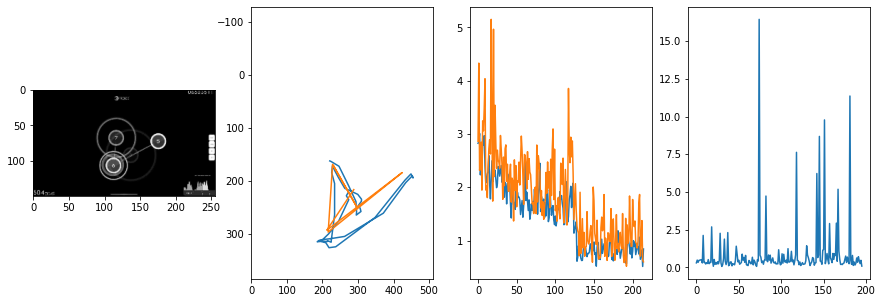


 221 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.3172                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6949021791545104
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.2617                                    
pred: 0.49662506580352783 0.2553325891494751
gt: 0.5738366842269897 0.31812784075737
(136, 55)


<Figure size 1080x360 with 0 Axes>

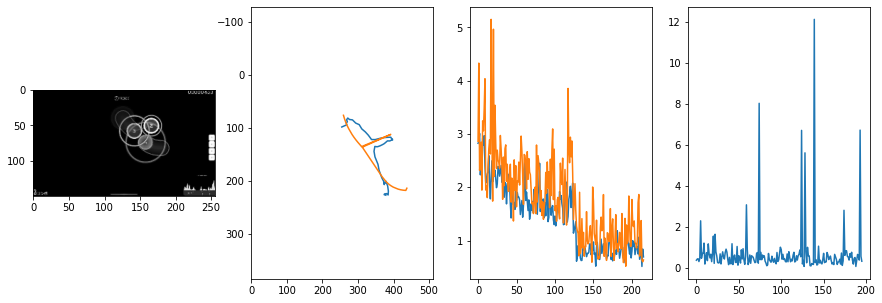


 222 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.8925                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.026447317163859
outliers: 41
retrain: 4                 
val: 50/50 loss: 1.0760                                    
pred: 0.4556887745857239 0.25369399785995483
gt: 0.6503908634185791 0.4010414183139801
(148, 64)


<Figure size 1080x360 with 0 Axes>

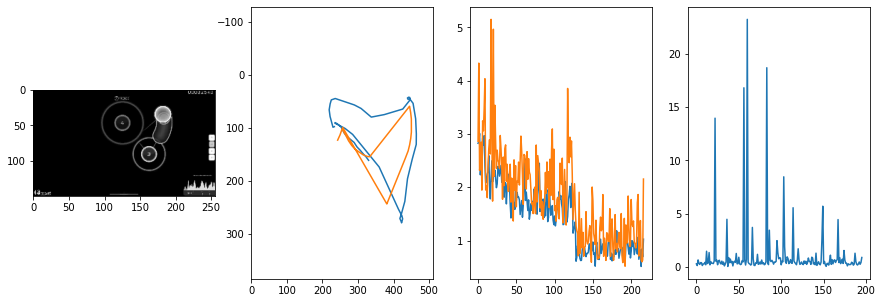


 223 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.2593                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8733807991505885
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.4507                                    
pred: 0.11801688373088837 0.5233932137489319
gt: 0.07226631045341492 0.41666579246520996
(59, 66)


<Figure size 1080x360 with 0 Axes>

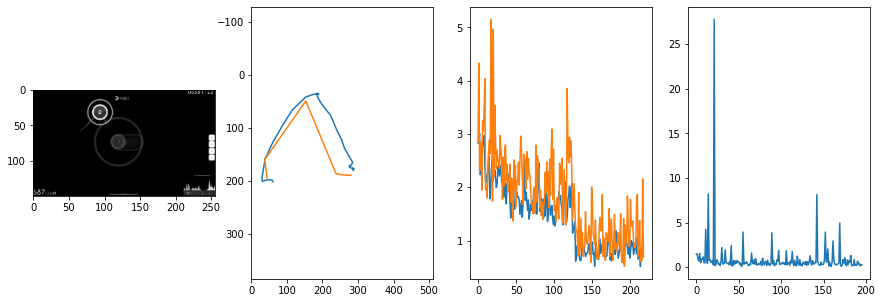


 224 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0979                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5594304113515786
outliers: 20
retrain: 4                 
val: 50/50 loss: 1.0367                                    
pred: 0.3501322865486145 0.306670606136322
gt: 0.33553993701934814 0.2065540999174118
(100, 42)


<Figure size 1080x360 with 0 Axes>

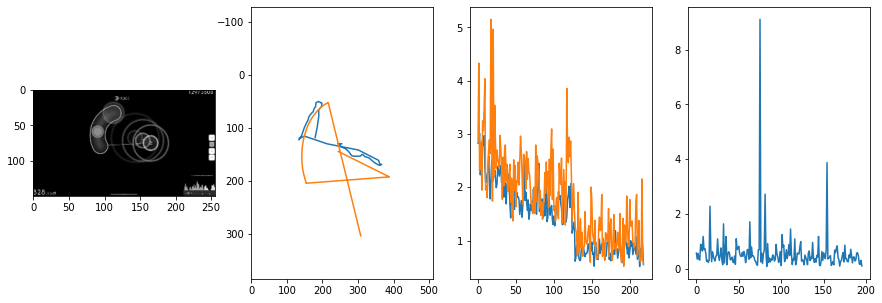


 225 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.2574                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6976859423959133
outliers: 68
retrain: 4                 
val: 50/50 loss: 1.3128                                    
pred: 0.5166430473327637 0.3637847304344177
gt: 0.4218750596046448 0.8541666865348816
(113, 117)


<Figure size 1080x360 with 0 Axes>

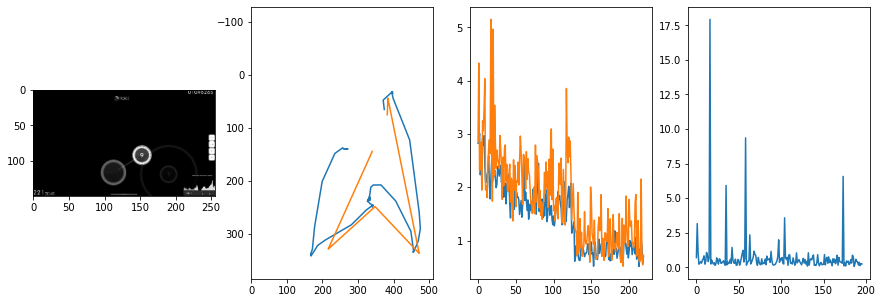


 226 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.4303                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6266512428077736
outliers: 33
retrain: 4                 
val: 50/50 loss: 3.2714                                    
pred: 0.08742891997098923 0.3400840759277344
gt: 0.1261029988527298 0.29097628593444824
(67, 51)


<Figure size 1080x360 with 0 Axes>

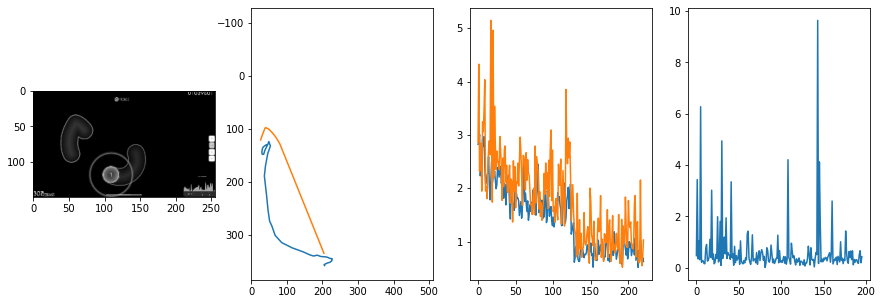


 227 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.4147                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.645165076099184
outliers: 50
retrain: 4                 
val: 50/50 loss: 0.4675                                    
pred: 0.42211079597473145 0.5028397440910339
gt: 0.23632393777370453 0.42446717619895935
(84, 67)


<Figure size 1080x360 with 0 Axes>

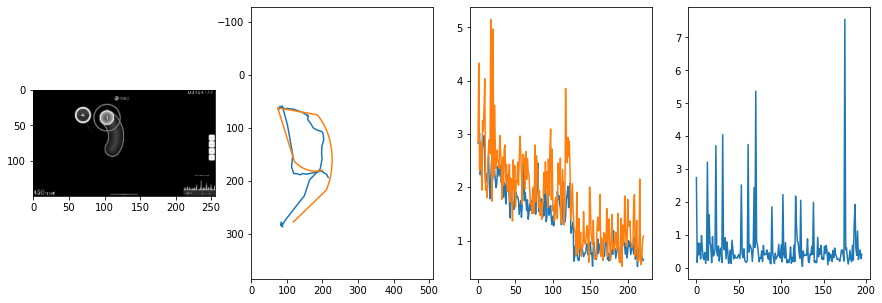


 228 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.2885                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7332410039570258
outliers: 48
retrain: 4                 
val: 50/50 loss: 8.8514                                    
pred: 0.5329681634902954 0.5493444800376892
gt: 0.16332708299160004 0.38552698493003845
(73, 62)


<Figure size 1080x360 with 0 Axes>

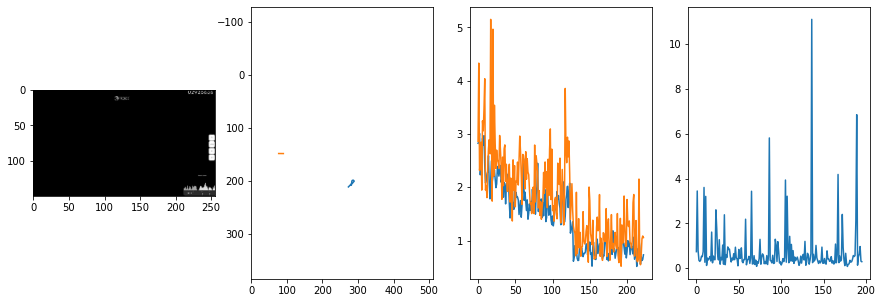


 229 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.5690                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8736115247011185
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.2135                                    
pred: 0.4415523409843445 0.43934234976768494
gt: 0.701171875 0.3984375
(156, 64)


<Figure size 1080x360 with 0 Axes>

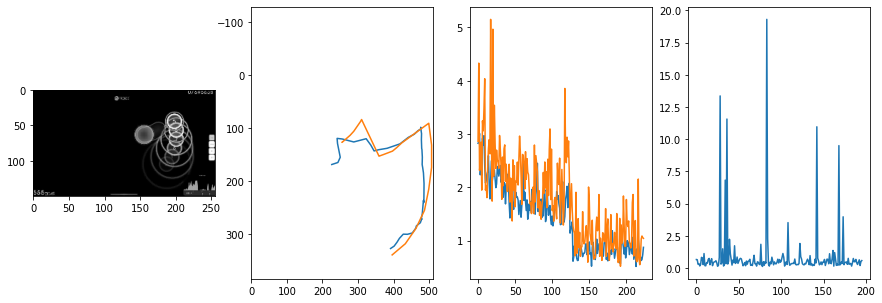


 230 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.2633                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8656326799976582
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.3021                                    
pred: 0.15515878796577454 0.2738330364227295
gt: 0.25467655062675476 0.3523411750793457
(87, 58)


<Figure size 1080x360 with 0 Axes>

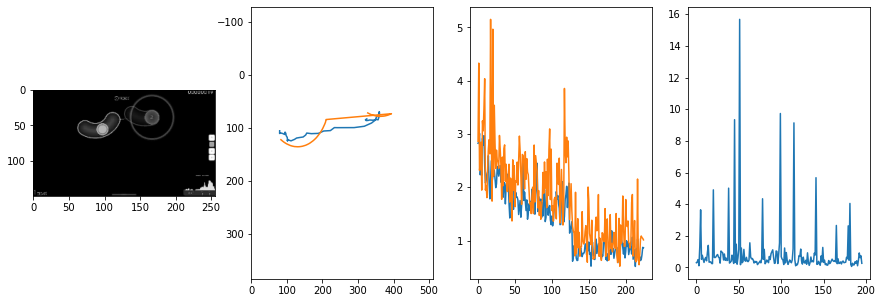


 231 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  1.8213                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6534883536550463
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.3080                                    
pred: 0.43486541509628296 0.21983040869235992
gt: 0.6718511581420898 0.6145533919334412
(152, 89)


<Figure size 1080x360 with 0 Axes>

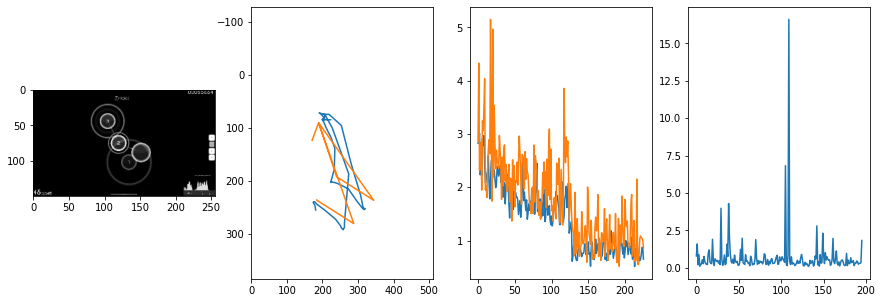


 232 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.3496                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6078797401670291
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.6748                                    
pred: 0.43412545323371887 0.16790421307086945
gt: 0.474609375 0.6744791865348816
(121, 96)


<Figure size 1080x360 with 0 Axes>

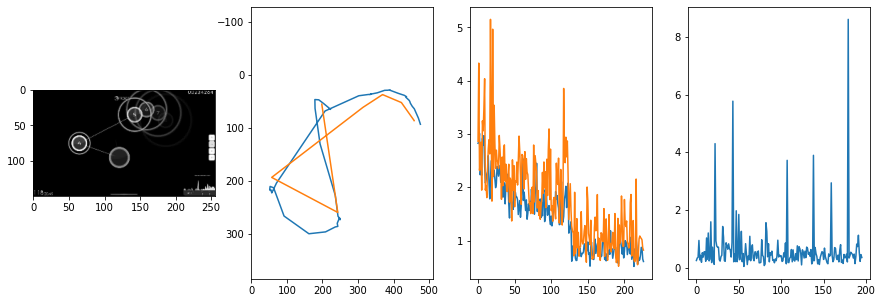


 233 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.2347                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6034742767105297
outliers: 53
retrain: 4                 
val: 50/50 loss: 0.3086                                    
pred: 0.5680923461914062 0.7597054243087769
gt: 0.6088674664497375 0.8527891039848328
(142, 117)


<Figure size 1080x360 with 0 Axes>

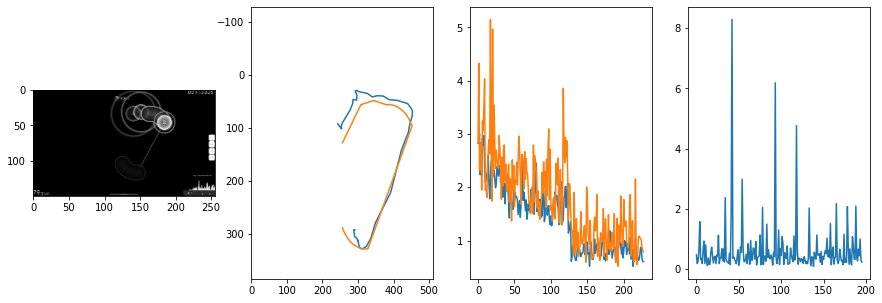


 234 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.1579                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6592210455588541
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.7234                                    
pred: 0.5089306831359863 0.5076134204864502
gt: 0.5709999799728394 0.4696666896343231
(136, 72)


<Figure size 1080x360 with 0 Axes>

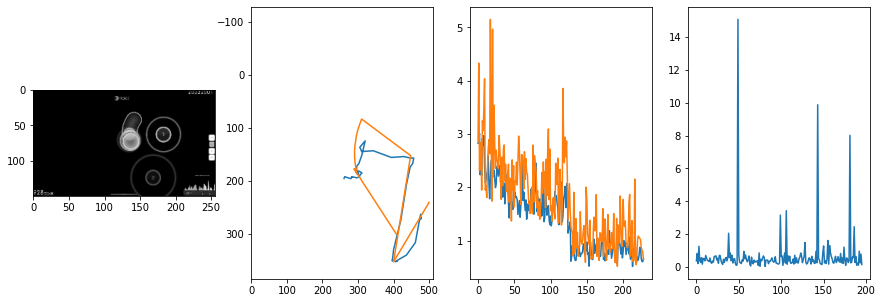


 235 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2778                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8026656683116239
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.3028                                    
pred: 0.3093768060207367 0.5135257244110107
gt: 0.27298489212989807 0.3335880935192108
(90, 56)


<Figure size 1080x360 with 0 Axes>

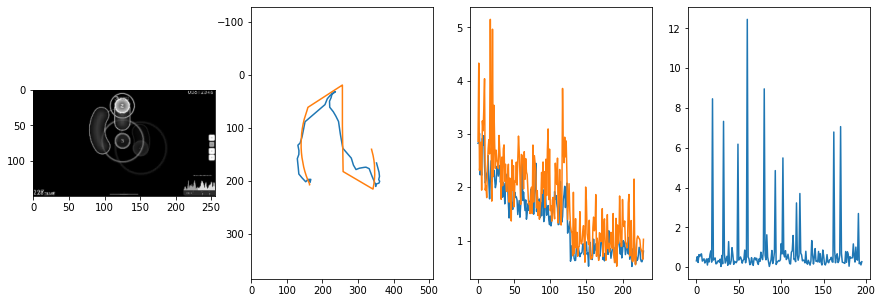


 236 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.45it/s  1.8463                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0247702407745682
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.4502                                    
pred: 0.5422413349151611 0.9197564125061035
gt: 0.5872458219528198 0.8667092323303223
(139, 118)


<Figure size 1080x360 with 0 Axes>

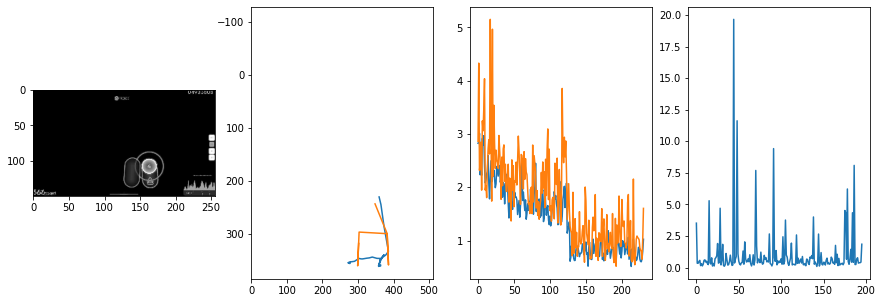


 237 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.3447                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8557499321747799
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.3859                                    
pred: 0.5304558277130127 0.7378482818603516
gt: 0.49933546781539917 0.500390887260437
(125, 76)


<Figure size 1080x360 with 0 Axes>

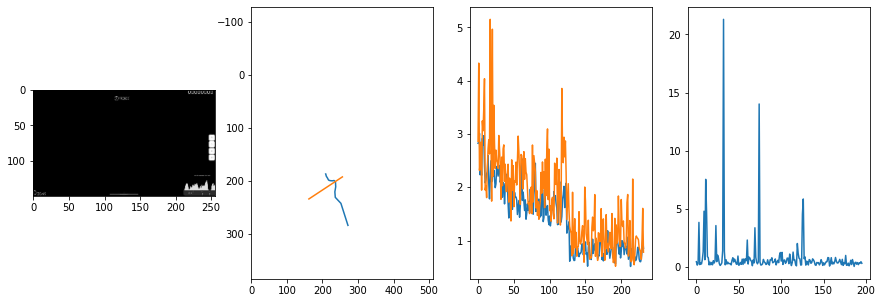


 238 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.31it/s  0.6114                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8222501158182111
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.1551                                    
pred: 0.6607180237770081 0.7947246432304382
gt: 0.5253878235816956 0.8151013851165771
(129, 112)


<Figure size 1080x360 with 0 Axes>

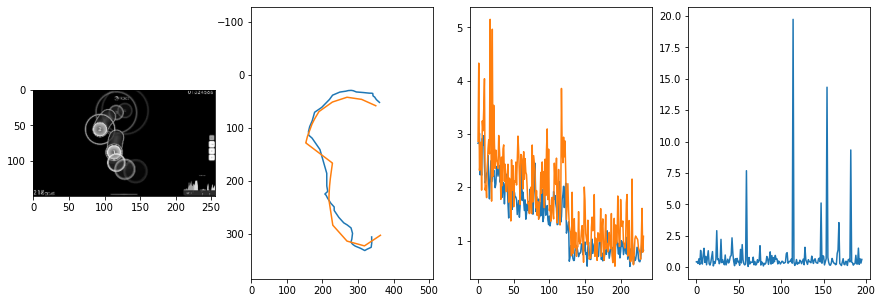


 239 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.3702                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9909001641279581
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.3714                                    
pred: 0.7265405654907227 0.5382116436958313
gt: 0.6875000596046448 0.427083820104599
(154, 67)


<Figure size 1080x360 with 0 Axes>

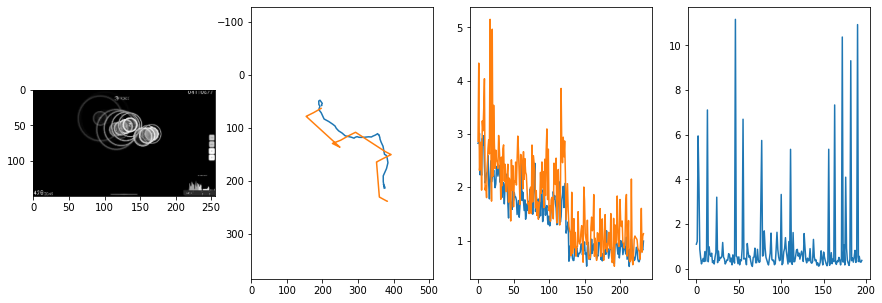


 240 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.3991                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6772013162547836
outliers: 17
retrain: 4                 
val: 50/50 loss: 0.5109                                    
pred: 0.2945484220981598 0.4993361830711365
gt: 0.4765625 0.3541666567325592
(121, 59)


<Figure size 1080x360 with 0 Axes>

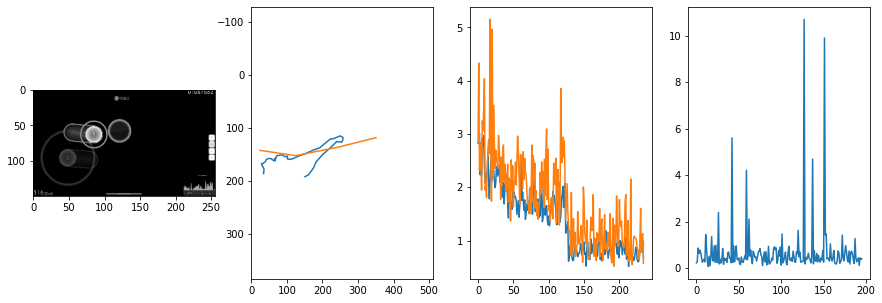


 241 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  5.3502                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7139288887799699
outliers: 58
retrain: 4                 
val: 50/50 loss: 0.6532                                    
pred: 0.519158661365509 0.6263319253921509
gt: 0.47603732347488403 0.589352548122406
(121, 86)


<Figure size 1080x360 with 0 Axes>

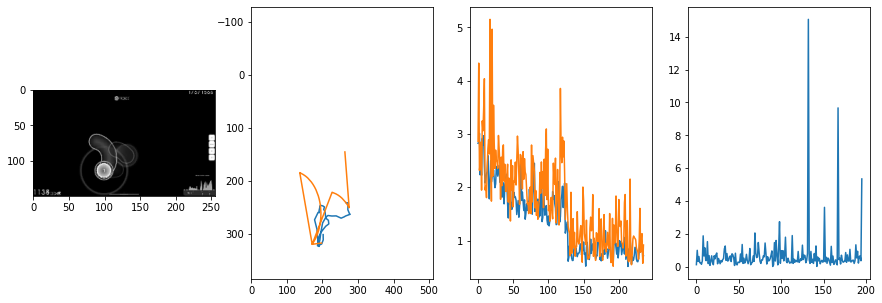


 242 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.2022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9115167967214877
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.5905                                    
pred: 0.5074564218521118 0.5180149078369141
gt: 0.5973328351974487 0.4894115924835205
(140, 74)


<Figure size 1080x360 with 0 Axes>

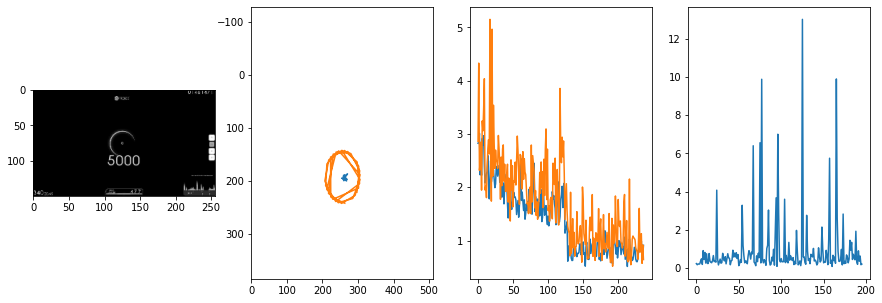


 243 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  5.5007                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9438518435903349
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.7472                                    
pred: 0.7837432622909546 0.1670006364583969
gt: 0.3671875 0.2083333283662796
(104, 42)


<Figure size 1080x360 with 0 Axes>

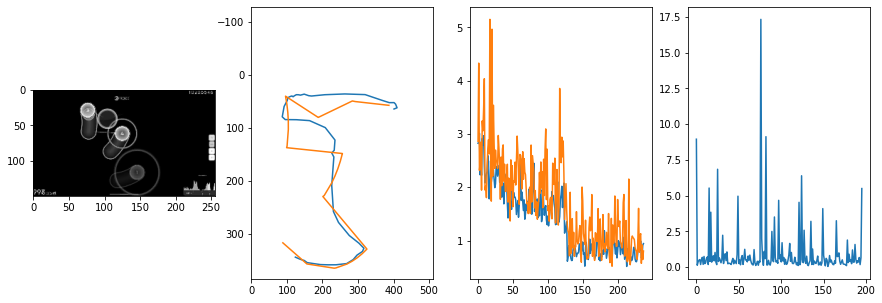


 244 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2751                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8771440518677843
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.3737                                    
pred: 0.7115078568458557 0.7874860763549805
gt: 0.9179674386978149 0.7656256556510925
(190, 107)


<Figure size 1080x360 with 0 Axes>

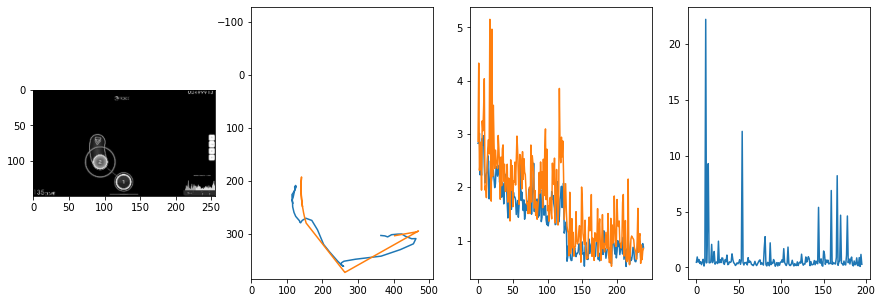


 245 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  1.6225                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.820830868899214
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.5277                                    
pred: 0.5395277738571167 0.47815075516700745
gt: 0.3866833448410034 0.16020898520946503
(107, 36)


<Figure size 1080x360 with 0 Axes>

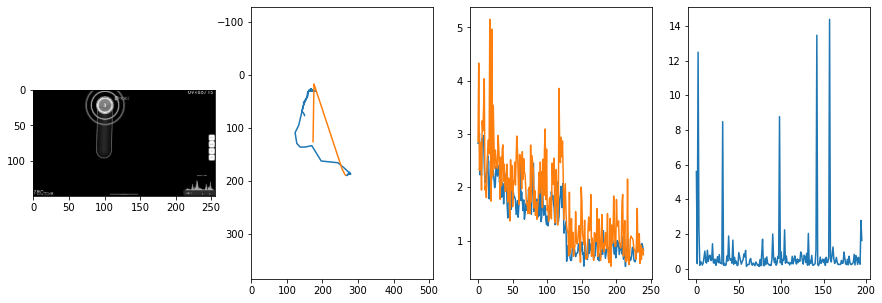


 246 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.47it/s  0.3584                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0810564381963745
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.3375                                    
pred: 0.3660260736942291 0.595655083656311
gt: 0.0 0.3723958432674408
(48, 61)


<Figure size 1080x360 with 0 Axes>

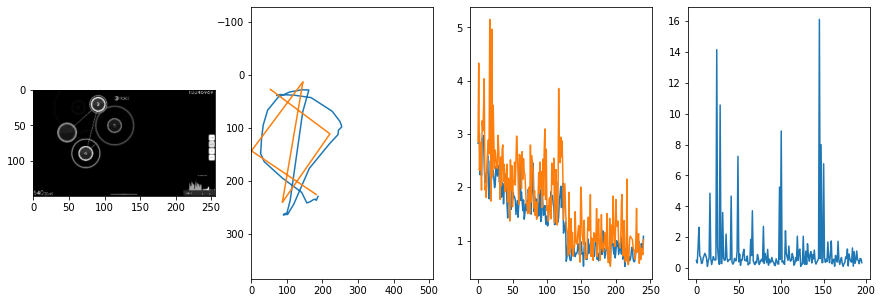


 247 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.2007                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7671332433439639
outliers: 21
retrain: 4                 
val: 50/50 loss: 9.9388                                    
pred: 0.4269658923149109 0.24578359723091125
gt: 0.1888456791639328 0.1289975494146347
(77, 33)


<Figure size 1080x360 with 0 Axes>

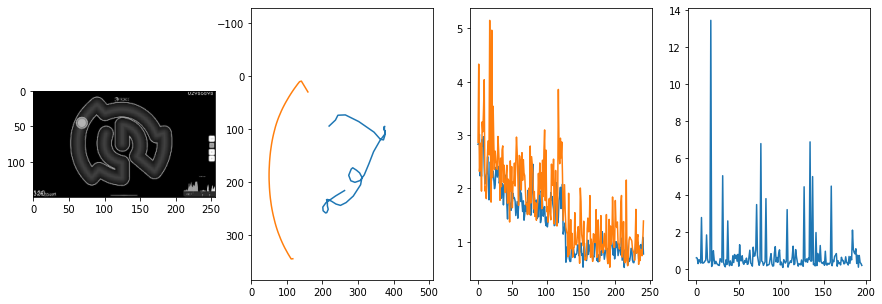


 248 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.42it/s  0.2818                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7374442557101043
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.5528                                    
pred: 0.7847908139228821 0.6010489463806152
gt: 0.7578125 0.6041666269302368
(165, 88)


<Figure size 1080x360 with 0 Axes>

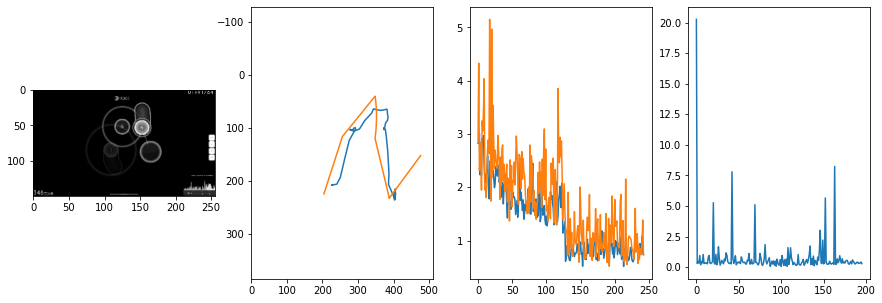


 249 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.34it/s  0.6529                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.562306300223786
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.6394                                    
pred: 0.5213757157325745 0.5264917016029358
gt: 0.5382727384567261 0.38020801544189453
(131, 62)


<Figure size 1080x360 with 0 Axes>

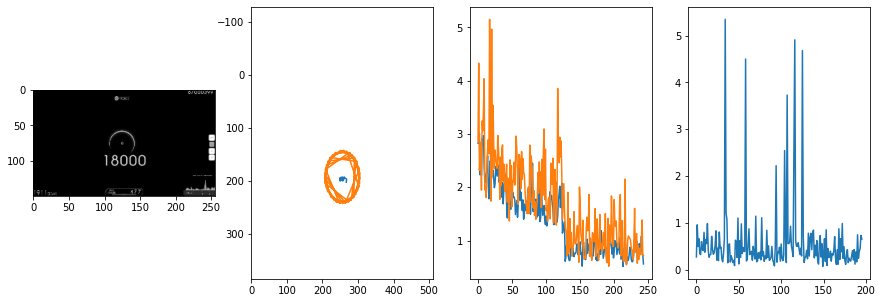


 250 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.1915                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6238902019983044
outliers: 56
retrain: 4                 
val: 50/50 loss: 0.3740                                    
pred: 0.40415674448013306 0.5375884771347046
gt: 0.6475381851196289 0.8029558658599854
(148, 111)


<Figure size 1080x360 with 0 Axes>

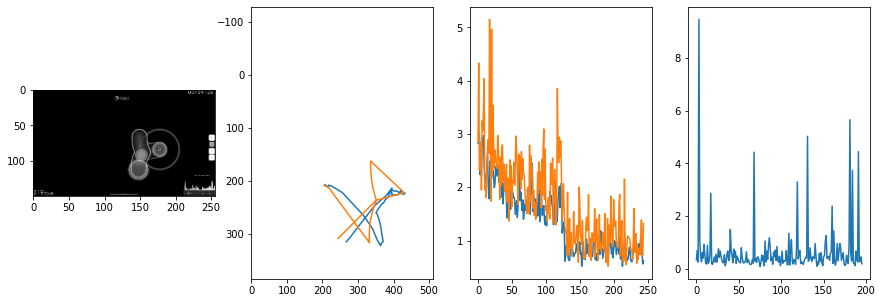


 251 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.5287                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8392895144619503
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.3297                                    
pred: 0.4809282422065735 0.5420295000076294
gt: 0.40592536330223083 0.5349400639533997
(110, 80)


<Figure size 1080x360 with 0 Axes>

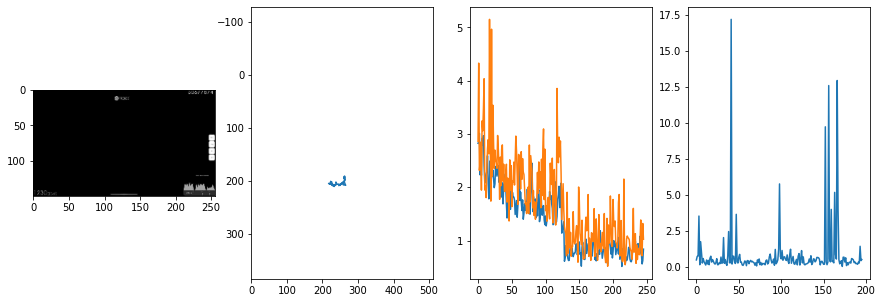


 252 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.2859                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8278134705555834
outliers: 33
retrain: 4                 
val: 50/50 loss: 1.3643                                    
pred: 0.31909894943237305 0.6844399571418762
gt: 0.36325782537460327 0.5539724230766296
(104, 82)


<Figure size 1080x360 with 0 Axes>

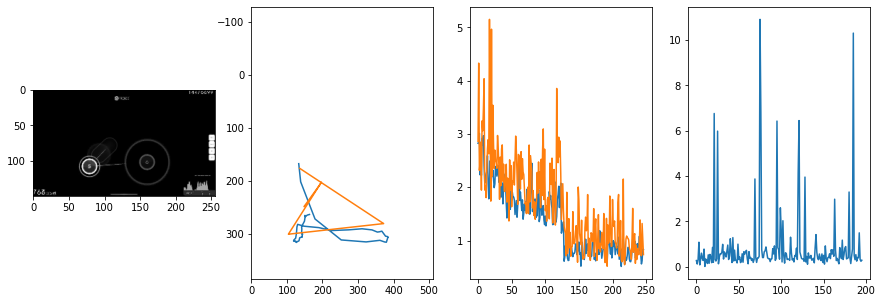


 253 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.3457                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6648019600507556
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.6447                                    
pred: 0.9115715622901917 0.7395462393760681
gt: 0.9112751483917236 0.7715316414833069
(189, 107)


<Figure size 1080x360 with 0 Axes>

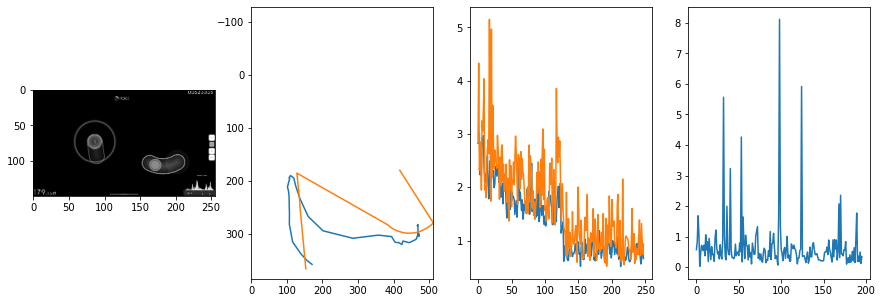


 254 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.29it/s  0.4279                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.75816074625722
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.5033                                    
pred: 0.348609983921051 0.25204604864120483
gt: 0.375 0.2916666567325592
(106, 51)


<Figure size 1080x360 with 0 Axes>

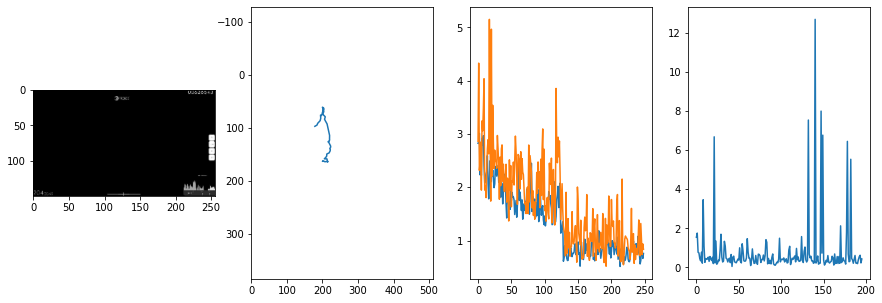


 255 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.7130                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.007003570127548
outliers: 43
retrain: 4                 
val: 50/50 loss: 2.2470                                    
pred: 0.2620205283164978 0.45128458738327026
gt: 0.24218760430812836 0.20052094757556915
(85, 41)


<Figure size 1080x360 with 0 Axes>

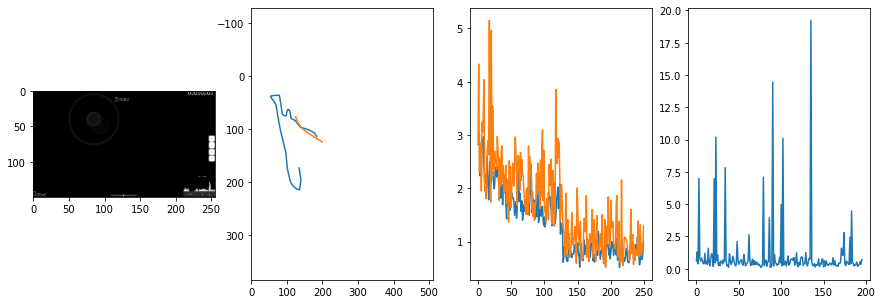


 256 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.3238                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7477777021728
outliers: 24
retrain: 4                 
val: 50/50 loss: 2.8466                                    
pred: 0.7080239057540894 0.33917704224586487
gt: 0.4999992549419403 0.4999988377094269
(125, 76)


<Figure size 1080x360 with 0 Axes>

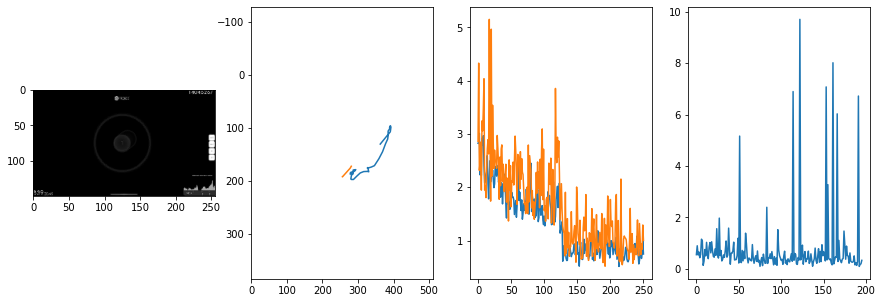


 257 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.3749                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5605233074641045
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.4604                                    
pred: 0.08537856489419937 0.5604805946350098
gt: 0.22460943460464478 0.5546877384185791
(82, 82)


<Figure size 1080x360 with 0 Axes>

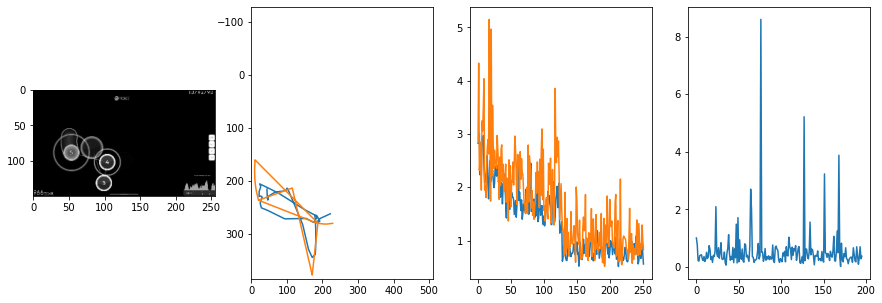


 258 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.2570                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.674167872007404
outliers: 59
retrain: 4                 
val: 50/50 loss: 0.6917                                    
pred: 0.08531482517719269 0.5115790367126465
gt: 0.052735570818185806 0.4270843267440796
(56, 67)


<Figure size 1080x360 with 0 Axes>

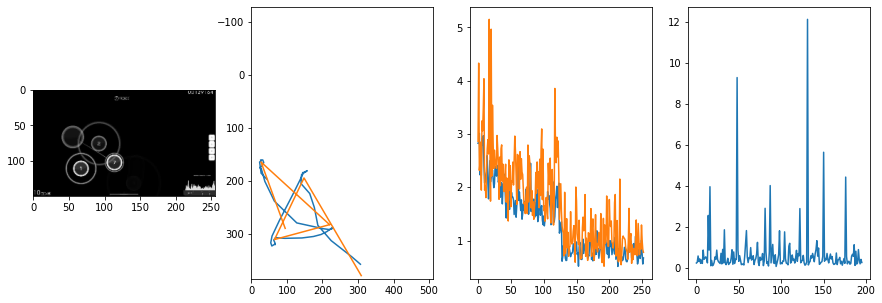


 259 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.3458                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6210597254031774
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.3181                                    
pred: 0.24051369726657867 0.8771960139274597
gt: 0.3142602741718292 0.681626558303833
(96, 97)


<Figure size 1080x360 with 0 Axes>

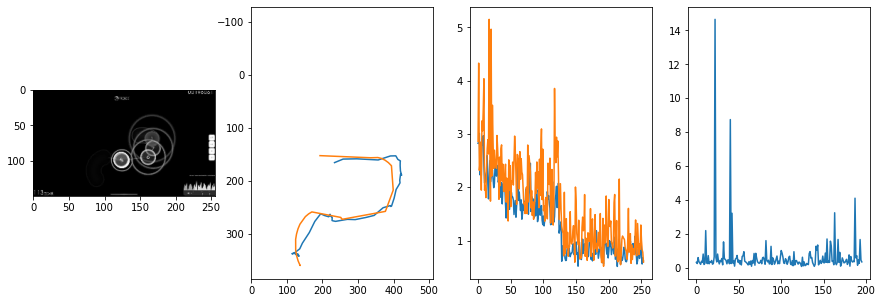


 260 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.6396                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8434948491654835
outliers: 63
retrain: 4                 
val: 50/50 loss: 0.2657                                    
pred: 0.86465984582901 0.2628844380378723
gt: 0.8812059760093689 0.3435880243778229
(184, 57)


<Figure size 1080x360 with 0 Axes>

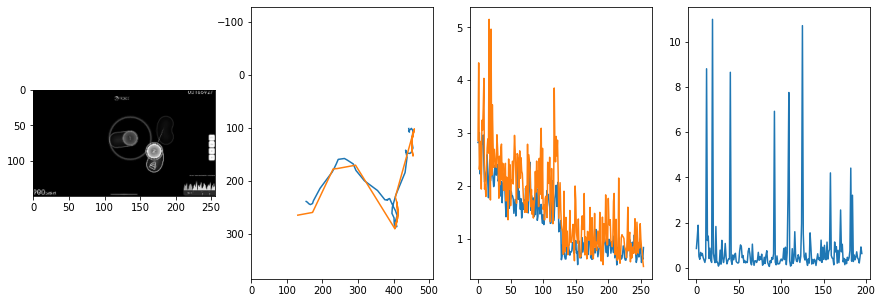


 261 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.36it/s  3.2466                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8578854246939324
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.7270                                    
pred: 0.39493289589881897 0.10188938677310944
gt: 0.45311370491981506 0.08073929697275162
(118, 27)


<Figure size 1080x360 with 0 Axes>

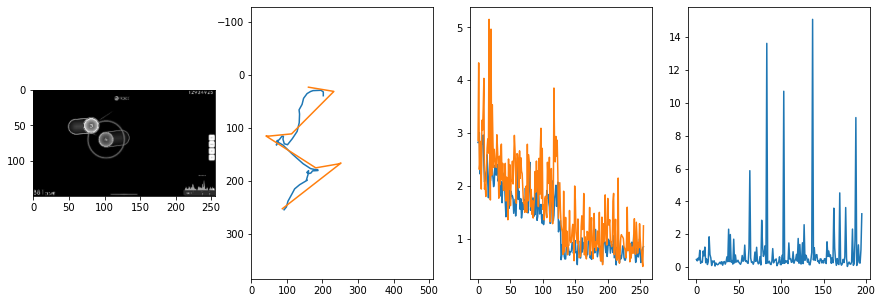


 262 of 262
2470.715709924698 secs


In [25]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [26]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

0.48621356070041655


In [27]:
best_loss = 9999

1 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.2362                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.682891328457971
outliers: 19
retrain: 4                 
val: 50/50 loss: 0.9707                                    
pred: 0.4608040750026703 0.39899110794067383
gt: 0.5182090997695923 0.2282242774963379
(128, 44)


<Figure size 1080x360 with 0 Axes>

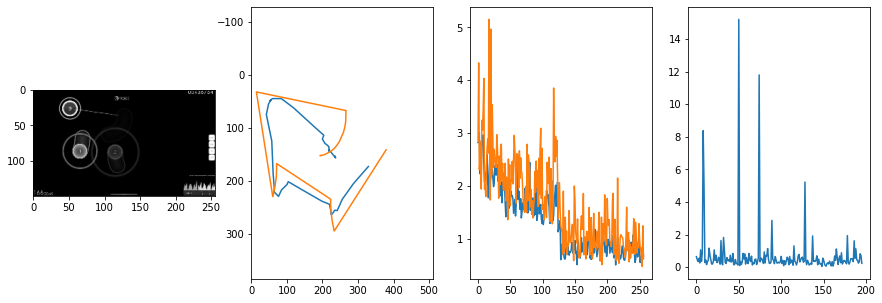


 263 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.3224                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8779843372805994
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.5444                                    
pred: 0.6662306785583496 0.38624289631843567
gt: 0.7031286358833313 0.44791343808174133
(157, 70)


<Figure size 1080x360 with 0 Axes>

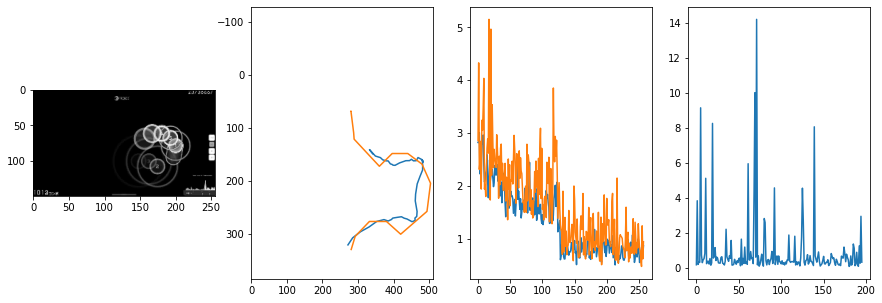


 264 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.3189                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7137025850920045
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.8452                                    
pred: 0.838388204574585 0.31035277247428894
gt: 0.9628830552101135 0.6640489101409912
(197, 95)


<Figure size 1080x360 with 0 Axes>

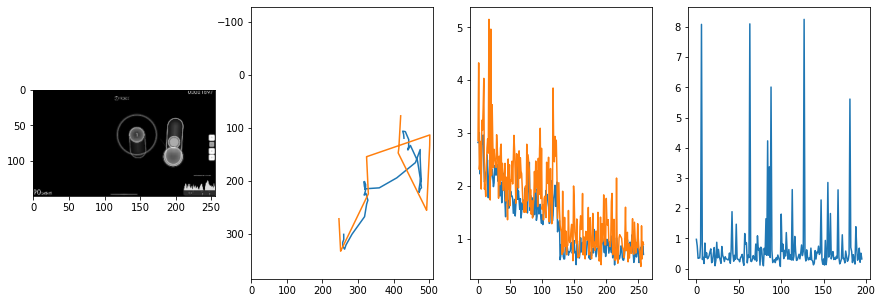


 265 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.1701                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7552105289864905
outliers: 44
retrain: 4                 
val: 50/50 loss: 1.2558                                    
pred: 0.2707783281803131 0.327016144990921
gt: 0.26695939898490906 0.3958333432674408
(89, 64)


<Figure size 1080x360 with 0 Axes>

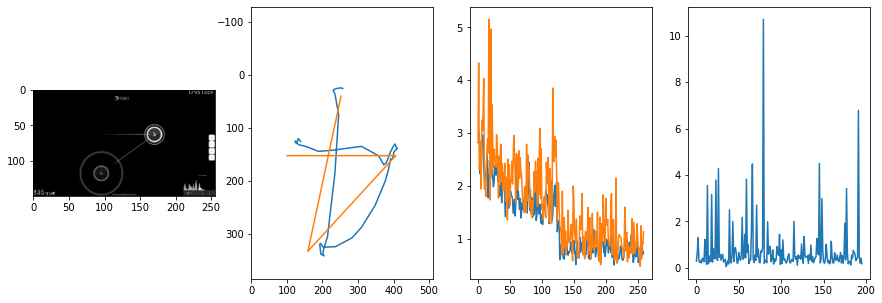


 266 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  3.4370                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.1293159669683295
outliers: 62
retrain: 4                 
val: 50/50 loss: 0.2126                                    
pred: 0.2569592297077179 0.651436448097229
gt: 0.3046875 0.6458333134651184
(95, 93)


<Figure size 1080x360 with 0 Axes>

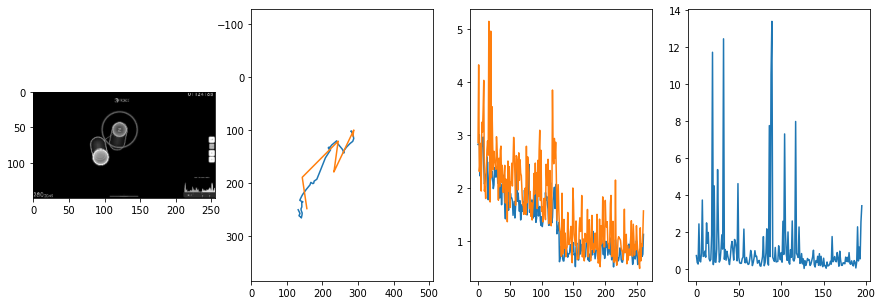


 267 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.3200                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8507208928313791
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.3770                                    
pred: 0.4715052843093872 0.16337814927101135
gt: 0.5362946391105652 0.14004944264888763
(131, 34)


<Figure size 1080x360 with 0 Axes>

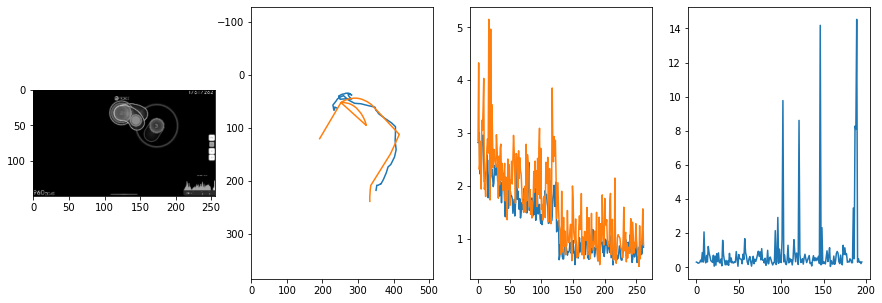


 268 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.2132                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.2505652614850171
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.3920                                    
pred: 0.48142504692077637 0.7015740871429443
gt: 0.328125 0.625
(98, 90)


<Figure size 1080x360 with 0 Axes>

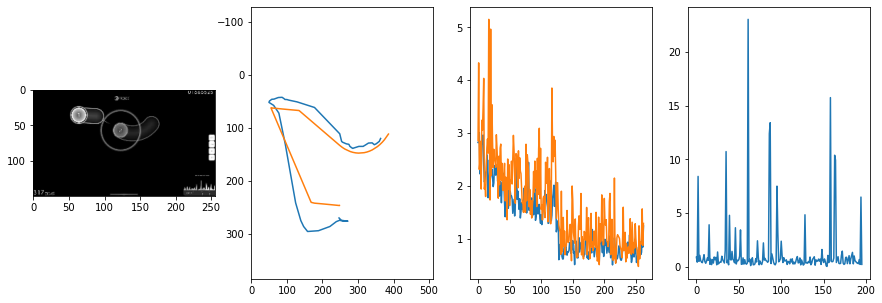


 269 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.3108                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0430289375386677
outliers: 34
retrain: 4                 
val: 50/50 loss: 2.7839                                    
pred: 0.21324986219406128 0.5461726188659668
gt: 0.5791853070259094 0.26958179473876953
(137, 49)


<Figure size 1080x360 with 0 Axes>

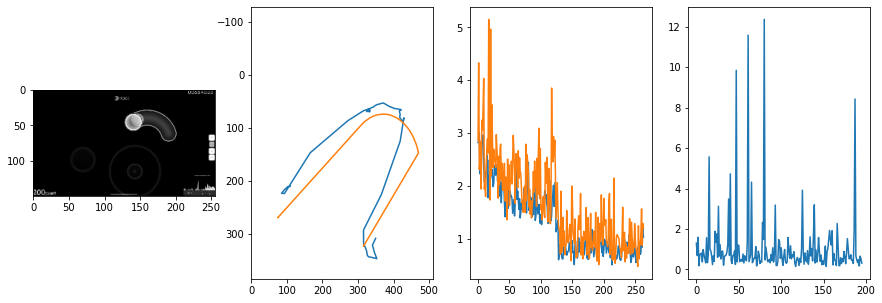


 270 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.3850                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8902698751843098
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.9916                                    
pred: 0.7117310762405396 0.559519350528717
gt: 0.82421875 0.3098958432674408
(175, 54)


<Figure size 1080x360 with 0 Axes>

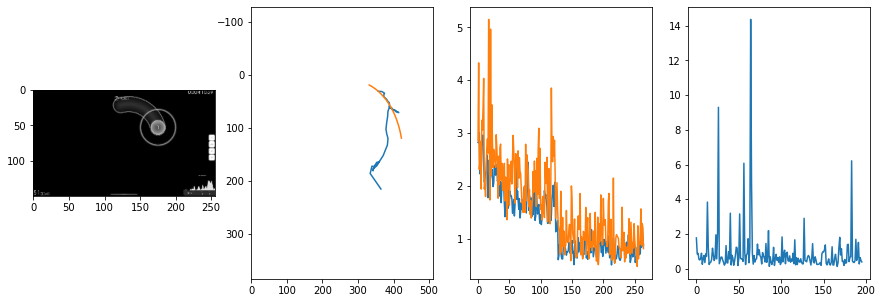


 271 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.32it/s  0.8321                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8413587546698293
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.8599                                    
pred: 0.4585128426551819 0.7430247068405151
gt: 0.5 0.9166666865348816
(125, 124)


<Figure size 1080x360 with 0 Axes>

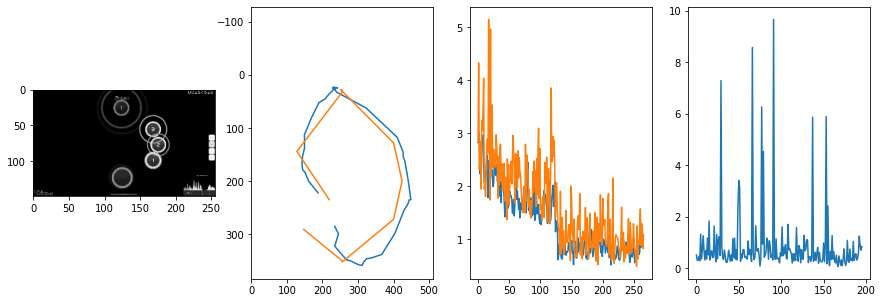


 272 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.7008                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8528581924204316
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.3288                                    
pred: 0.8361217379570007 0.3973389267921448
gt: 0.9362411499023438 0.3681131899356842
(193, 60)


<Figure size 1080x360 with 0 Axes>

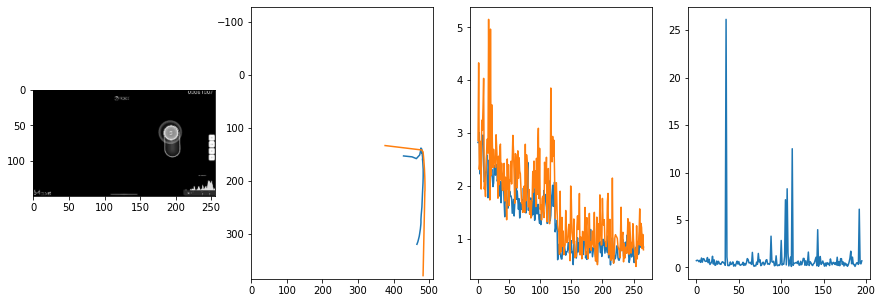


 273 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.2633                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7767878876884982
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.2140                                    
pred: 0.076726533472538 0.5501087307929993
gt: 0.05446898192167282 0.6927794814109802
(56, 98)


<Figure size 1080x360 with 0 Axes>

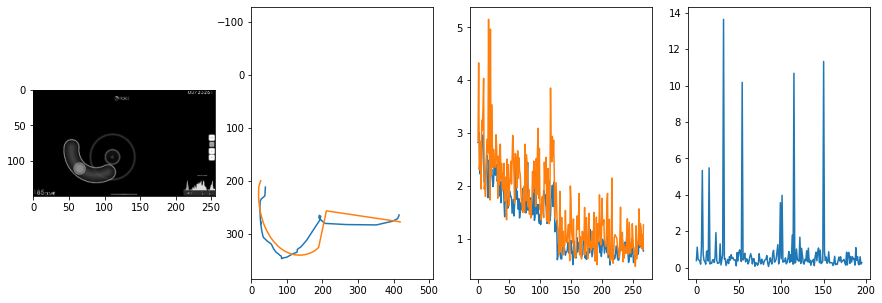


 274 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.5996                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7410706061185622
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.5316                                    
pred: 0.21807034313678741 0.5134912133216858
gt: 0.3743187189102173 0.7020654678344727
(106, 99)


<Figure size 1080x360 with 0 Axes>

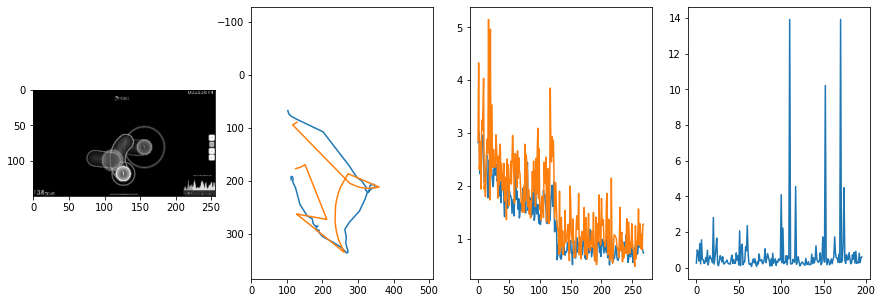


 275 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.2494                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9032195562078636
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.0679                                    
pred: 0.642747163772583 0.28803524374961853
gt: 0.7500030994415283 0.2109387069940567
(164, 42)


<Figure size 1080x360 with 0 Axes>

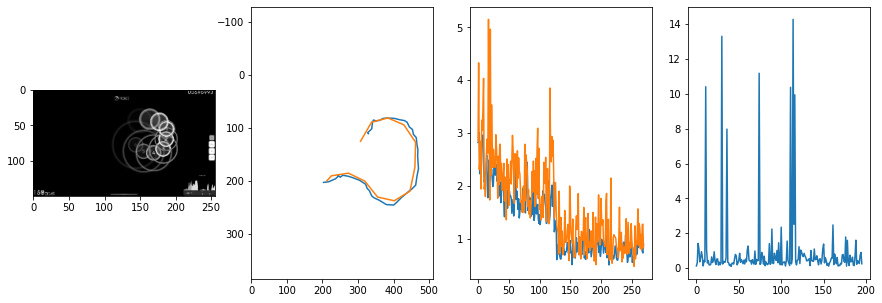


 276 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.4887                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7093247634035592
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.2778                                    
pred: 0.4235224723815918 0.21911345422267914
gt: 0.5471057891845703 0.22639304399490356
(132, 44)


<Figure size 1080x360 with 0 Axes>

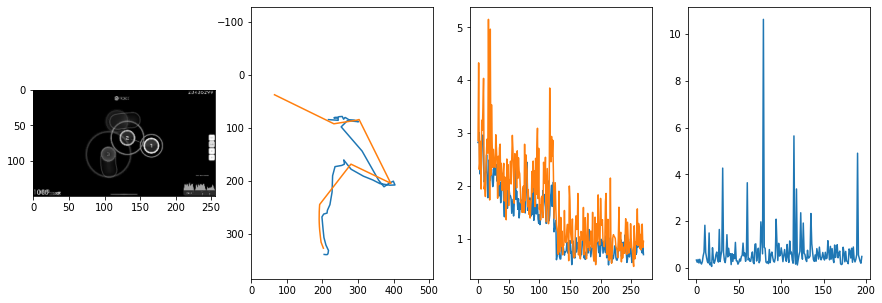


 277 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.5443                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0180638472796704
outliers: 62
retrain: 4                 
val: 50/50 loss: 0.7518                                    
pred: 0.465229332447052 0.7940109372138977
gt: 0.6346268057823181 0.4169061481952667
(146, 66)


<Figure size 1080x360 with 0 Axes>

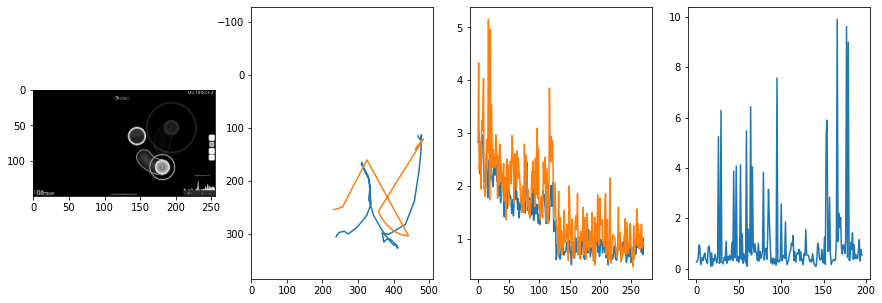


 278 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.8568                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8857603443748489
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.3421                                    
pred: 0.4531751871109009 0.22647292912006378
gt: 0.492186576128006 0.1666659265756607
(124, 37)


<Figure size 1080x360 with 0 Axes>

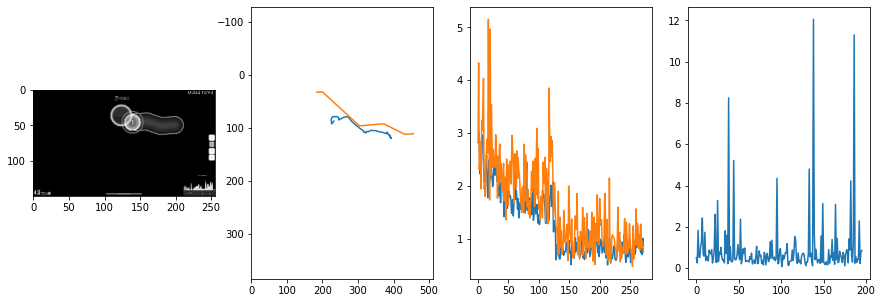


 279 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.3389                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6302492286325717
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.3312                                    
pred: 0.26703184843063354 0.6251094937324524
gt: 0.2749067544937134 0.38149964809417725
(90, 62)


<Figure size 1080x360 with 0 Axes>

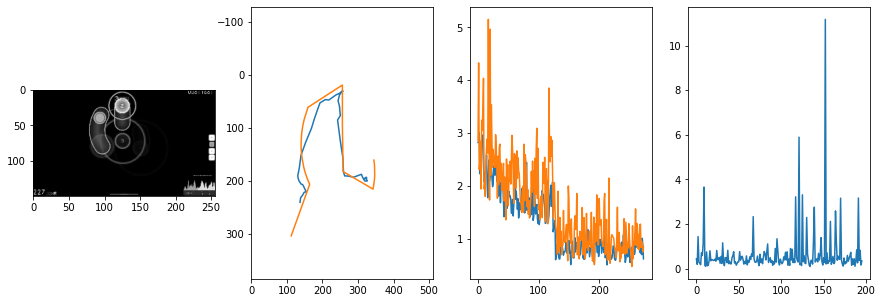


 280 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.2167                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5985927927326791
outliers: 50
retrain: 4                 
val: 50/50 loss: 0.4523                                    
pred: 0.592601478099823 0.7078962922096252
gt: 0.513671875 0.8776041865348816
(127, 120)


<Figure size 1080x360 with 0 Axes>

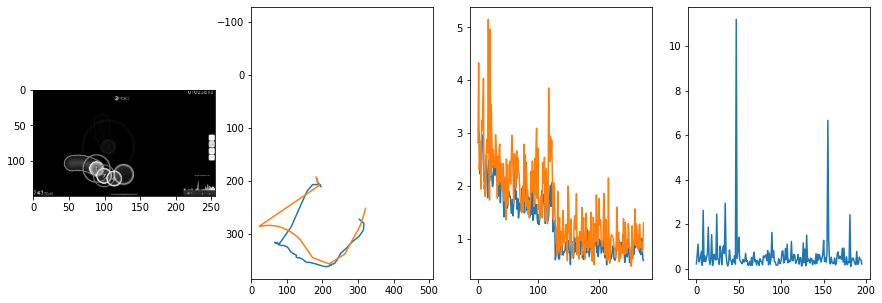


 281 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.6587                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7870567446308476
outliers: 53
retrain: 4                 
val: 50/50 loss: 0.5023                                    
pred: 0.2778570055961609 0.213845893740654
gt: 0.17188669741153717 0.4999769926071167
(74, 76)


<Figure size 1080x360 with 0 Axes>

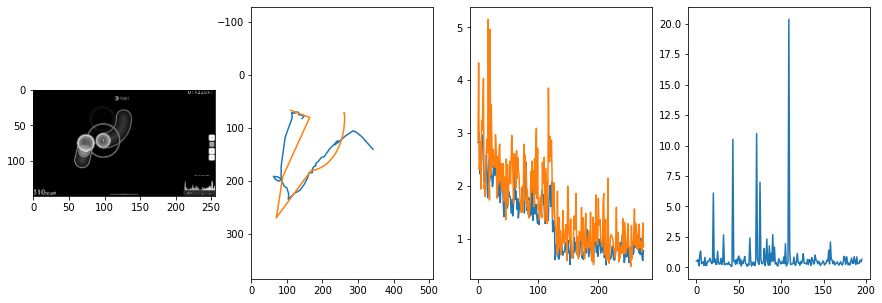


 282 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.1770                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6234721139985688
outliers: 25
retrain: 4                 
val: 50/50 loss: 8.6144                                    
pred: 0.6382126212120056 0.2994951009750366
gt: 0.2519848942756653 0.17609339952468872
(87, 38)


<Figure size 1080x360 with 0 Axes>

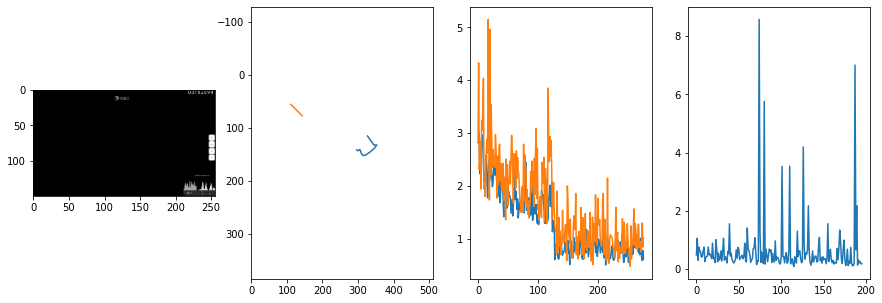


 283 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  0.2395                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.4548155908824458
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.2119                                    
pred: 0.13156962394714355 0.7023483514785767
gt: 0.368073970079422 0.7616863250732422
(105, 106)


<Figure size 1080x360 with 0 Axes>

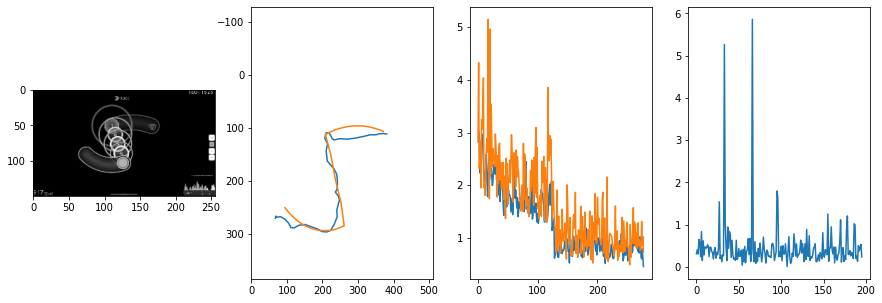


 284 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.4935                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6316740337227073
outliers: 78
retrain: 4                 
val: 50/50 loss: 4.6676                                    
pred: 0.3285095989704132 0.30893540382385254
gt: 0.5625 0.1979166716337204
(135, 41)


<Figure size 1080x360 with 0 Axes>

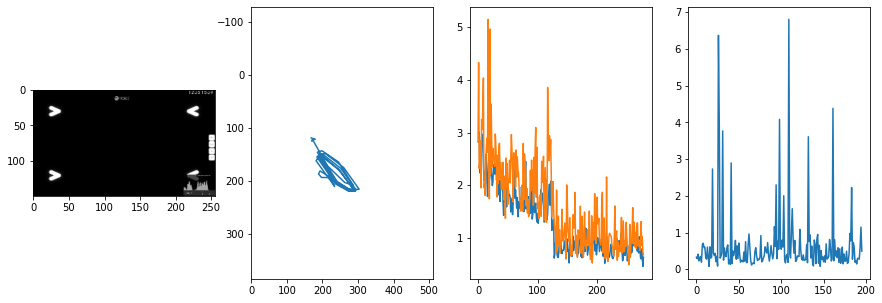


 285 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.6569                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8223637421520389
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.6287                                    
pred: 0.2660682499408722 0.593919575214386
gt: 0.5976471304893494 0.500003457069397
(140, 76)


<Figure size 1080x360 with 0 Axes>

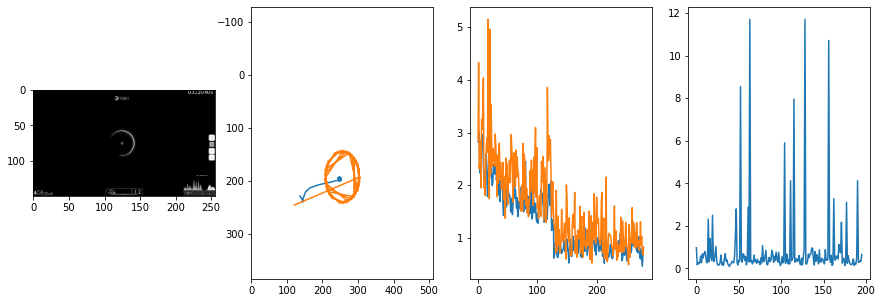


 286 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.3714                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.871881151153725
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.8024                                    
pred: 0.8799343705177307 0.458139568567276
gt: 0.666015625 0.828125
(151, 114)


<Figure size 1080x360 with 0 Axes>

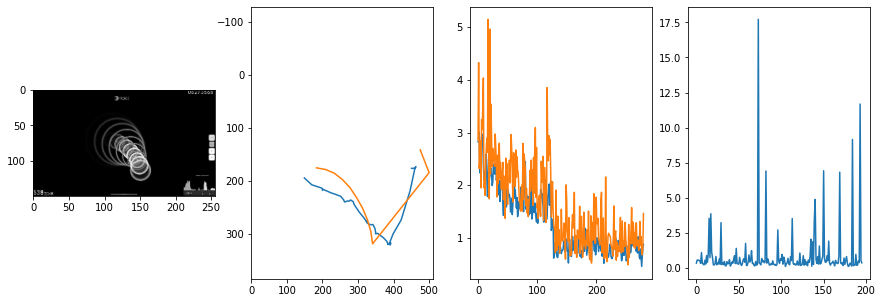


 287 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.2047                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7315171395181393
outliers: 31
retrain: 4                 
val: 50/50 loss: 1.6219                                    
pred: 0.44090381264686584 0.2946990430355072
gt: 0.4949180781841278 0.6875967383384705
(124, 97)


<Figure size 1080x360 with 0 Axes>

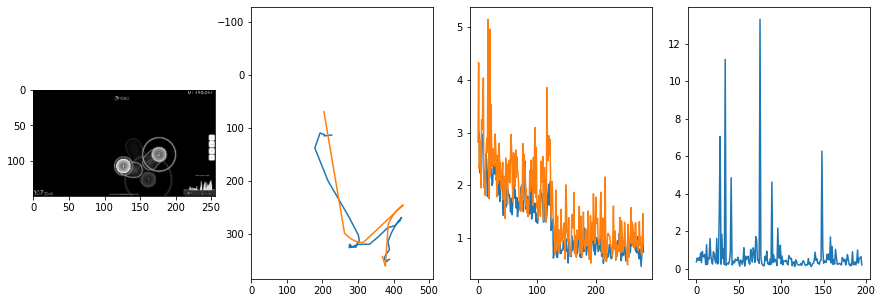


 288 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.1946                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5957535448275051
outliers: 26
retrain: 4                 
val: 50/50 loss: 1.1032                                    
pred: 0.5939597487449646 0.08373019844293594
gt: 0.341796875 0.34375
(101, 57)


<Figure size 1080x360 with 0 Axes>

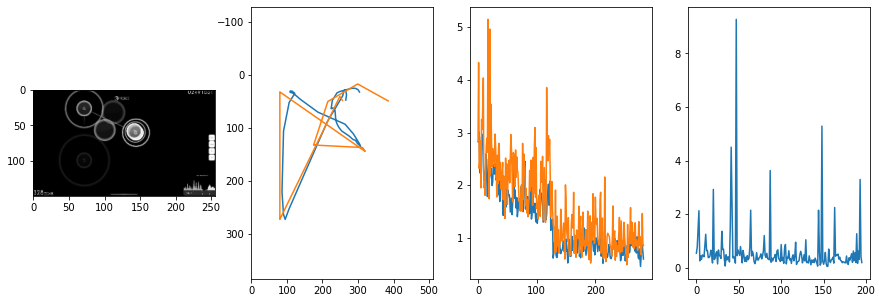


 289 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.4629                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5289673664588102
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.3370                                    
pred: 0.9201765060424805 0.6448533535003662
gt: 0.92578125 0.6666666865348816
(191, 95)


<Figure size 1080x360 with 0 Axes>

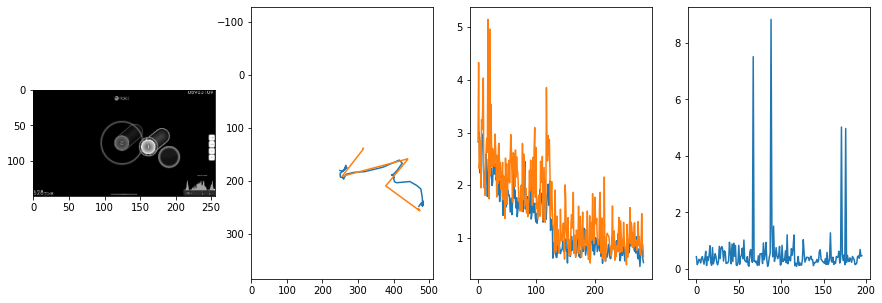


 290 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  1.0920                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7985014959561582
outliers: 66
retrain: 4                 
val: 50/50 loss: 1.5423                                    
pred: 0.1584882289171219 0.11157186329364777
gt: 0.4062463939189911 0.2708371579647064
(110, 49)


<Figure size 1080x360 with 0 Axes>

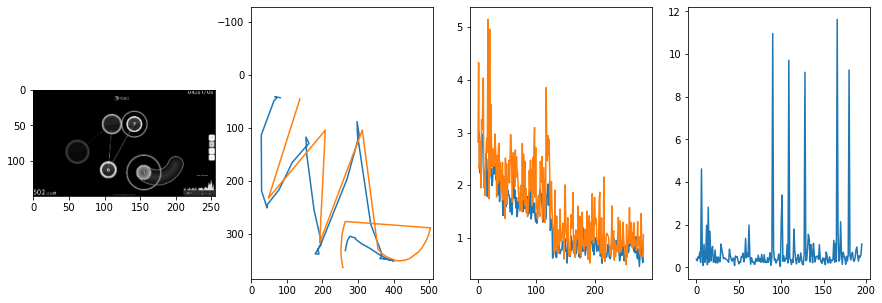


 291 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.2424                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7371849155775747
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.5896                                    
pred: 0.4869609773159027 0.8739089369773865
gt: 0.419921875 0.8255208134651184
(113, 114)


<Figure size 1080x360 with 0 Axes>

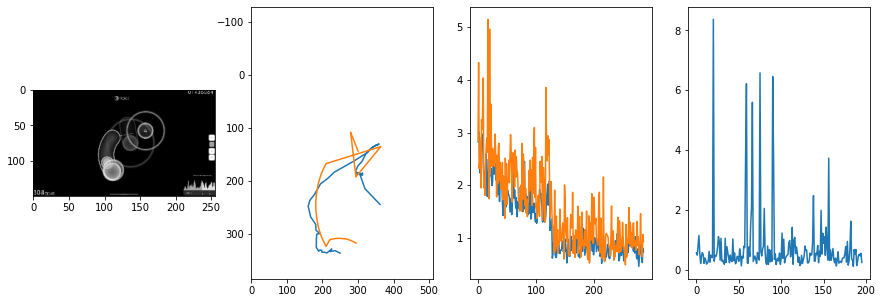


 292 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.1645                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8010621427805448
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.6064                                    
pred: 0.27118775248527527 0.23050008714199066
gt: 0.5989875197410583 0.10979975014925003
(140, 30)


<Figure size 1080x360 with 0 Axes>

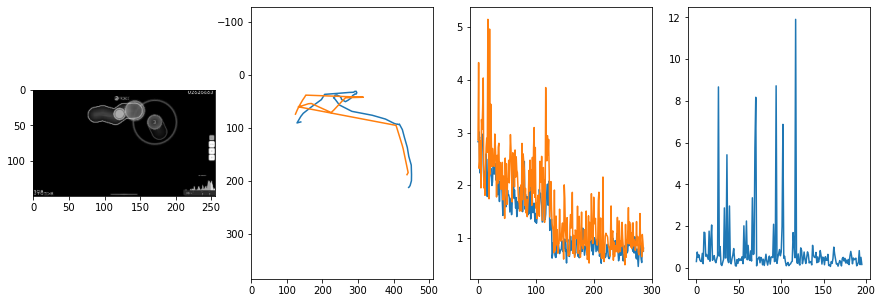


 293 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.5396                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9211853673985723
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.4689                                    
pred: 0.515654981136322 0.35439687967300415
gt: 0.4902344048023224 0.07031254470348358
(124, 26)


<Figure size 1080x360 with 0 Axes>

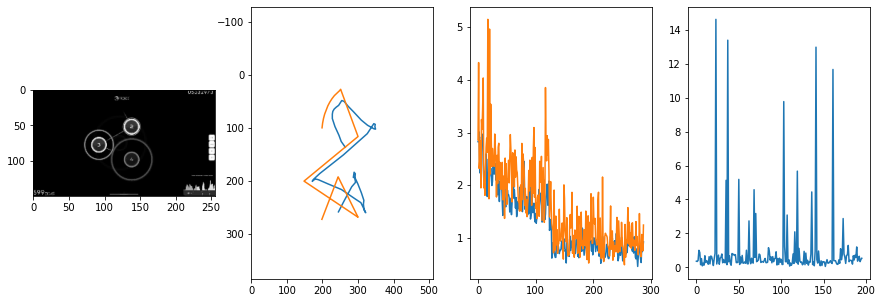


 294 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.2502                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9036262288917692
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.7137                                    
pred: 0.5180486440658569 0.5206528902053833
gt: 0.4047907590866089 0.5289657711982727
(110, 79)


<Figure size 1080x360 with 0 Axes>

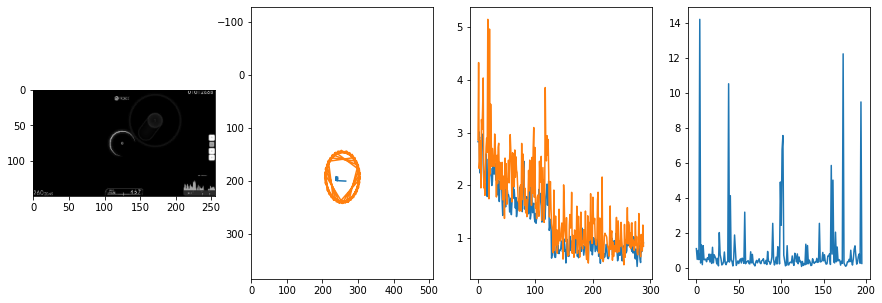


 295 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.30it/s  0.2767                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6539281428392444
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.7248                                    
pred: 0.48976683616638184 0.47345277667045593
gt: 0.5041979551315308 0.3699120283126831
(126, 61)


<Figure size 1080x360 with 0 Axes>

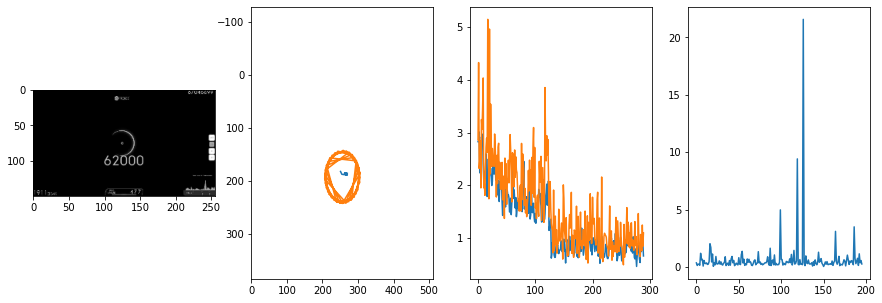


 296 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.0915                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.622582571058325
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.6039                                    
pred: 0.5667124390602112 0.6368773579597473
gt: 0.44654881954193115 0.7468914985656738
(117, 104)


<Figure size 1080x360 with 0 Axes>

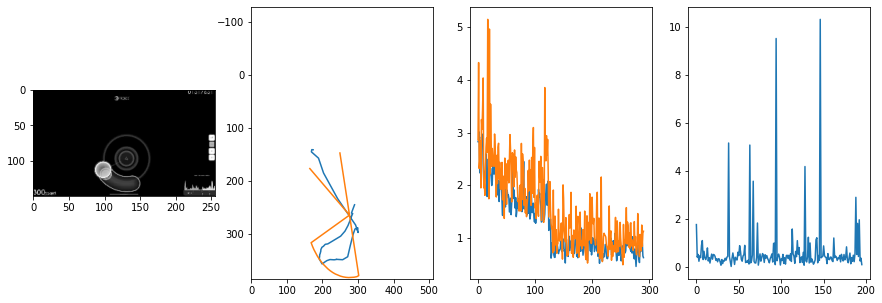


 297 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.3939                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6883422060660562
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.4376                                    
pred: 0.19912004470825195 0.18772493302822113
gt: 0.5037917494773865 0.3671049177646637
(126, 60)


<Figure size 1080x360 with 0 Axes>

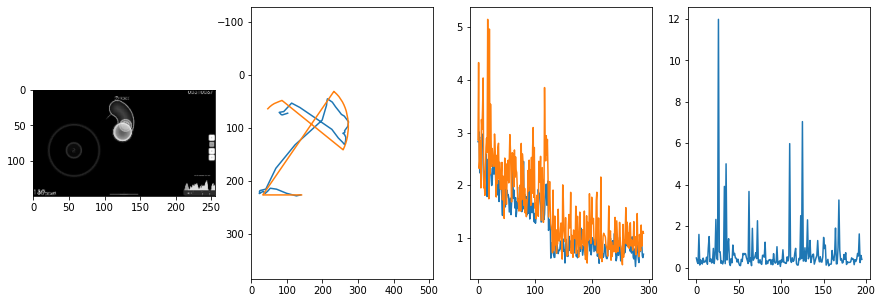


 298 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.9055                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6439927089579252
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.6362                                    
pred: 0.4728130102157593 0.5759493112564087
gt: 0.548022985458374 0.5446231961250305
(132, 81)


<Figure size 1080x360 with 0 Axes>

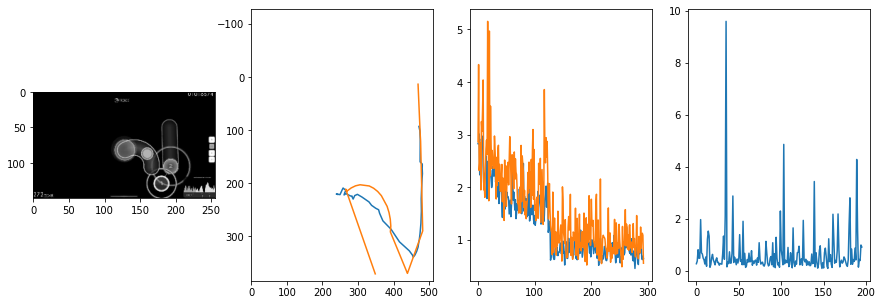


 299 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.5626                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8881620942443913
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.8488                                    
pred: 0.6532395482063293 0.07643095403909683
gt: 0.4656406342983246 0.07541631907224655
(120, 26)


<Figure size 1080x360 with 0 Axes>

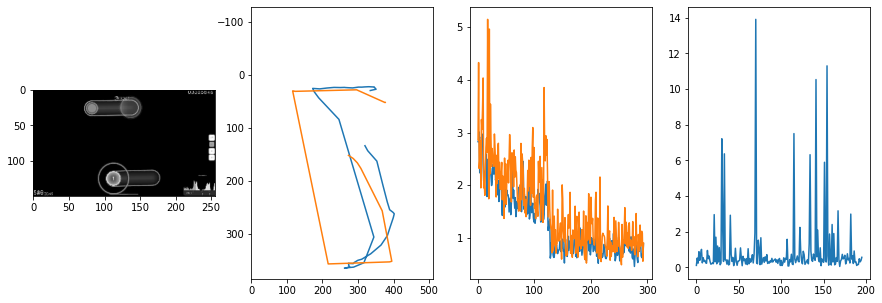


 300 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.3940                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6996947038842707
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.4566                                    
pred: 0.6172178387641907 0.394402414560318
gt: 0.8671875 0.5703125
(182, 84)


<Figure size 1080x360 with 0 Axes>

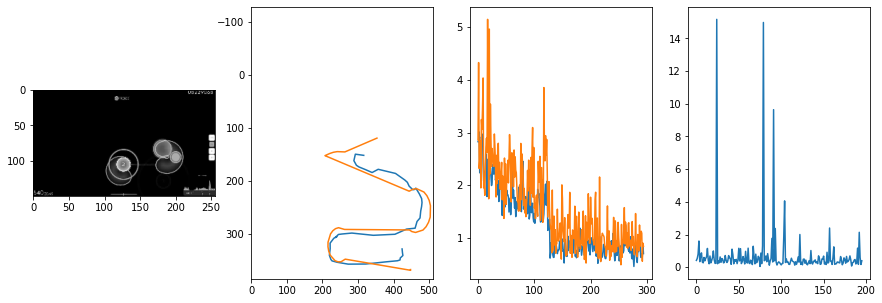


 301 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  0.3622                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.788905491501245
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.5223                                    
pred: 0.8101150989532471 0.741944432258606
gt: 0.8593781590461731 0.6041804552078247
(181, 88)


<Figure size 1080x360 with 0 Axes>

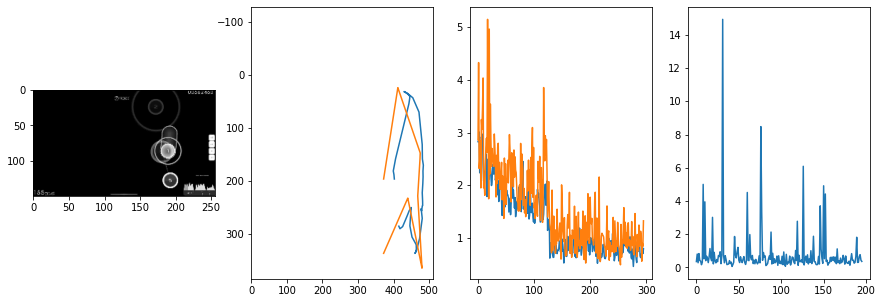


 302 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.2581                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6216859655948926
outliers: 25
retrain: 4                 
val: 50/50 loss: 1.3132                                    
pred: 0.40985697507858276 0.3486349284648895
gt: 0.4454888105392456 0.3131045401096344
(117, 54)


<Figure size 1080x360 with 0 Axes>

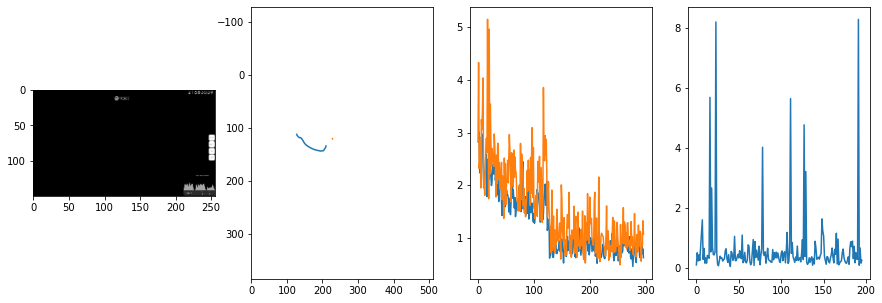


 303 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.34it/s  1.0958                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7994953694240171
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.6463                                    
pred: 0.6934511065483093 0.3424820899963379
gt: 0.2890625596046448 0.2500000298023224
(92, 47)


<Figure size 1080x360 with 0 Axes>

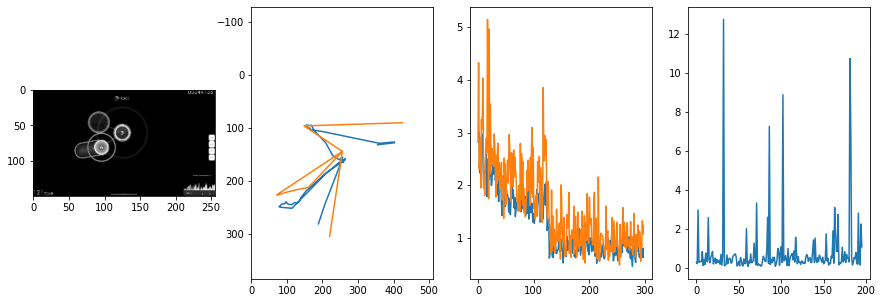


 304 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.3174                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5390657111812307
outliers: 15
retrain: 4                 
val: 50/50 loss: 0.8425                                    
pred: 0.43163198232650757 0.48677125573158264
gt: 0.31056123971939087 0.6640629768371582
(96, 95)


<Figure size 1080x360 with 0 Axes>

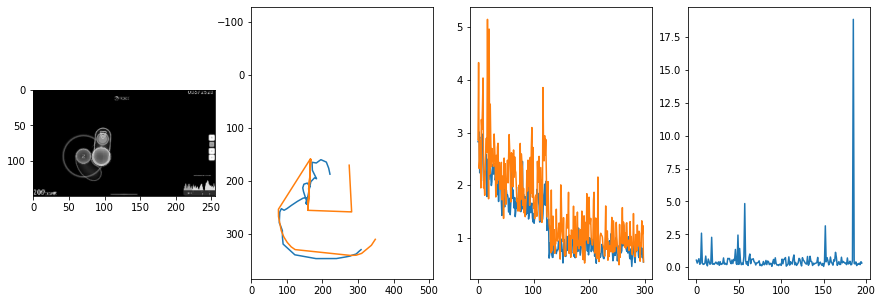


 305 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.4993                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8941738116269817
outliers: 62
retrain: 4                 
val: 50/50 loss: 0.9352                                    
pred: 0.068047434091568 0.5270159840583801
gt: 0.029296875 0.3932291567325592
(52, 63)


<Figure size 1080x360 with 0 Axes>

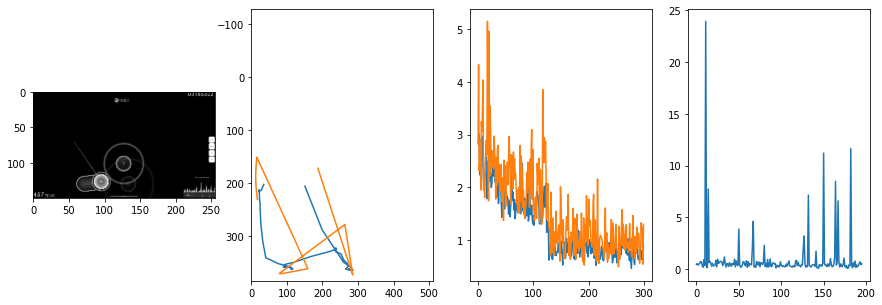


 306 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.26it/s  0.5580                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.711587381302094
outliers: 28
retrain: 4                 
val: 50/50 loss: 1.3154                                    
pred: 0.6677440404891968 0.16638800501823425
gt: 0.8095725178718567 0.15783922374248505
(173, 36)


<Figure size 1080x360 with 0 Axes>

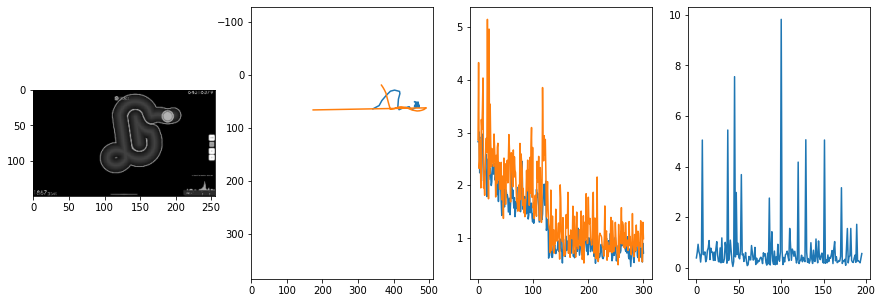


 307 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.5212                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6404119913979452
outliers: 34
retrain: 4                 
val: 50/50 loss: 1.4269                                    
pred: 0.5635714530944824 0.5561263561248779
gt: 0.39589130878448486 0.5739437341690063
(109, 84)


<Figure size 1080x360 with 0 Axes>

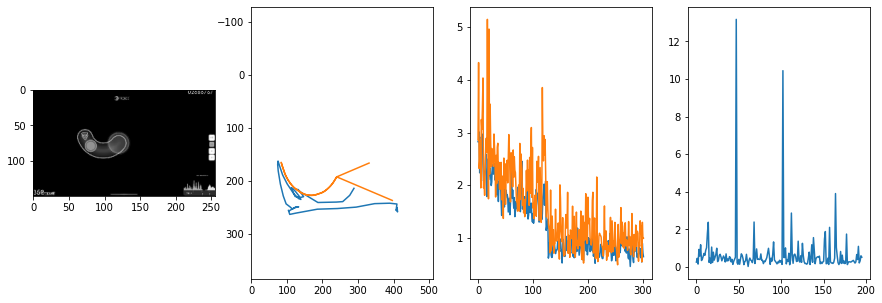


 308 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.4850                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8854785869848363
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.4317                                    
pred: 0.6747146248817444 0.362643301486969
gt: 0.65625 0.28125
(149, 50)


<Figure size 1080x360 with 0 Axes>

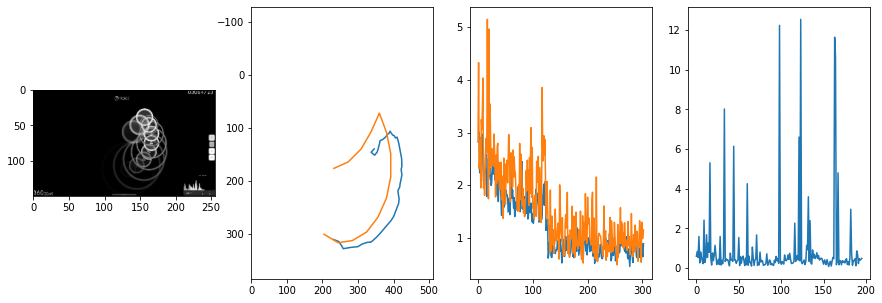


 309 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.1501                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7677848444377281
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.3126                                    
pred: 0.1863018274307251 0.26876088976860046
gt: 0.12439697235822678 0.27520331740379333
(67, 50)


<Figure size 1080x360 with 0 Axes>

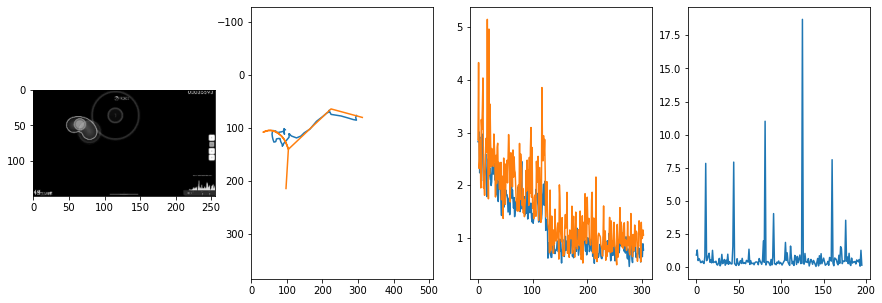


 310 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.3178                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6523341246861585
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.6647                                    
pred: 0.711625337600708 0.5126087665557861
gt: 0.7089827060699463 0.5781258344650269
(157, 85)


<Figure size 1080x360 with 0 Axes>

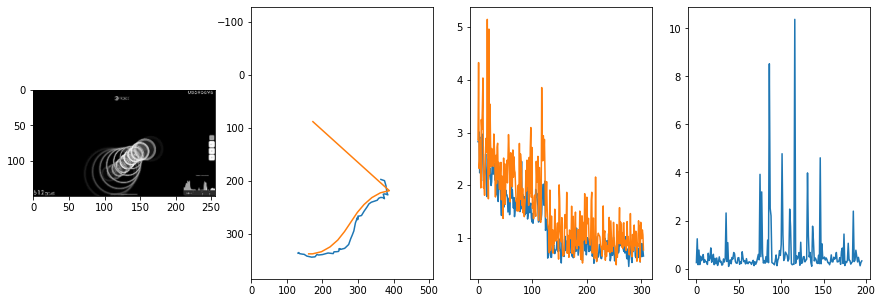


 311 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.3520                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.841453086014609
outliers: 42
retrain: 4                 
val: 50/50 loss: 12.5170                                   
pred: 0.6043751239776611 0.4016762971878052
gt: 0.2745494246482849 0.02536187879741192
(90, 20)


<Figure size 1080x360 with 0 Axes>

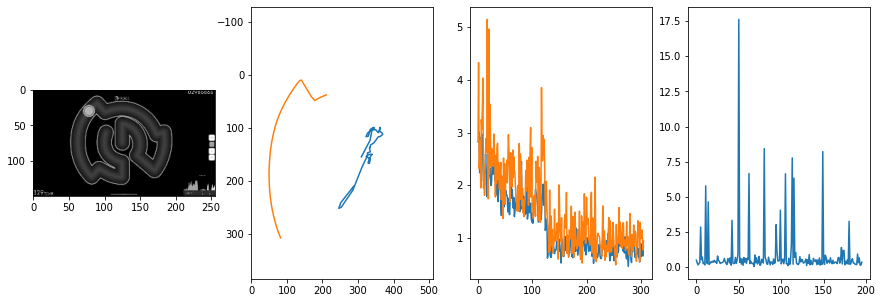


 312 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.1900                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7315926265959837
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.3488                                    
pred: 0.7826146483421326 0.33752870559692383
gt: 0.7272181510925293 0.22203387320041656
(160, 43)


<Figure size 1080x360 with 0 Axes>

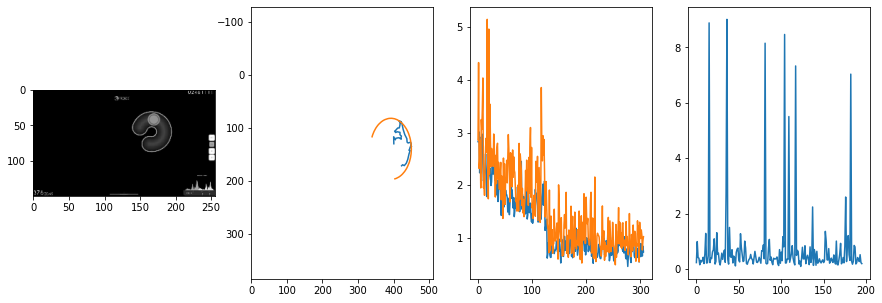


 313 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.1588                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9456724107683617
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.4981                                    
pred: 0.5085247755050659 0.536695659160614
gt: 0.4606212079524994 0.6191529631614685
(119, 90)


<Figure size 1080x360 with 0 Axes>

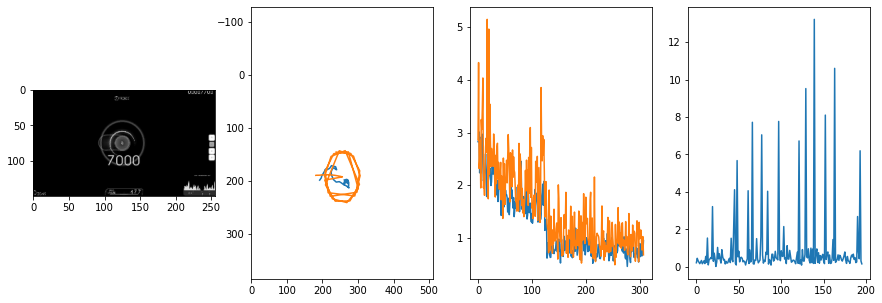


 314 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.50it/s  0.4882                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6043016683994508
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.2717                                    
pred: 0.4229849874973297 0.5395689010620117
gt: 0.3945291042327881 0.3619764745235443
(109, 60)


<Figure size 1080x360 with 0 Axes>

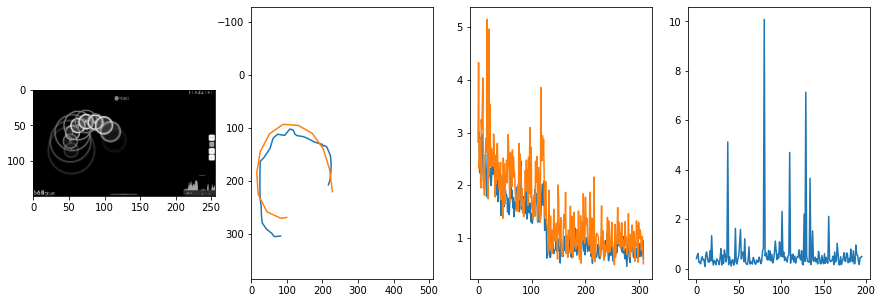


 315 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  1.1505                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7535767822469376
outliers: 56
retrain: 4                 
val: 50/50 loss: 1.9804                                    
pred: 0.7382948398590088 0.7465358972549438
gt: 0.7782976031303406 0.7483136057853699
(168, 105)


<Figure size 1080x360 with 0 Axes>

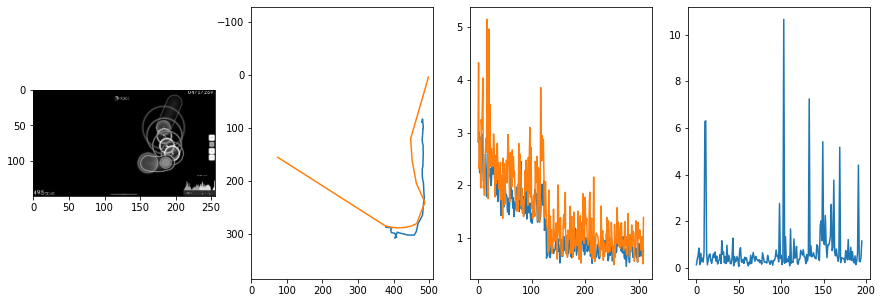


 316 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.4088                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0457063681465022
outliers: 79
retrain: 4                 
val: 50/50 loss: 0.2065                                    
pred: 0.7342597842216492 0.49599239230155945
gt: 0.6718857884407043 0.7916538715362549
(152, 110)


<Figure size 1080x360 with 0 Axes>

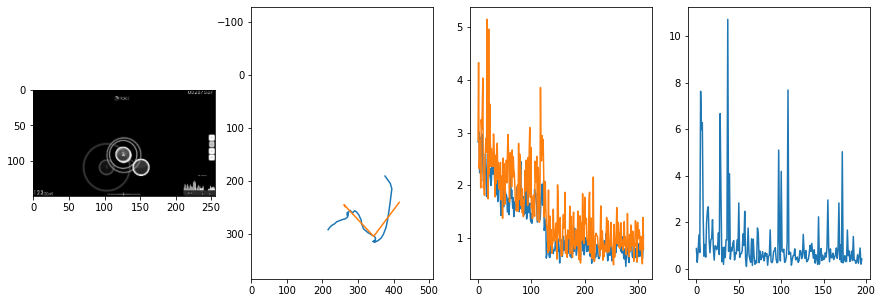


 317 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.4902                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0335066730194553
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.9050                                    
pred: 0.4683368504047394 0.14096571505069733
gt: 0.3711208403110504 0.17439325153827667
(105, 38)


<Figure size 1080x360 with 0 Axes>

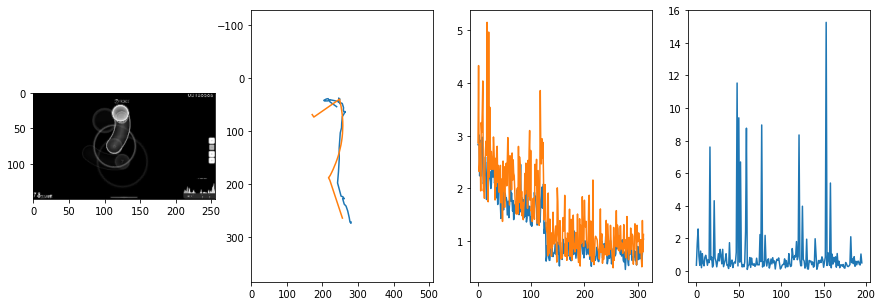


 318 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.7711                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9309133847757262
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.5213                                    
pred: 0.3853457272052765 0.643825888633728
gt: 0.2909621000289917 0.4176945388317108
(93, 66)


<Figure size 1080x360 with 0 Axes>

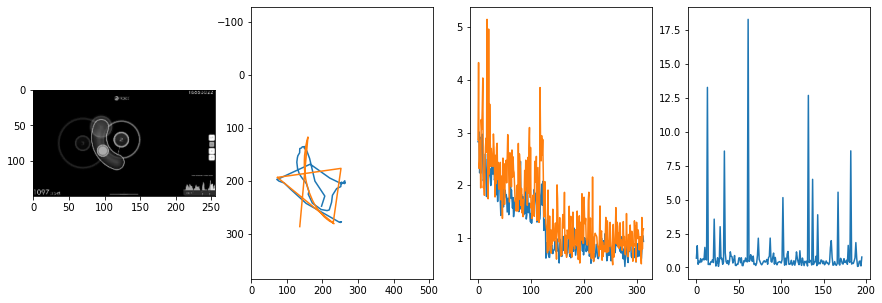


 319 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  15.6972                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.878513540844528
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.3144                                    
pred: 0.3361568748950958 0.8496066927909851
gt: 0.345703125 0.84375
(101, 116)


<Figure size 1080x360 with 0 Axes>

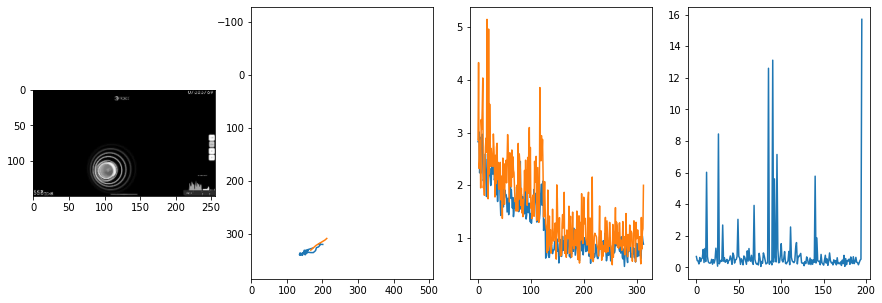


 320 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.3058                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9331264851652846
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.7938                                    
pred: 0.313067764043808 0.4596923291683197
gt: 0.3423091769218445 0.2159774899482727
(101, 43)


<Figure size 1080x360 with 0 Axes>

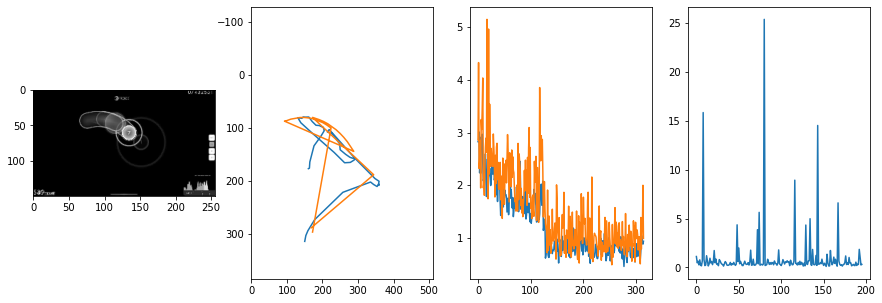


 321 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  0.2995                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5975173528553271
outliers: 16
retrain: 4                 
val: 50/50 loss: 0.6617                                    
pred: 0.35784220695495605 0.5712913274765015
gt: 0.48689019680023193 0.7831607460975647
(123, 109)


<Figure size 1080x360 with 0 Axes>

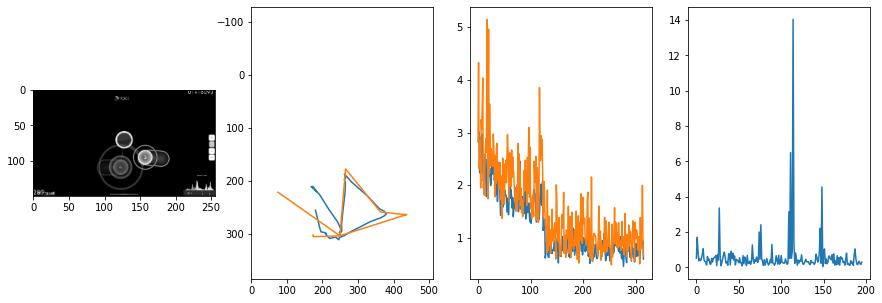


 322 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2452                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7470726525525049
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.2424                                    
pred: 0.82101970911026 0.4342244267463684
gt: 0.7811775207519531 0.23576976358890533
(169, 45)


<Figure size 1080x360 with 0 Axes>

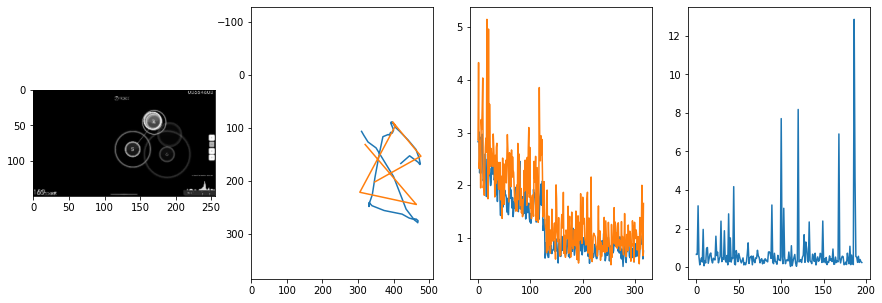


 323 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.2572                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6696798176865797
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.1828                                    
pred: 0.8137364983558655 0.7352045178413391
gt: 0.6953125 0.7291666865348816
(155, 102)


<Figure size 1080x360 with 0 Axes>

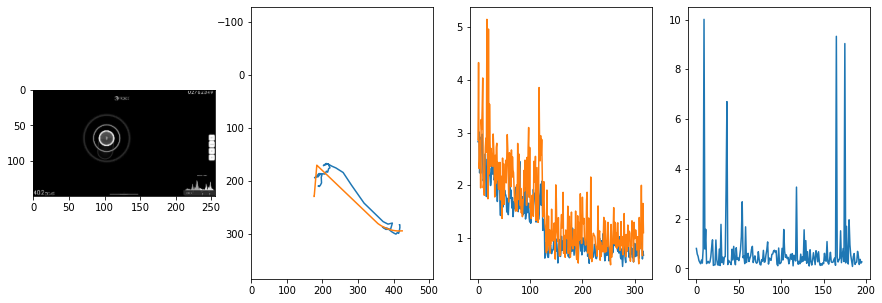


 324 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.29it/s  0.3786                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8007566583323844
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.4140                                    
pred: 0.1660221964120865 0.5829169154167175
gt: 0.2578072249889374 0.5546871423721313
(87, 82)


<Figure size 1080x360 with 0 Axes>

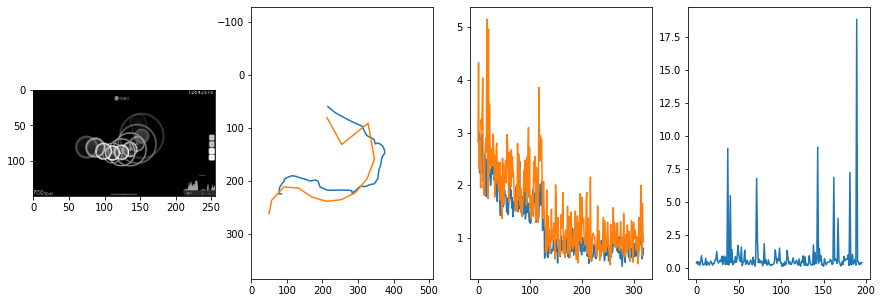


 325 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.43it/s  0.4482                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6755959493469219
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.6849                                    
pred: 0.42136910557746887 0.16764844954013824
gt: 0.48399999737739563 0.12449999898672104
(123, 32)


<Figure size 1080x360 with 0 Axes>

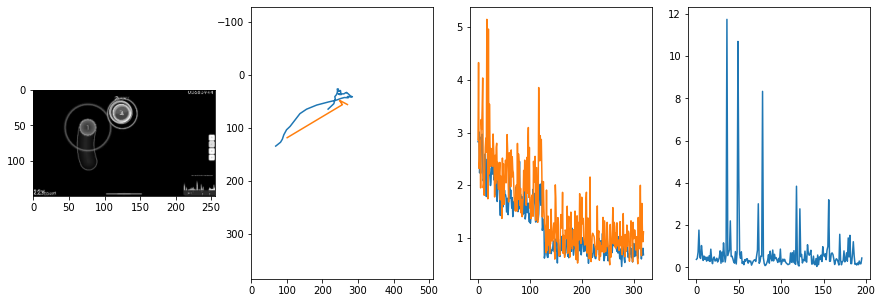


 326 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  1.0669                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7858831606691286
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.7486                                    
pred: 0.8790873885154724 0.10906156152486801
gt: 0.7614352107048035 0.14114876091480255
(166, 34)


<Figure size 1080x360 with 0 Axes>

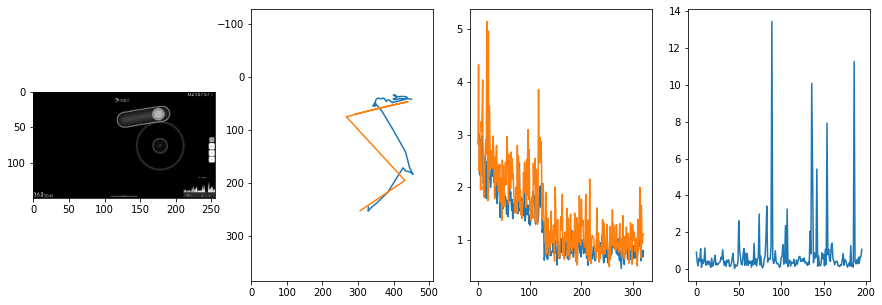


 327 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.3984                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.070059029689553
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.3001                                    
pred: 0.5291159152984619 0.08855047821998596
gt: 0.6562520265579224 0.14583611488342285
(149, 34)


<Figure size 1080x360 with 0 Axes>

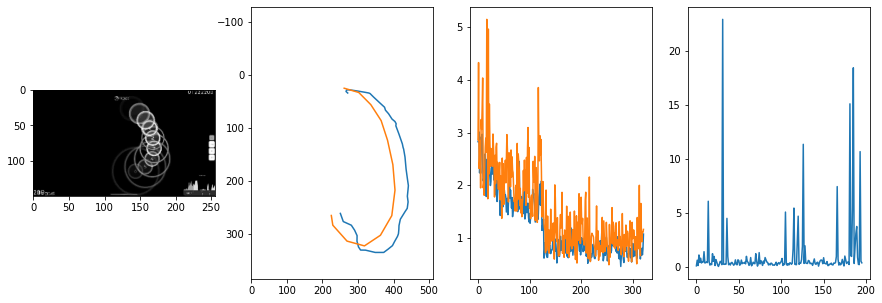


 328 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.2455                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7771854403295687
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.9609                                    
pred: 0.2755716145038605 0.4010939598083496
gt: 0.2519746720790863 0.7180214524269104
(87, 101)


<Figure size 1080x360 with 0 Axes>

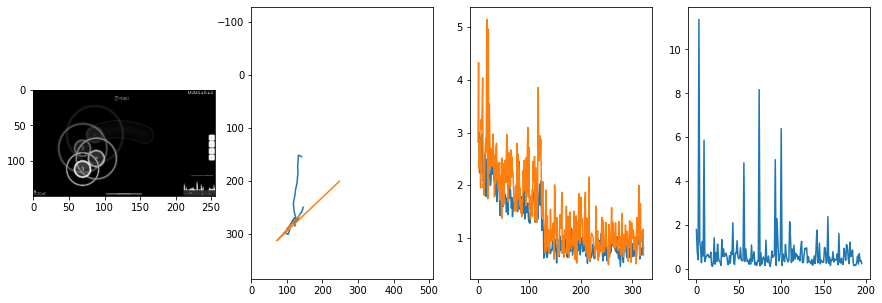


 329 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2899                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9133112102518884
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.2301                                    
pred: 0.6639443635940552 0.1365315318107605
gt: 0.7578054666519165 0.25001761317253113
(165, 47)


<Figure size 1080x360 with 0 Axes>

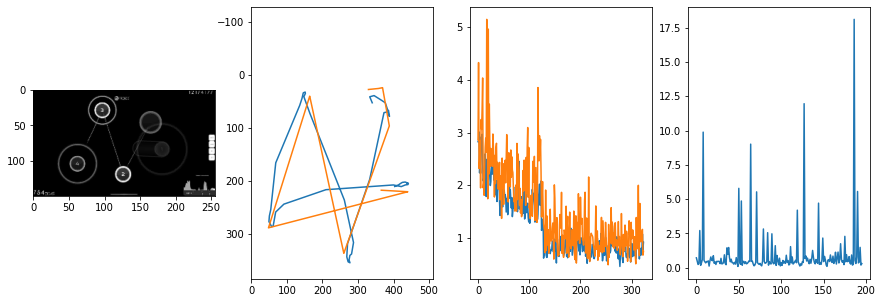


 330 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  0.1756                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8435096256434917
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.9999                                    
pred: 0.8889843821525574 0.38047584891319275
gt: 0.49777746200561523 0.5753656029701233
(125, 84)


<Figure size 1080x360 with 0 Axes>

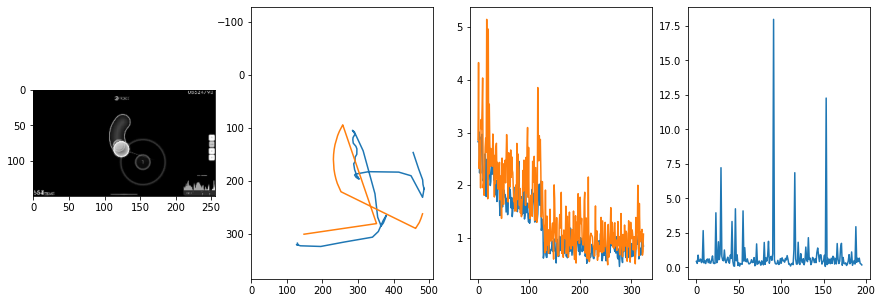


 331 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.3622                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0647277951392593
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.1409                                    
pred: 0.48309820890426636 0.42704546451568604
gt: 0.5 0.5
(125, 76)


<Figure size 1080x360 with 0 Axes>

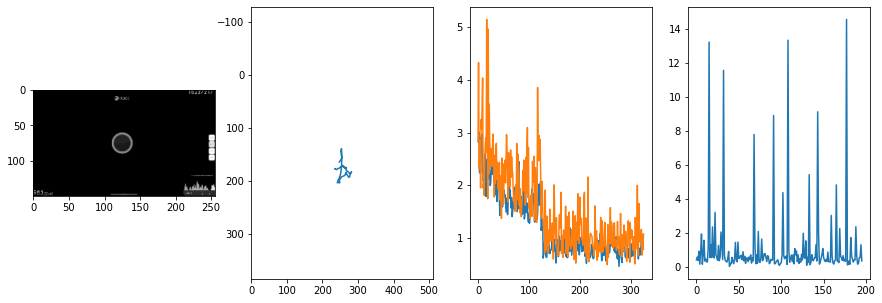


 332 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  1.2751                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.743421412928372
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.5016                                    
pred: 0.2579854428768158 0.22930008172988892
gt: 0.2509295642375946 0.2291666716337204
(86, 44)


<Figure size 1080x360 with 0 Axes>

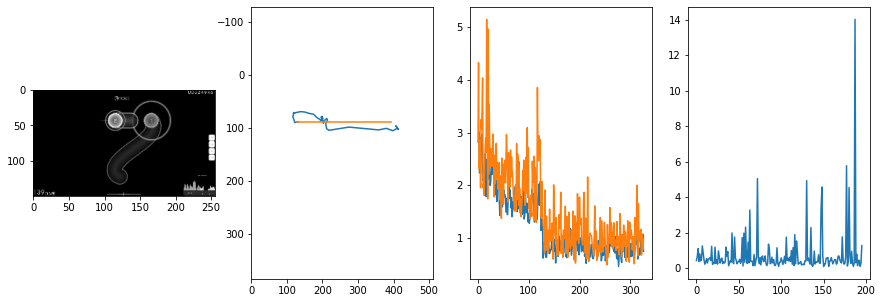


 333 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.5926                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9372329269820938
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.2759                                    
pred: 0.5560500025749207 0.32527270913124084
gt: 0.21875008940696716 0.666666567325592
(81, 95)


<Figure size 1080x360 with 0 Axes>

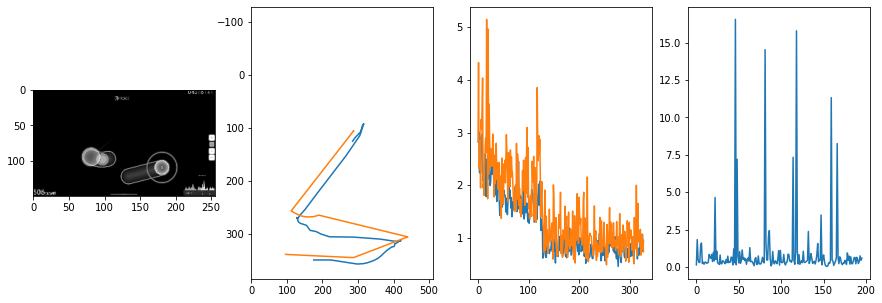


 334 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.3192                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8211891654954881
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.3745                                    
pred: 0.7054515480995178 0.47446754574775696
gt: 0.7109375 0.2161458283662796
(158, 43)


<Figure size 1080x360 with 0 Axes>

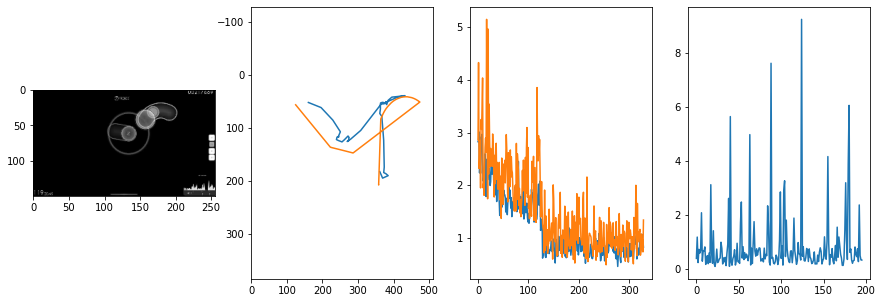


 335 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.7332                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7626518327742815
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.4040                                    
pred: 0.12241342663764954 0.5094221234321594
gt: 0.07226651161909103 0.5078153014183044
(59, 77)


<Figure size 1080x360 with 0 Axes>

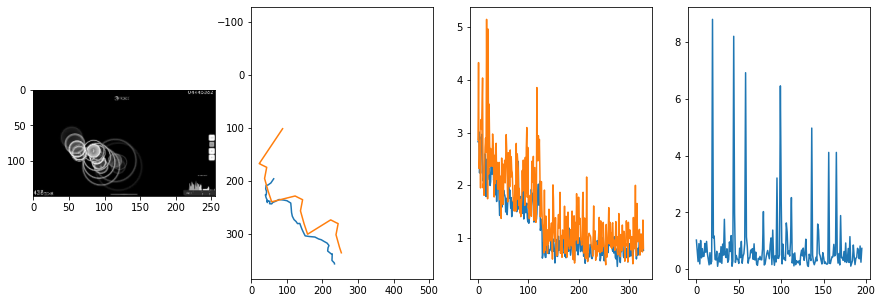


 336 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.29it/s  0.3456                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.755720691755414
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.5678                                    
pred: 0.8274412155151367 0.8169782757759094
gt: 0.6719064116477966 0.5573028922080994
(152, 82)


<Figure size 1080x360 with 0 Axes>

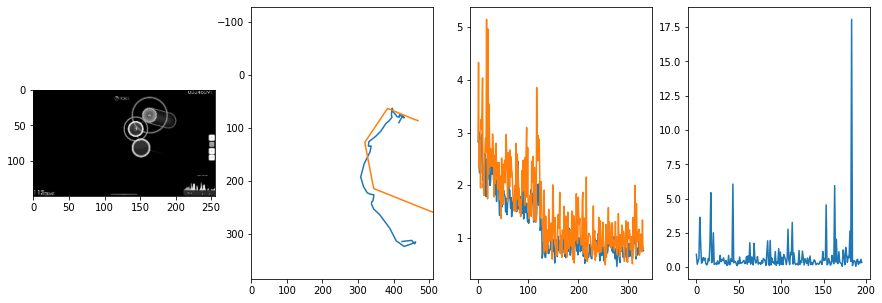


 337 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.49it/s  0.7460                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9195587080428187
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.7209                                    
pred: 0.5932114720344543 0.42378026247024536
gt: 0.509765625 0.3151041567325592
(127, 54)


<Figure size 1080x360 with 0 Axes>

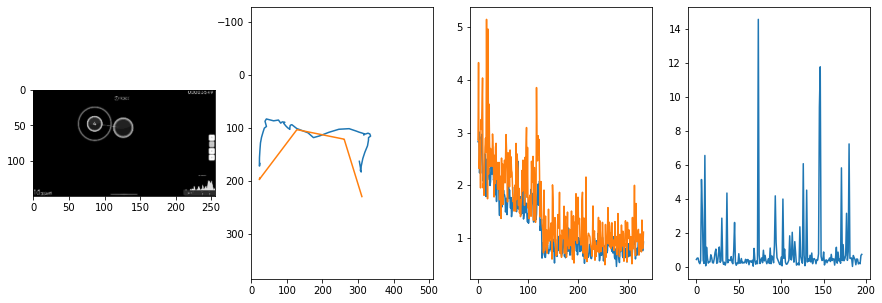


 338 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.2741                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6553877230201449
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.3642                                    
pred: 0.8170703649520874 0.3764573335647583
gt: 0.34628385305404663 0.3326638638973236
(101, 56)


<Figure size 1080x360 with 0 Axes>

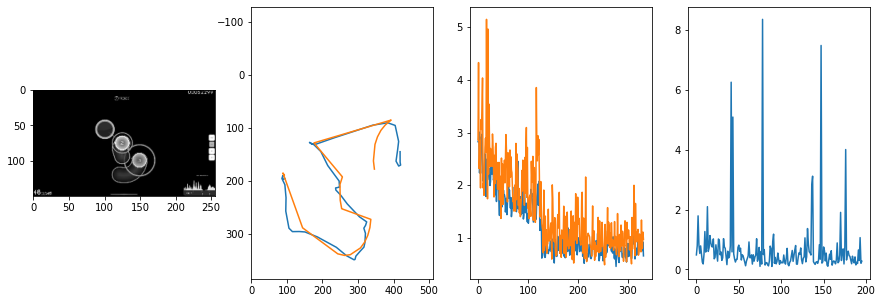


 339 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.26it/s  0.2130                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6382197051556134
outliers: 45
retrain: 4                 
val: 50/50 loss: 5.7936                                    
pred: 0.524356484413147 0.5491021275520325
gt: 0.3139142096042633 0.28090402483940125
(96, 50)


<Figure size 1080x360 with 0 Axes>

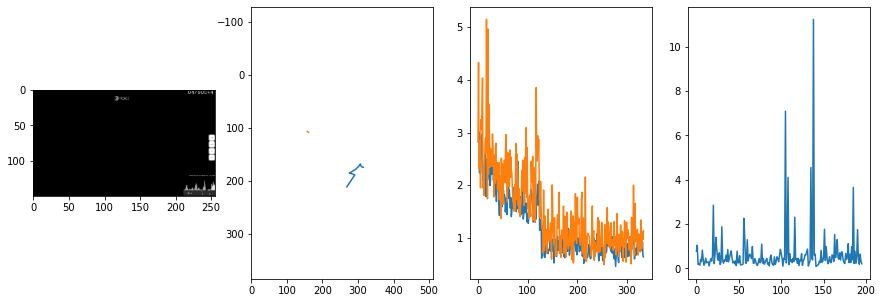


 340 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.4962                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7116329011564352
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.1678                                    
pred: 0.3932114541530609 0.8399978280067444
gt: 0.35546875 0.6770832538604736
(103, 96)


<Figure size 1080x360 with 0 Axes>

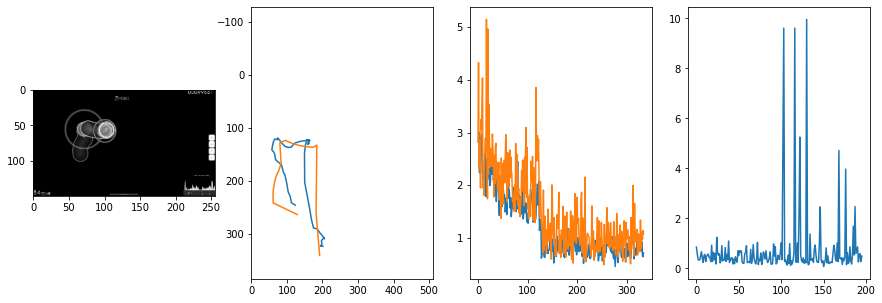


 341 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.2001                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6959117657828088
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.1276                                    
pred: 0.6780821681022644 0.7712335586547852
gt: 0.62109375 0.5625
(144, 83)


<Figure size 1080x360 with 0 Axes>

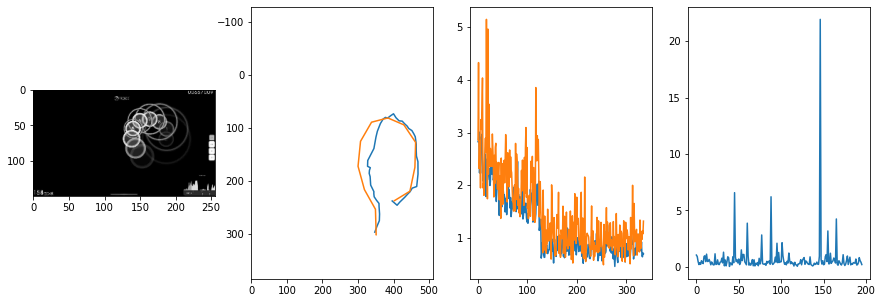


 342 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.3101                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6475500245103423
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.3524                                    
pred: 0.9061173796653748 0.18129409849643707
gt: 0.9687499403953552 0.47656217217445374
(198, 73)


<Figure size 1080x360 with 0 Axes>

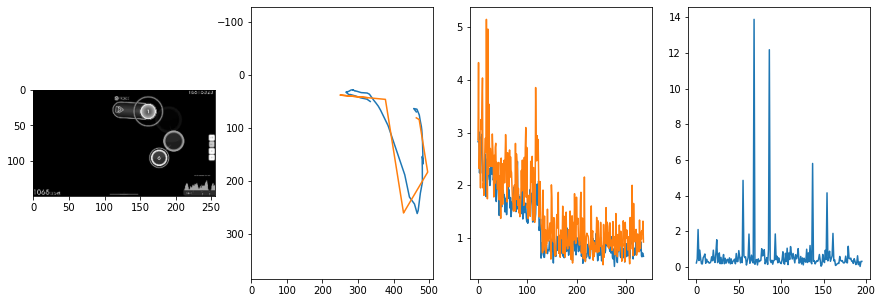


 343 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.2549                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7114133307976382
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.3558                                    
pred: 0.27703964710235596 0.5381420254707336
gt: 0.5674501061439514 0.0526513010263443
(135, 24)


<Figure size 1080x360 with 0 Axes>

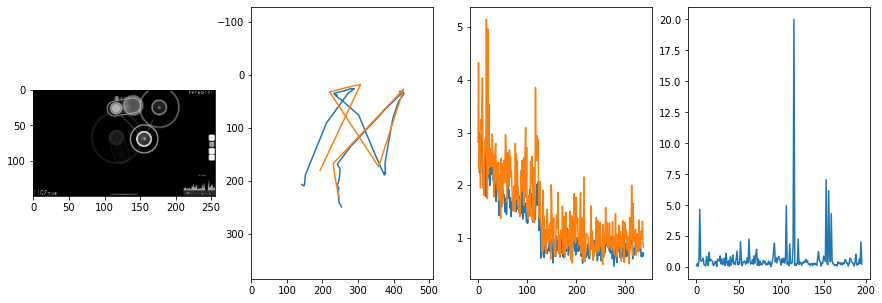


 344 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.2863                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6483803584753555
outliers: 28
retrain: 4                 
val: 50/50 loss: 17.7343                                   
pred: 0.29158449172973633 0.6650962829589844
gt: 0.5 0.208333358168602
(125, 42)


<Figure size 1080x360 with 0 Axes>

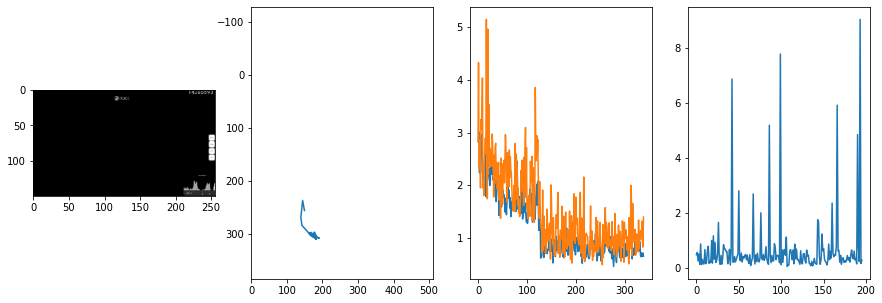


 345 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  0.2660                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.1712103214266958
outliers: 55
retrain: 4                 
val: 50/50 loss: 0.5988                                    
pred: 0.8997741341590881 0.6244521737098694
gt: 0.785155713558197 0.5781247019767761
(169, 85)


<Figure size 1080x360 with 0 Axes>

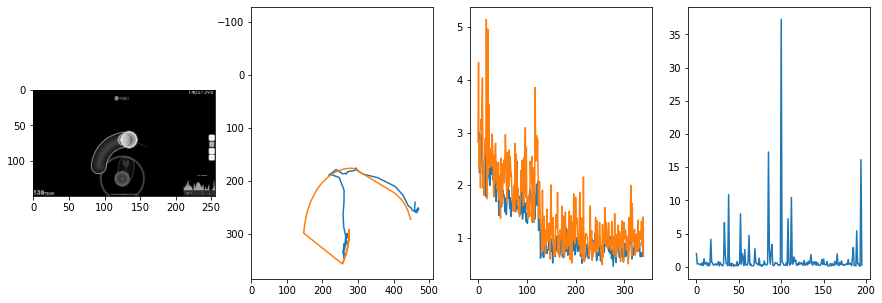


 346 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.85it/s  1.5707                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 1.0366965566134574
outliers: 22
retrain: 4                 
val: 50/50 loss: 1.0368                                    
pred: 0.05848177522420883 0.6202755570411682
gt: 0.1691661775112152 0.6072772145271301
(74, 88)


<Figure size 1080x360 with 0 Axes>

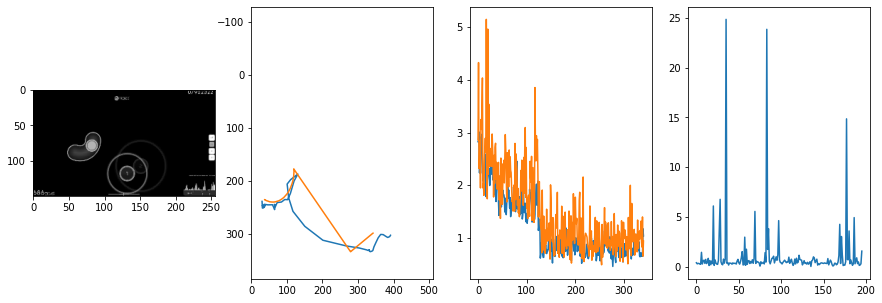


 347 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.4805                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.751465108435677
outliers: 19
retrain: 4                 
val: 50/50 loss: 0.5715                                    
pred: 0.49280184507369995 0.751053512096405
gt: 0.5546711087226868 0.7708432078361511
(134, 107)


<Figure size 1080x360 with 0 Axes>

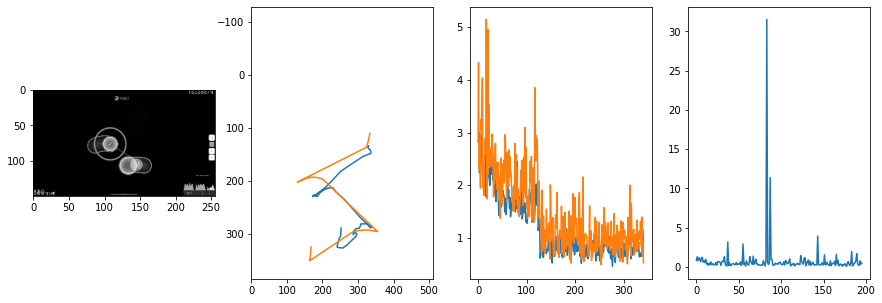


 348 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.3818                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6265785559175574
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.4915                                    
pred: 0.45898932218551636 0.6992760300636292
gt: 0.45344898104667664 0.77359938621521
(118, 107)


<Figure size 1080x360 with 0 Axes>

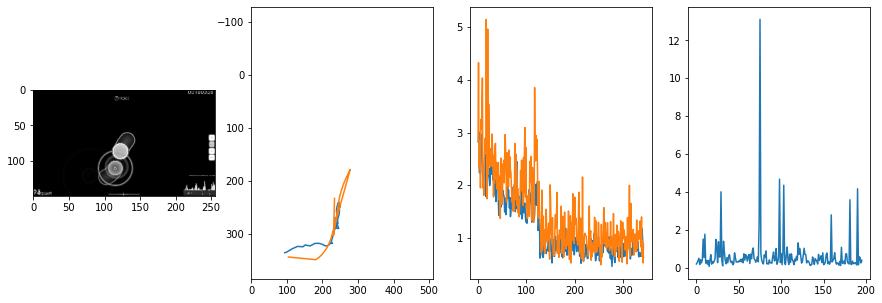


 349 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  2.8664                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6073478646576405
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.6987                                    
pred: 0.34806549549102783 0.27121302485466003
gt: 0.6328071355819702 0.4166663587093353
(146, 66)


<Figure size 1080x360 with 0 Axes>

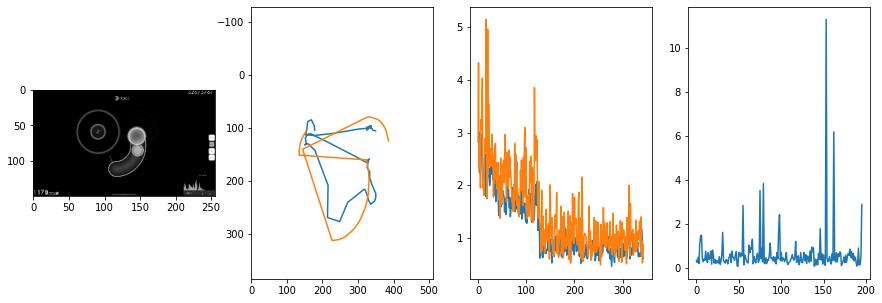


 350 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.6945                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6701611313512739
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.3607                                    
pred: 0.7244747281074524 0.8729356527328491
gt: 0.8165158033370972 0.47224971652030945
(174, 72)


<Figure size 1080x360 with 0 Axes>

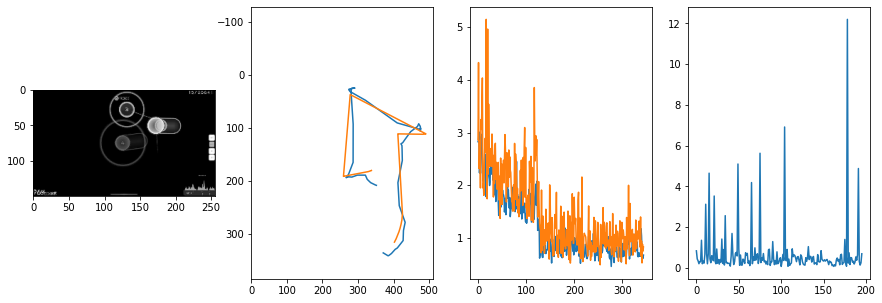


 351 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  0.3453                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7832896710962666
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.4920                                    
pred: 0.3877662718296051 0.6336870193481445
gt: 0.041015636175870895 0.15885421633720398
(54, 36)


<Figure size 1080x360 with 0 Axes>

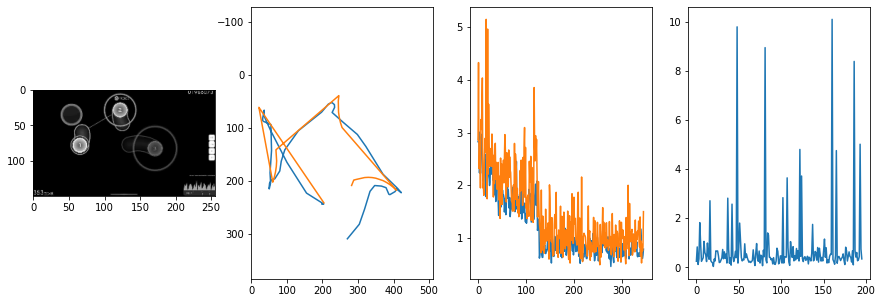


 352 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  8.0603                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9511622810090075
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.7367                                    
pred: 0.3273313343524933 0.12057588249444962
gt: 0.12890635430812836 0.1432291865348816
(67, 34)


<Figure size 1080x360 with 0 Axes>

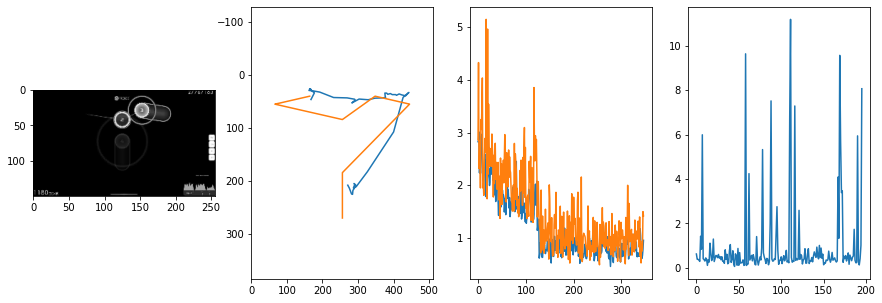


 353 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.1668                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8471630577150048
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.6797                                    
pred: 0.31173646450042725 0.7102445960044861
gt: 0.5881275534629822 0.883185625076294
(139, 120)


<Figure size 1080x360 with 0 Axes>

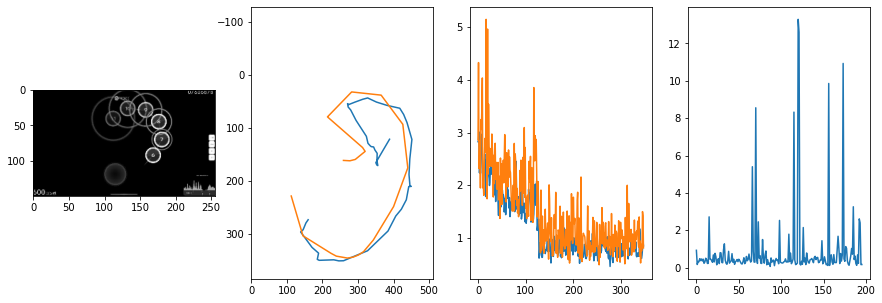


 354 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.2077                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7087489091316048
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.2383                                    
pred: 0.5138686895370483 0.15309835970401764
gt: 0.50390625 0.4739583432674408
(126, 73)


<Figure size 1080x360 with 0 Axes>

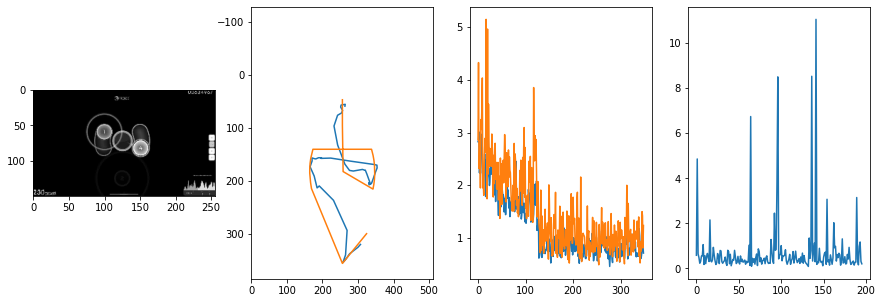


 355 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.36it/s  0.3422                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5646440241181728
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.5474                                    
pred: 0.4169813096523285 0.47366878390312195
gt: 0.39912500977516174 0.28216665983200073
(109, 50)


<Figure size 1080x360 with 0 Axes>

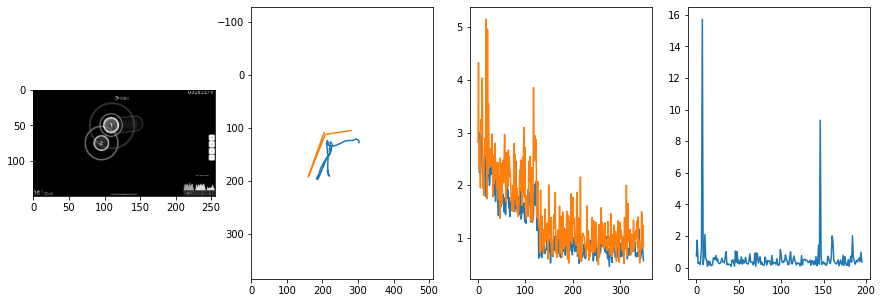


 356 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.3866                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8053122185626809
outliers: 50
retrain: 4                 
val: 50/50 loss: 0.7089                                    
pred: 0.5254514813423157 0.5516505837440491
gt: 0.5885448455810547 0.5549190640449524
(139, 82)


<Figure size 1080x360 with 0 Axes>

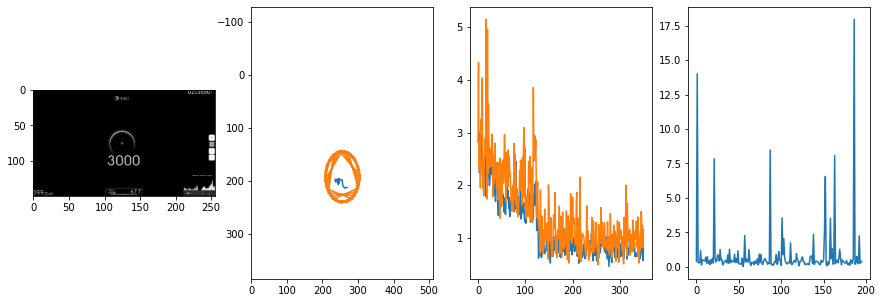


 357 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0935                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8651116623030025
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.5787                                    
pred: 0.23467952013015747 0.7550154328346252
gt: 0.4294387400150299 0.9269421696662903
(114, 125)


<Figure size 1080x360 with 0 Axes>

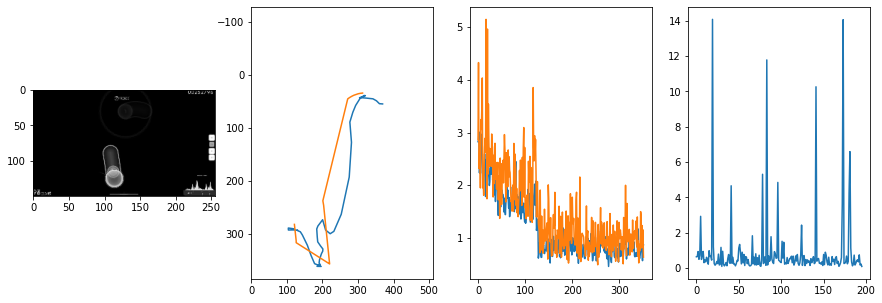


 358 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.4336                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6547581017473523
outliers: 24
retrain: 4                 
val: 50/50 loss: 5.7491                                    
pred: 0.417941153049469 0.5624213218688965
gt: 0.15813039243221283 0.38548848032951355
(72, 62)


<Figure size 1080x360 with 0 Axes>

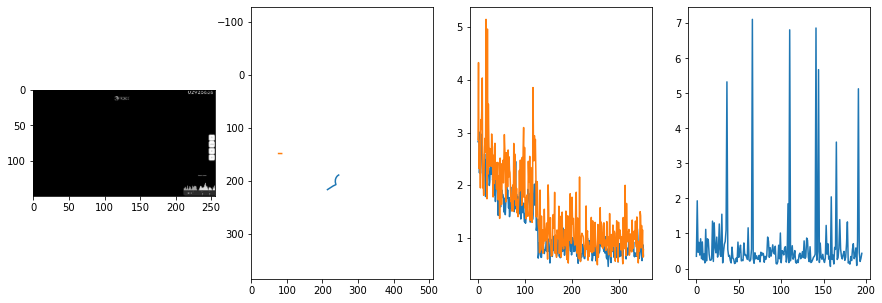


 359 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  1.2710                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8326711886923532
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.4298                                    
pred: 0.627925455570221 0.5633533000946045
gt: 0.52734375 0.3255208432674408
(129, 55)


<Figure size 1080x360 with 0 Axes>

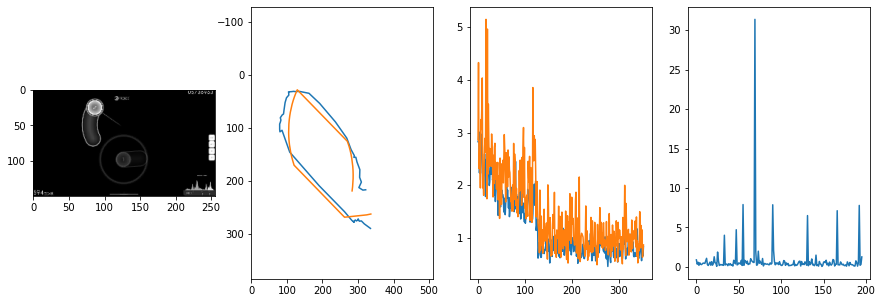


 360 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.2249                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7676888776715008
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.4208                                    
pred: 0.05419492721557617 0.5944948792457581
gt: -0.016503991559147835 0.3104218542575836
(46, 54)


<Figure size 1080x360 with 0 Axes>

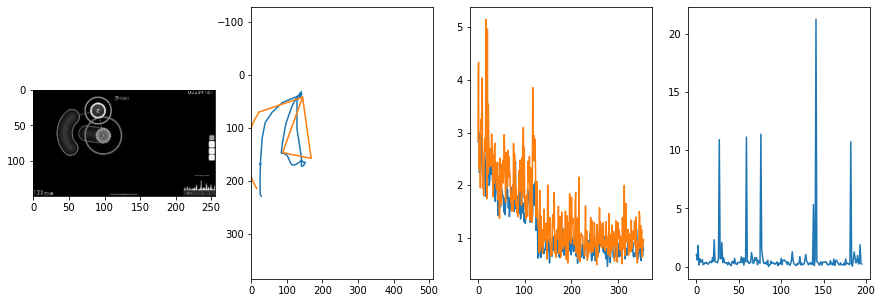


 361 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  1.2363                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7899392371883198
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.9066                                    
pred: 0.46742305159568787 0.5574131608009338
gt: 0.5441418290138245 0.6161473393440247
(132, 89)


<Figure size 1080x360 with 0 Axes>

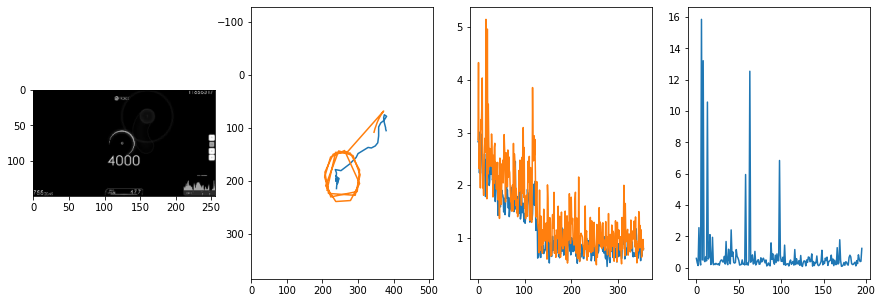


 362 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.1938                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9151458468820367
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.3988                                    
pred: 0.6736855506896973 0.6994536519050598
gt: 0.621094822883606 0.7578132748603821
(144, 106)


<Figure size 1080x360 with 0 Axes>

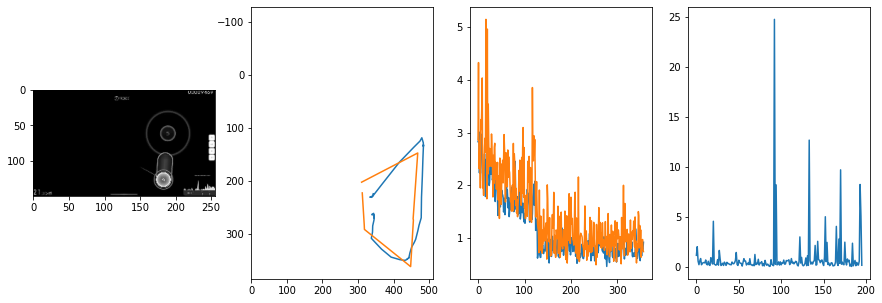


 363 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.69it/s  0.7940                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5554840196380202
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.6706                                    
pred: 0.24998164176940918 0.8462634682655334
gt: 0.04240020364522934 0.8157773613929749
(54, 112)


<Figure size 1080x360 with 0 Axes>

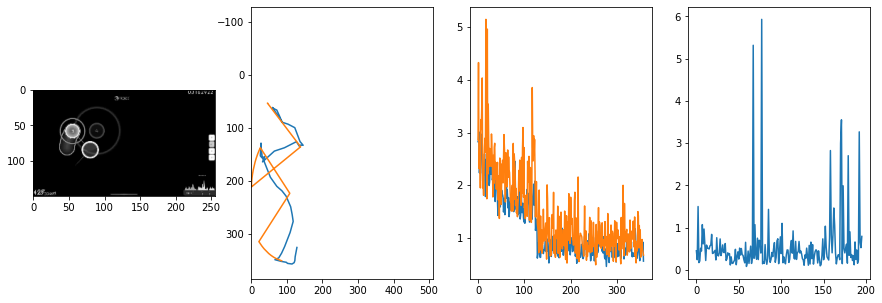


 364 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.5118                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6247086556894439
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.7206                                    
pred: 0.5387334823608398 0.5309150218963623
gt: 0.5306696891784668 0.623620331287384
(130, 90)


<Figure size 1080x360 with 0 Axes>

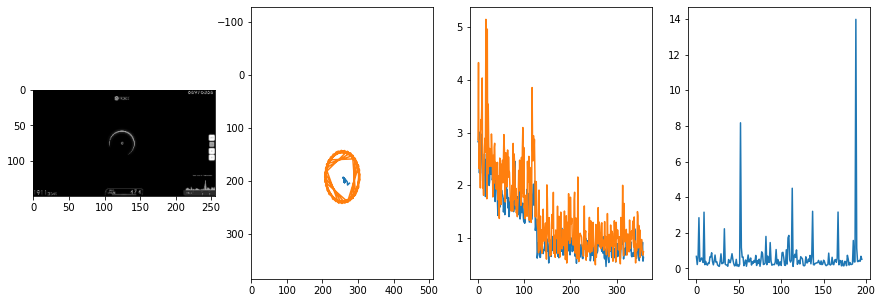


 365 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.6176                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6895231380345946
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.1515                                    
pred: 0.5115695595741272 0.8073791265487671
gt: 0.39303070306777954 0.8897342085838318
(108, 121)


<Figure size 1080x360 with 0 Axes>

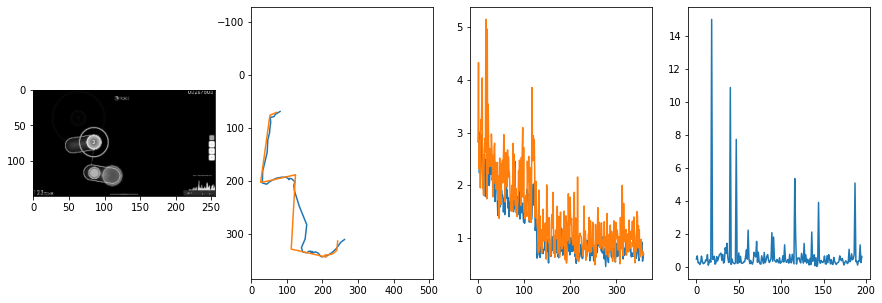


 366 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.1925                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5533984751269525
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.5455                                    
pred: 0.2853233218193054 0.8688944578170776
gt: 0.08595661073923111 0.7494904398918152
(61, 105)


<Figure size 1080x360 with 0 Axes>

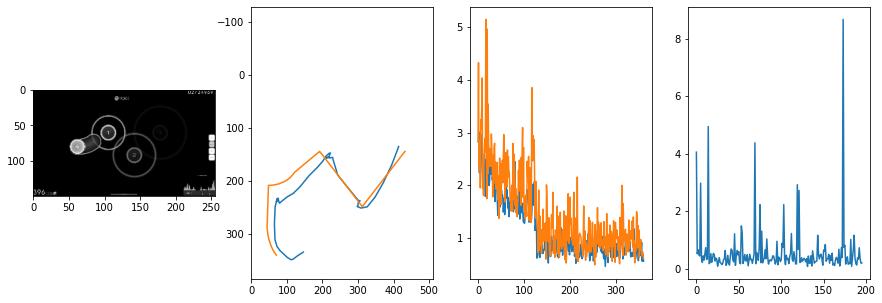


 367 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.3528                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5165831379174274
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.4273                                    
pred: 0.22162538766860962 0.7610539793968201
gt: 0.10160837322473526 0.5625532865524292
(63, 83)


<Figure size 1080x360 with 0 Axes>

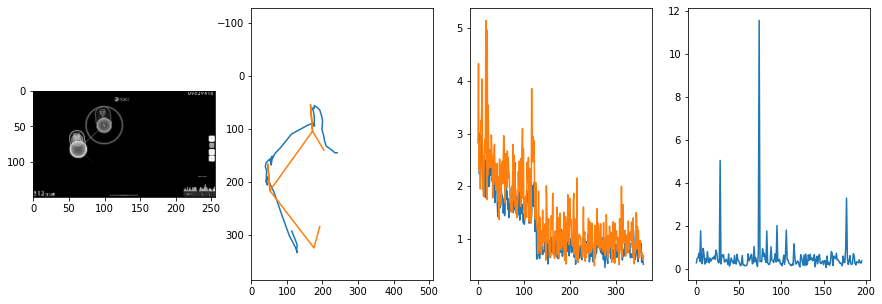


 368 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.2670                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6299160258578402
outliers: 59
retrain: 4                 
val: 50/50 loss: 3.6285                                    
pred: 0.45631974935531616 0.4388086795806885
gt: 0.3437524735927582 0.18750494718551636
(101, 39)


<Figure size 1080x360 with 0 Axes>

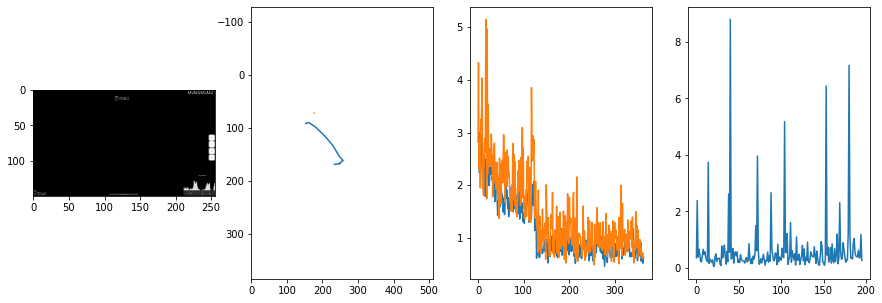


 369 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.1040                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6868051639853083
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.5251                                    
pred: 0.6330300569534302 0.5582404732704163
gt: 0.6015123128890991 0.48976626992225647
(141, 74)


<Figure size 1080x360 with 0 Axes>

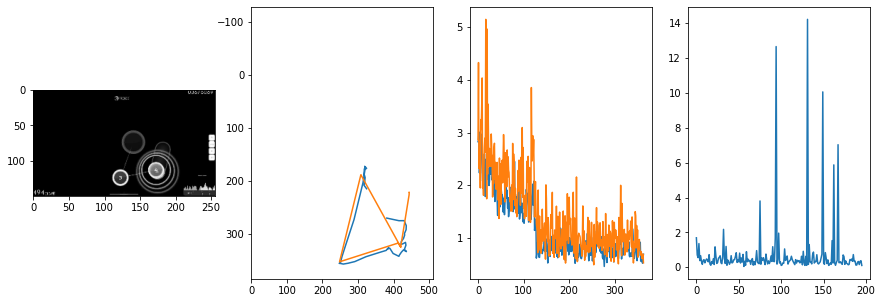


 370 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  2.3774                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.776787466654668
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.1996                                    
pred: 0.8445990681648254 0.5272184610366821
gt: 0.8901439905166626 0.48621639609336853
(186, 74)


<Figure size 1080x360 with 0 Axes>

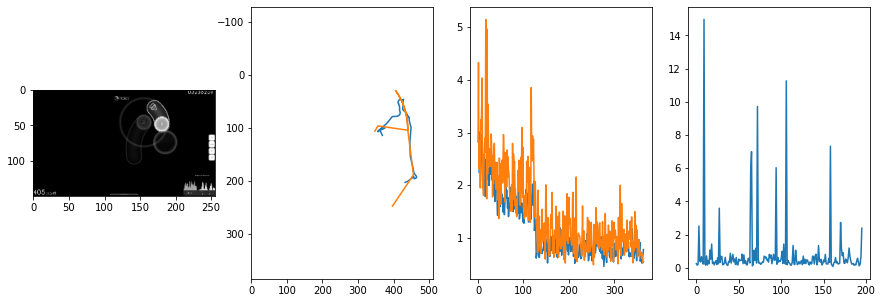


 371 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.5022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7606094763329139
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.4719                                    
pred: 0.16779708862304688 0.5998064875602722
gt: 0.39580968022346497 0.6767992377281189
(109, 96)


<Figure size 1080x360 with 0 Axes>

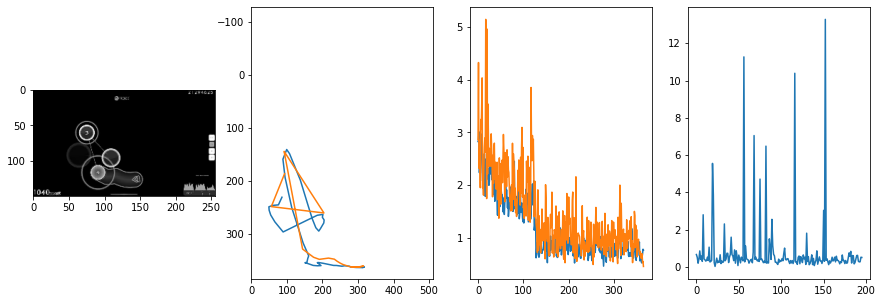


 372 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.3883                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8167023827530899
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.8109                                    
pred: 0.19179795682430267 0.32739007472991943
gt: 0.290722131729126 0.5201634168624878
(93, 78)


<Figure size 1080x360 with 0 Axes>

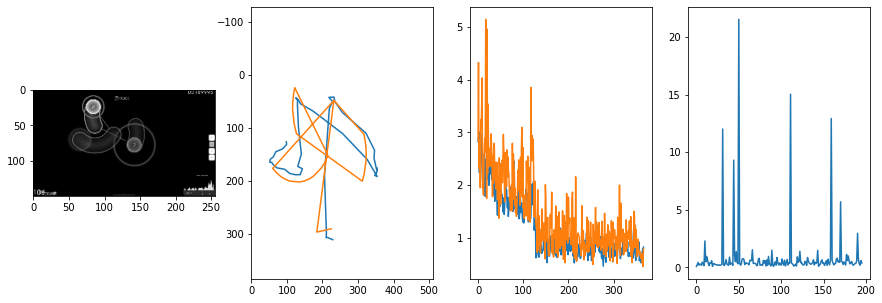


 373 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.1088                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6400301973810609
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.4331                                    
pred: 0.24700011312961578 0.4020470082759857
gt: 0.1332961767911911 0.3795485496520996
(68, 62)


<Figure size 1080x360 with 0 Axes>

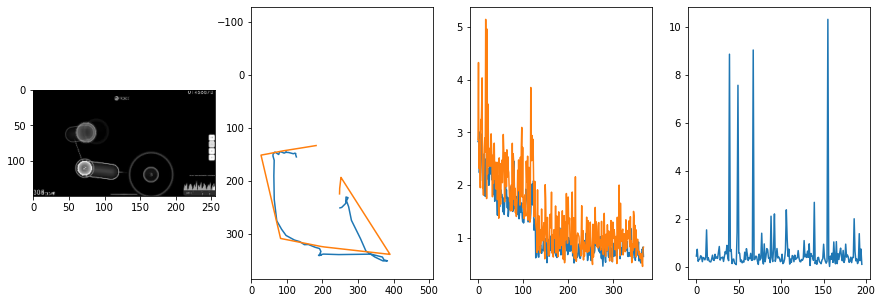


 374 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.3814                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5010469111861015
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.2571                                    
pred: 0.6144925355911255 0.1311793327331543
gt: 0.389962375164032 0.3543786108493805
(108, 59)


<Figure size 1080x360 with 0 Axes>

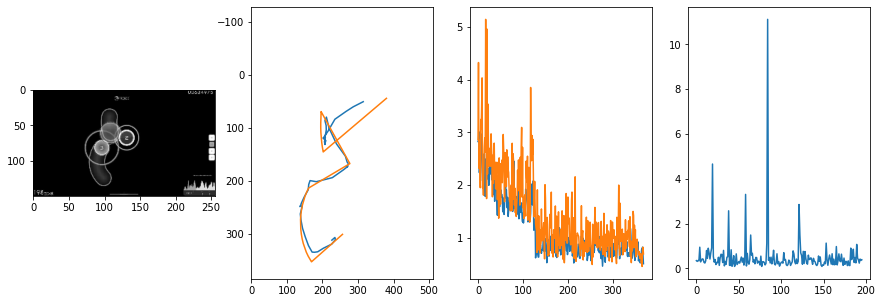


 375 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.3865                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7455091277441505
outliers: 53
retrain: 4                 
val: 50/50 loss: 0.7443                                    
pred: 0.1250193566083908 0.4255402982234955
gt: 0.11309114843606949 0.3109802007675171
(65, 54)


<Figure size 1080x360 with 0 Axes>

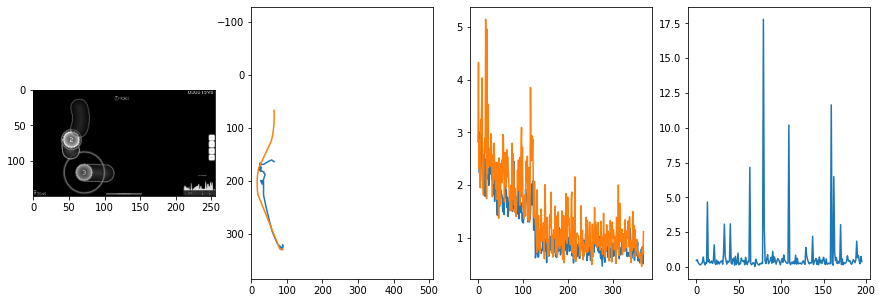


 376 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.2441                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.7782790612961564
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.1476                                    
pred: 0.43843433260917664 0.8495200872421265
gt: 0.4765625 0.8056249618530273
(121, 111)


<Figure size 1080x360 with 0 Axes>

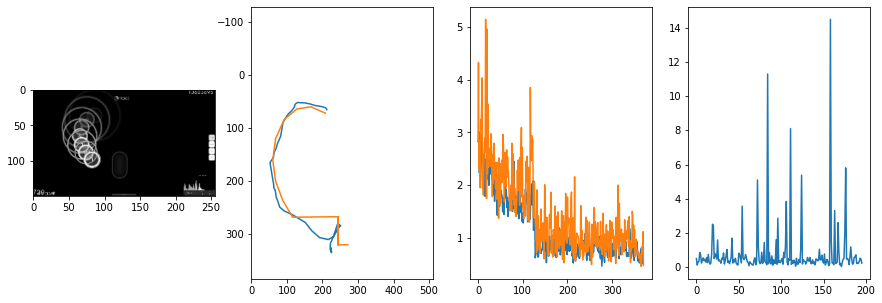


 377 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.1193                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8658486514599347
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.4786                                    
pred: 0.6145637035369873 0.3648683428764343
gt: 0.6497161388397217 0.3065798878669739
(148, 53)


<Figure size 1080x360 with 0 Axes>

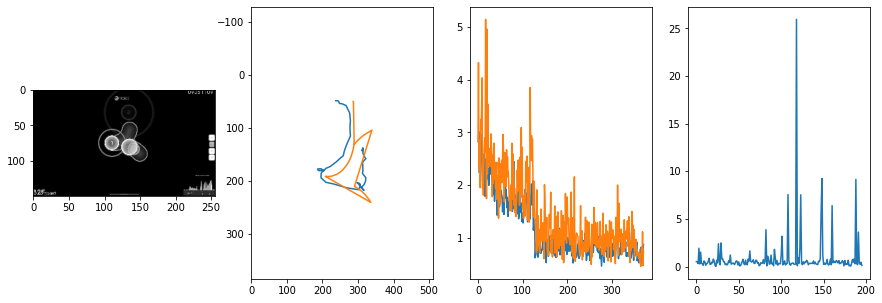


 378 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  2.2297                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6078277025751921
outliers: 20
retrain: 4                 
val: 50/50 loss: 3.0222                                    
pred: 0.42809662222862244 0.6418159008026123
gt: 0.46874964237213135 0.27083536982536316
(120, 49)


<Figure size 1080x360 with 0 Axes>

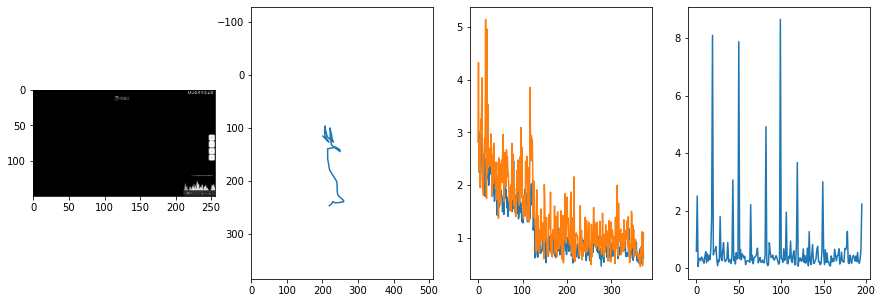


 379 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.5211                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.9970592404050487
outliers: 58
retrain: 4                 
val: 50/50 loss: 0.5081                                    
pred: 0.6677218079566956 0.65250164270401
gt: 0.6984495520591736 0.651631772518158
(156, 93)


<Figure size 1080x360 with 0 Axes>

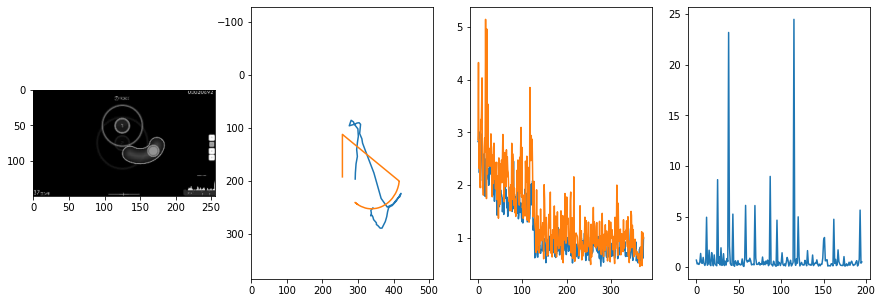


 380 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.4899                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6642660901558642
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.6652                                    
pred: 0.49835509061813354 0.4878530502319336
gt: 0.5177878737449646 0.6280301213264465
(128, 91)


<Figure size 1080x360 with 0 Axes>

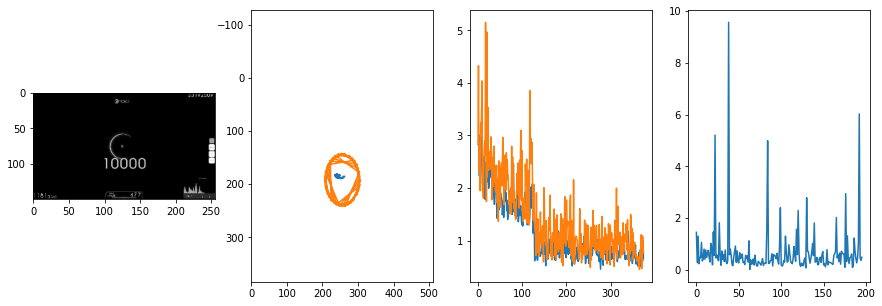


 381 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  0.3851                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6315063052639669
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.6119                                    
pred: 0.7589040994644165 0.2620301842689514
gt: 0.7194629907608032 0.13848000764846802
(159, 34)


<Figure size 1080x360 with 0 Axes>

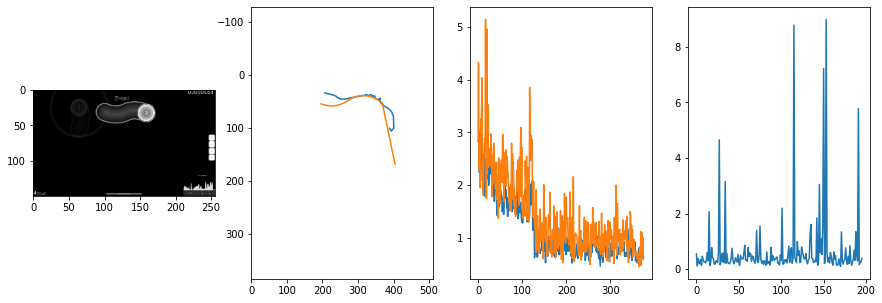


 382 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.4797                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6273827346003785
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.5547                                    
pred: 0.812645435333252 0.24226407706737518
gt: 0.7853061556816101 0.1509987711906433
(169, 35)


<Figure size 1080x360 with 0 Axes>

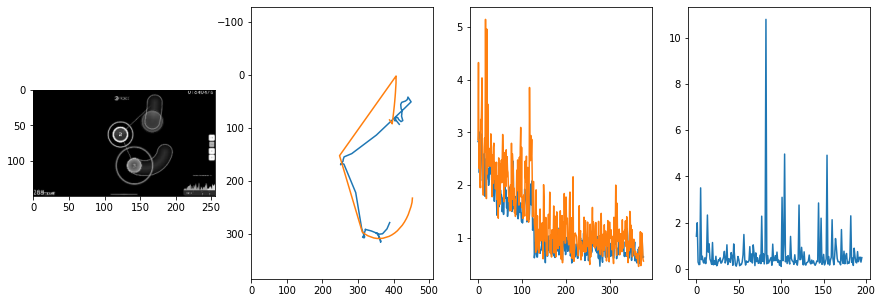


 383 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.6844                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6505940964027327
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.7377                                    
pred: 0.444051593542099 0.2460741251707077
gt: 0.7992827892303467 0.0904257670044899
(171, 28)


<Figure size 1080x360 with 0 Axes>

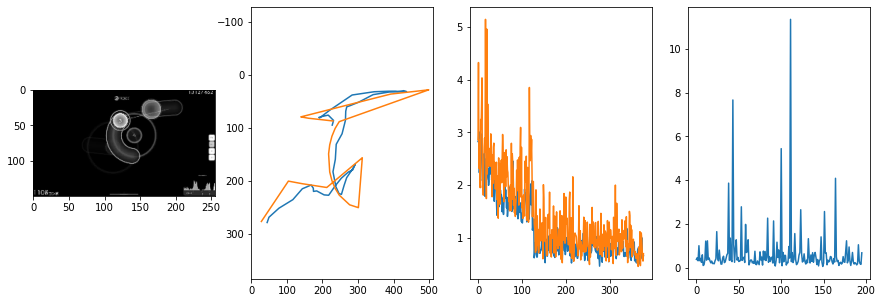


 384 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.3715                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6504840527528098
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.1817                                    
pred: 0.8513720631599426 0.758192777633667
gt: 0.734375 0.7083333134651184
(161, 100)


<Figure size 1080x360 with 0 Axes>

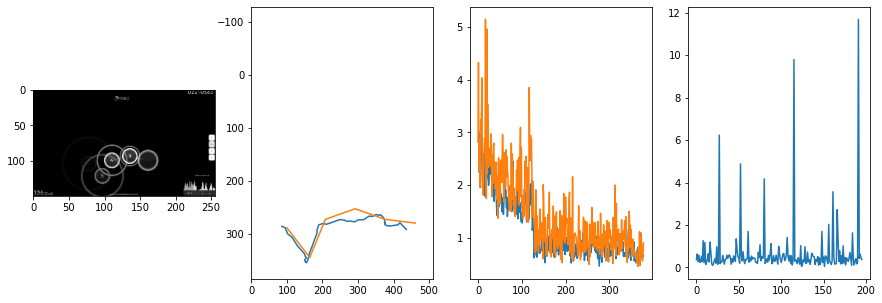


 385 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.3151                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8456550330227736
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.4973                                    
pred: 0.47086697816848755 0.34901943802833557
gt: 0.7337791919708252 0.2086510807275772
(161, 42)


<Figure size 1080x360 with 0 Axes>

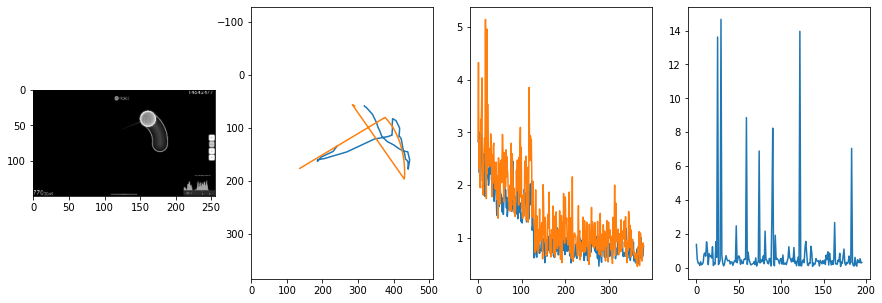


 386 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.2447                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.8015698547265968
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.3299                                    
pred: 0.47504109144210815 0.30824795365333557
gt: 0.5434809327125549 0.19746136665344238
(132, 40)


<Figure size 1080x360 with 0 Axes>

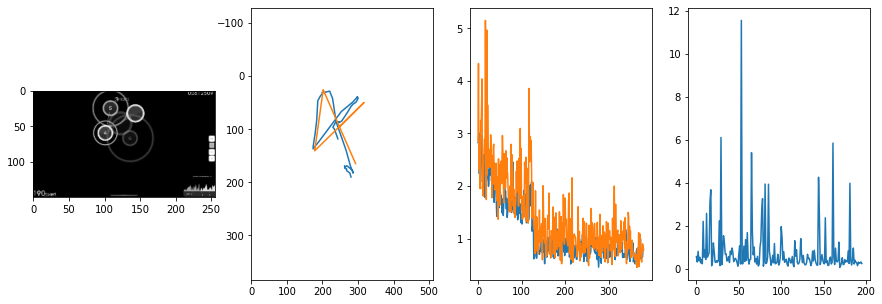


 387 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.1971                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.6558534400727676
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.4097                                    
pred: 0.4073514938354492 0.8215481638908386
gt: 0.27734375 0.6145833134651184
(91, 89)


<Figure size 1080x360 with 0 Axes>

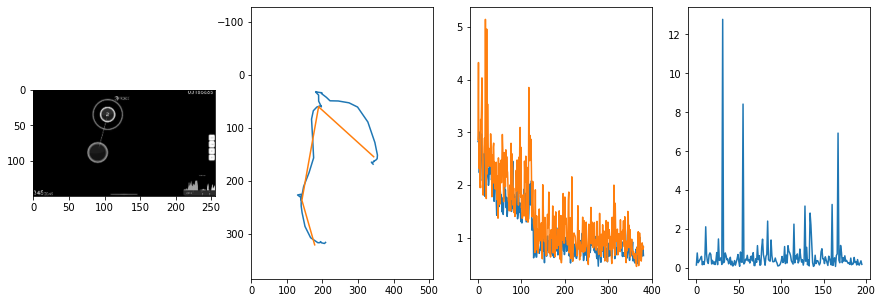


 388 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.1202                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.5685770706254609
outliers: 32
retrain: 4                 
val: 50/50 loss: 4.9982                                    
pred: 0.5107735991477966 0.07301893830299377
gt: 0.46093735098838806 0.049479398876428604
(119, 23)


<Figure size 1080x360 with 0 Axes>

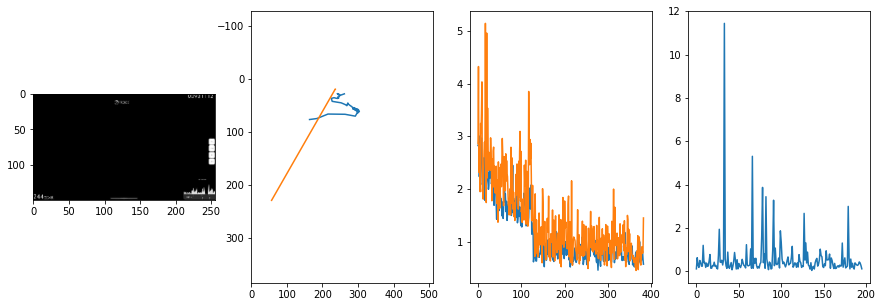


 389 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.1715                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.719273419195444
outliers: 62
retrain: 4                 
val: 50/50 loss: 0.6288                                    
pred: 0.7018819451332092 0.7799113988876343
gt: 0.6333083510398865 0.7695329785346985
(146, 107)


<Figure size 1080x360 with 0 Axes>

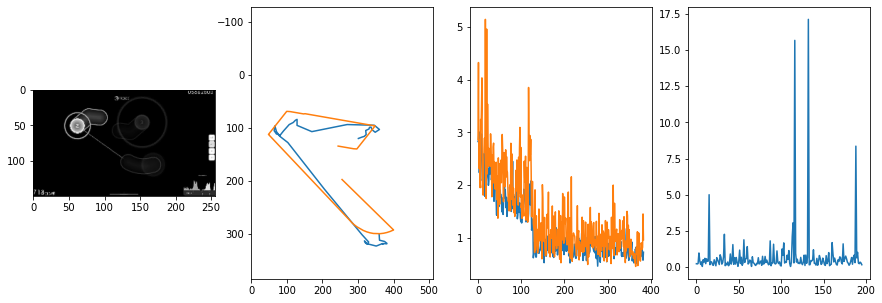


 390 of 390
2466.186938762665 secs


In [28]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [29]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

0.4493364192545414


# Test Model

In [30]:
import os
import cv2
import torch
import torchvision.transforms as transforms

In [31]:
vn.load_state_dict(torch.load(model_path + str(390) + '.pt'))

<All keys matched successfully>

In [32]:
osud = '../demo/beatmaps/567301 LamazeP - Spam Jack'
osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
#osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
#osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
#osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
#osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'
#osud = '../demo/beatmaps/962088 MIMI feat Hatsune Miku - Marshmary'
#osuf = 'MIMI feat. Hatsune Miku - Marshmary (Log Off Now) [Horizon].osu'
#osud = '../demo/beatmaps/1314370 GYARI, Nekomiya Hinata - Nekomiya Days'
#osuf = 'GYARI, Nekomiya Hinata - Nekomiya Days (Thanres) [Neko-days].osu'

In [33]:
hidden = True
osr = OSR(osud, osuf, sample_rate=sample_rate, hop_size=hop_size, hidden=hidden, vtmp='../demo/vids/')

In [34]:
osr.queue_vid()

'../demo/vids/LamazeP - Spam Jack (OsuToothbrush) [SPAM].osuhdn.avi'

In [35]:
hdn = 'hdn' if hidden else ''
video_path = os.path.join('../demo/vids/', osuf + hdn + '.avi')

In [36]:
vn.to(device)
vn.init_hidden(1)
vn.eval()

VN(
  (convB1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPB1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (convC1): Conv2d(4, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPC1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (lstmA): LSTM(19456, 256, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=256, out_features=256, bias=True)
  (normA): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  (linearB): Linear(in_features=256, out_features=32, bias=True)
  (normB): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
  (linearC): Linear(in_features=32, out_features=2, bias=True)
)

In [37]:
start = time.time()

transform = transforms.ToTensor()
frames = []
vc = cv2.VideoCapture(video_path)
p = []
while True:
    r, f = vc.read()
    if r is False:
        break
    f = cv2.resize(f, (0,0), fx=scale, fy=scale)
    f = cv2.cvtColor(f, cv2.COLOR_BGR2GRAY)
    F = transform(f).to(device)
    with torch.no_grad():
        P = vn(F.unsqueeze(0).unsqueeze(0))
    p.append(P.squeeze(0).squeeze(0).cpu().detach().numpy())
    
end = time.time()
print(end - start, 'secs')

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


21.73876190185547 secs


In [38]:
np.save('predVN.npy', p)

# Create Replay Video

In [39]:
from IPython.display import Video

In [40]:
eosud = osud.replace('/', '\/')

In [41]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoVN.mp4\",/" data.json

In [42]:
!python create_replayVN.py predVN.npy 50

2022-04-19 11:37:02,117:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-19 11:37:02,117:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/567301 LamazeP - Spam Jack/LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoVN.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f3b40fbb550>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': [200, 214, 229], 'Alpha': 0.9

In [43]:
Video("videoVN.mp4")

In [161]:
!sed -i "s/Output path.*/Output path\": \"video.mp4\",/" data.json

In [176]:
!python create_replay.py predHN.npy predVN.npy 50 0.5

2022-04-13 04:38:46,634:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-13 04:38:46,635:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../ex/beatmaps/567301 LamazeP - Spam Jack/LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'video.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7fd688ab75b0>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': [200, 214, 229], 'Alpha': 0.9, 'F

In [177]:
Video("video.mp4")